<a href="https://colab.research.google.com/github/AndreiAf02/Transfer_Learning_Fine_Tuning_Update/blob/main/Simulation_Transductive_TL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Transductive Transfer Learning - Simulation Study

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from time import perf_counter



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
# !pip install pytorch-tabnet

# from pytorch_tabnet.tab_model import TabNetClassifier
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from sklearn.datasets import make_classification
import random

from imblearn.datasets import make_imbalance

## Data simulated using the Scikit-Learn 'make_classification' package:

In [2]:
dataset_size = 50000
nfeatures = 20
ninformative = 20

k = 5


X, y = make_classification(n_samples=dataset_size, n_features=nfeatures, n_informative=ninformative,
                           n_redundant=nfeatures-ninformative, n_classes=2, random_state=42)

X, y = make_imbalance(X, y, sampling_strategy={0: int(dataset_size/2), 1:int(dataset_size/(2*k))},
                              random_state=42)

X = X.astype(int)

# X[:,:int(ninformative/2)] = X[:,:int(ninformative/2)].astype(int)

X = pd.DataFrame(X)
y = pd.DataFrame(y)

y

## Creating binary features:
X.iloc[:,0]= (X.iloc[:,0] >= -1.5).astype(int)
X.iloc[:,1]= (X.iloc[:,1] >= -1.).astype(int)
X.iloc[:,2:5]= (X.iloc[:,2:5] >= 0).astype(int)


## Creating categorical features:
bins1 = [-15, -5, 5, 15]
labels1 = [0, 1, 2]
X.iloc[:, 5] = (pd.cut(X.iloc[:, 5], bins=bins1, labels=labels1, right=False).astype(int)).astype('category')
for i in range(2):
  X.iloc[:, i+6] = (pd.cut(X.iloc[:, i+6], bins=bins1, labels=labels1, right=False).astype(int) +int(10-2*i)).astype('category')

## Second group of categorical features:
bins2 = [-15, -3, 0, 3, 15]
labels2 = [0, 1, 2, 3]
for i in range(2):
  X.iloc[:, i+8] = (pd.cut(X.iloc[:, i+8], bins=bins2, labels=labels2, right=False).astype(int) +int(5+i)).astype('category')


data_total = X
data_total['Y'] = y
data_total = data_total.dropna().reset_index(drop=True)
data_total

<ipython-input-2-58b285ad8d4b>:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '0        1
1        1
2        1
3        1
4        0
        ..
29995    1
29996    1
29997    1
29998    1
29999    1
Name: 5, Length: 30000, dtype: category
Categories (3, int64): [0, 1, 2]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  X.iloc[:, 5] = (pd.cut(X.iloc[:, 5], bins=bins1, labels=labels1, right=False).astype(int)).astype('category')
<ipython-input-2-58b285ad8d4b>:34: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '0        11
1        11
2        11
3        11
4        11
         ..
29995    11
29996    11
29997    11
29998    11
29999    11
Name: 6, Length: 30000, dtype: category
Categories (3, int64): [10, 11, 12]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  X.

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,Y
0,1,1,1,0,1,1,11,9,7,8,...,0,2,-1,-2,-3,1,1,0,2,0
1,1,1,1,1,0,1,11,9,7,7,...,-1,1,-1,0,0,-1,2,2,0,0
2,0,1,1,0,1,1,11,9,7,8,...,-3,-1,0,0,0,0,-1,-2,0,0
3,1,1,1,1,1,1,11,9,7,8,...,1,2,2,4,1,0,-3,-3,2,0
4,0,1,1,1,0,0,11,9,7,6,...,-7,4,-4,-1,-1,-3,2,4,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,1,1,1,0,1,1,11,9,8,8,...,1,0,3,0,4,3,3,-4,5,1
29996,0,1,1,1,0,1,11,9,7,8,...,1,-3,1,-4,0,0,3,0,-2,1
29997,1,1,0,1,1,1,11,9,7,7,...,0,6,-2,2,2,-2,3,-3,-1,1
29998,1,0,1,1,0,1,11,9,7,8,...,2,1,-2,-2,0,3,1,0,-3,1


In [3]:
data_total.iloc[:,0].value_counts()

,count
0,
1,23310
0,6690


In [4]:
data_total['Y'].value_counts()

,count
Y,
0,25000
1,5000


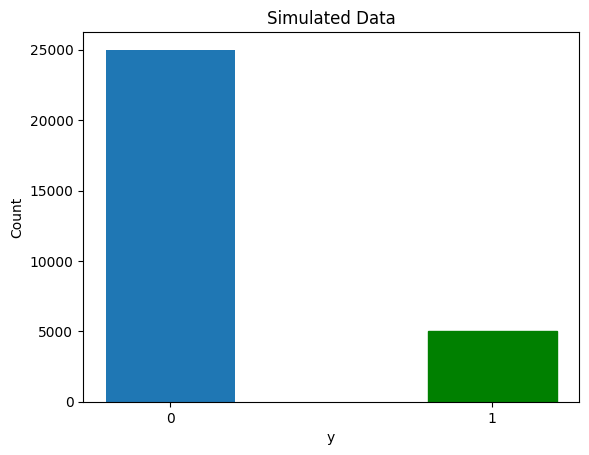

In [5]:
barlist = plt.bar([str(0),str(1)], data_total['Y'].value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("y")
plt.ylabel("Count")
plt.title("Simulated Data")
plt.show()

In [6]:
X = data_total.iloc[:,:-1]
y = data_total.iloc[:,-1]
X

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,1,1,1,0,1,1,11,9,7,8,0,0,2,-1,-2,-3,1,1,0,2
1,1,1,1,1,0,1,11,9,7,7,1,-1,1,-1,0,0,-1,2,2,0
2,0,1,1,0,1,1,11,9,7,8,1,-3,-1,0,0,0,0,-1,-2,0
3,1,1,1,1,1,1,11,9,7,8,-1,1,2,2,4,1,0,-3,-3,2
4,0,1,1,1,0,0,11,9,7,6,0,-7,4,-4,-1,-1,-3,2,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,1,1,1,0,1,1,11,9,8,8,-1,1,0,3,0,4,3,3,-4,5
29996,0,1,1,1,0,1,11,9,7,8,-3,1,-3,1,-4,0,0,3,0,-2
29997,1,1,0,1,1,1,11,9,7,7,-1,0,6,-2,2,2,-2,3,-3,-1
29998,1,0,1,1,0,1,11,9,7,8,-1,2,1,-2,-2,0,3,1,0,-3


In [7]:
y

,Y
0,0
1,0
2,0
3,0
4,0
...,...
29995,1
29996,1
29997,1
29998,1


In [8]:
# k = 5
# data_maj = data_balanced[data_balanced['Y']==0]
# data_min = data_balanced[data_balanced['Y']==1]

# data_min = data_min.sample(n=int(dataset_size/(2*k)), replace=False, random_state=10)
# data_min.shape

# data_total = pd.concat([data_maj, data_min]).reset_index(drop=True)
# data_total

# X = data_total.iloc[:,:-1]
# y = data_total.iloc[:,-1]
# y



In [9]:
X.shape

(30000, 20)

In [10]:
y.shape

(30000,)

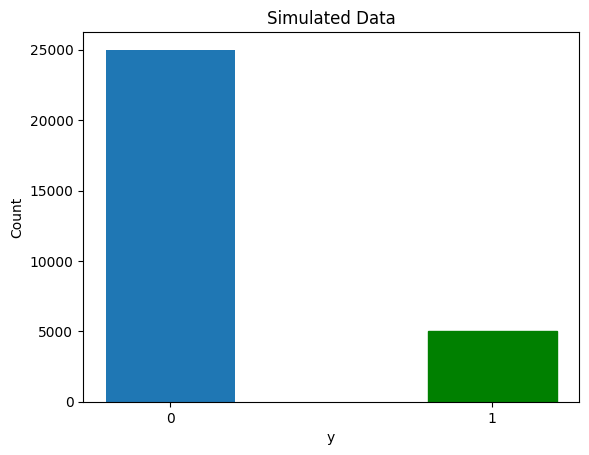

In [11]:
barlist = plt.bar([str(0),str(1)], y.value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("y")
plt.ylabel("Count")
plt.title("Simulated Data")
plt.show()

In [12]:
## Scaling the predictive data

scaler = MinMaxScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)
X_scaled = pd.DataFrame(X_scaled)


X_scaled

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,0.500000,0.50,0.583333,0.476190,0.409091,0.380952,0.50,0.523810,0.541667,0.545455
1,1.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.333333,0.545455,0.45,0.541667,0.476190,0.500000,0.523810,0.40,0.571429,0.625000,0.454545
2,0.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,0.545455,0.35,0.458333,0.523810,0.500000,0.523810,0.45,0.428571,0.458333,0.454545
3,1.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.666667,0.454545,0.55,0.583333,0.619048,0.681818,0.571429,0.45,0.333333,0.416667,0.545455
4,0.0,1.0,1.0,1.0,0.0,0.0,0.5,0.5,0.666667,0.000000,0.500000,0.15,0.666667,0.333333,0.454545,0.476190,0.30,0.571429,0.708333,0.590909
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,1.000000,0.666667,0.454545,0.55,0.500000,0.666667,0.500000,0.714286,0.60,0.619048,0.375000,0.681818
29996,0.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.666667,0.363636,0.55,0.375000,0.571429,0.318182,0.523810,0.45,0.619048,0.541667,0.363636
29997,1.0,1.0,0.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.333333,0.454545,0.50,0.750000,0.428571,0.590909,0.619048,0.35,0.619048,0.416667,0.409091
29998,1.0,0.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.666667,0.454545,0.60,0.541667,0.428571,0.409091,0.523810,0.60,0.523810,0.541667,0.318182


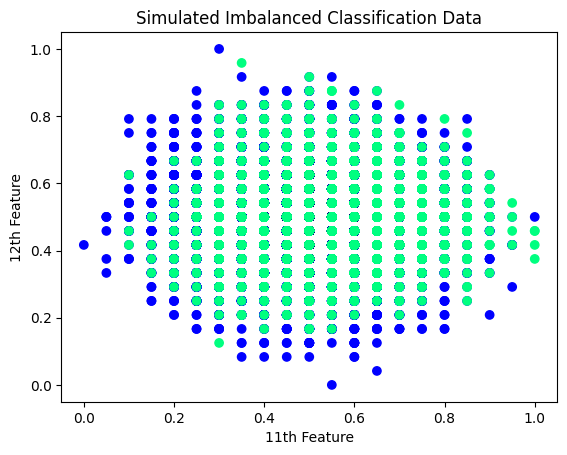

In [13]:
plt.scatter(X_scaled.iloc[:, 11], X_scaled.iloc[:, 12], c=y, cmap='winter')
plt.title('Simulated Imbalanced Classification Data')
plt.xlabel('11th Feature')
plt.ylabel('12th Feature')
plt.show()

In [14]:
data2 = pd.concat([X_scaled, y],axis=1)
data2

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,Y
0,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.50,0.583333,0.476190,0.409091,0.380952,0.50,0.523810,0.541667,0.545455,0
1,1.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.333333,...,0.45,0.541667,0.476190,0.500000,0.523810,0.40,0.571429,0.625000,0.454545,0
2,0.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.35,0.458333,0.523810,0.500000,0.523810,0.45,0.428571,0.458333,0.454545,0
3,1.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.55,0.583333,0.619048,0.681818,0.571429,0.45,0.333333,0.416667,0.545455,0
4,0.0,1.0,1.0,1.0,0.0,0.0,0.5,0.5,0.666667,0.000000,...,0.15,0.666667,0.333333,0.454545,0.476190,0.30,0.571429,0.708333,0.590909,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,1.000000,0.666667,...,0.55,0.500000,0.666667,0.500000,0.714286,0.60,0.619048,0.375000,0.681818,1
29996,0.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.666667,...,0.55,0.375000,0.571429,0.318182,0.523810,0.45,0.619048,0.541667,0.363636,1
29997,1.0,1.0,0.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.333333,...,0.50,0.750000,0.428571,0.590909,0.619048,0.35,0.619048,0.416667,0.409091,1
29998,1.0,0.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.666667,...,0.60,0.541667,0.428571,0.409091,0.523810,0.60,0.523810,0.541667,0.318182,1


In [15]:
y.value_counts()

,count
Y,
0,25000
1,5000


In [16]:
data2.iloc[:,0].value_counts()

,count
0,
1.0,23310
0.0,6690


In [17]:
print(len(data2[data2.iloc[:,0]<0.5]))
print(len(data2[data2.iloc[:,0]>=0.5]))

6690
23310


# Splitting for Source and Target Domains:


# Full Dataset:

In [18]:
data_S = data2[data2.iloc[:,0]>=0.5].reset_index(drop=True)  ## Source domain and classification
data_T = data2[data2.iloc[:,0]<0.5].reset_index(drop=True)  ## Target domain and classification

In [19]:
data_S

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,Y
0,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.50,0.583333,0.476190,0.409091,0.380952,0.50,0.523810,0.541667,0.545455,0
1,1.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.333333,...,0.45,0.541667,0.476190,0.500000,0.523810,0.40,0.571429,0.625000,0.454545,0
2,1.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.55,0.583333,0.619048,0.681818,0.571429,0.45,0.333333,0.416667,0.545455,0
3,1.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.30,0.375000,0.523810,0.318182,0.619048,0.25,0.571429,0.541667,0.500000,0
4,1.0,1.0,0.0,1.0,1.0,0.5,0.5,0.5,0.333333,0.333333,...,0.50,0.500000,0.619048,0.500000,0.619048,0.55,0.476190,0.500000,0.454545,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23305,1.0,1.0,0.0,0.0,1.0,0.5,0.5,0.5,0.333333,0.666667,...,0.75,0.625000,0.619048,0.454545,0.523810,0.60,0.333333,0.541667,0.318182,1
23306,1.0,1.0,1.0,0.0,0.0,0.5,0.5,0.5,0.666667,0.333333,...,0.50,0.500000,0.476190,0.500000,0.523810,0.50,0.619048,0.541667,0.500000,1
23307,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,1.000000,0.666667,...,0.55,0.500000,0.666667,0.500000,0.714286,0.60,0.619048,0.375000,0.681818,1
23308,1.0,1.0,0.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.333333,...,0.50,0.750000,0.428571,0.590909,0.619048,0.35,0.619048,0.416667,0.409091,1


In [20]:
data_T

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,Y
0,0.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.35,0.458333,0.523810,0.500000,0.523810,0.45,0.428571,0.458333,0.454545,0
1,0.0,1.0,1.0,1.0,0.0,0.0,0.5,0.5,0.666667,0.000000,...,0.15,0.666667,0.333333,0.454545,0.476190,0.30,0.571429,0.708333,0.590909,0
2,0.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.75,0.583333,0.476190,0.454545,0.476190,0.70,0.571429,0.291667,0.727273,0
3,0.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.000000,...,0.35,0.625000,0.523810,0.454545,0.619048,0.45,0.523810,0.833333,0.500000,0
4,0.0,1.0,0.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.333333,...,0.65,0.416667,0.666667,0.636364,0.619048,0.65,0.333333,0.541667,0.409091,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6685,0.0,0.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,1.000000,...,0.50,0.500000,0.571429,0.545455,0.619048,0.45,0.571429,0.375000,0.500000,1
6686,0.0,1.0,0.0,1.0,1.0,0.5,0.5,0.0,0.666667,1.000000,...,0.50,0.458333,0.523810,0.500000,0.476190,0.30,0.476190,0.333333,0.681818,1
6687,0.0,1.0,0.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.60,0.416667,0.523810,0.500000,0.619048,0.40,0.523810,0.458333,0.363636,1
6688,0.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.666667,...,0.55,0.375000,0.571429,0.318182,0.523810,0.45,0.619048,0.541667,0.363636,1


## Source domain and task labels:

In [21]:
X_S_full = data_S.iloc[:, :-1]
X_S_full       ## Source domain


y_S_full = data_S.iloc[:, -1]
y_S_full       ## Source classification (response)

,Y
0,0
1,0
2,0
3,0
4,0
...,...
23305,1
23306,1
23307,1
23308,1


In [22]:
y_S_full.value_counts()

,count
Y,
0,19400
1,3910


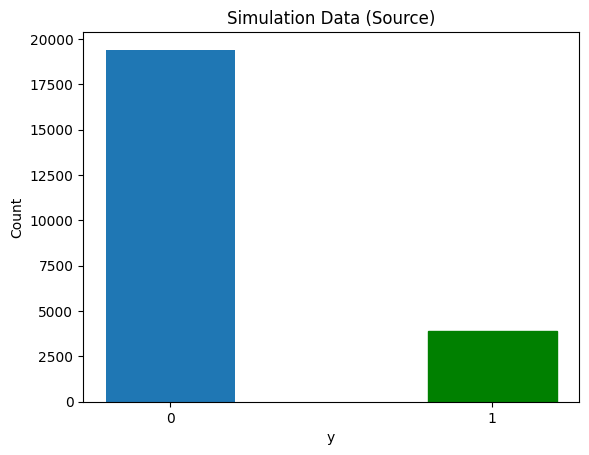

In [23]:
barlist_S = plt.bar([str(0),str(1)], y_S_full.value_counts(), width = 0.4)
barlist_S[1].set_color('g')

plt.xlabel("y")
plt.ylabel("Count")
plt.title("Simulation Data (Source)")
plt.show()

## Target domain and task labels:

In [24]:
X_T_full = data_T.iloc[:, :-1]
X_T_full       ## Target domain


y_T_full = data_T.iloc[:, -1]
y_T_full       ## Target classification (response)

,Y
0,0
1,0
2,0
3,0
4,0
...,...
6685,1
6686,1
6687,1
6688,1


In [25]:
y_T_full.value_counts()

,count
Y,
0,5600
1,1090


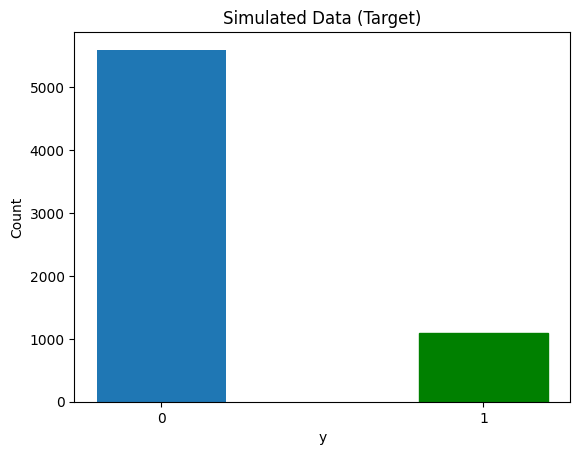

In [26]:
barlist_T = plt.bar([str(0),str(1)], y_T_full.value_counts(), width = 0.4)
barlist_T[1].set_color('g')

plt.xlabel("y")
plt.ylabel("Count")
plt.title("Simulated Data (Target)")
plt.show()

In [27]:
def create_dnn_model(input_shape):
  model = models.Sequential([layers.Dense(64, activation='relu', input_dim=input_shape),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # For binary classification (yes/no diabetes)
    ])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['AUC'])

  return model



def train_and_evaluate(model, X_train, X_test, y_train, y_test, domain):

    time_start = perf_counter()

    # Training and validation
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    # conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    # fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # # ROC Curve
    # ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    # ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    # ax1.set_xlabel('False Positive Rate')
    # ax1.set_ylabel('True Positive Rate')
    # ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    # ax1.legend(loc='lower right')
    # ax1.grid()

    # # Confusion Matrix
    # conf_disp.plot(ax=ax2, cmap='Blues')
    # ax2.set_title('Confusion Matrix')
    # plt.tight_layout()
    # plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)
    return time_elapsed


In [28]:
def Transductive_TL(model, X_test, y_test, domain):

    time_start = perf_counter()

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # ROC Curve
    ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    ax1.legend(loc='lower right')
    ax1.grid()

    # Confusion Matrix
    # print('Confusion matrix:', conf_matrix)
    fpr = conf_matrix[0][1]/(conf_matrix[0][0]+conf_matrix[0][1])
    tnr = 1-fpr

    fnr = conf_matrix[1][0]/(conf_matrix[1][0] + conf_matrix[1][1])
    tpr = 1 - fnr
    print('FPR', fpr, 'TPR:', tpr, 'FNR:', fnr, 'TNR:', tnr)
    conf_disp.plot(ax=ax2, cmap='Blues')
    ax2.set_title('Confusion Matrix')
    plt.tight_layout()
    plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")
    print('False Negative Rate:', fnr)

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)

    return fpr, tnr, fnr, tpr, time_elapsed

In [29]:
X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)

In [30]:
print('X_S_train:',np.shape(X_S_train))
print('y_S_train:',np.shape(y_S_train))
print('X_S_test:',np.shape(X_S_test))
print('y_S_test:',np.shape(y_S_test))

X_S_train: (18648, 20)
y_S_train: (18648,)
X_S_test: (4662, 20)
y_S_test: (4662,)


In [31]:
model_source = create_dnn_model(X_S_train.shape[1])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.5798 - loss: 0.4653 - val_AUC: 0.7999 - val_loss: 0.3870
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8218 - loss: 0.3537 - val_AUC: 0.8583 - val_loss: 0.3371
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8568 - loss: 0.3181 - val_AUC: 0.8795 - val_loss: 0.2990
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8909 - loss: 0.2811 - val_AUC: 0.9001 - val_loss: 0.2880
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9141 - loss: 0.2587 - val_AUC: 0.9245 - val_loss: 0.2526
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9294 - loss: 0.2380 - val_AUC: 0.9397 - val_loss: 0.2200
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9377 - loss: 0.2150 - val_AUC: 0.9385 - val_loss: 0.2326
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9500 - loss: 0.2035 - val_AUC: 0.9497 - val_loss: 0.2020
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AU

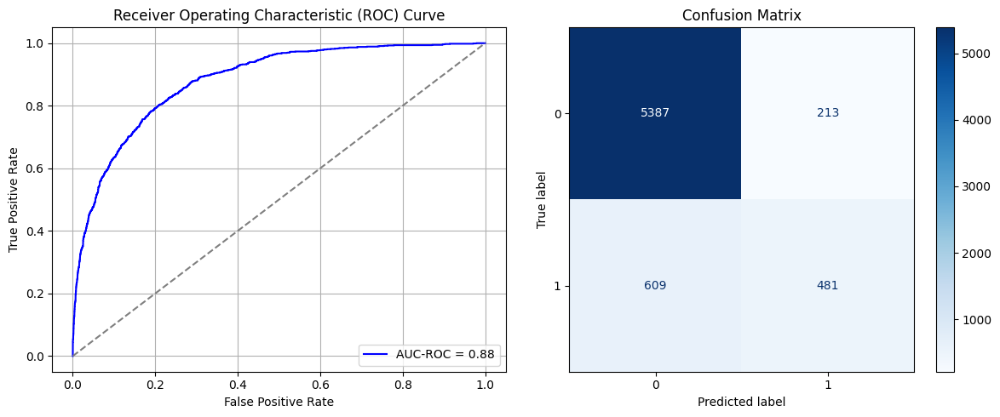

Best threshold based on F1-score: 0.22295494377613068
False Negative Rate: 0.5587155963302752
Time elapsed (performance): 1.020227838998835
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6110 - loss: 0.4488 - val_AUC: 0.8339 - val_loss: 0.3681
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8411 - loss: 0.3376 - val_AUC: 0.8683 - val_loss: 0.3139
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8757 - loss: 0.3056 - val_AUC: 0.8903 - val_loss: 0.2866
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8987 - loss: 0.2715 - val_AUC: 0.9072 - val_loss: 0.2625
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9151 - loss: 0.2503 - val_AUC: 0.9221 - val_loss: 0.2457
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9254 - loss: 0.2343 - val_AUC: 0.9346 - val_loss: 0.2400
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9411 - loss: 0.2184 - val_AUC: 0.9386 - val_loss: 0.2146
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9429 - loss: 0.2069 - val_AUC: 0.9502 - val_loss: 0.2031
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9510 -

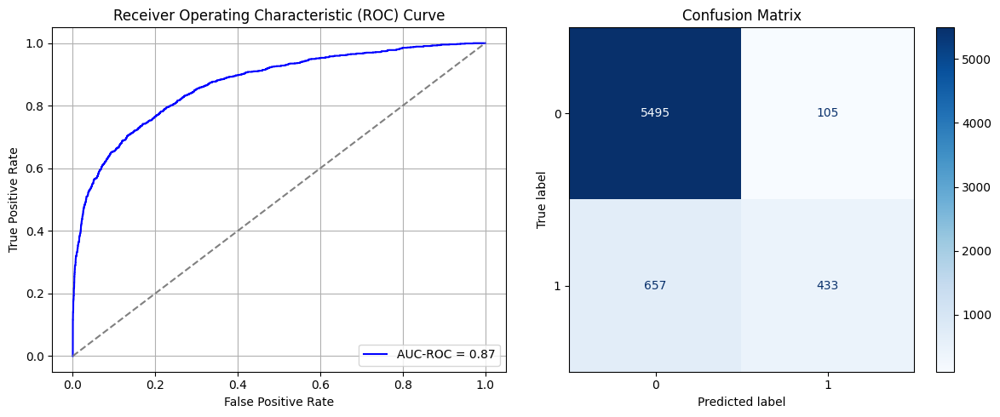

Best threshold based on F1-score: 0.25296586751937866
False Negative Rate: 0.6027522935779817
Time elapsed (performance): 0.7351552120017004
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6227 - loss: 0.4561 - val_AUC: 0.8234 - val_loss: 0.3734
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8352 - loss: 0.3407 - val_AUC: 0.8841 - val_loss: 0.2930
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8858 - loss: 0.2909 - val_AUC: 0.9004 - val_loss: 0.2758
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9103 - loss: 0.2630 - val_AUC: 0.9182 - val_loss: 0.2530
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9183 - loss: 0.2407 - val_AUC: 0.9320 - val_loss: 0.2518
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9387 - loss: 0.2207 - val_AUC: 0.9402 - val_loss: 0.2143
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9444 - loss: 0.2088 - val_AUC: 0.9440 - val_loss: 0.2084
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9522 - loss: 0.1930 - val_AUC: 0.9497 - val_loss: 0.2001
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9514 -

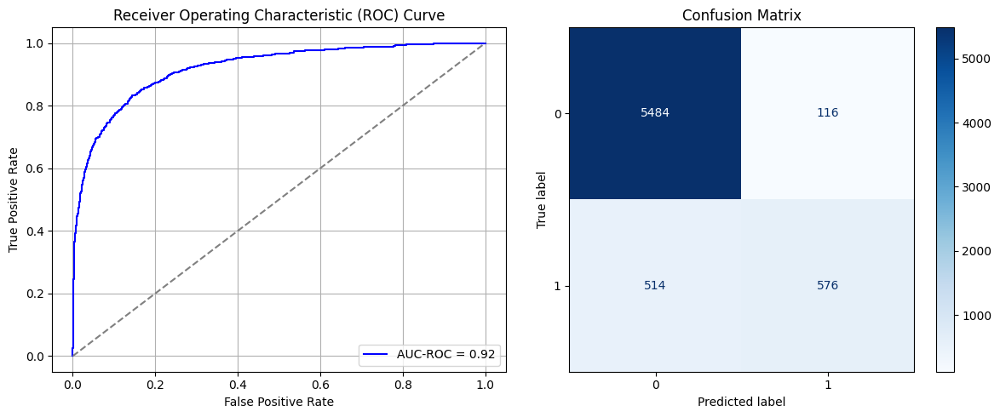

Best threshold based on F1-score: 0.26711270213127136
False Negative Rate: 0.47155963302752296
Time elapsed (performance): 0.7476467250016867
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6140 - loss: 0.4409 - val_AUC: 0.8116 - val_loss: 0.3715
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8295 - loss: 0.3457 - val_AUC: 0.8687 - val_loss: 0.3090
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8769 - loss: 0.3038 - val_AUC: 0.8915 - val_loss: 0.3152
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8966 - loss: 0.2718 - val_AUC: 0.9144 - val_loss: 0.2548
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9107 - loss: 0.2547 - val_AUC: 0.9264 - val_loss: 0.2369
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9316 - loss: 0.2275 - val_AUC: 0.9385 - val_loss: 0.2192
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9363 - loss: 0.2234 - val_AUC: 0.9444 - val_loss: 0.2131
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9454 - loss: 0.2045 - val_AUC: 0.9483 - val_loss: 0.2037
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9452 -

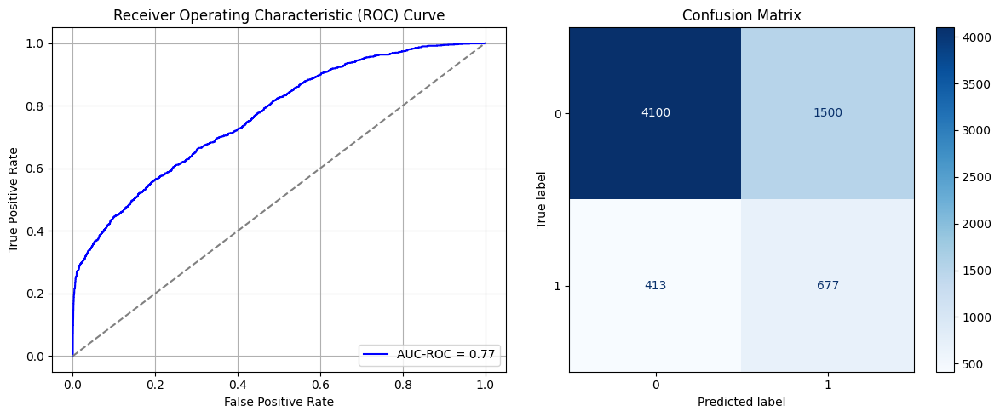

Best threshold based on F1-score: 0.8366423845291138
False Negative Rate: 0.37889908256880733
Time elapsed (performance): 0.7463402550019964
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.5944 - loss: 0.4789 - val_AUC: 0.8131 - val_loss: 0.3671
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8300 - loss: 0.3430 - val_AUC: 0.8719 - val_loss: 0.3168
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8745 - loss: 0.2971 - val_AUC: 0.8954 - val_loss: 0.2977
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9095 - loss: 0.2618 - val_AUC: 0.9126 - val_loss: 0.2625
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9173 - loss: 0.2536 - val_AUC: 0.9275 - val_loss: 0.2358
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9300 - loss: 0.2309 - val_AUC: 0.9384 - val_loss: 0.2179
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9405 - loss: 0.2125 - val_AUC: 0.9423 - val_loss: 0.2817
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9470 - loss: 0.2016 - val_AUC: 0.9521 - val_loss: 0.1949
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9489 -

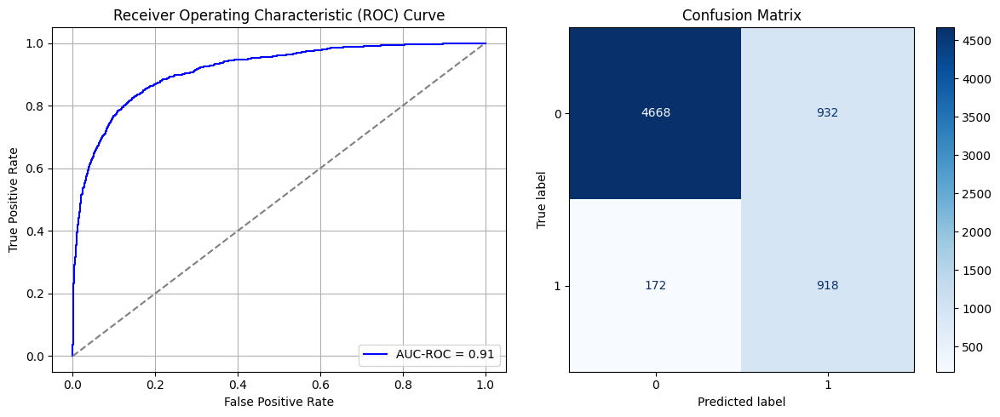

Best threshold based on F1-score: 0.8278281688690186
False Negative Rate: 0.1577981651376147
Time elapsed (performance): 0.808929775001161
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.5827 - loss: 0.4603 - val_AUC: 0.8184 - val_loss: 0.3638
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8295 - loss: 0.3443 - val_AUC: 0.8620 - val_loss: 0.3155
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8715 - loss: 0.2996 - val_AUC: 0.8892 - val_loss: 0.2882
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9143 - loss: 0.2584 - val_AUC: 0.9073 - val_loss: 0.2640
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9042 - loss: 0.2615 - val_AUC: 0.9248 - val_loss: 0.2401
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9290 - loss: 0.2345 - val_AUC: 0.9365 - val_loss: 0.2359
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9393 - loss: 0.2159 - val_AUC: 0.9455 - val_loss: 0.2126
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9451 - loss: 0.2076 - val_AUC: 0.9504 - val_loss: 0.1999
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9470 -

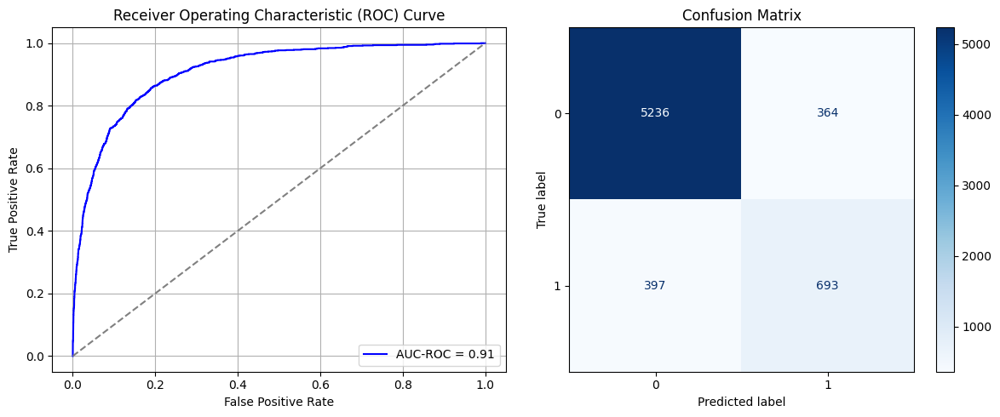

Best threshold based on F1-score: 0.3608909845352173
False Negative Rate: 0.3642201834862385
Time elapsed (performance): 0.7361398030006967
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6277 - loss: 0.4474 - val_AUC: 0.8130 - val_loss: 0.3695
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8160 - loss: 0.3513 - val_AUC: 0.8576 - val_loss: 0.3434
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.8582 - loss: 0.3132 - val_AUC: 0.8807 - val_loss: 0.2948
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.2891 - val_AUC: 0.8961 - val_loss: 0.2753
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9064 - loss: 0.2633 - val_AUC: 0.9045 - val_loss: 0.2788
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9159 - loss: 0.2506 - val_AUC: 0.9221 - val_loss: 0.2480
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - AUC: 0.9260 - loss: 0.2375 - val_AUC: 0.9336 - val_loss: 0.2330
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9329 - loss: 0.2273 - val_AUC: 0.9347 - val_loss: 0.2215
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9382 -

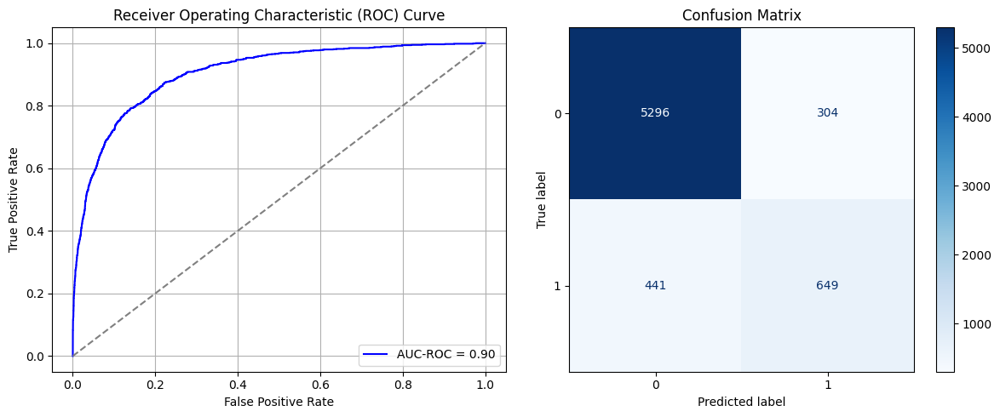

Best threshold based on F1-score: 0.39358311891555786
False Negative Rate: 0.40458715596330275
Time elapsed (performance): 1.2377645000015036
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6328 - loss: 0.4572 - val_AUC: 0.8005 - val_loss: 0.3710
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8241 - loss: 0.3494 - val_AUC: 0.8620 - val_loss: 0.3227
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8682 - loss: 0.3059 - val_AUC: 0.8864 - val_loss: 0.2911
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8911 - loss: 0.2779 - val_AUC: 0.9040 - val_loss: 0.2701
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9044 - loss: 0.2620 - val_AUC: 0.9124 - val_loss: 0.2589
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9237 - loss: 0.2391 - val_AUC: 0.9249 - val_loss: 0.2469
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9326 - loss: 0.2292 - val_AUC: 0.9312 - val_loss: 0.2431
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9384 - loss: 0.2184 - val_AUC: 0.9457 - val_loss: 0.2092
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9430 -

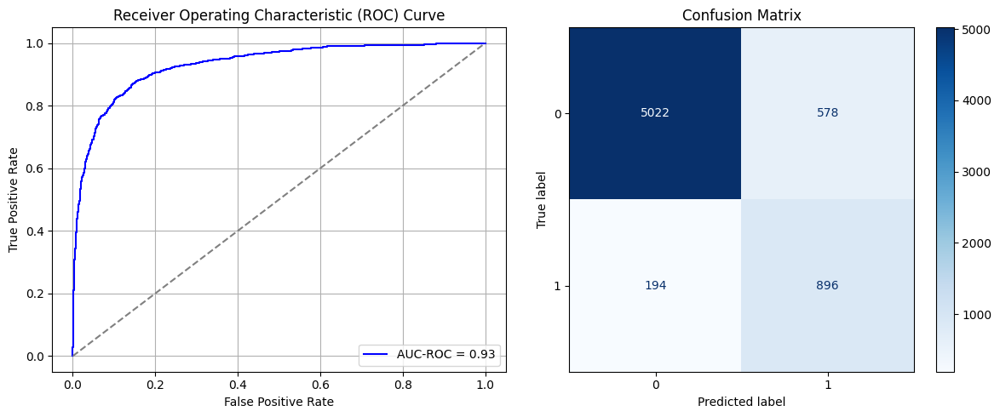

Best threshold based on F1-score: 0.6198843121528625
False Negative Rate: 0.1779816513761468
Time elapsed (performance): 0.7487123889986833
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.5823 - loss: 0.4721 - val_AUC: 0.8163 - val_loss: 0.3742
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8254 - loss: 0.3445 - val_AUC: 0.8729 - val_loss: 0.3081
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8656 - loss: 0.3034 - val_AUC: 0.8877 - val_loss: 0.2836
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9017 - loss: 0.2681 - val_AUC: 0.9035 - val_loss: 0.2674
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9177 - loss: 0.2527 - val_AUC: 0.9198 - val_loss: 0.2563
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9347 - loss: 0.2252 - val_AUC: 0.9386 - val_loss: 0.2232
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9420 - loss: 0.2160 - val_AUC: 0.9472 - val_loss: 0.2063
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9517 - loss: 0.1985 - val_AUC: 0.9480 - val_loss: 0.2040
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9558 -

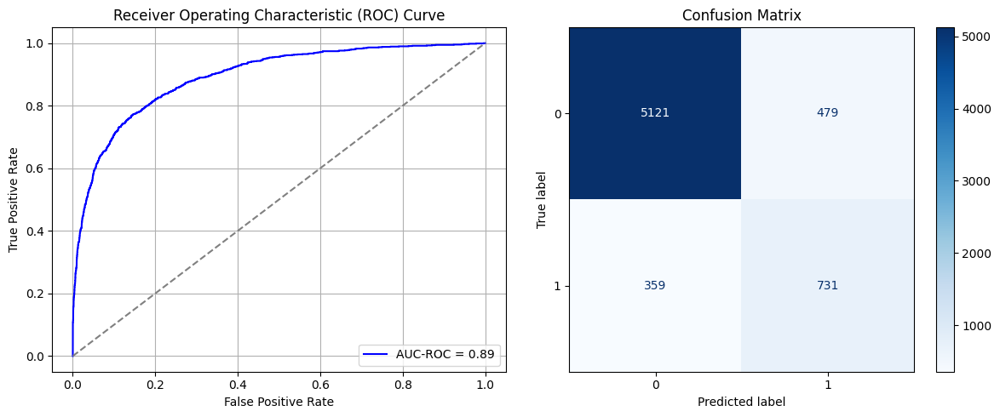

Best threshold based on F1-score: 0.5544039011001587
False Negative Rate: 0.3293577981651376
Time elapsed (performance): 0.7619831539996085
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6366 - loss: 0.4515 - val_AUC: 0.8274 - val_loss: 0.3568
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8415 - loss: 0.3299 - val_AUC: 0.8831 - val_loss: 0.2998
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8890 - loss: 0.2948 - val_AUC: 0.9078 - val_loss: 0.2650
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9139 - loss: 0.2529 - val_AUC: 0.9235 - val_loss: 0.2413
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9278 - loss: 0.2334 - val_AUC: 0.9337 - val_loss: 0.2281
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9320 - loss: 0.2279 - val_AUC: 0.9443 - val_loss: 0.2086
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9458 - loss: 0.2055 - val_AUC: 0.9478 - val_loss: 0.2244
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9475 - loss: 0.2053 - val_AUC: 0.9525 - val_loss: 0.2105
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9506 -

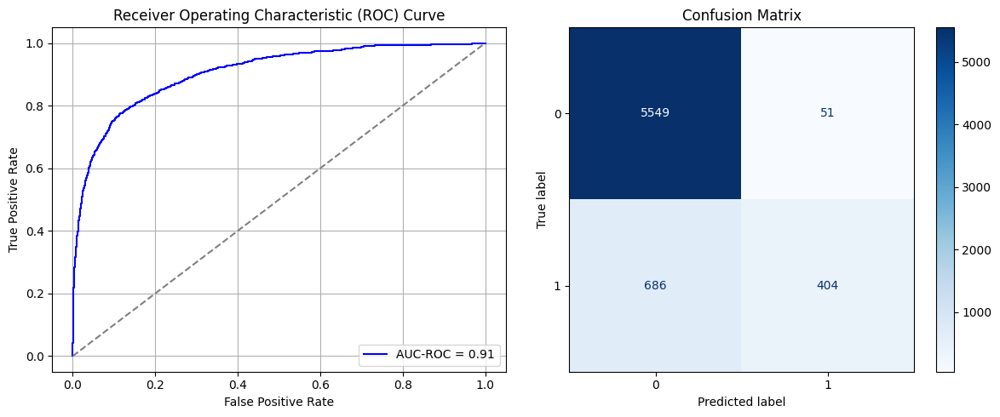

Best threshold based on F1-score: 0.2073340117931366
False Negative Rate: 0.6293577981651376
Time elapsed (performance): 1.0778777229970729
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6318 - loss: 0.4727 - val_AUC: 0.8347 - val_loss: 0.3652
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8428 - loss: 0.3413 - val_AUC: 0.8795 - val_loss: 0.3094
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8917 - loss: 0.2844 - val_AUC: 0.8977 - val_loss: 0.2892
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8941 - loss: 0.2879 - val_AUC: 0.9108 - val_loss: 0.2889
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9096 - loss: 0.2592 - val_AUC: 0.9203 - val_loss: 0.2455
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9236 - loss: 0.2431 - val_AUC: 0.9311 - val_loss: 0.2312
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9357 - loss: 0.2208 - val_AUC: 0.9402 - val_loss: 0.2145
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9405 - loss: 0.2153 - val_AUC: 0.9416 - val_loss: 0.2120
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9464 -

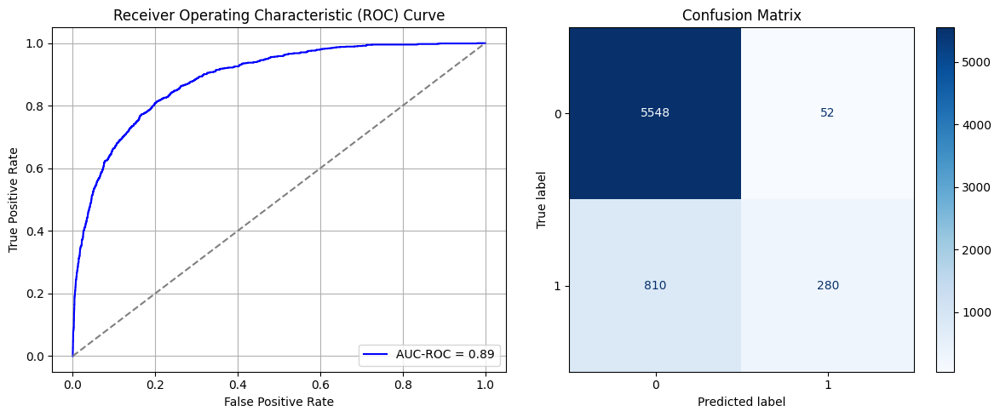

Best threshold based on F1-score: 0.11295902729034424
False Negative Rate: 0.7431192660550459
Time elapsed (performance): 0.7552474510011962
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6170 - loss: 0.4410 - val_AUC: 0.8198 - val_loss: 0.3701
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8297 - loss: 0.3462 - val_AUC: 0.8705 - val_loss: 0.3103
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8700 - loss: 0.3021 - val_AUC: 0.8976 - val_loss: 0.2812
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9048 - loss: 0.2662 - val_AUC: 0.9154 - val_loss: 0.2664
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9158 - loss: 0.2517 - val_AUC: 0.9284 - val_loss: 0.2396
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9315 - loss: 0.2298 - val_AUC: 0.9347 - val_loss: 0.2246
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9416 - loss: 0.2127 - val_AUC: 0.9441 - val_loss: 0.2092
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9493 - loss: 0.2027 - val_AUC: 0.9459 - val_loss: 0.2035
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9486 -

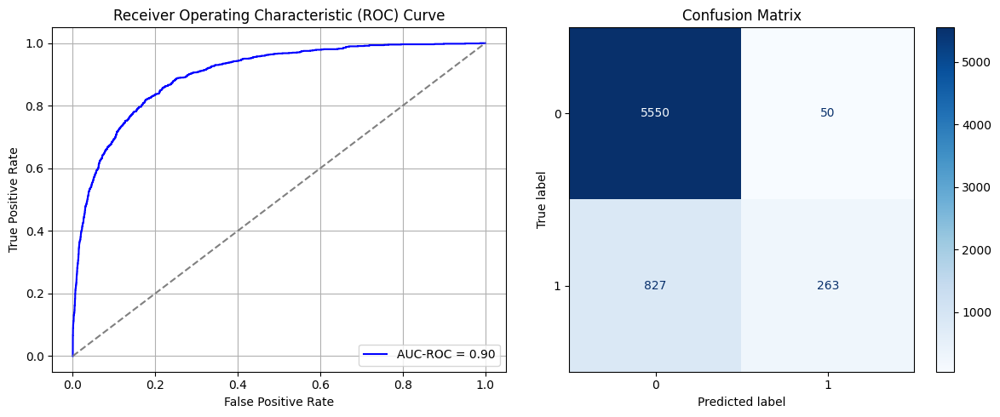

Best threshold based on F1-score: 0.08859000355005264
False Negative Rate: 0.7587155963302752
Time elapsed (performance): 1.0108066120010335
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6437 - loss: 0.4429 - val_AUC: 0.8442 - val_loss: 0.3442
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8477 - loss: 0.3287 - val_AUC: 0.8835 - val_loss: 0.2943
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 - loss: 0.2949 - val_AUC: 0.9064 - val_loss: 0.2650
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9091 - loss: 0.2601 - val_AUC: 0.9268 - val_loss: 0.2427
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9270 - loss: 0.2411 - val_AUC: 0.9376 - val_loss: 0.2235
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9408 - loss: 0.2165 - val_AUC: 0.9444 - val_loss: 0.2090
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9466 - loss: 0.2008 - val_AUC: 0.9533 - val_loss: 0.1957
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9487 - loss: 0.1979 - val_AUC: 0.9583 - val_loss: 0.1835
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9574 -

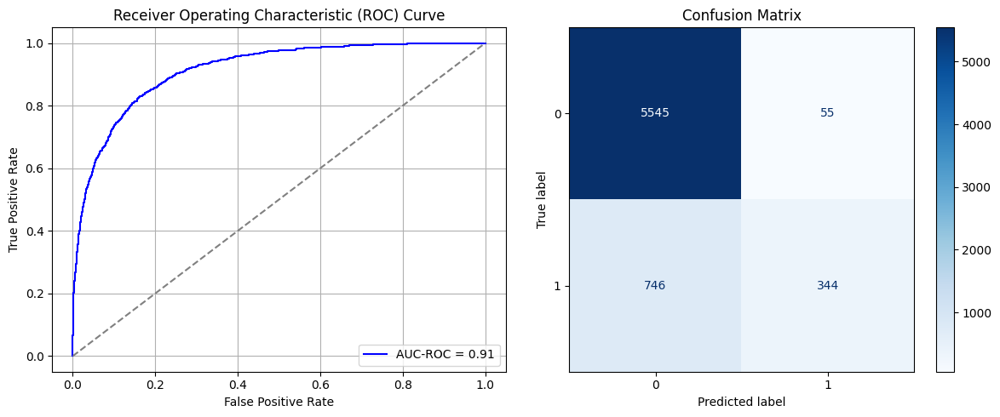

Best threshold based on F1-score: 0.11288242042064667
False Negative Rate: 0.6844036697247706
Time elapsed (performance): 1.0260736319978605
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6594 - loss: 0.4272 - val_AUC: 0.8534 - val_loss: 0.3525
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8509 - loss: 0.3378 - val_AUC: 0.8822 - val_loss: 0.3645
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.2966 - val_AUC: 0.9088 - val_loss: 0.2642
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9094 - loss: 0.2590 - val_AUC: 0.9254 - val_loss: 0.2647
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9240 - loss: 0.2381 - val_AUC: 0.9343 - val_loss: 0.2346
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9345 - loss: 0.2221 - val_AUC: 0.9442 - val_loss: 0.2149
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9451 - loss: 0.2090 - val_AUC: 0.9508 - val_loss: 0.1975
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9499 - loss: 0.2039 - val_AUC: 0.9532 - val_loss: 0.2007
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9569 -

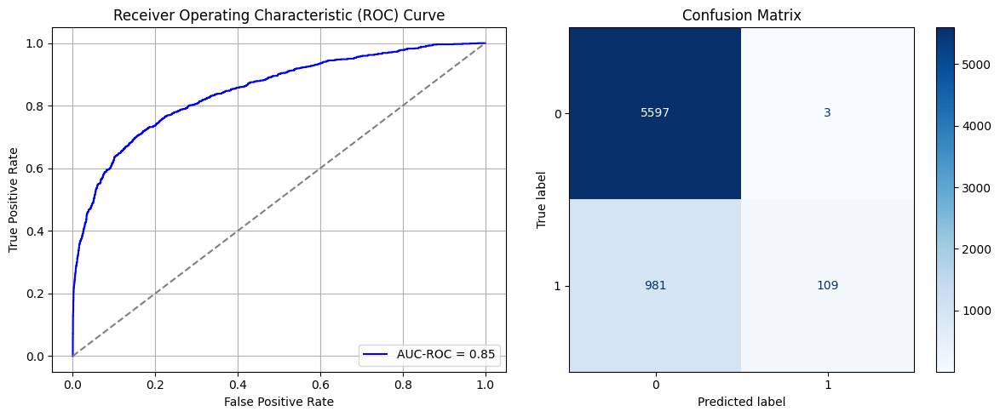

Best threshold based on F1-score: 0.023243173956871033
False Negative Rate: 0.9
Time elapsed (performance): 1.7123243569985789
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6042 - loss: 0.4622 - val_AUC: 0.8008 - val_loss: 0.3783
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8123 - loss: 0.3585 - val_AUC: 0.8637 - val_loss: 0.3269
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8648 - loss: 0.3075 - val_AUC: 0.8826 - val_loss: 0.3828
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8835 - loss: 0.2870 - val_AUC: 0.9081 - val_loss: 0.2837
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9037 - loss: 0.2660 - val_AUC: 0.9193 - val_loss: 0.2583
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9263 - loss: 0.2419 - val_AUC: 0.9337 - val_loss: 0.2342
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9366 - loss: 0.2190 - val_AUC: 0.9424 - val_loss: 0.2155
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9473 - loss: 0.2010 - val_AUC: 0.9494 - val_loss: 0.2069
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9468 -

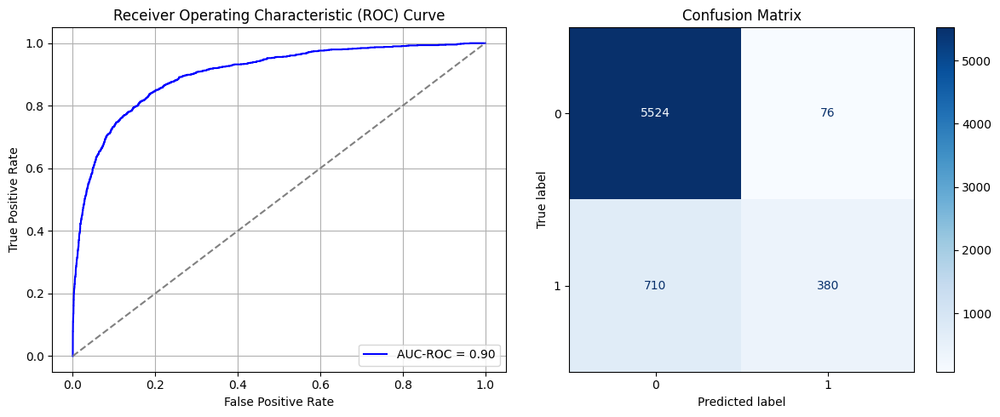

Best threshold based on F1-score: 0.1031126081943512
False Negative Rate: 0.6513761467889908
Time elapsed (performance): 1.238203467000858
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6132 - loss: 0.4538 - val_AUC: 0.8159 - val_loss: 0.3651
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8337 - loss: 0.3481 - val_AUC: 0.8709 - val_loss: 0.3120
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8811 - loss: 0.2957 - val_AUC: 0.8932 - val_loss: 0.2850
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9010 - loss: 0.2765 - val_AUC: 0.9140 - val_loss: 0.2611
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9172 - loss: 0.2471 - val_AUC: 0.9257 - val_loss: 0.2471
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9391 - loss: 0.2222 - val_AUC: 0.9357 - val_loss: 0.2251
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9406 - loss: 0.2183 - val_AUC: 0.9409 - val_loss: 0.2147
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9469 - loss: 0.2066 - val_AUC: 0.9483 - val_loss: 0.2030
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9459 -

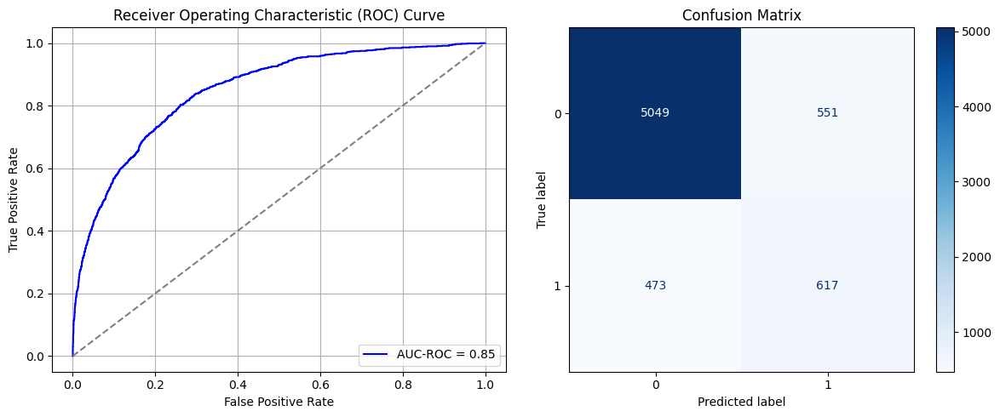

Best threshold based on F1-score: 0.4986277222633362
False Negative Rate: 0.43394495412844036
Time elapsed (performance): 1.0252584369991382
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.5973 - loss: 0.4775 - val_AUC: 0.8157 - val_loss: 0.3608
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8289 - loss: 0.3457 - val_AUC: 0.8671 - val_loss: 0.3154
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8695 - loss: 0.3039 - val_AUC: 0.8923 - val_loss: 0.2836
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8967 - loss: 0.2765 - val_AUC: 0.8985 - val_loss: 0.2735
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9145 - loss: 0.2528 - val_AUC: 0.9240 - val_loss: 0.2471
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9164 - loss: 0.2488 - val_AUC: 0.9355 - val_loss: 0.2565
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9357 - loss: 0.2242 - val_AUC: 0.9406 - val_loss: 0.2180
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9418 - loss: 0.2158 - val_AUC: 0.9492 - val_loss: 0.2087
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9489 -

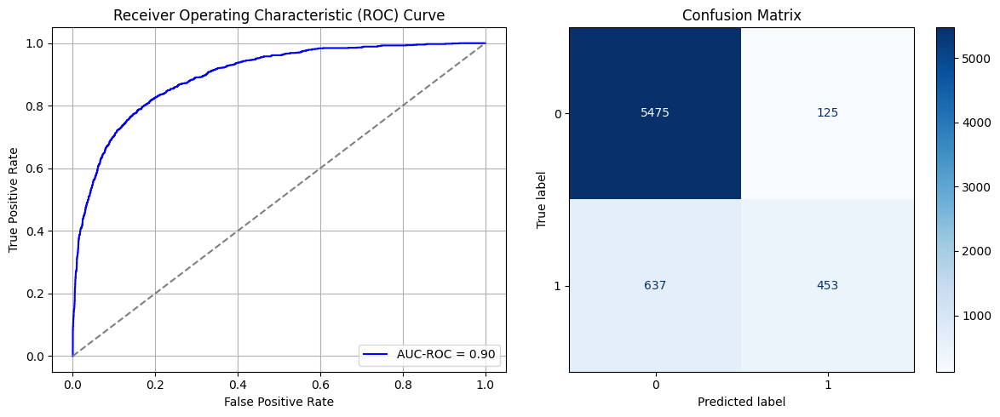

Best threshold based on F1-score: 0.2363296002149582
False Negative Rate: 0.5844036697247706
Time elapsed (performance): 1.3267889890012157
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6175 - loss: 0.4287 - val_AUC: 0.8242 - val_loss: 0.3569
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8325 - loss: 0.3455 - val_AUC: 0.8592 - val_loss: 0.3170
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8635 - loss: 0.3102 - val_AUC: 0.8693 - val_loss: 0.3056
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8812 - loss: 0.2897 - val_AUC: 0.8900 - val_loss: 0.2815
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8947 - loss: 0.2754 - val_AUC: 0.9048 - val_loss: 0.2807
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9083 - loss: 0.2578 - val_AUC: 0.9129 - val_loss: 0.2636
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9203 - loss: 0.2433 - val_AUC: 0.9298 - val_loss: 0.2304
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9364 - loss: 0.2210 - val_AUC: 0.9379 - val_loss: 0.2217
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9411 -

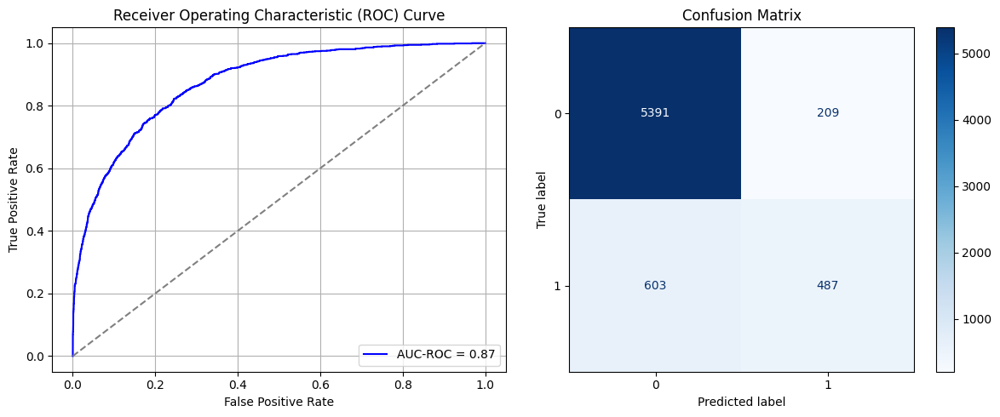

Best threshold based on F1-score: 0.28747931122779846
False Negative Rate: 0.5532110091743119
Time elapsed (performance): 1.0068386969978746
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.5695 - loss: 0.4925 - val_AUC: 0.8068 - val_loss: 0.3710
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8175 - loss: 0.3549 - val_AUC: 0.8622 - val_loss: 0.3179
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8674 - loss: 0.3096 - val_AUC: 0.8895 - val_loss: 0.2835
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8954 - loss: 0.2786 - val_AUC: 0.9069 - val_loss: 0.2655
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9112 - loss: 0.2530 - val_AUC: 0.9256 - val_loss: 0.2404
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9358 - loss: 0.2275 - val_AUC: 0.9341 - val_loss: 0.2351
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9384 - loss: 0.2193 - val_AUC: 0.9406 - val_loss: 0.2114
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9501 - loss: 0.1979 - val_AUC: 0.9501 - val_loss: 0.2362
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9540 -

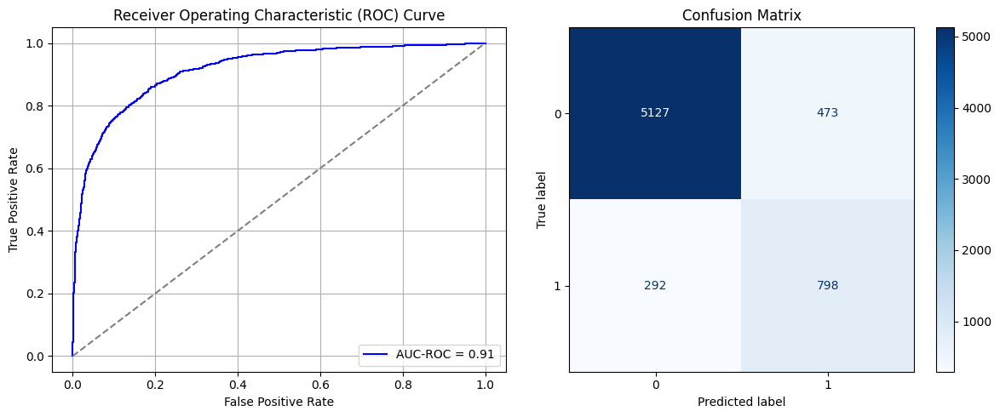

Best threshold based on F1-score: 0.5531725287437439
False Negative Rate: 0.26788990825688075
Time elapsed (performance): 0.8059332860029826
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6284 - loss: 0.4526 - val_AUC: 0.8221 - val_loss: 0.3635
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8303 - loss: 0.3503 - val_AUC: 0.8692 - val_loss: 0.3130
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8724 - loss: 0.3050 - val_AUC: 0.8911 - val_loss: 0.2867
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8970 - loss: 0.2762 - val_AUC: 0.9030 - val_loss: 0.2961
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9088 - loss: 0.2619 - val_AUC: 0.9151 - val_loss: 0.2541
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9235 - loss: 0.2378 - val_AUC: 0.9290 - val_loss: 0.2469
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9398 - loss: 0.2211 - val_AUC: 0.9419 - val_loss: 0.2177
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9444 - loss: 0.2082 - val_AUC: 0.9502 - val_loss: 0.2014
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9505 -

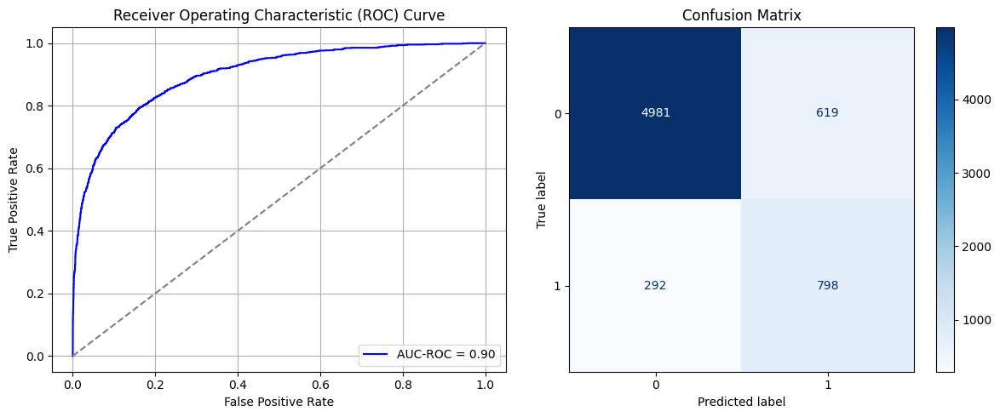

Best threshold based on F1-score: 0.6620119214057922
False Negative Rate: 0.26788990825688075
Time elapsed (performance): 0.7785514450006303
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6501 - loss: 0.4340 - val_AUC: 0.8114 - val_loss: 0.3660
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8147 - loss: 0.3564 - val_AUC: 0.8551 - val_loss: 0.3238
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8639 - loss: 0.3097 - val_AUC: 0.8768 - val_loss: 0.3216
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8900 - loss: 0.2795 - val_AUC: 0.9003 - val_loss: 0.2725
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9134 - loss: 0.2545 - val_AUC: 0.9223 - val_loss: 0.2717
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9295 - loss: 0.2313 - val_AUC: 0.9364 - val_loss: 0.2385
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9420 - loss: 0.2174 - val_AUC: 0.9394 - val_loss: 0.2141
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9469 - loss: 0.2010 - val_AUC: 0.9542 - val_loss: 0.1973
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9539 -

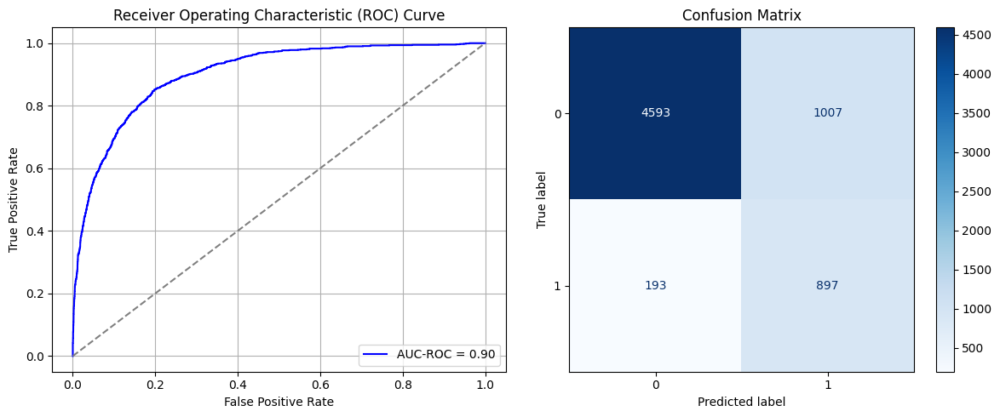

Best threshold based on F1-score: 0.6645511388778687
False Negative Rate: 0.17706422018348625
Time elapsed (performance): 1.6603336759981175
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6320 - loss: 0.4421 - val_AUC: 0.8243 - val_loss: 0.3553
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8340 - loss: 0.3389 - val_AUC: 0.8709 - val_loss: 0.3082
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8744 - loss: 0.3038 - val_AUC: 0.8947 - val_loss: 0.2796
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8942 - loss: 0.2749 - val_AUC: 0.9056 - val_loss: 0.2779
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9107 - loss: 0.2603 - val_AUC: 0.9188 - val_loss: 0.2469
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9258 - loss: 0.2387 - val_AUC: 0.9341 - val_loss: 0.2275
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9377 - loss: 0.2239 - val_AUC: 0.9428 - val_loss: 0.2175
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9438 - loss: 0.2087 - val_AUC: 0.9491 - val_loss: 0.2042
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9448 -

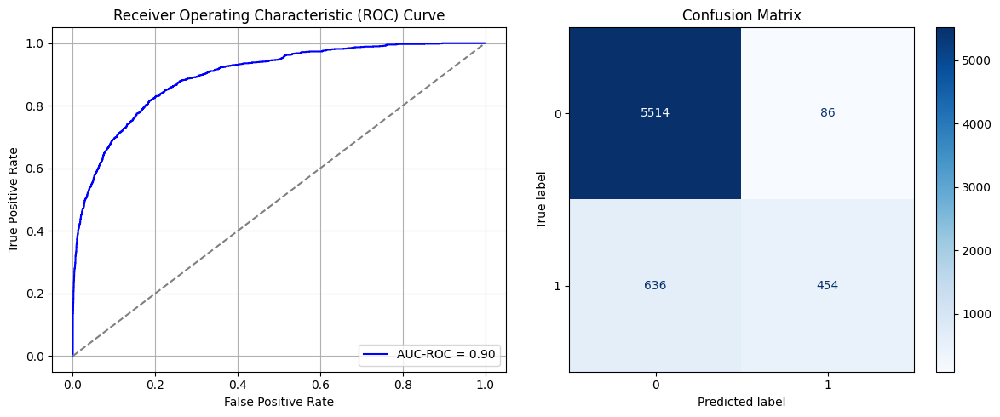

Best threshold based on F1-score: 0.1636897623538971
False Negative Rate: 0.5834862385321101
Time elapsed (performance): 0.7927878369991959
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.6165 - loss: 0.4414 - val_AUC: 0.8274 - val_loss: 0.3646
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8347 - loss: 0.3494 - val_AUC: 0.8692 - val_loss: 0.3188
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8674 - loss: 0.3138 - val_AUC: 0.8824 - val_loss: 0.3047
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8926 - loss: 0.2793 - val_AUC: 0.9035 - val_loss: 0.2743
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9092 - loss: 0.2610 - val_AUC: 0.9184 - val_loss: 0.2487
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9193 - loss: 0.2468 - val_AUC: 0.9306 - val_loss: 0.2354
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9330 - loss: 0.2290 - val_AUC: 0.9388 - val_loss: 0.2324
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9371 - loss: 0.2211 - val_AUC: 0.9495 - val_loss: 0.2014
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9505 -

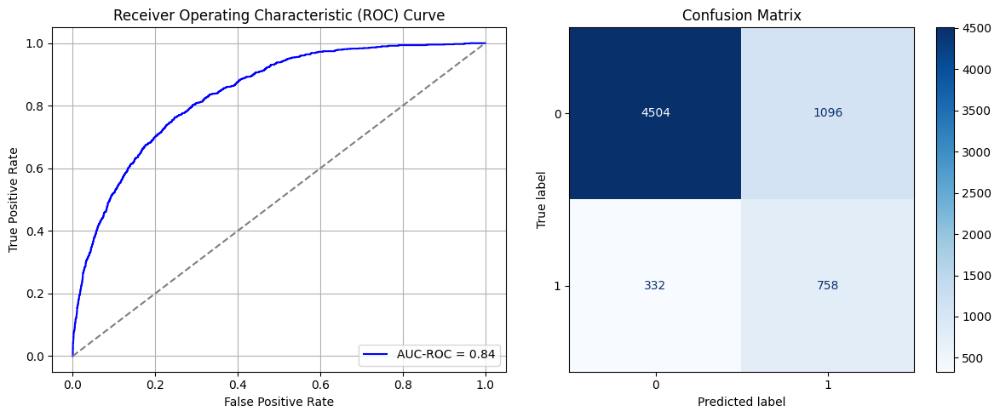

Best threshold based on F1-score: 0.6489295959472656
False Negative Rate: 0.30458715596330277
Time elapsed (performance): 1.0527018749999115
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6469 - loss: 0.4335 - val_AUC: 0.8316 - val_loss: 0.3526
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8431 - loss: 0.3389 - val_AUC: 0.8768 - val_loss: 0.3073
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8958 - loss: 0.2811 - val_AUC: 0.9018 - val_loss: 0.2796
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9056 - loss: 0.2577 - val_AUC: 0.9149 - val_loss: 0.2674
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9225 - loss: 0.2436 - val_AUC: 0.9316 - val_loss: 0.2335
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9328 - loss: 0.2273 - val_AUC: 0.9399 - val_loss: 0.2311
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9412 - loss: 0.2119 - val_AUC: 0.9483 - val_loss: 0.2075
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9484 - loss: 0.2018 - val_AUC: 0.9504 - val_loss: 0.1997
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9473 -

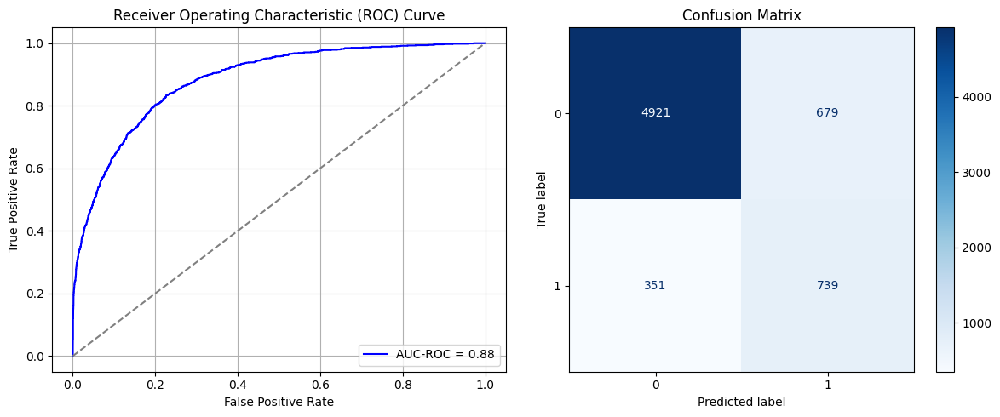

Best threshold based on F1-score: 0.6079395413398743
False Negative Rate: 0.3220183486238532
Time elapsed (performance): 2.789360654001939


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 10s 6ms/step - AUC: 0.6442 - loss: 0.4371 - val_AUC: 0.8241 - val_loss: 0.3633
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8368 - loss: 0.3418 - val_AUC: 0.8765 - val_loss: 0.3104
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.3014 - val_AUC: 0.8910 - val_loss: 0.2845
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9008 - loss: 0.2743 - val_AUC: 0.9146 - val_loss: 0.2551
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9148 - loss: 0.2495 - val_AUC: 0.9222 - val_loss: 0.2418
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9242 - loss: 0.2356 - val_AUC: 0.9311 - val_loss: 0.2374
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9420 - loss: 0.2115 - val_AUC: 0.9425 - val_loss: 0.2222
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9416 - loss: 0.2056 - val_AUC: 0.9461 - val_loss: 0.2231
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - A

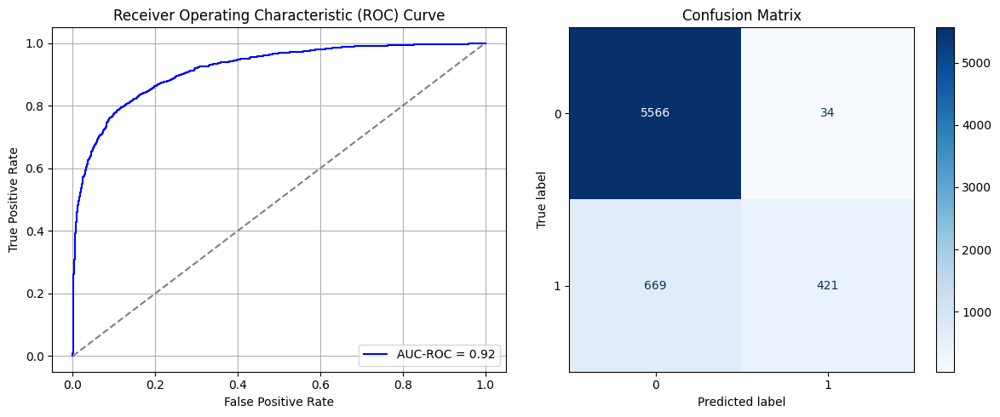

Best threshold based on F1-score: 0.12359622865915298
False Negative Rate: 0.6137614678899083
Time elapsed (performance): 1.092317484999512
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6041 - loss: 0.4737 - val_AUC: 0.8153 - val_loss: 0.3674
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8195 - loss: 0.3535 - val_AUC: 0.8665 - val_loss: 0.3210
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8653 - loss: 0.3112 - val_AUC: 0.8784 - val_loss: 0.3331
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8847 - loss: 0.2912 - val_AUC: 0.8912 - val_loss: 0.2971
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8942 - loss: 0.2759 - val_AUC: 0.9081 - val_loss: 0.2619
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9113 - loss: 0.2548 - val_AUC: 0.9184 - val_loss: 0.2780
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9200 - loss: 0.2499 - val_AUC: 0.9270 - val_loss: 0.2345
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9309 - loss: 0.2276 - val_AUC: 0.9384 - val_loss: 0.2248
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9445 -

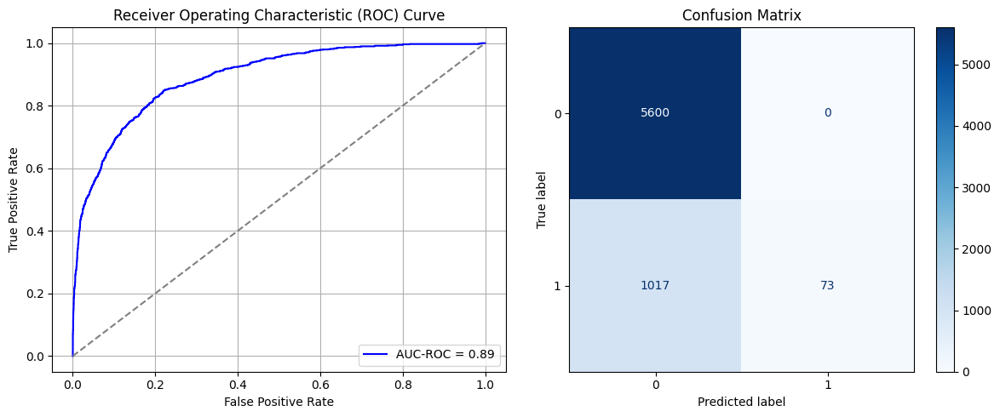

Best threshold based on F1-score: 0.010778904892504215
False Negative Rate: 0.9330275229357798
Time elapsed (performance): 1.231311827999889
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6439 - loss: 0.4511 - val_AUC: 0.8288 - val_loss: 0.3537
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8389 - loss: 0.3387 - val_AUC: 0.8855 - val_loss: 0.2921
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8986 - loss: 0.2746 - val_AUC: 0.9103 - val_loss: 0.2627
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9199 - loss: 0.2538 - val_AUC: 0.9287 - val_loss: 0.2343
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9355 - loss: 0.2247 - val_AUC: 0.9377 - val_loss: 0.2208
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9417 - loss: 0.2124 - val_AUC: 0.9452 - val_loss: 0.2061
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9462 - loss: 0.2029 - val_AUC: 0.9493 - val_loss: 0.2199
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9492 - loss: 0.1940 - val_AUC: 0.9526 - val_loss: 0.2394
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9534 -

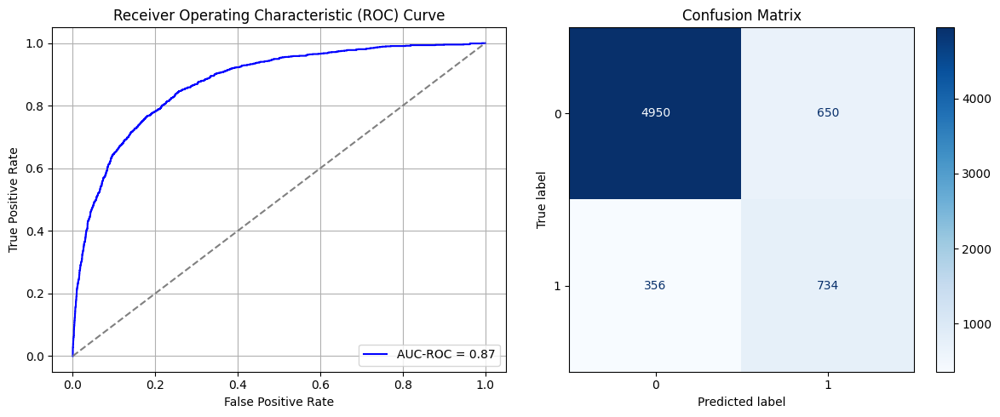

Best threshold based on F1-score: 0.5695849061012268
False Negative Rate: 0.326605504587156
Time elapsed (performance): 1.053924152001855
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.5920 - loss: 0.4614 - val_AUC: 0.8050 - val_loss: 0.3736
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8189 - loss: 0.3522 - val_AUC: 0.8664 - val_loss: 0.3110
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8753 - loss: 0.3039 - val_AUC: 0.8834 - val_loss: 0.2894
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8974 - loss: 0.2751 - val_AUC: 0.9132 - val_loss: 0.2964
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9207 - loss: 0.2480 - val_AUC: 0.9325 - val_loss: 0.2387
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9362 - loss: 0.2245 - val_AUC: 0.9428 - val_loss: 0.2116
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9420 - loss: 0.2135 - val_AUC: 0.9510 - val_loss: 0.1979
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9516 - loss: 0.1925 - val_AUC: 0.9495 - val_loss: 0.2492
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9527 -

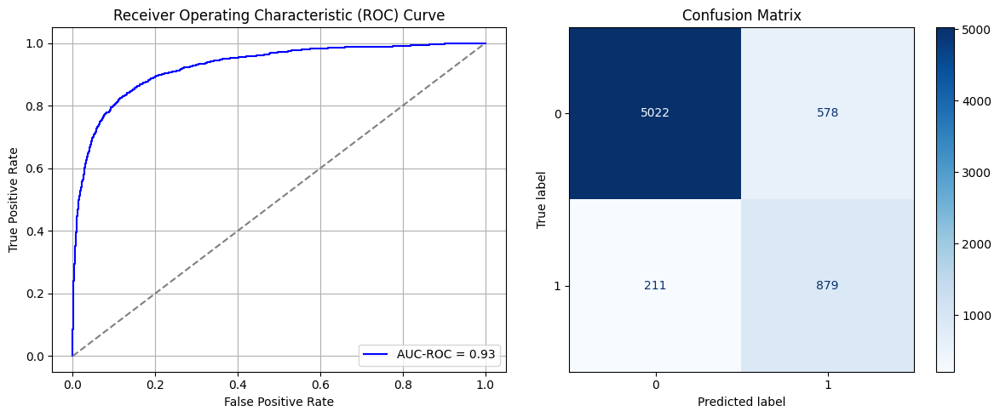

Best threshold based on F1-score: 0.7168839573860168
False Negative Rate: 0.19357798165137616
Time elapsed (performance): 0.8047392670014233
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6062 - loss: 0.4531 - val_AUC: 0.8095 - val_loss: 0.3870
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8265 - loss: 0.3454 - val_AUC: 0.8672 - val_loss: 0.3136
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.3128 - val_AUC: 0.8879 - val_loss: 0.2880
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9021 - loss: 0.2726 - val_AUC: 0.9050 - val_loss: 0.2676
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9142 - loss: 0.2603 - val_AUC: 0.9184 - val_loss: 0.2482
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9250 - loss: 0.2388 - val_AUC: 0.9295 - val_loss: 0.2315
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9373 - loss: 0.2197 - val_AUC: 0.9401 - val_loss: 0.2180
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9415 - loss: 0.2181 - val_AUC: 0.9470 - val_loss: 0.2070
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9485 -

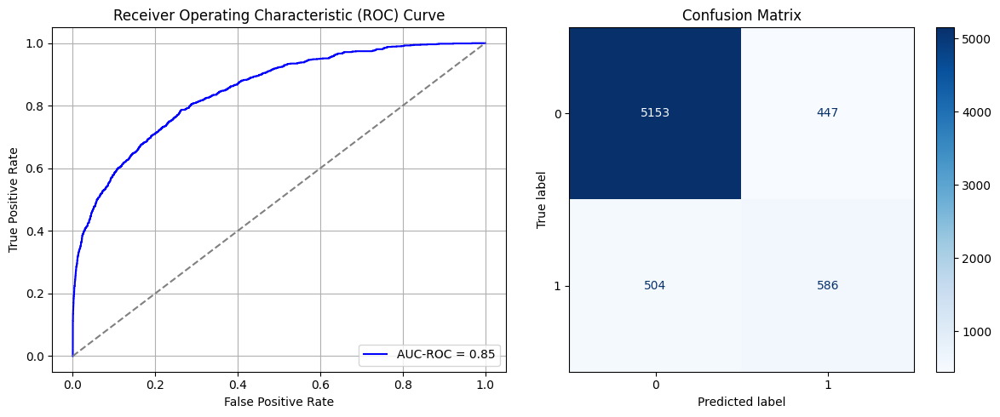

Best threshold based on F1-score: 0.44224482774734497
False Negative Rate: 0.46238532110091746
Time elapsed (performance): 1.0389214620008715
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6286 - loss: 0.4435 - val_AUC: 0.8232 - val_loss: 0.3574
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8344 - loss: 0.3338 - val_AUC: 0.8702 - val_loss: 0.3149
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8766 - loss: 0.2998 - val_AUC: 0.8975 - val_loss: 0.2758
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9004 - loss: 0.2690 - val_AUC: 0.9146 - val_loss: 0.2584
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9191 - loss: 0.2508 - val_AUC: 0.9293 - val_loss: 0.2579
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9201 - loss: 0.2456 - val_AUC: 0.9358 - val_loss: 0.2477
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9285 - loss: 0.2292 - val_AUC: 0.9460 - val_loss: 0.2287
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9459 - loss: 0.2111 - val_AUC: 0.9501 - val_loss: 0.2015
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9480 -

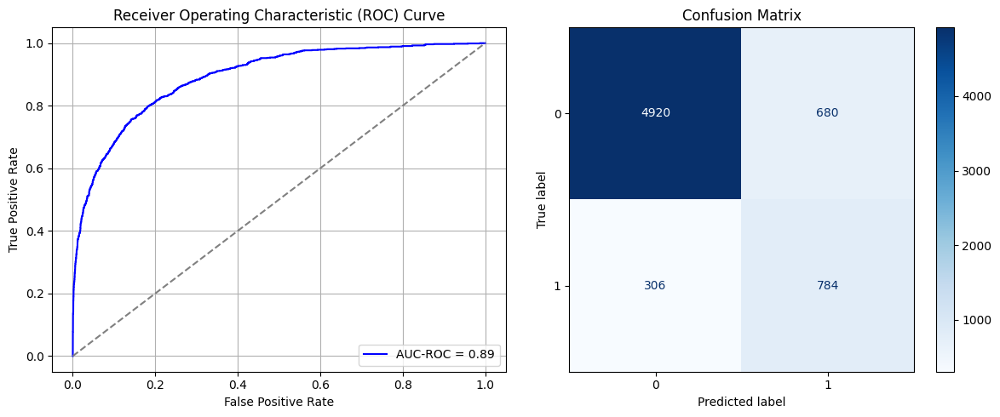

Best threshold based on F1-score: 0.6737479567527771
False Negative Rate: 0.28073394495412846
Time elapsed (performance): 1.0419579270019312
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.5984 - loss: 0.4553 - val_AUC: 0.8120 - val_loss: 0.3671
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8312 - loss: 0.3541 - val_AUC: 0.8728 - val_loss: 0.3151
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8741 - loss: 0.3010 - val_AUC: 0.8878 - val_loss: 0.2842
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8962 - loss: 0.2799 - val_AUC: 0.9118 - val_loss: 0.2578
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9169 - loss: 0.2493 - val_AUC: 0.9262 - val_loss: 0.2445
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9318 - loss: 0.2277 - val_AUC: 0.9328 - val_loss: 0.2293
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9448 - loss: 0.2091 - val_AUC: 0.9415 - val_loss: 0.2146
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9454 - loss: 0.2041 - val_AUC: 0.9453 - val_loss: 0.2200
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9547 -

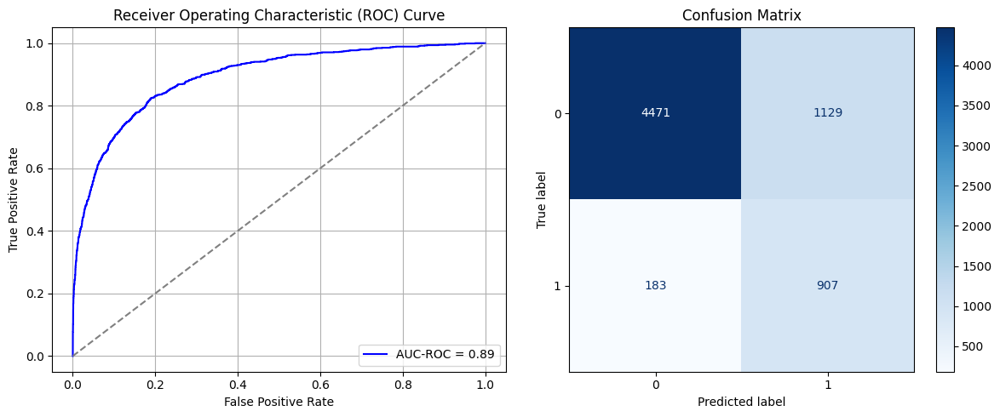

Best threshold based on F1-score: 0.7591239809989929
False Negative Rate: 0.16788990825688074
Time elapsed (performance): 0.8862598819978302
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6009 - loss: 0.4442 - val_AUC: 0.8253 - val_loss: 0.3590
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8157 - loss: 0.3554 - val_AUC: 0.8702 - val_loss: 0.3156
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8678 - loss: 0.2979 - val_AUC: 0.8845 - val_loss: 0.2955
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8975 - loss: 0.2748 - val_AUC: 0.9100 - val_loss: 0.2680
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9125 - loss: 0.2573 - val_AUC: 0.9273 - val_loss: 0.2426
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9308 - loss: 0.2320 - val_AUC: 0.9397 - val_loss: 0.2181
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9409 - loss: 0.2134 - val_AUC: 0.9481 - val_loss: 0.2094
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9509 - loss: 0.1984 - val_AUC: 0.9506 - val_loss: 0.1974
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9491 -

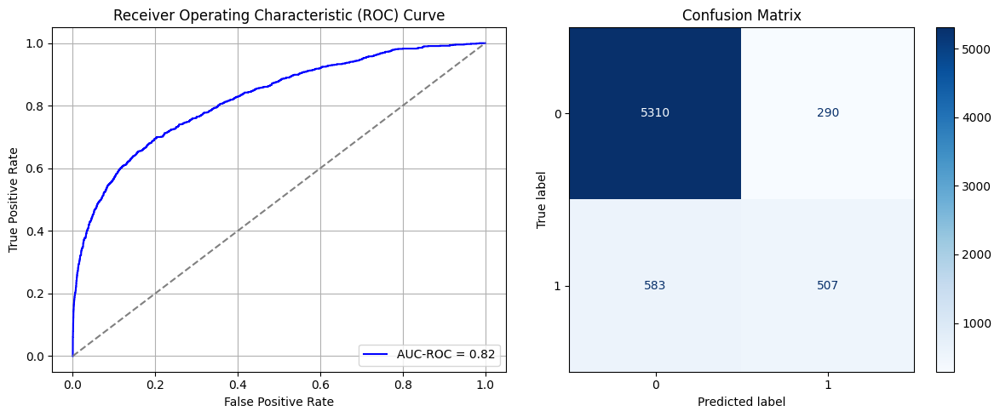

Best threshold based on F1-score: 0.37918269634246826
False Negative Rate: 0.5348623853211009
Time elapsed (performance): 1.2585212140002113
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6263 - loss: 0.4439 - val_AUC: 0.8175 - val_loss: 0.3619
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8365 - loss: 0.3414 - val_AUC: 0.8759 - val_loss: 0.3047
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8795 - loss: 0.2871 - val_AUC: 0.9033 - val_loss: 0.2708
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9071 - loss: 0.2669 - val_AUC: 0.9208 - val_loss: 0.2486
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9227 - loss: 0.2429 - val_AUC: 0.9319 - val_loss: 0.2364
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9242 - loss: 0.2415 - val_AUC: 0.9358 - val_loss: 0.2200
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9396 - loss: 0.2144 - val_AUC: 0.9489 - val_loss: 0.2022
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9447 - loss: 0.2039 - val_AUC: 0.9505 - val_loss: 0.2045
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9516 -

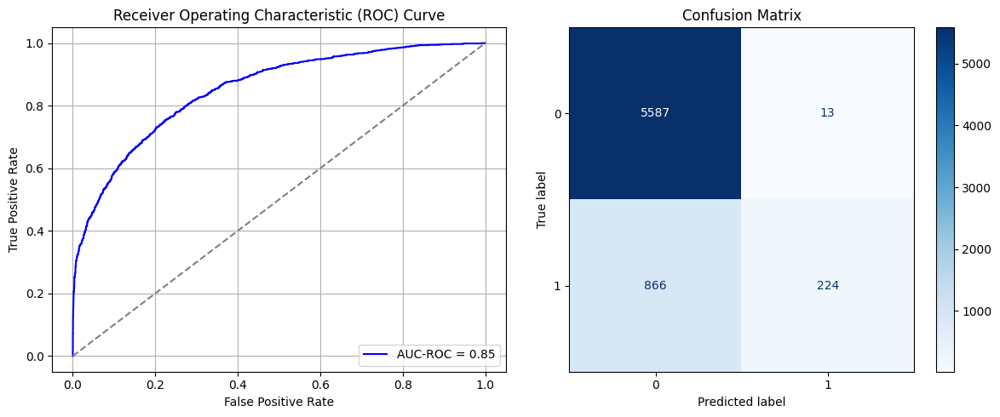

Best threshold based on F1-score: 0.03692168742418289
False Negative Rate: 0.7944954128440367
Time elapsed (performance): 1.2470000250032172
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6009 - loss: 0.4698 - val_AUC: 0.7975 - val_loss: 0.3869
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8027 - loss: 0.3639 - val_AUC: 0.8501 - val_loss: 0.3547
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8532 - loss: 0.3266 - val_AUC: 0.8711 - val_loss: 0.3053
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8761 - loss: 0.2998 - val_AUC: 0.8975 - val_loss: 0.2768
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8987 - loss: 0.2714 - val_AUC: 0.9091 - val_loss: 0.2636
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9213 - loss: 0.2469 - val_AUC: 0.9257 - val_loss: 0.2418
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9281 - loss: 0.2399 - val_AUC: 0.9398 - val_loss: 0.2277
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9419 - loss: 0.2159 - val_AUC: 0.9451 - val_loss: 0.2225
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9505 -

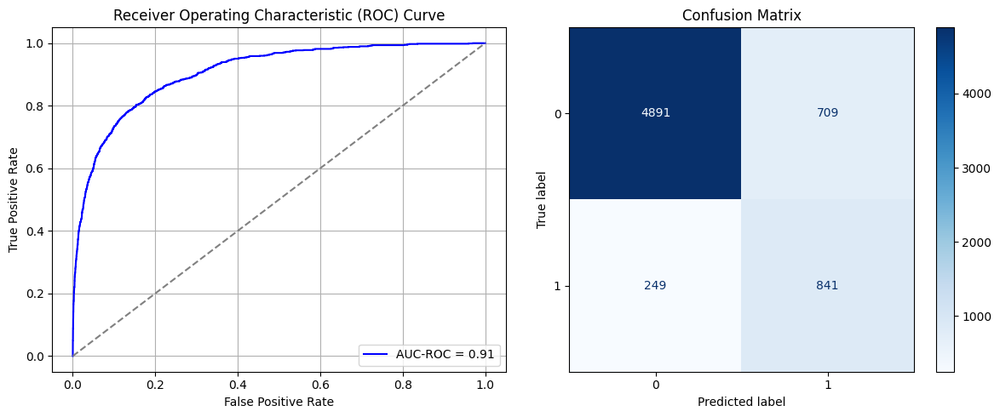

Best threshold based on F1-score: 0.6839702725410461
False Negative Rate: 0.22844036697247708
Time elapsed (performance): 1.1911959850003768
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6072 - loss: 0.4455 - val_AUC: 0.8220 - val_loss: 0.3591
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8244 - loss: 0.3433 - val_AUC: 0.8710 - val_loss: 0.3137
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8707 - loss: 0.3025 - val_AUC: 0.8906 - val_loss: 0.2871
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9058 - loss: 0.2687 - val_AUC: 0.9220 - val_loss: 0.2479
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9273 - loss: 0.2367 - val_AUC: 0.9332 - val_loss: 0.2370
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9370 - loss: 0.2232 - val_AUC: 0.9410 - val_loss: 0.2244
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9462 - loss: 0.2069 - val_AUC: 0.9523 - val_loss: 0.2014
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9525 - loss: 0.1937 - val_AUC: 0.9575 - val_loss: 0.1850
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9600 -

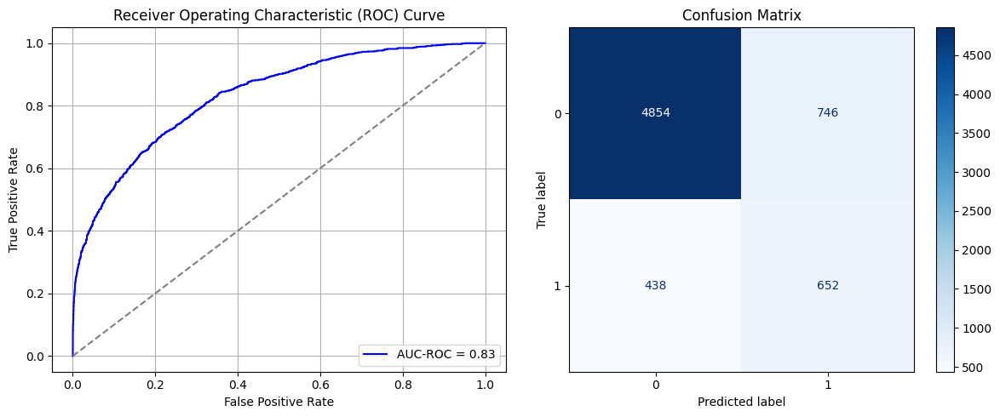

Best threshold based on F1-score: 0.5749090313911438
False Negative Rate: 0.4018348623853211
Time elapsed (performance): 0.868031988000439
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6467 - loss: 0.4340 - val_AUC: 0.8393 - val_loss: 0.3505
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8439 - loss: 0.3342 - val_AUC: 0.8750 - val_loss: 0.3096
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8849 - loss: 0.2859 - val_AUC: 0.9030 - val_loss: 0.2737
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9076 - loss: 0.2617 - val_AUC: 0.9237 - val_loss: 0.2449
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9268 - loss: 0.2323 - val_AUC: 0.9291 - val_loss: 0.2482
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9355 - loss: 0.2191 - val_AUC: 0.9436 - val_loss: 0.2157
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9428 - loss: 0.2101 - val_AUC: 0.9488 - val_loss: 0.2014
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9526 - loss: 0.1980 - val_AUC: 0.9505 - val_loss: 0.1994
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9524 -

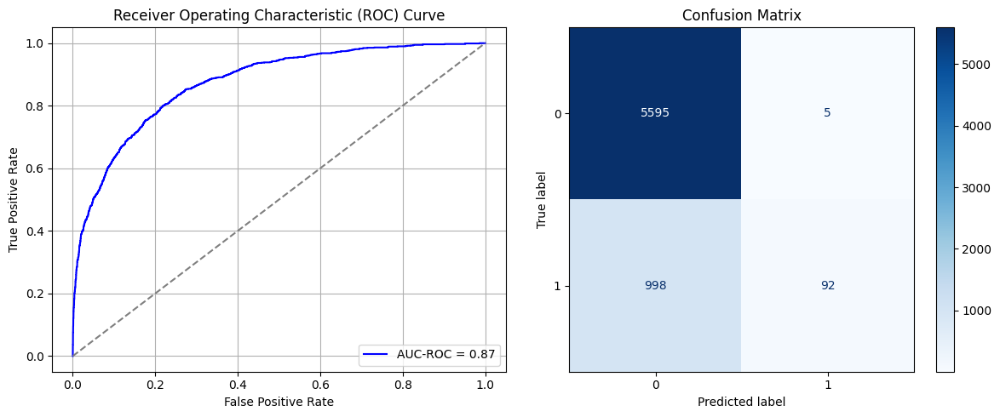

Best threshold based on F1-score: 0.016196753829717636
False Negative Rate: 0.9155963302752294
Time elapsed (performance): 0.822485496999434
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6637 - loss: 0.4323 - val_AUC: 0.8427 - val_loss: 0.3509
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8488 - loss: 0.3292 - val_AUC: 0.8739 - val_loss: 0.3094
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8782 - loss: 0.2976 - val_AUC: 0.8882 - val_loss: 0.3139
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9001 - loss: 0.2742 - val_AUC: 0.9180 - val_loss: 0.2604
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9252 - loss: 0.2448 - val_AUC: 0.9312 - val_loss: 0.2317
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9328 - loss: 0.2283 - val_AUC: 0.9428 - val_loss: 0.2321
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9417 - loss: 0.2090 - val_AUC: 0.9495 - val_loss: 0.2100
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9484 - loss: 0.2039 - val_AUC: 0.9555 - val_loss: 0.1895
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9563 -

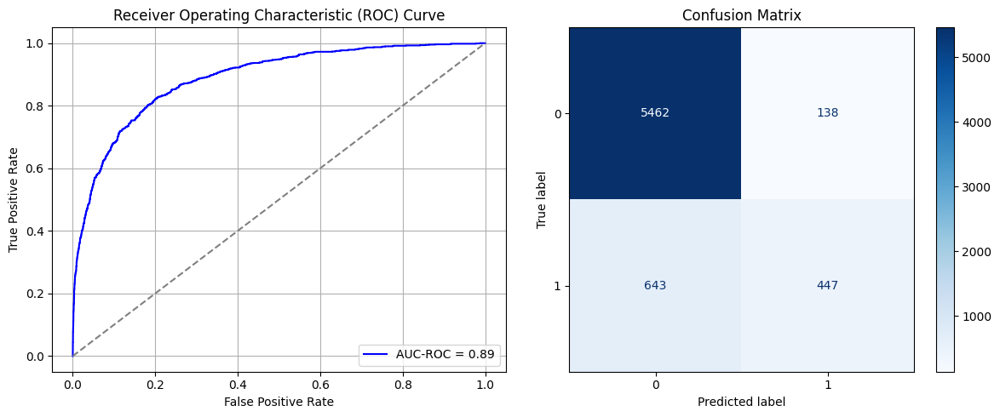

Best threshold based on F1-score: 0.19495399296283722
False Negative Rate: 0.5899082568807339
Time elapsed (performance): 1.0385213019981165
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.5972 - loss: 0.4610 - val_AUC: 0.8083 - val_loss: 0.3733
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8258 - loss: 0.3598 - val_AUC: 0.8615 - val_loss: 0.3247
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8656 - loss: 0.3101 - val_AUC: 0.8796 - val_loss: 0.2946
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8948 - loss: 0.2815 - val_AUC: 0.8971 - val_loss: 0.2734
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9059 - loss: 0.2647 - val_AUC: 0.9189 - val_loss: 0.2536
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9229 - loss: 0.2456 - val_AUC: 0.9308 - val_loss: 0.2444
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9328 - loss: 0.2262 - val_AUC: 0.9398 - val_loss: 0.2144
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9463 - loss: 0.2070 - val_AUC: 0.9442 - val_loss: 0.2139
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9523 -

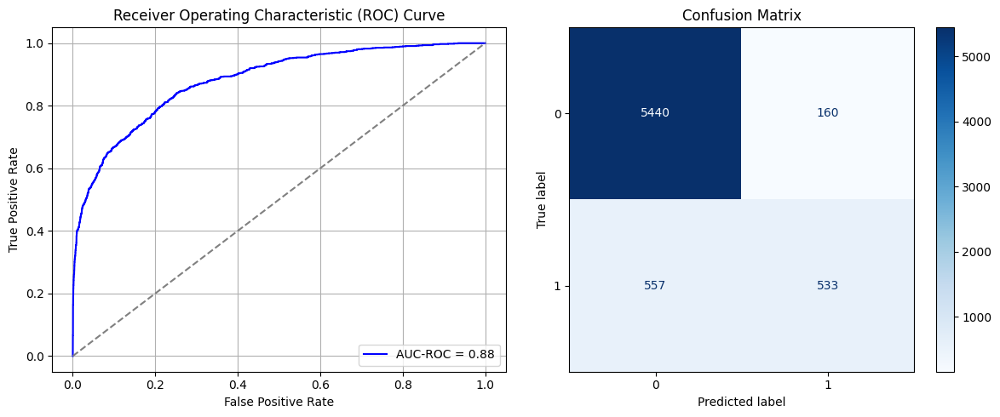

Best threshold based on F1-score: 0.2920052111148834
False Negative Rate: 0.5110091743119266
Time elapsed (performance): 0.8766186680004466
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.5682 - loss: 0.4620 - val_AUC: 0.7857 - val_loss: 0.3855
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8152 - loss: 0.3589 - val_AUC: 0.8570 - val_loss: 0.3290
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8546 - loss: 0.3123 - val_AUC: 0.8748 - val_loss: 0.3042
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8825 - loss: 0.2905 - val_AUC: 0.8919 - val_loss: 0.2882
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9000 - loss: 0.2733 - val_AUC: 0.9120 - val_loss: 0.2595
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9051 - loss: 0.2689 - val_AUC: 0.9129 - val_loss: 0.2740
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9267 - loss: 0.2351 - val_AUC: 0.9337 - val_loss: 0.2411
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9366 - loss: 0.2208 - val_AUC: 0.9371 - val_loss: 0.2370
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9389 -

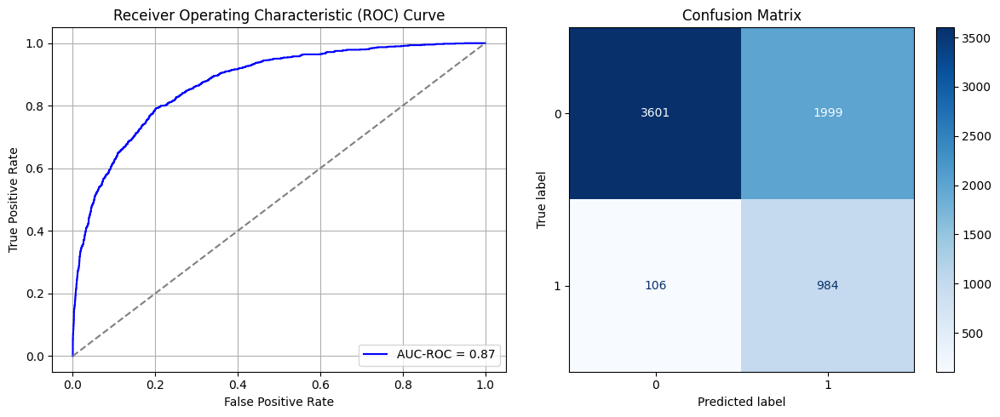

Best threshold based on F1-score: 0.8610213398933411
False Negative Rate: 0.09724770642201835
Time elapsed (performance): 1.0510449899993546
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.5932 - loss: 0.4784 - val_AUC: 0.8105 - val_loss: 0.3701
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8187 - loss: 0.3488 - val_AUC: 0.8653 - val_loss: 0.3128
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8640 - loss: 0.3082 - val_AUC: 0.8840 - val_loss: 0.2941
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8965 - loss: 0.2791 - val_AUC: 0.9036 - val_loss: 0.2676
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9103 - loss: 0.2559 - val_AUC: 0.9184 - val_loss: 0.2473
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9285 - loss: 0.2333 - val_AUC: 0.9300 - val_loss: 0.2375
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9318 - loss: 0.2263 - val_AUC: 0.9398 - val_loss: 0.2408
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9488 - loss: 0.2029 - val_AUC: 0.9465 - val_loss: 0.2055
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9499 -

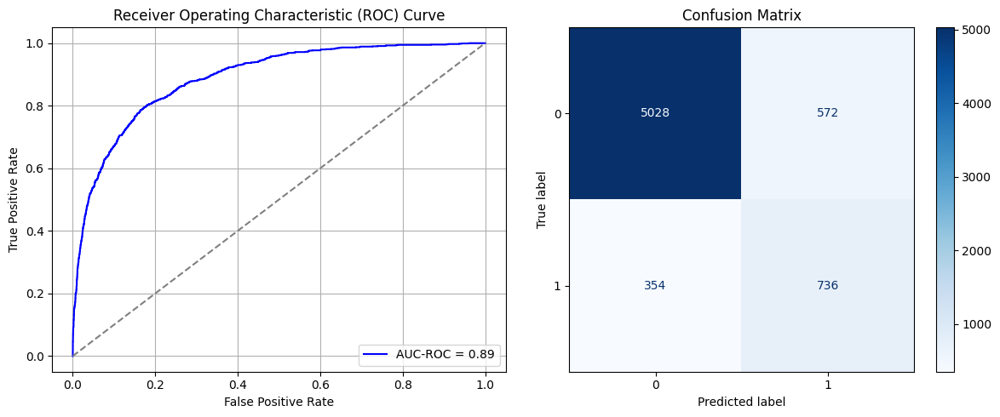

Best threshold based on F1-score: 0.580826461315155
False Negative Rate: 0.3247706422018349
Time elapsed (performance): 1.0493966889989679
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6096 - loss: 0.4595 - val_AUC: 0.8098 - val_loss: 0.3967
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8188 - loss: 0.3511 - val_AUC: 0.8627 - val_loss: 0.3206
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8720 - loss: 0.3044 - val_AUC: 0.8854 - val_loss: 0.2915
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8933 - loss: 0.2752 - val_AUC: 0.9082 - val_loss: 0.2645
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9157 - loss: 0.2532 - val_AUC: 0.9181 - val_loss: 0.2537
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9288 - loss: 0.2352 - val_AUC: 0.9353 - val_loss: 0.2470
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9397 - loss: 0.2199 - val_AUC: 0.9437 - val_loss: 0.2085
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9463 - loss: 0.2066 - val_AUC: 0.9491 - val_loss: 0.2035
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9521 -

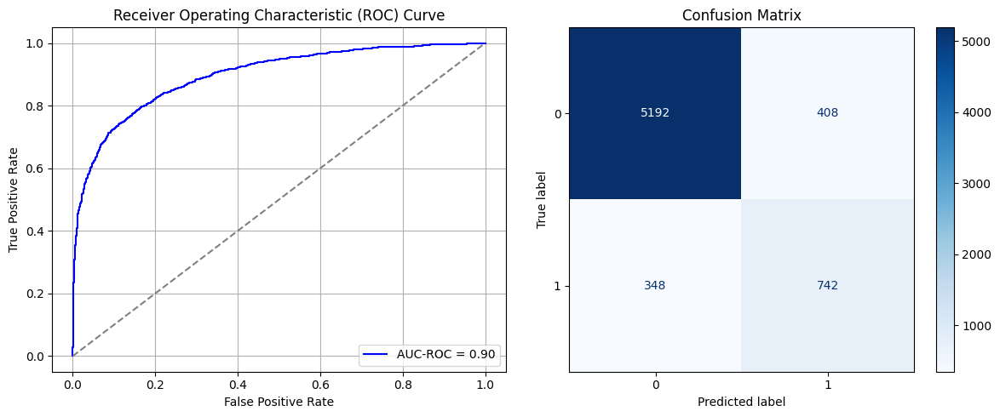

Best threshold based on F1-score: 0.5139467120170593
False Negative Rate: 0.3192660550458716
Time elapsed (performance): 1.7803055260010296
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6039 - loss: 0.4498 - val_AUC: 0.8189 - val_loss: 0.3629
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8344 - loss: 0.3458 - val_AUC: 0.8654 - val_loss: 0.3103
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8832 - loss: 0.2944 - val_AUC: 0.8937 - val_loss: 0.3305
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8921 - loss: 0.2771 - val_AUC: 0.9101 - val_loss: 0.2711
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9187 - loss: 0.2509 - val_AUC: 0.9305 - val_loss: 0.2371
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9311 - loss: 0.2355 - val_AUC: 0.9405 - val_loss: 0.2178
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9409 - loss: 0.2168 - val_AUC: 0.9460 - val_loss: 0.2361
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9496 - loss: 0.2034 - val_AUC: 0.9510 - val_loss: 0.2006
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9523 -

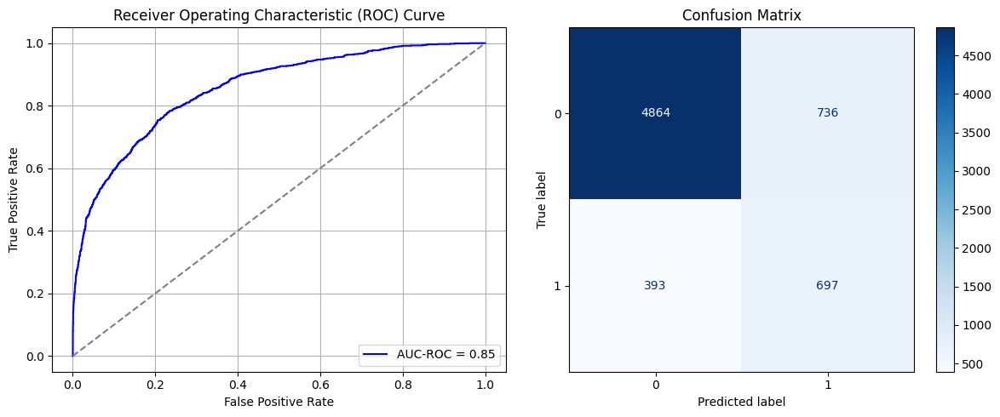

Best threshold based on F1-score: 0.6746172904968262
False Negative Rate: 0.3605504587155963
Time elapsed (performance): 1.248033742998814
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6079 - loss: 0.4654 - val_AUC: 0.8052 - val_loss: 0.3797
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8151 - loss: 0.3611 - val_AUC: 0.8662 - val_loss: 0.3426
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8753 - loss: 0.3046 - val_AUC: 0.8824 - val_loss: 0.2888
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8963 - loss: 0.2788 - val_AUC: 0.9045 - val_loss: 0.2682
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9156 - loss: 0.2485 - val_AUC: 0.9164 - val_loss: 0.2602
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9296 - loss: 0.2345 - val_AUC: 0.9270 - val_loss: 0.2447
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9334 - loss: 0.2266 - val_AUC: 0.9351 - val_loss: 0.2232
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9364 - loss: 0.2223 - val_AUC: 0.9407 - val_loss: 0.2159
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9491 -

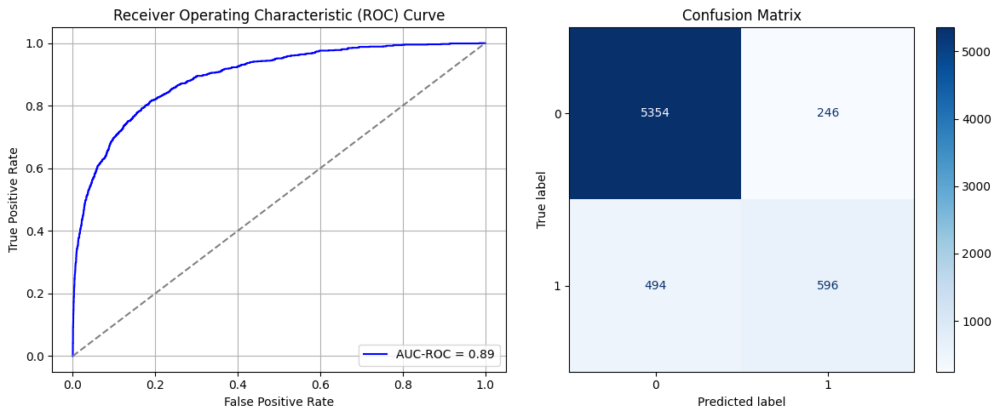

Best threshold based on F1-score: 0.4096784293651581
False Negative Rate: 0.45321100917431195
Time elapsed (performance): 1.233540463999816
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.5981 - loss: 0.4446 - val_AUC: 0.8154 - val_loss: 0.3636
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8311 - loss: 0.3423 - val_AUC: 0.8677 - val_loss: 0.3124
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8696 - loss: 0.3071 - val_AUC: 0.8941 - val_loss: 0.2812
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8977 - loss: 0.2737 - val_AUC: 0.9092 - val_loss: 0.2780
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9034 - loss: 0.2650 - val_AUC: 0.9255 - val_loss: 0.2409
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9310 - loss: 0.2313 - val_AUC: 0.9329 - val_loss: 0.2592
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9405 - loss: 0.2152 - val_AUC: 0.9460 - val_loss: 0.2071
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9458 - loss: 0.2074 - val_AUC: 0.9414 - val_loss: 0.2452
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9509 -

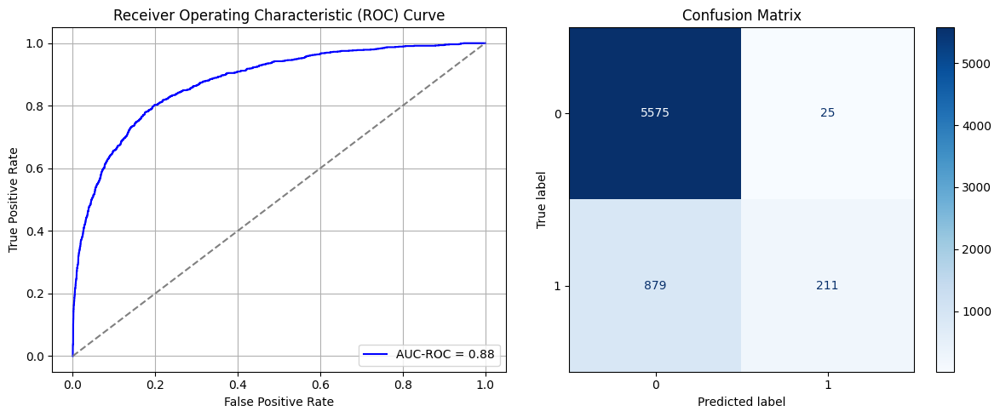

Best threshold based on F1-score: 0.04702364280819893
False Negative Rate: 0.8064220183486238
Time elapsed (performance): 1.2101602719994844
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6161 - loss: 0.4501 - val_AUC: 0.8264 - val_loss: 0.3588
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8300 - loss: 0.3450 - val_AUC: 0.8686 - val_loss: 0.3246
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8714 - loss: 0.3021 - val_AUC: 0.8897 - val_loss: 0.2871
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9013 - loss: 0.2715 - val_AUC: 0.9097 - val_loss: 0.2728
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9139 - loss: 0.2543 - val_AUC: 0.9150 - val_loss: 0.2544
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9238 - loss: 0.2404 - val_AUC: 0.9336 - val_loss: 0.2273
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9419 - loss: 0.2127 - val_AUC: 0.9418 - val_loss: 0.2604
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9443 - loss: 0.2083 - val_AUC: 0.9433 - val_loss: 0.2919
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9479 -

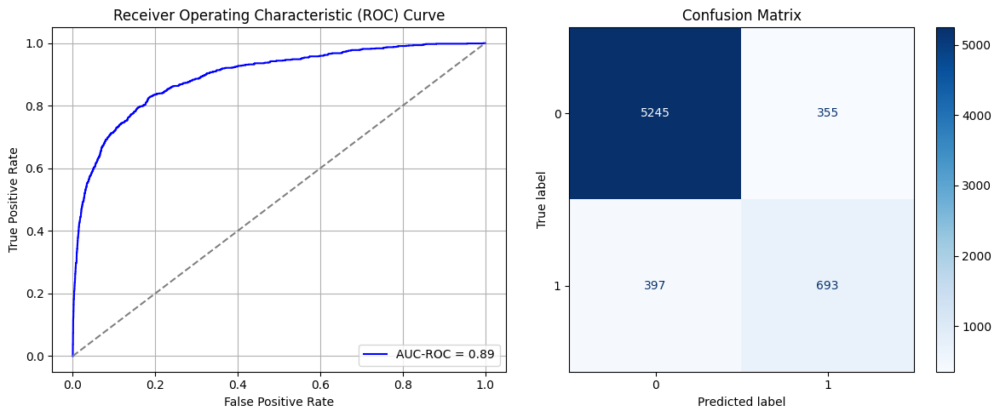

Best threshold based on F1-score: 0.461715430021286
False Negative Rate: 0.3642201834862385
Time elapsed (performance): 0.8723413609986892
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.6371 - loss: 0.4368 - val_AUC: 0.8395 - val_loss: 0.3468
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8533 - loss: 0.3282 - val_AUC: 0.8839 - val_loss: 0.3016
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8883 - loss: 0.2836 - val_AUC: 0.9064 - val_loss: 0.2714
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9076 - loss: 0.2640 - val_AUC: 0.9173 - val_loss: 0.2620
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9193 - loss: 0.2508 - val_AUC: 0.9307 - val_loss: 0.2395
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9282 - loss: 0.2391 - val_AUC: 0.9380 - val_loss: 0.2222
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9362 - loss: 0.2203 - val_AUC: 0.9433 - val_loss: 0.2100
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9496 - loss: 0.1983 - val_AUC: 0.9463 - val_loss: 0.2073
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9465 -

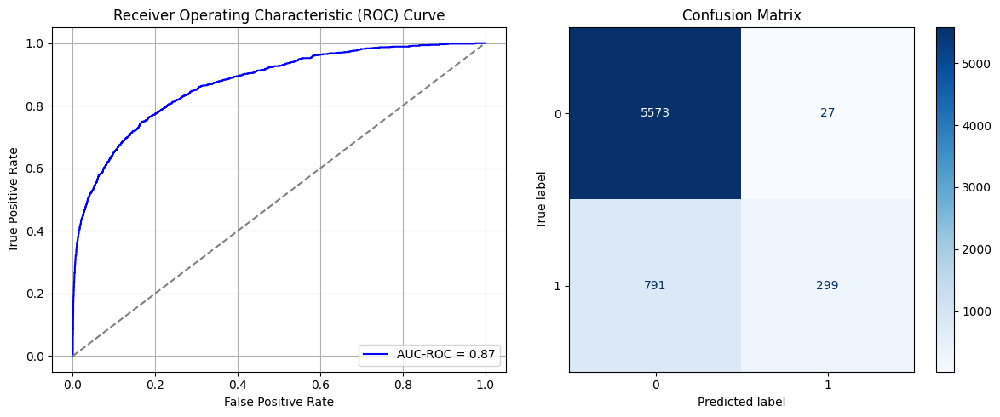

Best threshold based on F1-score: 0.09788067638874054
False Negative Rate: 0.7256880733944954
Time elapsed (performance): 1.0474010049983917
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6120 - loss: 0.4457 - val_AUC: 0.8224 - val_loss: 0.3593
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8248 - loss: 0.3402 - val_AUC: 0.8702 - val_loss: 0.3081
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8686 - loss: 0.3009 - val_AUC: 0.8939 - val_loss: 0.2803
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8921 - loss: 0.2790 - val_AUC: 0.9101 - val_loss: 0.2808
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9143 - loss: 0.2551 - val_AUC: 0.9309 - val_loss: 0.2465
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9318 - loss: 0.2281 - val_AUC: 0.9418 - val_loss: 0.2134
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9400 - loss: 0.2164 - val_AUC: 0.9474 - val_loss: 0.2081
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9490 - loss: 0.2026 - val_AUC: 0.9544 - val_loss: 0.1924
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9528 -

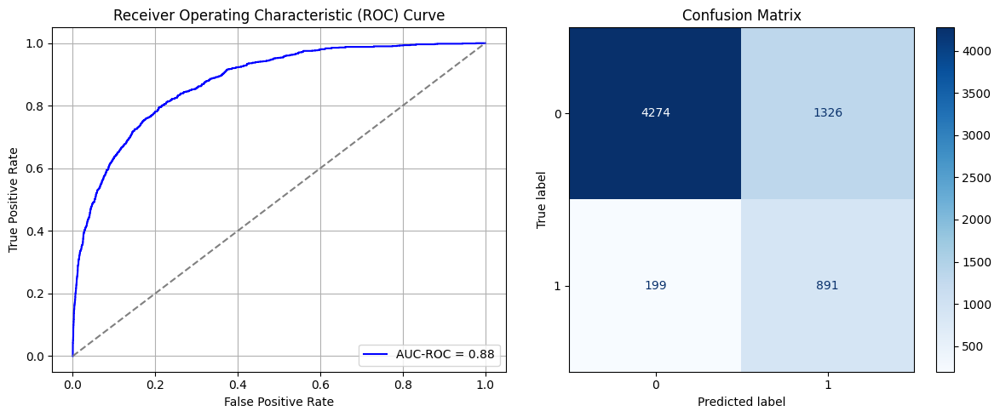

Best threshold based on F1-score: 0.8299664258956909
False Negative Rate: 0.18256880733944955
Time elapsed (performance): 0.9080239140021149
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.5962 - loss: 0.4565 - val_AUC: 0.7967 - val_loss: 0.3818
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8213 - loss: 0.3591 - val_AUC: 0.8517 - val_loss: 0.3302
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8627 - loss: 0.3152 - val_AUC: 0.8822 - val_loss: 0.2999
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8925 - loss: 0.2739 - val_AUC: 0.8971 - val_loss: 0.2732
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8981 - loss: 0.2741 - val_AUC: 0.9099 - val_loss: 0.2807
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9169 - loss: 0.2502 - val_AUC: 0.9152 - val_loss: 0.2828
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9258 - loss: 0.2340 - val_AUC: 0.9289 - val_loss: 0.2328
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9357 - loss: 0.2251 - val_AUC: 0.9376 - val_loss: 0.2204
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9467 -

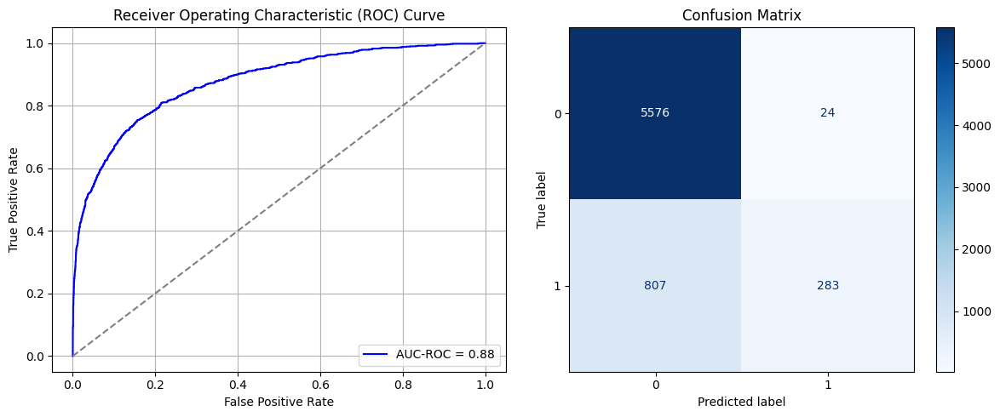

Best threshold based on F1-score: 0.10847119241952896
False Negative Rate: 0.7403669724770642
Time elapsed (performance): 0.9023134270028095
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6120 - loss: 0.4529 - val_AUC: 0.8237 - val_loss: 0.3801
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8290 - loss: 0.3422 - val_AUC: 0.8664 - val_loss: 0.3176
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8755 - loss: 0.2946 - val_AUC: 0.8894 - val_loss: 0.2866
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8994 - loss: 0.2728 - val_AUC: 0.9171 - val_loss: 0.2553
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9247 - loss: 0.2459 - val_AUC: 0.9308 - val_loss: 0.2437
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9304 - loss: 0.2354 - val_AUC: 0.9423 - val_loss: 0.2495
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9437 - loss: 0.2098 - val_AUC: 0.9513 - val_loss: 0.2172
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9510 - loss: 0.1932 - val_AUC: 0.9531 - val_loss: 0.1954
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.9572 -

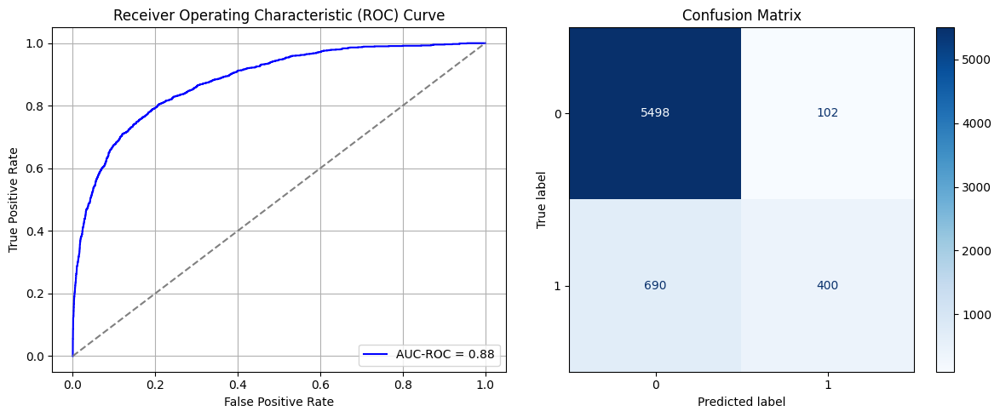

Best threshold based on F1-score: 0.16706153750419617
False Negative Rate: 0.6330275229357798
Time elapsed (performance): 0.9259131510007137
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


467/467 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6467 - loss: 0.4306 - val_AUC: 0.8224 - val_loss: 0.3606
Epoch 2/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8274 - loss: 0.3377 - val_AUC: 0.8687 - val_loss: 0.3102
Epoch 3/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8746 - loss: 0.3012 - val_AUC: 0.8919 - val_loss: 0.2862
Epoch 4/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.9023 - loss: 0.2694 - val_AUC: 0.9147 - val_loss: 0.2670
Epoch 5/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9184 - loss: 0.2518 - val_AUC: 0.9278 - val_loss: 0.2425
Epoch 6/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.9327 - loss: 0.2297 - val_AUC: 0.9360 - val_loss: 0.2226
Epoch 7/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9446 - loss: 0.2088 - val_AUC: 0.9436 - val_loss: 0.2125
Epoch 8/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9492 - loss: 0.1999 - val_AUC: 0.9545 - val_loss: 0.1972
Epoch 9/10
467/467 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9516 -

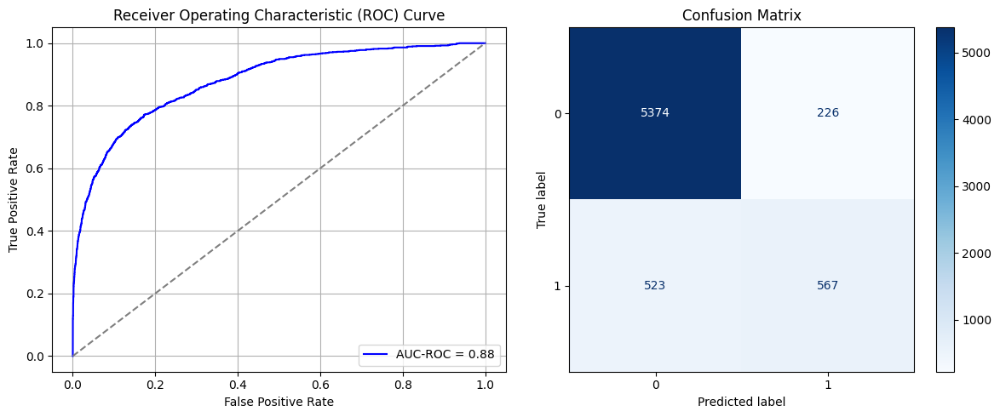

Best threshold based on F1-score: 0.3023240268230438
False Negative Rate: 0.4798165137614679
Time elapsed (performance): 0.8828167930005293


In [32]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)
    model_source = create_dnn_model(X_S_train.shape[1])
    result_imbalanced = train_and_evaluate(model_source, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_imbalanced = Transductive_TL(model_source, X_T_full, y_T_full, "Target")

    Training_time.append(result_imbalanced)
    FPR.append(result_TL_imbalanced[0])
    TNR.append(result_TL_imbalanced[1])
    FNR.append(result_TL_imbalanced[2])
    TPR.append(result_TL_imbalanced[3])
    TL_time.append(result_TL_imbalanced[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [33]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.47497247706422013
Variance: 0.048205659868526145


In [34]:
print(ParamFit)
ParamFit.to_csv('Imbalanced.csv')


    Source time       FPR       TPR       FNR       TNR  Target time
0     19.219129  0.038036  0.441284  0.558716  0.961964     1.020228
1     16.525314  0.018750  0.397248  0.602752  0.981250     0.735155
2     18.492016  0.020714  0.528440  0.471560  0.979286     0.747647
3     25.032075  0.267857  0.621101  0.378899  0.732143     0.746340
4     19.575501  0.166429  0.842202  0.157798  0.833571     0.808930
5     18.423937  0.065000  0.635780  0.364220  0.935000     0.736140
6     19.971683  0.054286  0.595413  0.404587  0.945714     1.237765
7     20.573696  0.103214  0.822018  0.177982  0.896786     0.748712
8     21.741249  0.085536  0.670642  0.329358  0.914464     0.761983
9     19.903209  0.009107  0.370642  0.629358  0.990893     1.077878
10    20.187739  0.009286  0.256881  0.743119  0.990714     0.755247
11    19.104715  0.008929  0.241284  0.758716  0.991071     1.010807
12    21.885814  0.009821  0.315596  0.684404  0.990179     1.026074
13    22.446551  0.000536  0.10000

# Random Undersampling (RUS) to balance Dataset:

## SRS Sample without Replacement:

In [35]:
data_S

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,Y
0,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.50,0.583333,0.476190,0.409091,0.380952,0.50,0.523810,0.541667,0.545455,0
1,1.0,1.0,1.0,1.0,0.0,0.5,0.5,0.5,0.666667,0.333333,...,0.45,0.541667,0.476190,0.500000,0.523810,0.40,0.571429,0.625000,0.454545,0
2,1.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.55,0.583333,0.619048,0.681818,0.571429,0.45,0.333333,0.416667,0.545455,0
3,1.0,1.0,1.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.666667,...,0.30,0.375000,0.523810,0.318182,0.619048,0.25,0.571429,0.541667,0.500000,0
4,1.0,1.0,0.0,1.0,1.0,0.5,0.5,0.5,0.333333,0.333333,...,0.50,0.500000,0.619048,0.500000,0.619048,0.55,0.476190,0.500000,0.454545,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23305,1.0,1.0,0.0,0.0,1.0,0.5,0.5,0.5,0.333333,0.666667,...,0.75,0.625000,0.619048,0.454545,0.523810,0.60,0.333333,0.541667,0.318182,1
23306,1.0,1.0,1.0,0.0,0.0,0.5,0.5,0.5,0.666667,0.333333,...,0.50,0.500000,0.476190,0.500000,0.523810,0.50,0.619048,0.541667,0.500000,1
23307,1.0,1.0,1.0,0.0,1.0,0.5,0.5,0.5,1.000000,0.666667,...,0.55,0.500000,0.666667,0.500000,0.714286,0.60,0.619048,0.375000,0.681818,1
23308,1.0,1.0,0.0,1.0,1.0,0.5,0.5,0.5,0.666667,0.333333,...,0.50,0.750000,0.428571,0.590909,0.619048,0.35,0.619048,0.416667,0.409091,1


In [36]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

3910
19400


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6071 - loss: 0.6674 - val_AUC: 0.8089 - val_loss: 0.5704
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7849 - loss: 0.5746 - val_AUC: 0.8603 - val_loss: 0.5025
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8271 - loss: 0.5264 - val_AUC: 0.8817 - val_loss: 0.4625
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8452 - loss: 0.4938 - val_AUC: 0.8963 - val_loss: 0.5058
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8686 - loss: 0.4609 - val_AUC: 0.9057 - val_loss: 0.4231
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8908 - loss: 0.4237 - val_AUC: 0.9143 - val_loss: 0.3959
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8920 - loss: 0.4191 - val_AUC: 0.9202 - val_loss: 0.3743
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8970 - loss: 0.4087 - val_AUC: 0.9280 - val_loss: 0.3768
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9060 -

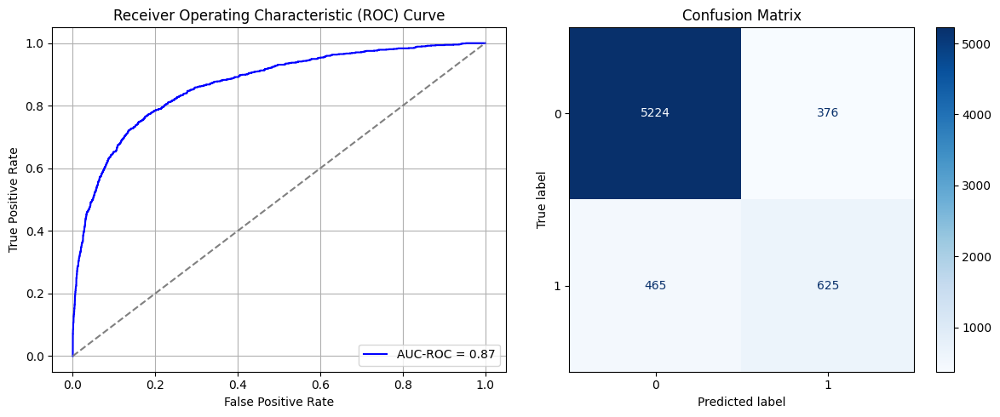

Best threshold based on F1-score: 0.4426545202732086
False Negative Rate: 0.42660550458715596
Time elapsed (performance): 0.7046061199980613
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.5638 - loss: 0.6931 - val_AUC: 0.7796 - val_loss: 0.6187
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7595 - loss: 0.5960 - val_AUC: 0.8394 - val_loss: 0.5351
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8251 - loss: 0.5237 - val_AUC: 0.8706 - val_loss: 0.4804
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8547 - loss: 0.4807 - val_AUC: 0.8872 - val_loss: 0.4490
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4443 - val_AUC: 0.8974 - val_loss: 0.4186
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8908 - loss: 0.4201 - val_AUC: 0.9099 - val_loss: 0.4000
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8995 - loss: 0.4058 - val_AUC: 0.9123 - val_loss: 0.4137
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8973 - loss: 0.4056 - val_AUC: 0.9228 - val_loss: 0.3694
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9184 -

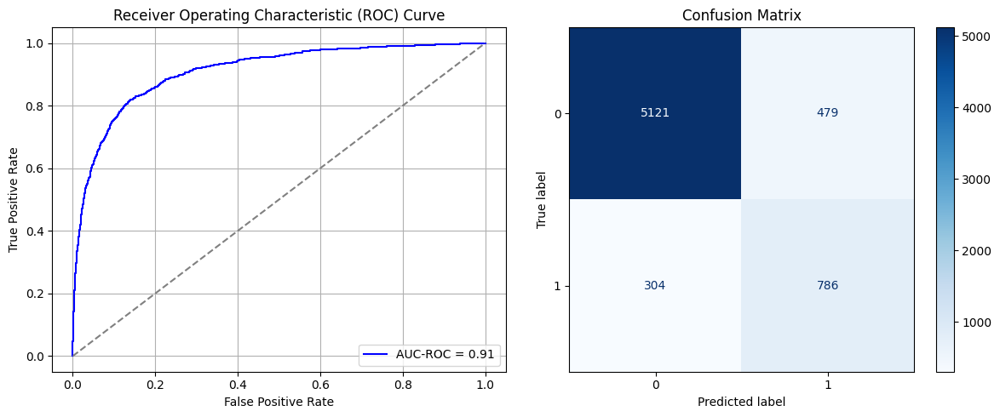

Best threshold based on F1-score: 0.48942145705223083
False Negative Rate: 0.27889908256880735
Time elapsed (performance): 0.7479653129994404
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6701 - loss: 0.6549 - val_AUC: 0.7992 - val_loss: 0.5710
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7852 - loss: 0.5697 - val_AUC: 0.8436 - val_loss: 0.5103
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8379 - loss: 0.5066 - val_AUC: 0.8687 - val_loss: 0.4832
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8625 - loss: 0.4689 - val_AUC: 0.8842 - val_loss: 0.4544
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8706 - loss: 0.4541 - val_AUC: 0.8968 - val_loss: 0.4344
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8723 - loss: 0.4492 - val_AUC: 0.9074 - val_loss: 0.3981
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8874 - loss: 0.4238 - val_AUC: 0.9139 - val_loss: 0.3837
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8968 - loss: 0.4080 - val_AUC: 0.9234 - val_loss: 0.3792
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9039 -

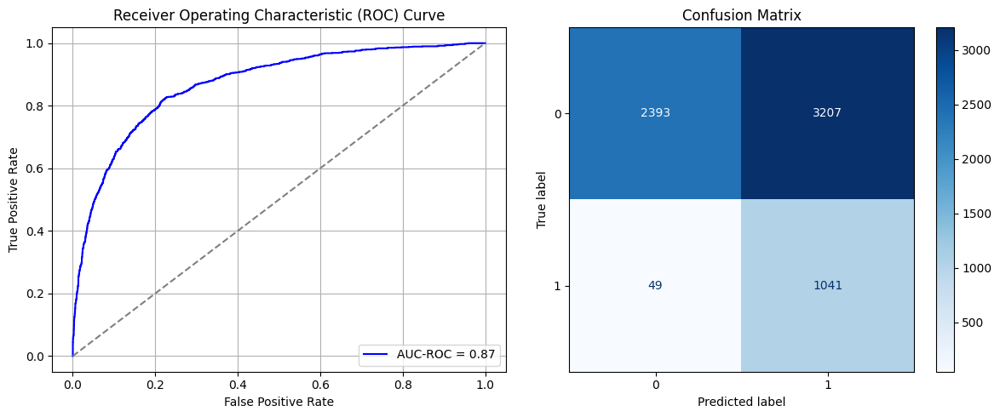

Best threshold based on F1-score: 0.8826305270195007
False Negative Rate: 0.044954128440366975
Time elapsed (performance): 1.066014030999213
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5867 - loss: 0.7102 - val_AUC: 0.7443 - val_loss: 0.6275
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7458 - loss: 0.6131 - val_AUC: 0.7989 - val_loss: 0.5690
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8099 - loss: 0.5519 - val_AUC: 0.8483 - val_loss: 0.5011
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8349 - loss: 0.5078 - val_AUC: 0.8698 - val_loss: 0.4846
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8597 - loss: 0.4744 - val_AUC: 0.8785 - val_loss: 0.4470
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8823 - loss: 0.4368 - val_AUC: 0.8853 - val_loss: 0.4444
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8925 - loss: 0.4200 - val_AUC: 0.8968 - val_loss: 0.4165
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9037 - loss: 0.3997 - val_AUC: 0.9055 - val_loss: 0.3997
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9100 -

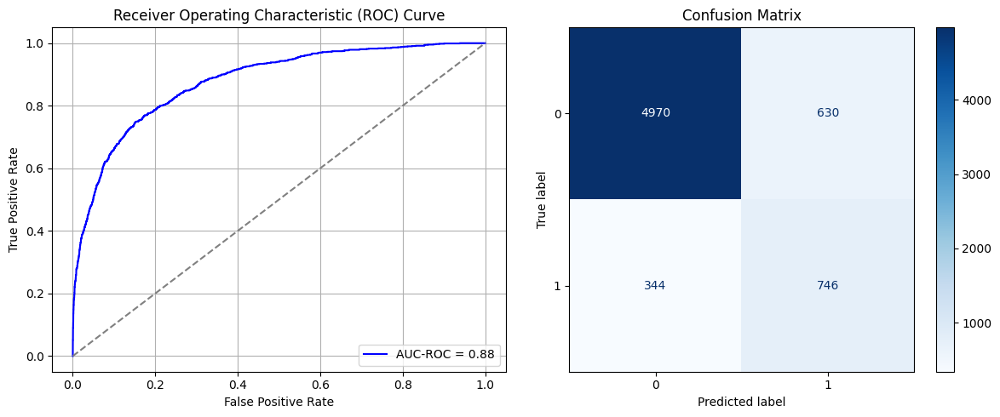

Best threshold based on F1-score: 0.5770972371101379
False Negative Rate: 0.3155963302752294
Time elapsed (performance): 0.7469627009995747
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6493 - loss: 0.6646 - val_AUC: 0.7960 - val_loss: 0.5956
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7809 - loss: 0.5730 - val_AUC: 0.8348 - val_loss: 0.5218
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8187 - loss: 0.5295 - val_AUC: 0.8640 - val_loss: 0.4973
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8592 - loss: 0.4772 - val_AUC: 0.8883 - val_loss: 0.4977
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8730 - loss: 0.4540 - val_AUC: 0.8999 - val_loss: 0.4163
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4401 - val_AUC: 0.9080 - val_loss: 0.3981
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9054 - loss: 0.3968 - val_AUC: 0.9228 - val_loss: 0.3837
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9165 - loss: 0.3752 - val_AUC: 0.9295 - val_loss: 0.3884
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9160 -

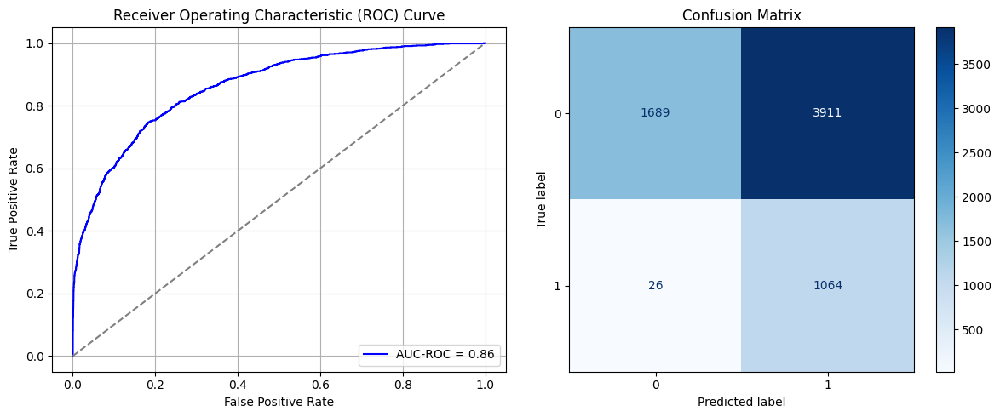

Best threshold based on F1-score: 0.9596046805381775
False Negative Rate: 0.023853211009174313
Time elapsed (performance): 0.7394883849992766
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6280 - loss: 0.6798 - val_AUC: 0.7596 - val_loss: 0.6096
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7513 - loss: 0.6023 - val_AUC: 0.8256 - val_loss: 0.5380
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8206 - loss: 0.5305 - val_AUC: 0.8665 - val_loss: 0.4770
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8635 - loss: 0.4730 - val_AUC: 0.8906 - val_loss: 0.4622
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8820 - loss: 0.4378 - val_AUC: 0.8998 - val_loss: 0.4219
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8831 - loss: 0.4324 - val_AUC: 0.9078 - val_loss: 0.3973
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9027 - loss: 0.4009 - val_AUC: 0.9211 - val_loss: 0.3883
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9126 - loss: 0.3806 - val_AUC: 0.9263 - val_loss: 0.3639
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9164 -

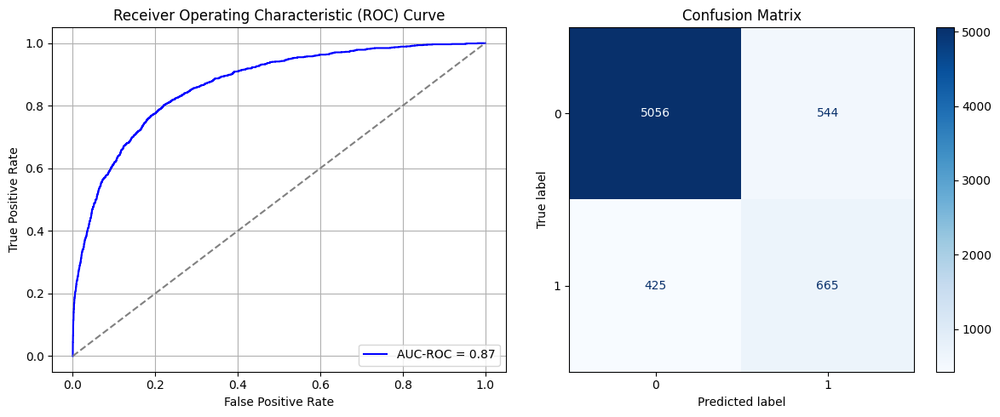

Best threshold based on F1-score: 0.575621485710144
False Negative Rate: 0.38990825688073394
Time elapsed (performance): 1.043746662002377
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6274 - loss: 0.6682 - val_AUC: 0.7313 - val_loss: 0.6176
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7536 - loss: 0.5964 - val_AUC: 0.8019 - val_loss: 0.5639
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8115 - loss: 0.5446 - val_AUC: 0.8597 - val_loss: 0.4958
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8576 - loss: 0.4885 - val_AUC: 0.8880 - val_loss: 0.4507
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8861 - loss: 0.4435 - val_AUC: 0.9047 - val_loss: 0.4102
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9032 - loss: 0.4071 - val_AUC: 0.9181 - val_loss: 0.3846
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9097 - loss: 0.3877 - val_AUC: 0.9265 - val_loss: 0.3705
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9124 - loss: 0.3821 - val_AUC: 0.9317 - val_loss: 0.3562
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9287 -

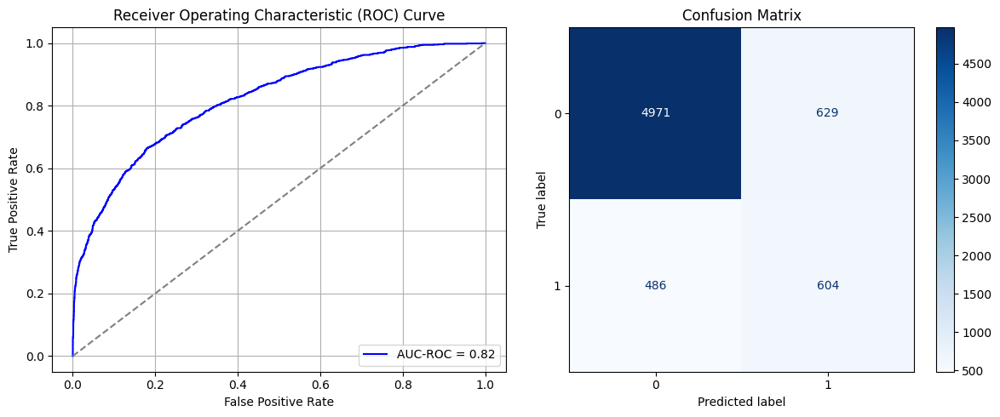

Best threshold based on F1-score: 0.47160229086875916
False Negative Rate: 0.44587155963302755
Time elapsed (performance): 1.079261859998951
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.5983 - loss: 0.6767 - val_AUC: 0.7163 - val_loss: 0.6242
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7391 - loss: 0.6071 - val_AUC: 0.8017 - val_loss: 0.5618
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8142 - loss: 0.5382 - val_AUC: 0.8406 - val_loss: 0.5263
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8493 - loss: 0.4916 - val_AUC: 0.8641 - val_loss: 0.4823
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8716 - loss: 0.4552 - val_AUC: 0.8740 - val_loss: 0.4570
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8867 - loss: 0.4299 - val_AUC: 0.8895 - val_loss: 0.4332
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8963 - loss: 0.4129 - val_AUC: 0.8947 - val_loss: 0.4134
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9029 - loss: 0.3985 - val_AUC: 0.9064 - val_loss: 0.3915
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9178 -

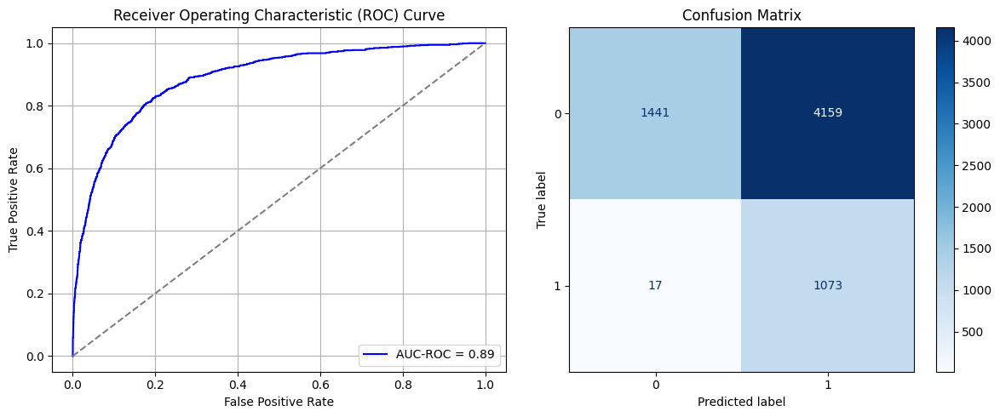

Best threshold based on F1-score: 0.9519197344779968
False Negative Rate: 0.015596330275229359
Time elapsed (performance): 2.51875604900124
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6708 - loss: 0.6566 - val_AUC: 0.7804 - val_loss: 0.5859
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7906 - loss: 0.5725 - val_AUC: 0.8476 - val_loss: 0.5045
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8361 - loss: 0.5118 - val_AUC: 0.8773 - val_loss: 0.4860
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8709 - loss: 0.4607 - val_AUC: 0.8953 - val_loss: 0.4246
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8824 - loss: 0.4377 - val_AUC: 0.9048 - val_loss: 0.4041
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8903 - loss: 0.4212 - val_AUC: 0.9174 - val_loss: 0.3770
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9122 - loss: 0.3822 - val_AUC: 0.9243 - val_loss: 0.3753
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9207 - loss: 0.3654 - val_AUC: 0.9278 - val_loss: 0.3658
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9285 -

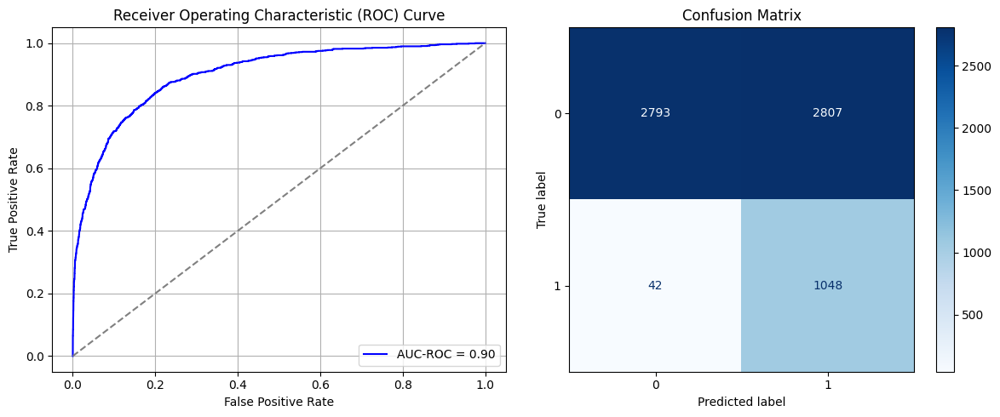

Best threshold based on F1-score: 0.8791994452476501
False Negative Rate: 0.03853211009174312
Time elapsed (performance): 1.0719207959991763
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6344 - loss: 0.6695 - val_AUC: 0.7734 - val_loss: 0.6001
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7751 - loss: 0.5821 - val_AUC: 0.8316 - val_loss: 0.5320
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8149 - loss: 0.5340 - val_AUC: 0.8606 - val_loss: 0.5187
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8308 - loss: 0.5133 - val_AUC: 0.8729 - val_loss: 0.4586
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8525 - loss: 0.4785 - val_AUC: 0.8922 - val_loss: 0.4404
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8679 - loss: 0.4560 - val_AUC: 0.8933 - val_loss: 0.4293
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8968 - loss: 0.4099 - val_AUC: 0.9082 - val_loss: 0.3976
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8970 - loss: 0.4085 - val_AUC: 0.9171 - val_loss: 0.4011
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9134 -

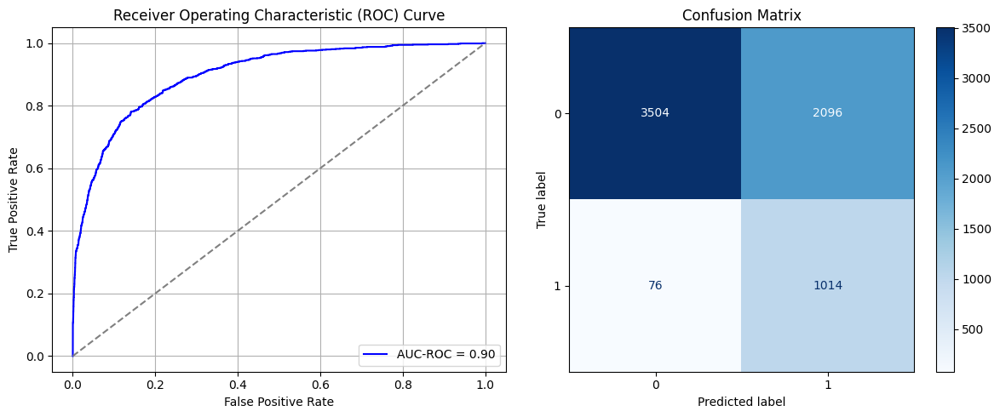

Best threshold based on F1-score: 0.8102389574050903
False Negative Rate: 0.06972477064220184
Time elapsed (performance): 0.8073816130017804
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6101 - loss: 0.6747 - val_AUC: 0.7629 - val_loss: 0.5990
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7614 - loss: 0.5931 - val_AUC: 0.8314 - val_loss: 0.5286
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8195 - loss: 0.5306 - val_AUC: 0.8673 - val_loss: 0.4778
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8590 - loss: 0.4751 - val_AUC: 0.8888 - val_loss: 0.4475
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8674 - loss: 0.4583 - val_AUC: 0.9026 - val_loss: 0.4065
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8922 - loss: 0.4186 - val_AUC: 0.9106 - val_loss: 0.3984
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9022 - loss: 0.4009 - val_AUC: 0.9216 - val_loss: 0.3837
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9139 - loss: 0.3778 - val_AUC: 0.9321 - val_loss: 0.3444
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9189 -

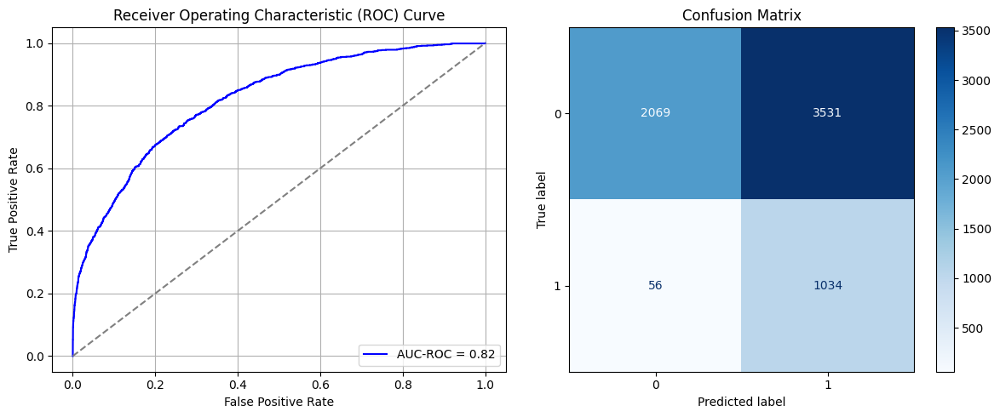

Best threshold based on F1-score: 0.9196372032165527
False Negative Rate: 0.05137614678899083
Time elapsed (performance): 1.0457309400007944
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6452 - loss: 0.6695 - val_AUC: 0.7742 - val_loss: 0.5978
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7586 - loss: 0.5962 - val_AUC: 0.8357 - val_loss: 0.5229
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8139 - loss: 0.5367 - val_AUC: 0.8653 - val_loss: 0.4798
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8495 - loss: 0.4901 - val_AUC: 0.8777 - val_loss: 0.4547
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4591 - val_AUC: 0.8857 - val_loss: 0.4365
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8814 - loss: 0.4354 - val_AUC: 0.8971 - val_loss: 0.4162
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8801 - loss: 0.4366 - val_AUC: 0.9046 - val_loss: 0.4044
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8955 - loss: 0.4105 - val_AUC: 0.9072 - val_loss: 0.3896
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8898 -

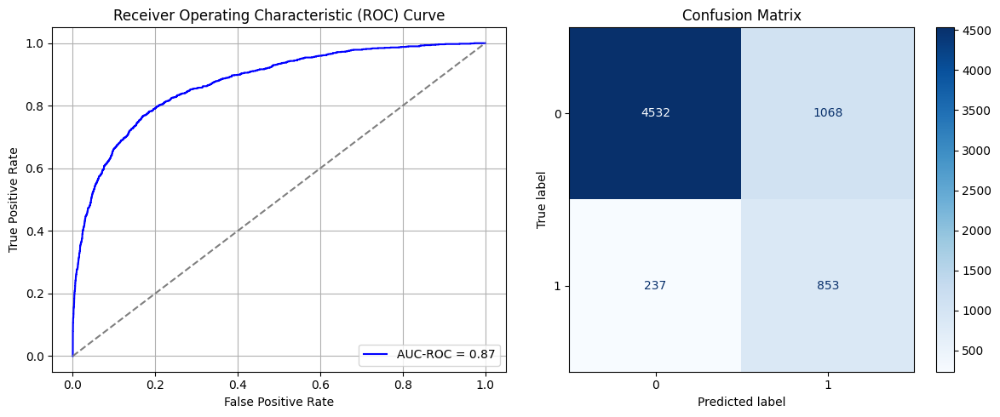

Best threshold based on F1-score: 0.6517452597618103
False Negative Rate: 0.21743119266055047
Time elapsed (performance): 1.0984968769989791
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6211 - loss: 0.6705 - val_AUC: 0.7614 - val_loss: 0.5993
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7676 - loss: 0.5880 - val_AUC: 0.8235 - val_loss: 0.5438
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8222 - loss: 0.5286 - val_AUC: 0.8551 - val_loss: 0.4910
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8474 - loss: 0.4919 - val_AUC: 0.8704 - val_loss: 0.4627
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4459 - val_AUC: 0.8848 - val_loss: 0.4421
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8863 - loss: 0.4315 - val_AUC: 0.8946 - val_loss: 0.4197
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4419 - val_AUC: 0.9018 - val_loss: 0.4062
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9031 - loss: 0.3995 - val_AUC: 0.9052 - val_loss: 0.4456
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8991 -

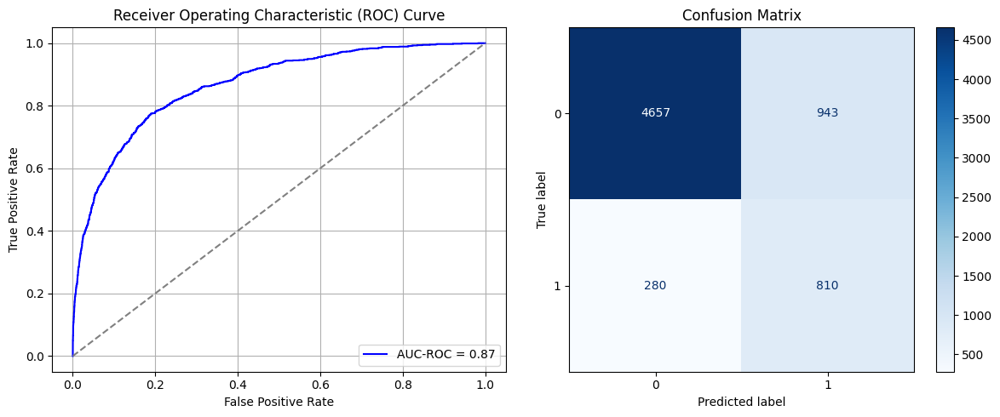

Best threshold based on F1-score: 0.6003754138946533
False Negative Rate: 0.25688073394495414
Time elapsed (performance): 1.067861224997614
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6234 - loss: 0.6719 - val_AUC: 0.7685 - val_loss: 0.6016
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7676 - loss: 0.5898 - val_AUC: 0.8334 - val_loss: 0.5761
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8264 - loss: 0.5282 - val_AUC: 0.8729 - val_loss: 0.4773
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8609 - loss: 0.4760 - val_AUC: 0.8990 - val_loss: 0.4258
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4335 - val_AUC: 0.9116 - val_loss: 0.3982
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8942 - loss: 0.4153 - val_AUC: 0.9256 - val_loss: 0.3668
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9168 - loss: 0.3753 - val_AUC: 0.9373 - val_loss: 0.3413
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9245 - loss: 0.3578 - val_AUC: 0.9410 - val_loss: 0.3352
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9280 -

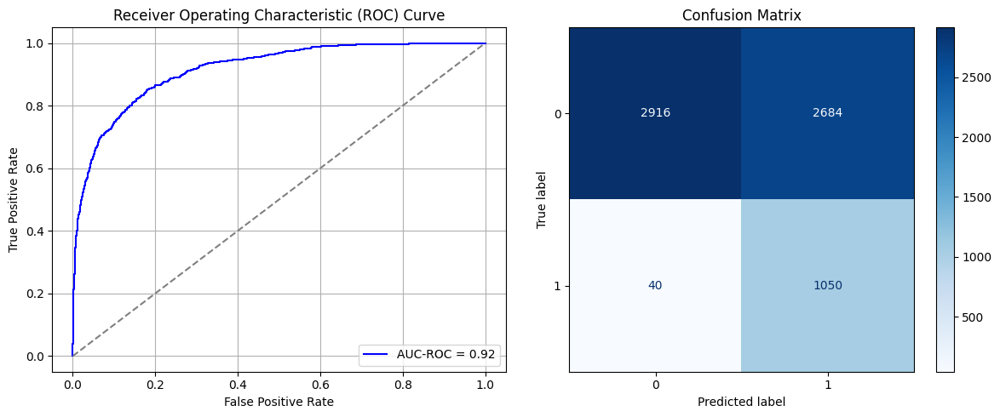

Best threshold based on F1-score: 0.9366235733032227
False Negative Rate: 0.03669724770642202
Time elapsed (performance): 0.7794934720004676
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6272 - loss: 0.6741 - val_AUC: 0.7651 - val_loss: 0.6044
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7716 - loss: 0.5865 - val_AUC: 0.8277 - val_loss: 0.5364
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8139 - loss: 0.5367 - val_AUC: 0.8697 - val_loss: 0.4814
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8537 - loss: 0.4846 - val_AUC: 0.8858 - val_loss: 0.4543
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8678 - loss: 0.4588 - val_AUC: 0.9014 - val_loss: 0.4247
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 - loss: 0.4283 - val_AUC: 0.9093 - val_loss: 0.4079
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8930 - loss: 0.4179 - val_AUC: 0.9173 - val_loss: 0.3994
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8957 - loss: 0.4113 - val_AUC: 0.9257 - val_loss: 0.3830
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9033 -

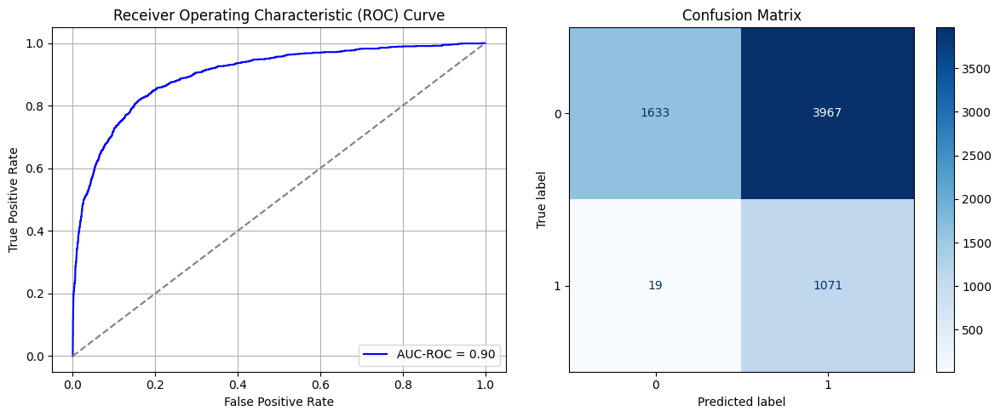

Best threshold based on F1-score: 0.946827232837677
False Negative Rate: 0.01743119266055046
Time elapsed (performance): 0.7706485460003023
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6474 - loss: 0.6628 - val_AUC: 0.7504 - val_loss: 0.6034
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7696 - loss: 0.5854 - val_AUC: 0.8170 - val_loss: 0.5392
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8313 - loss: 0.5220 - val_AUC: 0.8565 - val_loss: 0.5390
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8541 - loss: 0.4857 - val_AUC: 0.8774 - val_loss: 0.4547
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 - loss: 0.4422 - val_AUC: 0.8868 - val_loss: 0.4299
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8956 - loss: 0.4144 - val_AUC: 0.9025 - val_loss: 0.4426
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9033 - loss: 0.4009 - val_AUC: 0.9029 - val_loss: 0.3961
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9106 - loss: 0.3839 - val_AUC: 0.9173 - val_loss: 0.3913
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9199 -

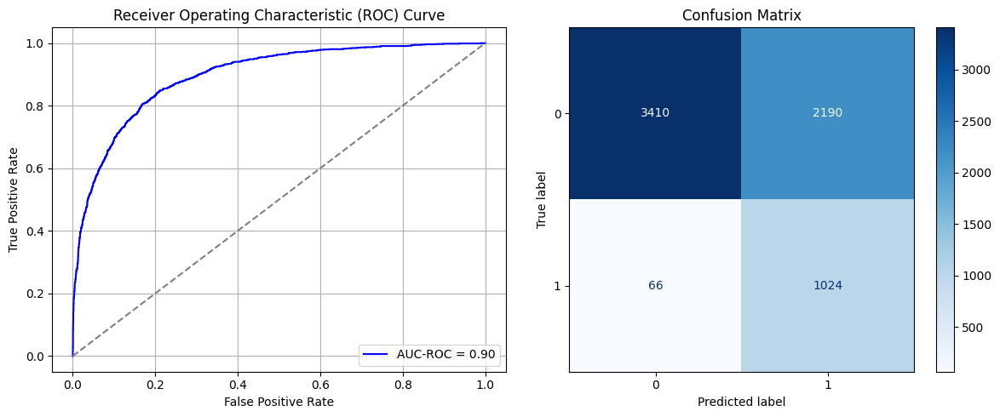

Best threshold based on F1-score: 0.7983892560005188
False Negative Rate: 0.060550458715596334
Time elapsed (performance): 0.7591855610007769
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6299 - loss: 0.6724 - val_AUC: 0.7722 - val_loss: 0.6087
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7554 - loss: 0.6014 - val_AUC: 0.8341 - val_loss: 0.5339
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8194 - loss: 0.5361 - val_AUC: 0.8676 - val_loss: 0.4932
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8573 - loss: 0.4843 - val_AUC: 0.8773 - val_loss: 0.4538
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8848 - loss: 0.4383 - val_AUC: 0.8964 - val_loss: 0.4268
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8876 - loss: 0.4299 - val_AUC: 0.9065 - val_loss: 0.4141
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9031 - loss: 0.4016 - val_AUC: 0.9152 - val_loss: 0.3866
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9107 - loss: 0.3849 - val_AUC: 0.9194 - val_loss: 0.4232
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9144 -

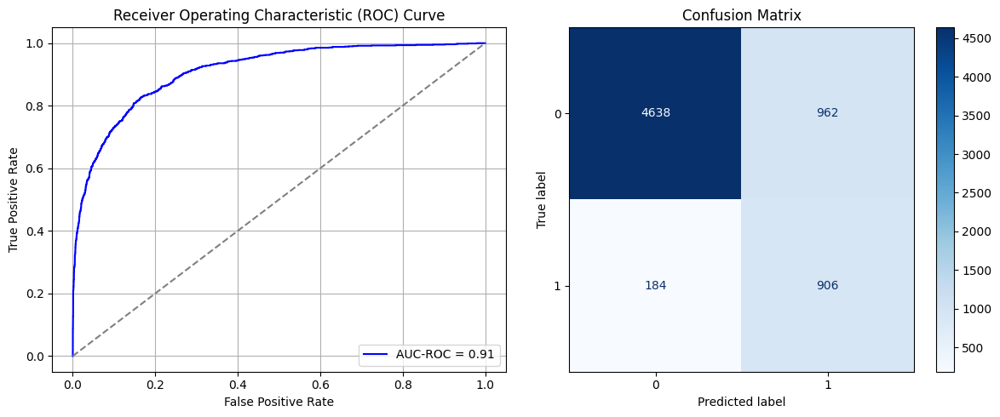

Best threshold based on F1-score: 0.7145863771438599
False Negative Rate: 0.1688073394495413
Time elapsed (performance): 1.2775290149984357
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.5834 - loss: 0.6781 - val_AUC: 0.7663 - val_loss: 0.5908
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7614 - loss: 0.5875 - val_AUC: 0.8325 - val_loss: 0.5333
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8231 - loss: 0.5272 - val_AUC: 0.8639 - val_loss: 0.4809
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8338 - loss: 0.5061 - val_AUC: 0.8803 - val_loss: 0.4481
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4520 - val_AUC: 0.8914 - val_loss: 0.4280
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4279 - val_AUC: 0.9040 - val_loss: 0.4098
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8900 - loss: 0.4194 - val_AUC: 0.9162 - val_loss: 0.3877
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9131 - loss: 0.3821 - val_AUC: 0.9276 - val_loss: 0.3566
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9057 -

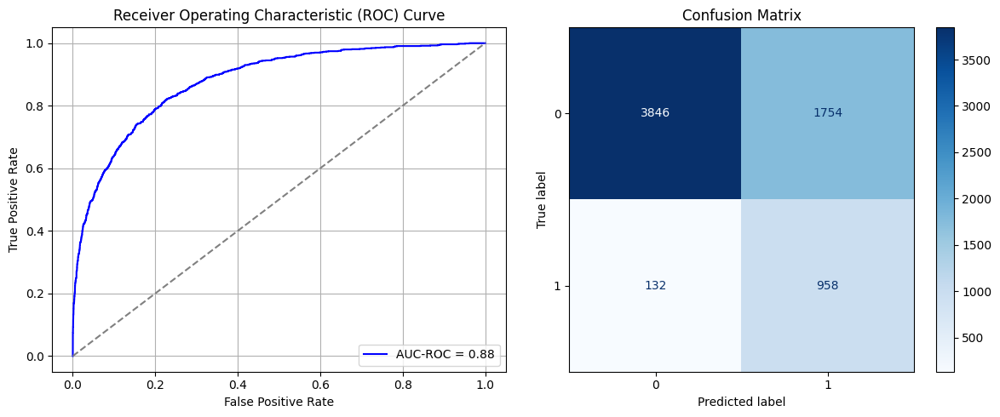

Best threshold based on F1-score: 0.78497314453125
False Negative Rate: 0.12110091743119267
Time elapsed (performance): 0.7892576879967237
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6343 - loss: 0.6693 - val_AUC: 0.7678 - val_loss: 0.6097
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7629 - loss: 0.5958 - val_AUC: 0.8364 - val_loss: 0.5582
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8209 - loss: 0.5355 - val_AUC: 0.8722 - val_loss: 0.4972
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8451 - loss: 0.4988 - val_AUC: 0.8868 - val_loss: 0.4510
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8714 - loss: 0.4613 - val_AUC: 0.8962 - val_loss: 0.4439
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4467 - val_AUC: 0.9081 - val_loss: 0.4035
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 - loss: 0.4274 - val_AUC: 0.9152 - val_loss: 0.3843
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8962 - loss: 0.4105 - val_AUC: 0.9214 - val_loss: 0.3711
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9053 -

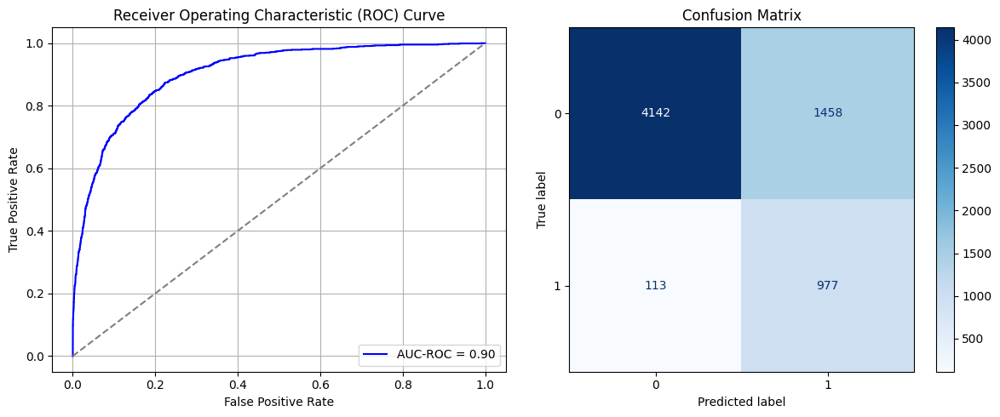

Best threshold based on F1-score: 0.7195711135864258
False Negative Rate: 0.10366972477064221
Time elapsed (performance): 1.0349574089996167
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6894 - loss: 0.6516 - val_AUC: 0.7771 - val_loss: 0.5890
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7759 - loss: 0.5815 - val_AUC: 0.8369 - val_loss: 0.5492
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8259 - loss: 0.5243 - val_AUC: 0.8720 - val_loss: 0.4739
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8596 - loss: 0.4791 - val_AUC: 0.8915 - val_loss: 0.4479
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8873 - loss: 0.4359 - val_AUC: 0.9040 - val_loss: 0.4208
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9055 - loss: 0.4015 - val_AUC: 0.9142 - val_loss: 0.3938
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9120 - loss: 0.3837 - val_AUC: 0.9220 - val_loss: 0.3727
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9174 - loss: 0.3716 - val_AUC: 0.9260 - val_loss: 0.3835
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9299 -

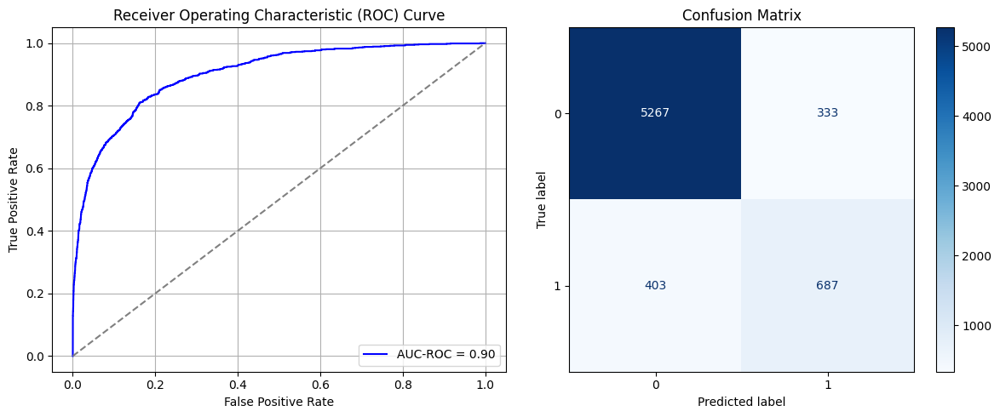

Best threshold based on F1-score: 0.4707174003124237
False Negative Rate: 0.3697247706422018
Time elapsed (performance): 1.9241334440011997
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6245 - loss: 0.6703 - val_AUC: 0.7686 - val_loss: 0.6067
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7748 - loss: 0.5819 - val_AUC: 0.8337 - val_loss: 0.5325
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8189 - loss: 0.5342 - val_AUC: 0.8642 - val_loss: 0.5078
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8481 - loss: 0.4917 - val_AUC: 0.8844 - val_loss: 0.4577
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8762 - loss: 0.4516 - val_AUC: 0.8977 - val_loss: 0.4390
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8848 - loss: 0.4335 - val_AUC: 0.9104 - val_loss: 0.4053
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8951 - loss: 0.4134 - val_AUC: 0.9182 - val_loss: 0.3964
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9109 - loss: 0.3839 - val_AUC: 0.9243 - val_loss: 0.3618
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9128 -

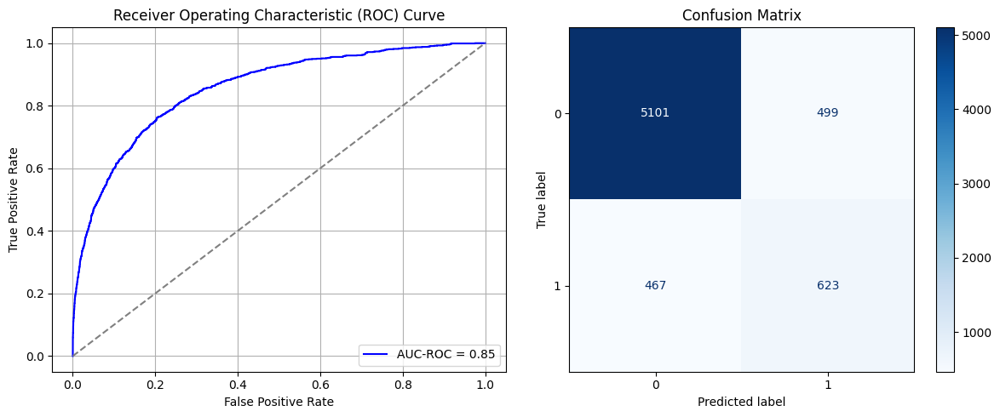

Best threshold based on F1-score: 0.46110114455223083
False Negative Rate: 0.42844036697247706
Time elapsed (performance): 0.8125456859997939
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5888 - loss: 0.6801 - val_AUC: 0.7441 - val_loss: 0.6127
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7518 - loss: 0.5993 - val_AUC: 0.8166 - val_loss: 0.5442
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8253 - loss: 0.5257 - val_AUC: 0.8588 - val_loss: 0.5067
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8438 - loss: 0.4945 - val_AUC: 0.8755 - val_loss: 0.4651
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8491 - loss: 0.4818 - val_AUC: 0.8859 - val_loss: 0.4544
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 - loss: 0.4338 - val_AUC: 0.8945 - val_loss: 0.4268
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8894 - loss: 0.4252 - val_AUC: 0.9051 - val_loss: 0.4030
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8971 - loss: 0.4087 - val_AUC: 0.9125 - val_loss: 0.3952
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9018 -

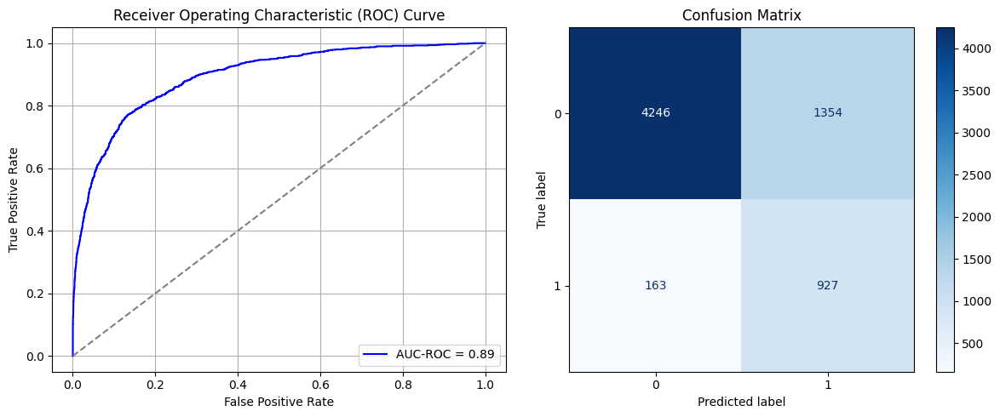

Best threshold based on F1-score: 0.7143974900245667
False Negative Rate: 0.14954128440366973
Time elapsed (performance): 1.245894807001605
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6014 - loss: 0.6914 - val_AUC: 0.7702 - val_loss: 0.5996
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7744 - loss: 0.5890 - val_AUC: 0.8331 - val_loss: 0.5255
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8223 - loss: 0.5266 - val_AUC: 0.8593 - val_loss: 0.4920
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8495 - loss: 0.4877 - val_AUC: 0.8723 - val_loss: 0.4589
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4503 - val_AUC: 0.8821 - val_loss: 0.4371
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4213 - val_AUC: 0.8968 - val_loss: 0.4335
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8984 - loss: 0.4060 - val_AUC: 0.9051 - val_loss: 0.4103
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9050 - loss: 0.3908 - val_AUC: 0.9059 - val_loss: 0.3949
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9086 -

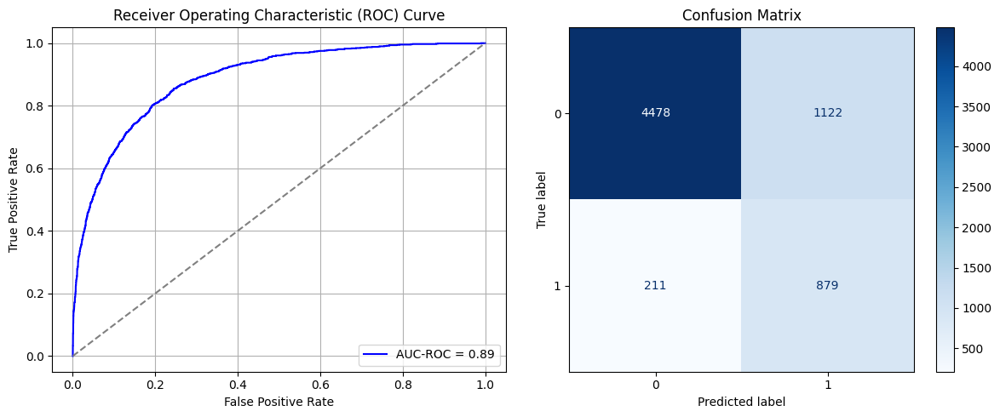

Best threshold based on F1-score: 0.6808062195777893
False Negative Rate: 0.19357798165137616
Time elapsed (performance): 1.0472375850004028
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6238 - loss: 0.6706 - val_AUC: 0.7512 - val_loss: 0.6067
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7541 - loss: 0.5980 - val_AUC: 0.8122 - val_loss: 0.5440
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8150 - loss: 0.5372 - val_AUC: 0.8550 - val_loss: 0.4975
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8463 - loss: 0.4951 - val_AUC: 0.8762 - val_loss: 0.4644
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8701 - loss: 0.4576 - val_AUC: 0.9000 - val_loss: 0.4158
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8862 - loss: 0.4304 - val_AUC: 0.9108 - val_loss: 0.3982
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8939 - loss: 0.4153 - val_AUC: 0.9171 - val_loss: 0.3827
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9058 - loss: 0.3948 - val_AUC: 0.9211 - val_loss: 0.3630
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9131 -

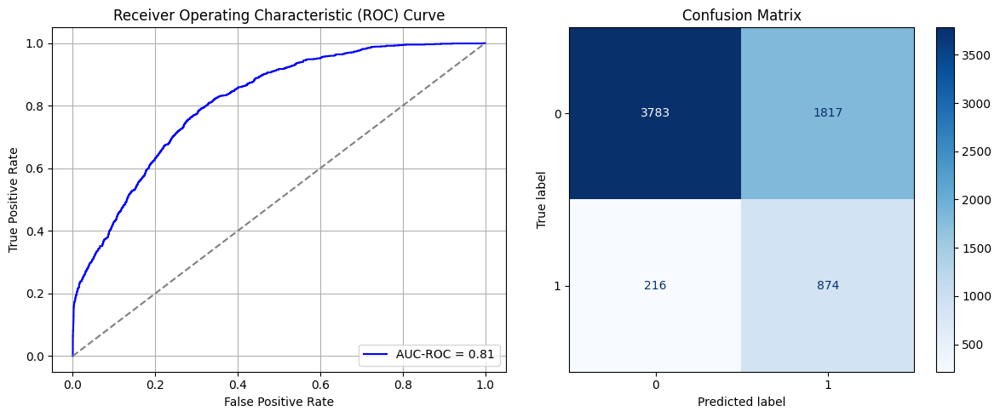

Best threshold based on F1-score: 0.6443668603897095
False Negative Rate: 0.1981651376146789
Time elapsed (performance): 0.8325693939987104
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6028 - loss: 0.6744 - val_AUC: 0.7661 - val_loss: 0.6060
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7738 - loss: 0.5908 - val_AUC: 0.8416 - val_loss: 0.5277
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8349 - loss: 0.5179 - val_AUC: 0.8656 - val_loss: 0.4703
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8593 - loss: 0.4763 - val_AUC: 0.8833 - val_loss: 0.4482
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4459 - val_AUC: 0.8943 - val_loss: 0.4435
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8848 - loss: 0.4310 - val_AUC: 0.8997 - val_loss: 0.4408
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8995 - loss: 0.4075 - val_AUC: 0.9096 - val_loss: 0.3919
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9095 - loss: 0.3847 - val_AUC: 0.9172 - val_loss: 0.3933
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9145 -

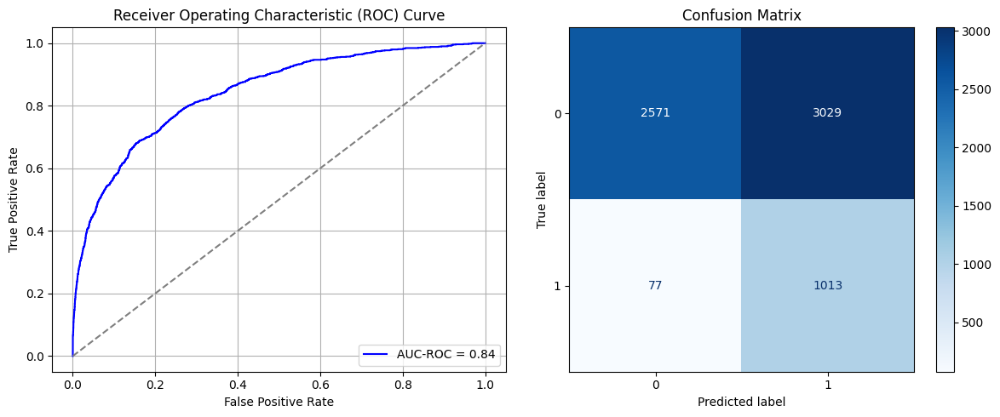

Best threshold based on F1-score: 0.8538013696670532
False Negative Rate: 0.07064220183486239
Time elapsed (performance): 0.8206548620000831
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6108 - loss: 0.6721 - val_AUC: 0.7493 - val_loss: 0.6090
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7727 - loss: 0.5849 - val_AUC: 0.8133 - val_loss: 0.5553
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8313 - loss: 0.5188 - val_AUC: 0.8504 - val_loss: 0.5051
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8468 - loss: 0.4917 - val_AUC: 0.8641 - val_loss: 0.4742
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8640 - loss: 0.4659 - val_AUC: 0.8745 - val_loss: 0.4996
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8756 - loss: 0.4457 - val_AUC: 0.8905 - val_loss: 0.4524
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8862 - loss: 0.4299 - val_AUC: 0.8955 - val_loss: 0.4117
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8984 - loss: 0.4049 - val_AUC: 0.9064 - val_loss: 0.3976
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9099 -

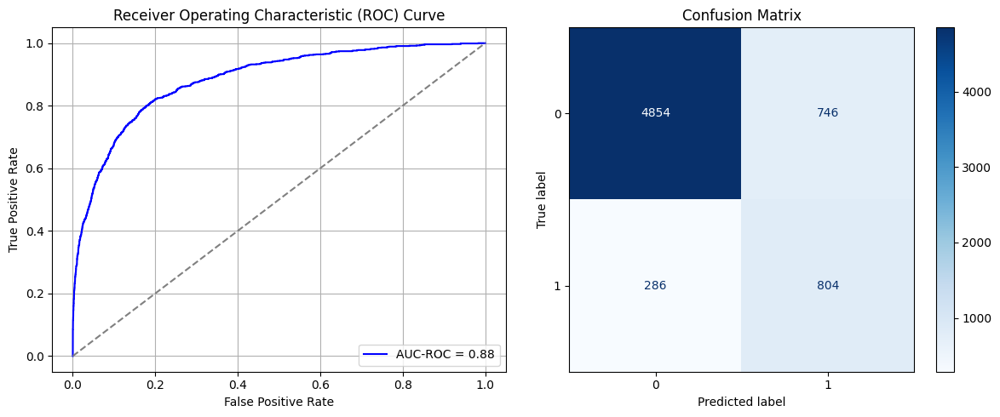

Best threshold based on F1-score: 0.5692547559738159
False Negative Rate: 0.26238532110091745
Time elapsed (performance): 0.7992218310027965
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6657 - loss: 0.6583 - val_AUC: 0.7694 - val_loss: 0.6014
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7889 - loss: 0.5726 - val_AUC: 0.8272 - val_loss: 0.5262
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8395 - loss: 0.5110 - val_AUC: 0.8705 - val_loss: 0.4717
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4526 - val_AUC: 0.8799 - val_loss: 0.4454
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4378 - val_AUC: 0.8969 - val_loss: 0.4141
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8962 - loss: 0.4114 - val_AUC: 0.9051 - val_loss: 0.3995
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9104 - loss: 0.3837 - val_AUC: 0.9125 - val_loss: 0.4069
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9214 - loss: 0.3632 - val_AUC: 0.9170 - val_loss: 0.3756
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9162 -

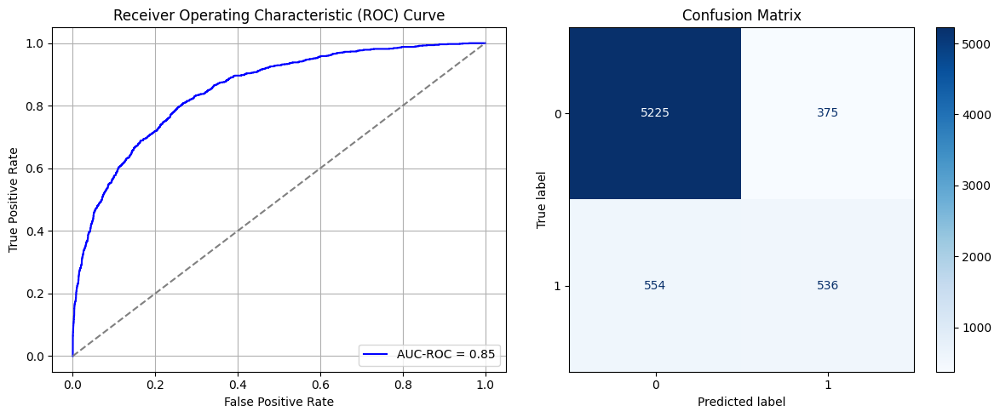

Best threshold based on F1-score: 0.3860865533351898
False Negative Rate: 0.5082568807339449
Time elapsed (performance): 1.1957408050002414
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6296 - loss: 0.6701 - val_AUC: 0.7288 - val_loss: 0.6196
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7428 - loss: 0.6073 - val_AUC: 0.8081 - val_loss: 0.5554
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8194 - loss: 0.5348 - val_AUC: 0.8649 - val_loss: 0.5002
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8476 - loss: 0.4966 - val_AUC: 0.8782 - val_loss: 0.4546
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8697 - loss: 0.4604 - val_AUC: 0.8917 - val_loss: 0.4283
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8814 - loss: 0.4373 - val_AUC: 0.9040 - val_loss: 0.4092
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8975 - loss: 0.4090 - val_AUC: 0.9135 - val_loss: 0.4024
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9057 - loss: 0.3958 - val_AUC: 0.9218 - val_loss: 0.3719
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9129 -

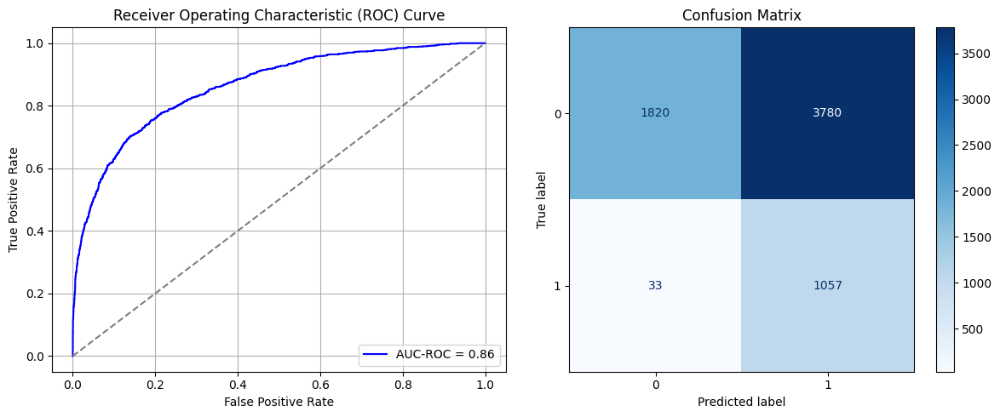

Best threshold based on F1-score: 0.9589725136756897
False Negative Rate: 0.030275229357798167
Time elapsed (performance): 1.0436785599995346
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6171 - loss: 0.6721 - val_AUC: 0.7408 - val_loss: 0.6114
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7510 - loss: 0.5992 - val_AUC: 0.8045 - val_loss: 0.5534
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8026 - loss: 0.5441 - val_AUC: 0.8630 - val_loss: 0.4888
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8598 - loss: 0.4800 - val_AUC: 0.8950 - val_loss: 0.4451
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8805 - loss: 0.4453 - val_AUC: 0.9057 - val_loss: 0.4052
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9011 - loss: 0.4057 - val_AUC: 0.9135 - val_loss: 0.4271
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9115 - loss: 0.3839 - val_AUC: 0.9272 - val_loss: 0.3538
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9282 - loss: 0.3497 - val_AUC: 0.9374 - val_loss: 0.3509
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9227 -

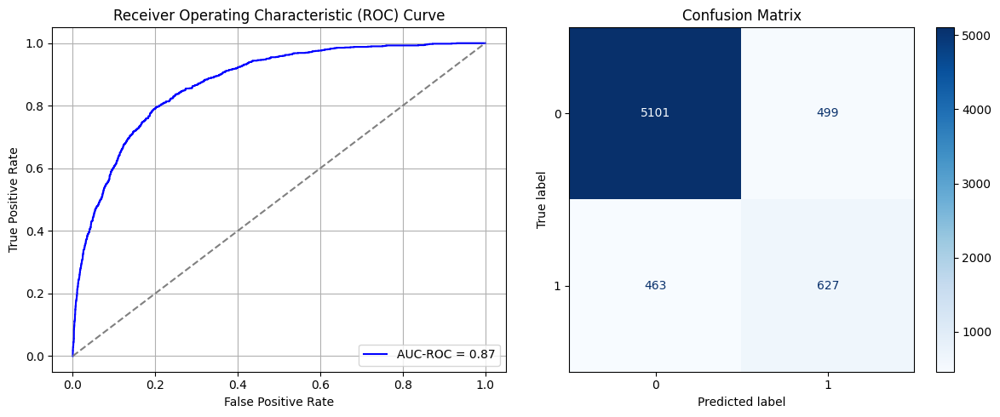

Best threshold based on F1-score: 0.4042585492134094
False Negative Rate: 0.42477064220183486
Time elapsed (performance): 0.8304451740004879
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6066 - loss: 0.6733 - val_AUC: 0.7634 - val_loss: 0.6204
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7806 - loss: 0.5799 - val_AUC: 0.8197 - val_loss: 0.5433
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8212 - loss: 0.5288 - val_AUC: 0.8533 - val_loss: 0.4928
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8468 - loss: 0.4912 - val_AUC: 0.8779 - val_loss: 0.4557
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8752 - loss: 0.4498 - val_AUC: 0.8905 - val_loss: 0.4306
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8898 - loss: 0.4243 - val_AUC: 0.9046 - val_loss: 0.4031
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8912 - loss: 0.4172 - val_AUC: 0.9151 - val_loss: 0.4316
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9123 - loss: 0.3834 - val_AUC: 0.9212 - val_loss: 0.3672
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9171 -

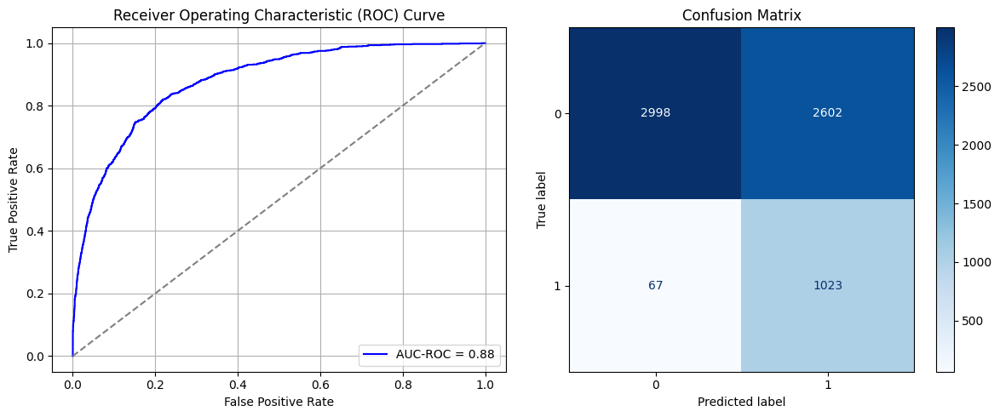

Best threshold based on F1-score: 0.8785603642463684
False Negative Rate: 0.061467889908256884
Time elapsed (performance): 0.82856244100185
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6276 - loss: 0.6702 - val_AUC: 0.7542 - val_loss: 0.6115
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7577 - loss: 0.5962 - val_AUC: 0.8176 - val_loss: 0.5493
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8115 - loss: 0.5448 - val_AUC: 0.8588 - val_loss: 0.4928
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8539 - loss: 0.4913 - val_AUC: 0.8846 - val_loss: 0.4533
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8677 - loss: 0.4652 - val_AUC: 0.8928 - val_loss: 0.4459
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 - loss: 0.4395 - val_AUC: 0.9072 - val_loss: 0.3986
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8948 - loss: 0.4148 - val_AUC: 0.9252 - val_loss: 0.3734
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9152 - loss: 0.3789 - val_AUC: 0.9337 - val_loss: 0.3487
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9192 -

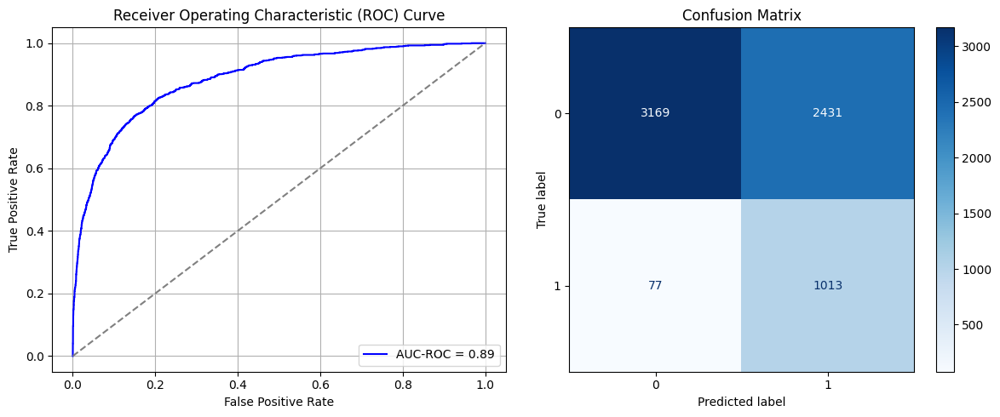

Best threshold based on F1-score: 0.8759700655937195
False Negative Rate: 0.07064220183486239
Time elapsed (performance): 1.0559208279992163
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6478 - loss: 0.6609 - val_AUC: 0.7788 - val_loss: 0.5860
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7608 - loss: 0.5890 - val_AUC: 0.8350 - val_loss: 0.5318
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8097 - loss: 0.5372 - val_AUC: 0.8659 - val_loss: 0.4798
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8428 - loss: 0.4981 - val_AUC: 0.8810 - val_loss: 0.4541
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 - loss: 0.4532 - val_AUC: 0.8928 - val_loss: 0.4257
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8889 - loss: 0.4270 - val_AUC: 0.9009 - val_loss: 0.4106
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8921 - loss: 0.4178 - val_AUC: 0.9095 - val_loss: 0.3901
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9050 - loss: 0.3955 - val_AUC: 0.9176 - val_loss: 0.4045
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9043 -

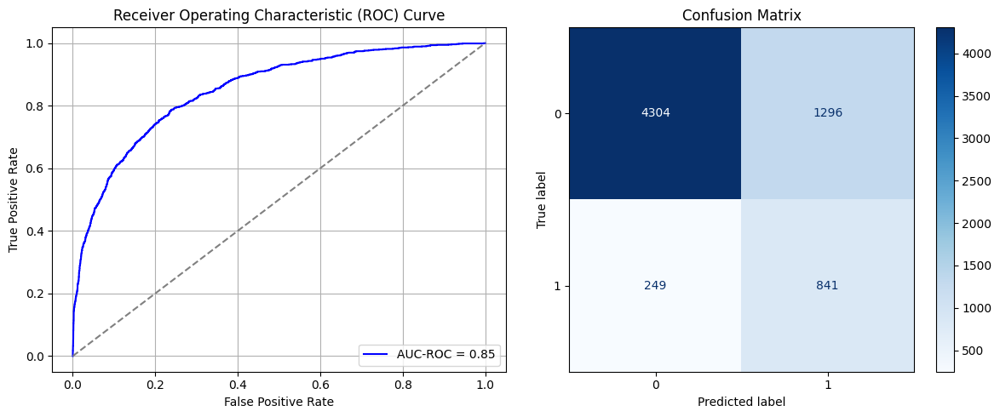

Best threshold based on F1-score: 0.7207380533218384
False Negative Rate: 0.22844036697247708
Time elapsed (performance): 0.8395722929999465
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6336 - loss: 0.6644 - val_AUC: 0.7719 - val_loss: 0.5939
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7828 - loss: 0.5754 - val_AUC: 0.8324 - val_loss: 0.5198
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8341 - loss: 0.5129 - val_AUC: 0.8696 - val_loss: 0.4727
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8757 - loss: 0.4567 - val_AUC: 0.8790 - val_loss: 0.4447
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4374 - val_AUC: 0.8920 - val_loss: 0.4291
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8846 - loss: 0.4317 - val_AUC: 0.9048 - val_loss: 0.3991
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9033 - loss: 0.3984 - val_AUC: 0.9134 - val_loss: 0.3818
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9121 - loss: 0.3826 - val_AUC: 0.9237 - val_loss: 0.3621
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9283 -

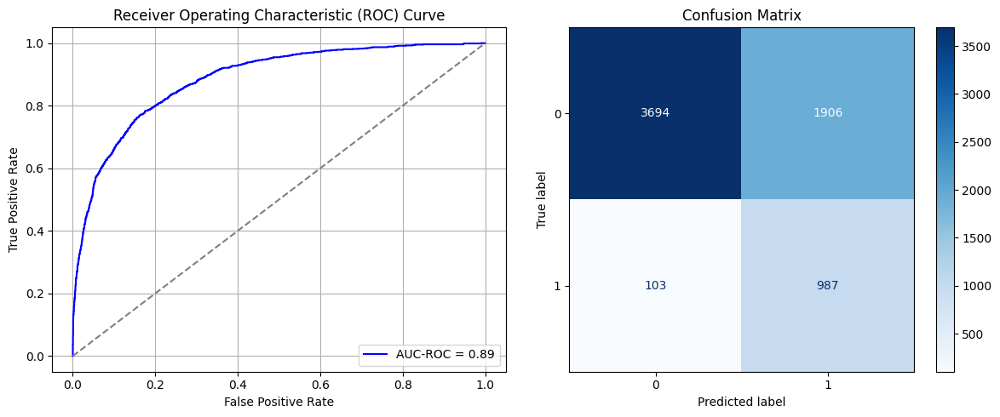

Best threshold based on F1-score: 0.8711378574371338
False Negative Rate: 0.0944954128440367
Time elapsed (performance): 1.2306161929991504
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.6339 - loss: 0.6685 - val_AUC: 0.7748 - val_loss: 0.6084
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7571 - loss: 0.5938 - val_AUC: 0.8351 - val_loss: 0.5251
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8283 - loss: 0.5225 - val_AUC: 0.8681 - val_loss: 0.4771
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8542 - loss: 0.4848 - val_AUC: 0.8868 - val_loss: 0.4540
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4531 - val_AUC: 0.8947 - val_loss: 0.4261
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8836 - loss: 0.4356 - val_AUC: 0.9040 - val_loss: 0.4037
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8957 - loss: 0.4121 - val_AUC: 0.9154 - val_loss: 0.3790
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9067 - loss: 0.3911 - val_AUC: 0.9206 - val_loss: 0.3685
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9185 -

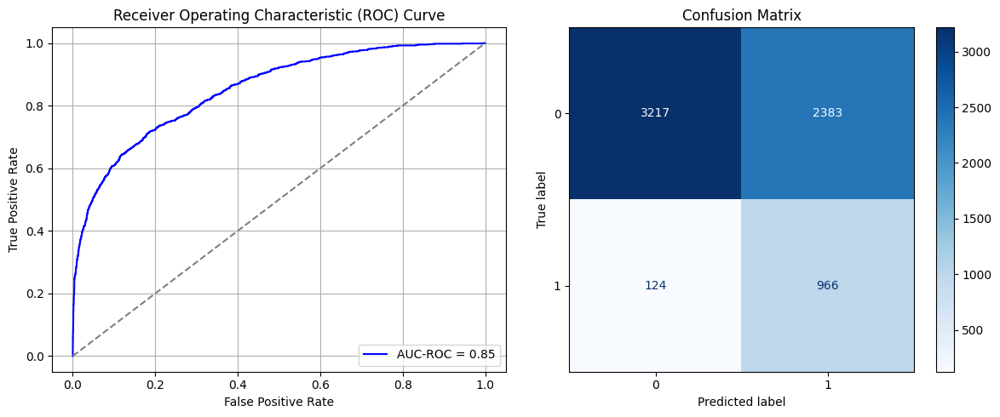

Best threshold based on F1-score: 0.8821027278900146
False Negative Rate: 0.11376146788990826
Time elapsed (performance): 1.0961258099996485
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6188 - loss: 0.6763 - val_AUC: 0.7559 - val_loss: 0.6137
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7500 - loss: 0.6044 - val_AUC: 0.8446 - val_loss: 0.5192
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8063 - loss: 0.5458 - val_AUC: 0.8686 - val_loss: 0.4717
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8388 - loss: 0.4990 - val_AUC: 0.8888 - val_loss: 0.4507
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8712 - loss: 0.4581 - val_AUC: 0.8995 - val_loss: 0.4205
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8882 - loss: 0.4262 - val_AUC: 0.9107 - val_loss: 0.3988
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9081 - loss: 0.3927 - val_AUC: 0.9211 - val_loss: 0.3726
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9055 - loss: 0.3942 - val_AUC: 0.9293 - val_loss: 0.3509
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9176 -

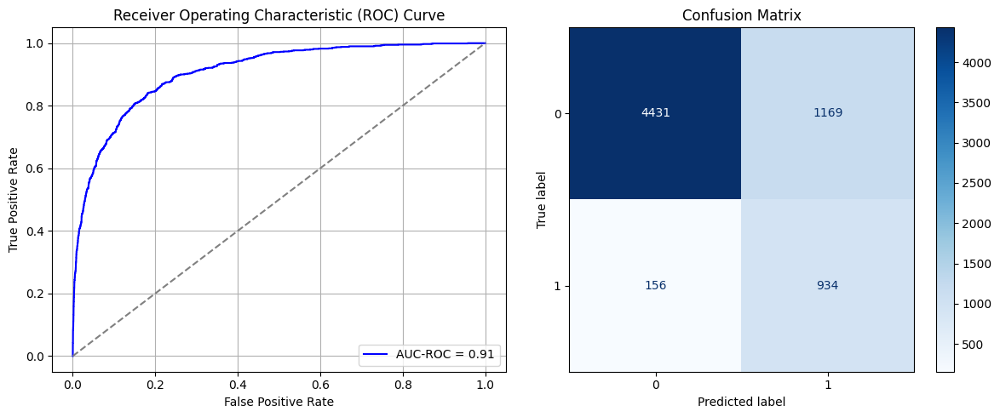

Best threshold based on F1-score: 0.7699505686759949
False Negative Rate: 0.14311926605504588
Time elapsed (performance): 1.0870199669989233
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6116 - loss: 0.6758 - val_AUC: 0.7555 - val_loss: 0.6136
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7544 - loss: 0.6039 - val_AUC: 0.8155 - val_loss: 0.5502
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8144 - loss: 0.5448 - val_AUC: 0.8433 - val_loss: 0.5048
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8409 - loss: 0.5028 - val_AUC: 0.8585 - val_loss: 0.4823
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8598 - loss: 0.4727 - val_AUC: 0.8751 - val_loss: 0.4635
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8707 - loss: 0.4528 - val_AUC: 0.8856 - val_loss: 0.4329
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8893 - loss: 0.4240 - val_AUC: 0.8936 - val_loss: 0.4171
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4187 - val_AUC: 0.8996 - val_loss: 0.4068
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8992 -

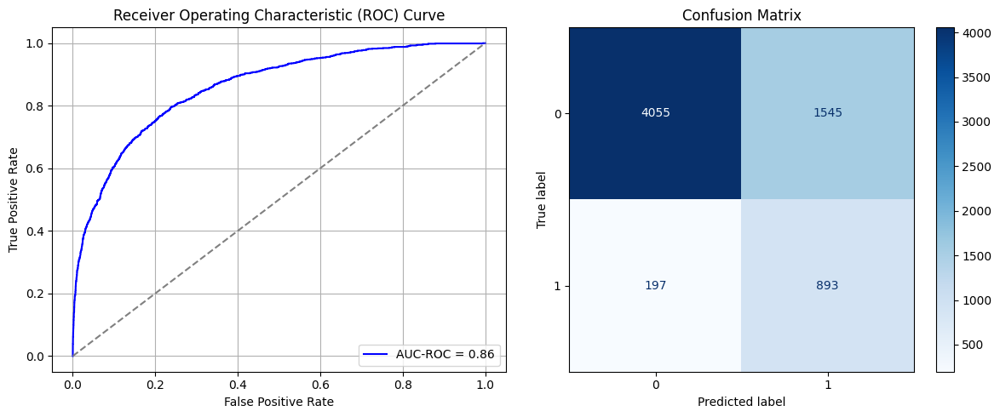

Best threshold based on F1-score: 0.708574652671814
False Negative Rate: 0.18073394495412845
Time elapsed (performance): 1.1021557280000707
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6042 - loss: 0.6754 - val_AUC: 0.7370 - val_loss: 0.6174
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7644 - loss: 0.5904 - val_AUC: 0.8362 - val_loss: 0.5383
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8167 - loss: 0.5353 - val_AUC: 0.8713 - val_loss: 0.4917
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8658 - loss: 0.4738 - val_AUC: 0.8905 - val_loss: 0.4421
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4485 - val_AUC: 0.8981 - val_loss: 0.4172
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9022 - loss: 0.4050 - val_AUC: 0.9108 - val_loss: 0.3921
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9090 - loss: 0.3900 - val_AUC: 0.9145 - val_loss: 0.3791
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9221 - loss: 0.3635 - val_AUC: 0.9250 - val_loss: 0.3609
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9163 -

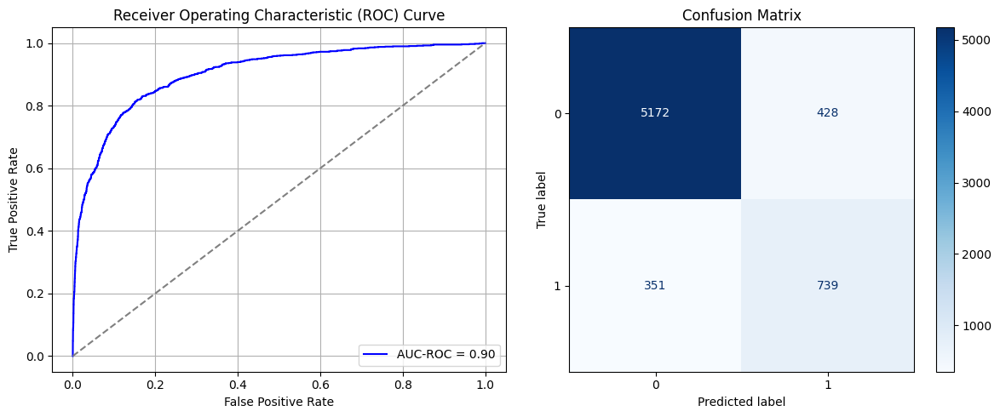

Best threshold based on F1-score: 0.466595321893692
False Negative Rate: 0.3220183486238532
Time elapsed (performance): 0.8447581590007758
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.5985 - loss: 0.6786 - val_AUC: 0.7610 - val_loss: 0.6068
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7582 - loss: 0.5948 - val_AUC: 0.8183 - val_loss: 0.5435
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8098 - loss: 0.5406 - val_AUC: 0.8554 - val_loss: 0.4904
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8480 - loss: 0.4939 - val_AUC: 0.8761 - val_loss: 0.4678
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8674 - loss: 0.4630 - val_AUC: 0.8893 - val_loss: 0.4303
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8910 - loss: 0.4255 - val_AUC: 0.8983 - val_loss: 0.4109
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8951 - loss: 0.4133 - val_AUC: 0.9059 - val_loss: 0.3954
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9054 - loss: 0.3952 - val_AUC: 0.9156 - val_loss: 0.3760
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9057 -

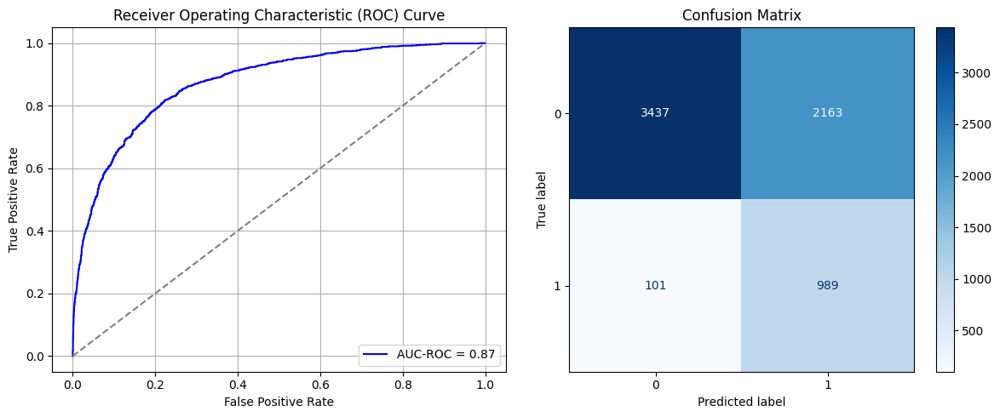

Best threshold based on F1-score: 0.8140192627906799
False Negative Rate: 0.0926605504587156
Time elapsed (performance): 1.0421125670000038
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6587 - loss: 0.6595 - val_AUC: 0.7944 - val_loss: 0.5802
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7972 - loss: 0.5676 - val_AUC: 0.8610 - val_loss: 0.5091
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8487 - loss: 0.5025 - val_AUC: 0.8928 - val_loss: 0.4818
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8635 - loss: 0.4700 - val_AUC: 0.9023 - val_loss: 0.4272
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4413 - val_AUC: 0.9156 - val_loss: 0.3912
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8927 - loss: 0.4196 - val_AUC: 0.9214 - val_loss: 0.3781
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9064 - loss: 0.3923 - val_AUC: 0.9309 - val_loss: 0.3584
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9107 - loss: 0.3840 - val_AUC: 0.9354 - val_loss: 0.3429
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9157 -

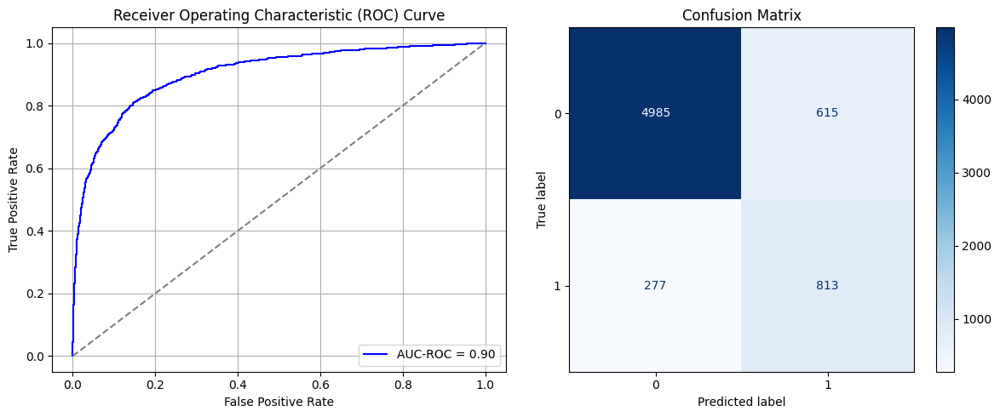

Best threshold based on F1-score: 0.6223570704460144
False Negative Rate: 0.25412844036697246
Time elapsed (performance): 1.048414214001241
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6511 - loss: 0.6720 - val_AUC: 0.7668 - val_loss: 0.6037
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7875 - loss: 0.5741 - val_AUC: 0.8383 - val_loss: 0.5137
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8414 - loss: 0.5025 - val_AUC: 0.8702 - val_loss: 0.4602
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8724 - loss: 0.4517 - val_AUC: 0.8895 - val_loss: 0.4444
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8841 - loss: 0.4340 - val_AUC: 0.9030 - val_loss: 0.4270
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8919 - loss: 0.4163 - val_AUC: 0.9115 - val_loss: 0.4205
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9065 - loss: 0.3922 - val_AUC: 0.9222 - val_loss: 0.3634
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9211 - loss: 0.3634 - val_AUC: 0.9272 - val_loss: 0.3587
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9285 -

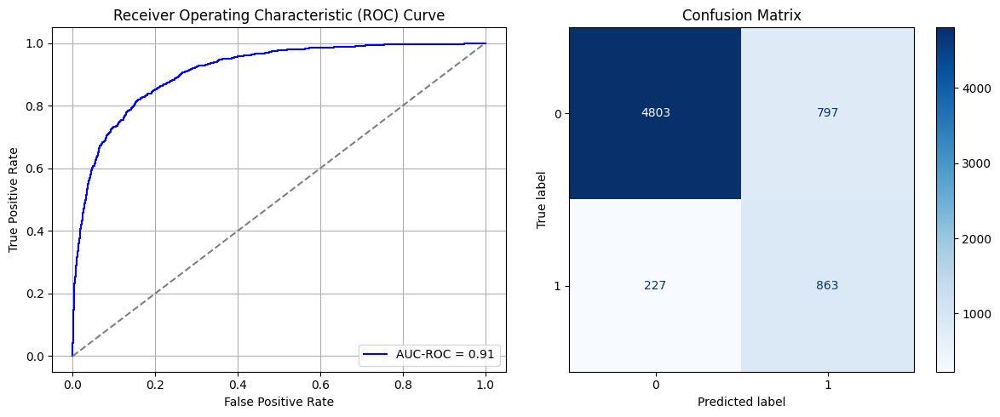

Best threshold based on F1-score: 0.6804271340370178
False Negative Rate: 0.20825688073394497
Time elapsed (performance): 1.0332147720000648
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6157 - loss: 0.6738 - val_AUC: 0.7512 - val_loss: 0.6091
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7462 - loss: 0.5993 - val_AUC: 0.8141 - val_loss: 0.5401
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8241 - loss: 0.5254 - val_AUC: 0.8434 - val_loss: 0.5116
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8548 - loss: 0.4829 - val_AUC: 0.8665 - val_loss: 0.4647
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8667 - loss: 0.4610 - val_AUC: 0.8831 - val_loss: 0.4519
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8923 - loss: 0.4198 - val_AUC: 0.8970 - val_loss: 0.4187
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8988 - loss: 0.4055 - val_AUC: 0.9113 - val_loss: 0.3880
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9070 - loss: 0.3890 - val_AUC: 0.9106 - val_loss: 0.3843
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9219 -

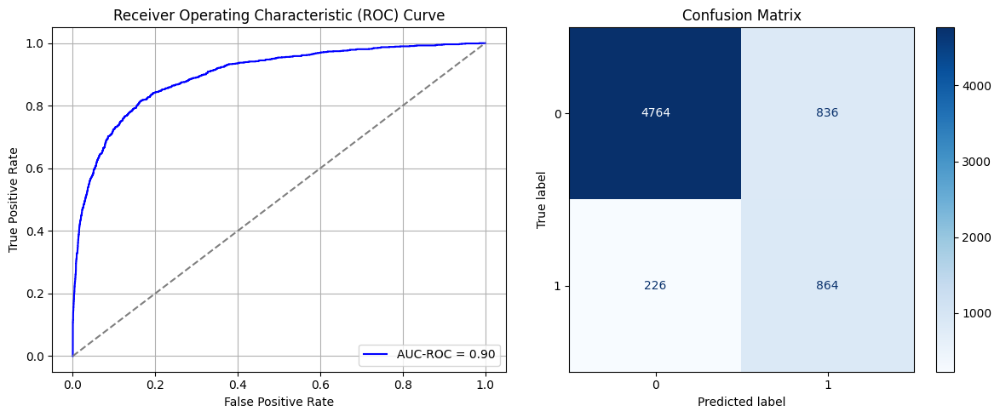

Best threshold based on F1-score: 0.6378945708274841
False Negative Rate: 0.20733944954128442
Time elapsed (performance): 1.0467698729989934
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6545 - loss: 0.6674 - val_AUC: 0.7458 - val_loss: 0.6098
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7509 - loss: 0.5973 - val_AUC: 0.8373 - val_loss: 0.5355
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8169 - loss: 0.5357 - val_AUC: 0.8703 - val_loss: 0.4765
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8584 - loss: 0.4794 - val_AUC: 0.8894 - val_loss: 0.4450
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8657 - loss: 0.4618 - val_AUC: 0.9044 - val_loss: 0.4081
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8932 - loss: 0.4204 - val_AUC: 0.9166 - val_loss: 0.3867
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9005 - loss: 0.4043 - val_AUC: 0.9223 - val_loss: 0.3763
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9059 - loss: 0.3922 - val_AUC: 0.9258 - val_loss: 0.3552
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9145 -

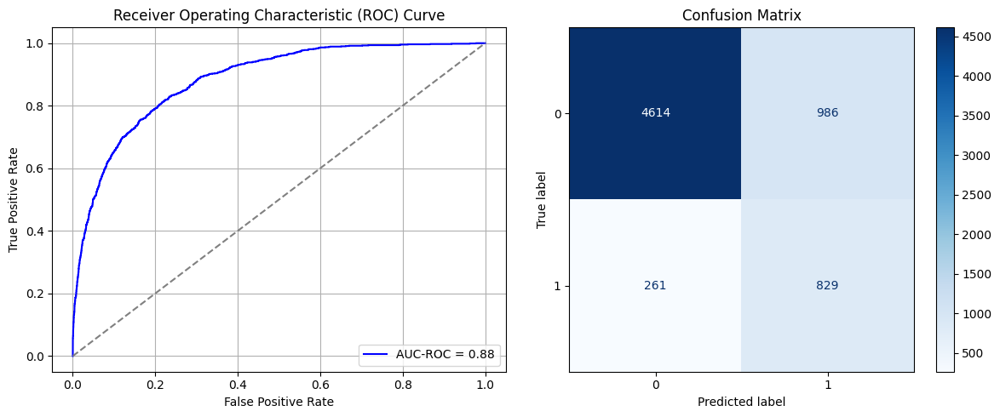

Best threshold based on F1-score: 0.694578230381012
False Negative Rate: 0.23944954128440368
Time elapsed (performance): 1.0792548769968562
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5749 - loss: 0.6833 - val_AUC: 0.7111 - val_loss: 0.6295
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7257 - loss: 0.6154 - val_AUC: 0.8269 - val_loss: 0.5464
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8263 - loss: 0.5266 - val_AUC: 0.8853 - val_loss: 0.4670
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8656 - loss: 0.4714 - val_AUC: 0.9016 - val_loss: 0.4217
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8752 - loss: 0.4490 - val_AUC: 0.9137 - val_loss: 0.3956
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8934 - loss: 0.4175 - val_AUC: 0.9122 - val_loss: 0.3900
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9029 - loss: 0.3989 - val_AUC: 0.9245 - val_loss: 0.3625
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9114 - loss: 0.3818 - val_AUC: 0.9328 - val_loss: 0.3587
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9196 -

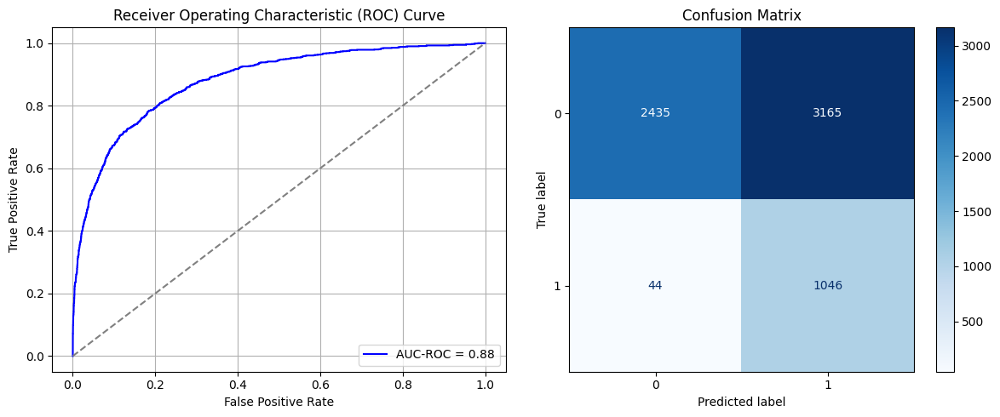

Best threshold based on F1-score: 0.8945743441581726
False Negative Rate: 0.04036697247706422
Time elapsed (performance): 0.8930240919980861
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6519 - loss: 0.6600 - val_AUC: 0.7590 - val_loss: 0.6019
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7673 - loss: 0.5870 - val_AUC: 0.8370 - val_loss: 0.5336
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8383 - loss: 0.5171 - val_AUC: 0.8719 - val_loss: 0.4791
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8665 - loss: 0.4698 - val_AUC: 0.8881 - val_loss: 0.4438
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8823 - loss: 0.4414 - val_AUC: 0.9007 - val_loss: 0.4118
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4253 - val_AUC: 0.9107 - val_loss: 0.3935
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8994 - loss: 0.4037 - val_AUC: 0.9195 - val_loss: 0.3763
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9082 - loss: 0.3862 - val_AUC: 0.9222 - val_loss: 0.3615
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9144 -

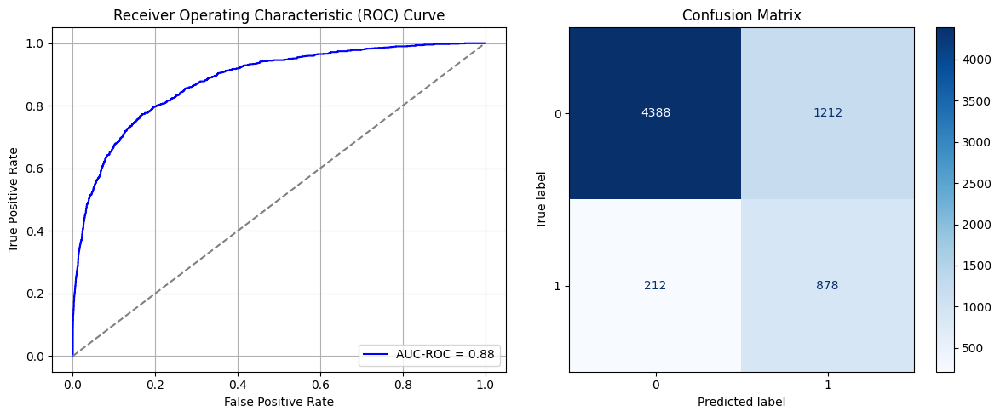

Best threshold based on F1-score: 0.7011648416519165
False Negative Rate: 0.1944954128440367
Time elapsed (performance): 1.0476341120011057
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6184 - loss: 0.6713 - val_AUC: 0.7585 - val_loss: 0.6018
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7795 - loss: 0.5797 - val_AUC: 0.8042 - val_loss: 0.5514
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8181 - loss: 0.5292 - val_AUC: 0.8461 - val_loss: 0.4973
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8667 - loss: 0.4694 - val_AUC: 0.8657 - val_loss: 0.4677
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8736 - loss: 0.4537 - val_AUC: 0.8725 - val_loss: 0.4490
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8919 - loss: 0.4199 - val_AUC: 0.8861 - val_loss: 0.4267
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9064 - loss: 0.3951 - val_AUC: 0.8982 - val_loss: 0.4100
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9170 - loss: 0.3738 - val_AUC: 0.9049 - val_loss: 0.3992
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9218 -

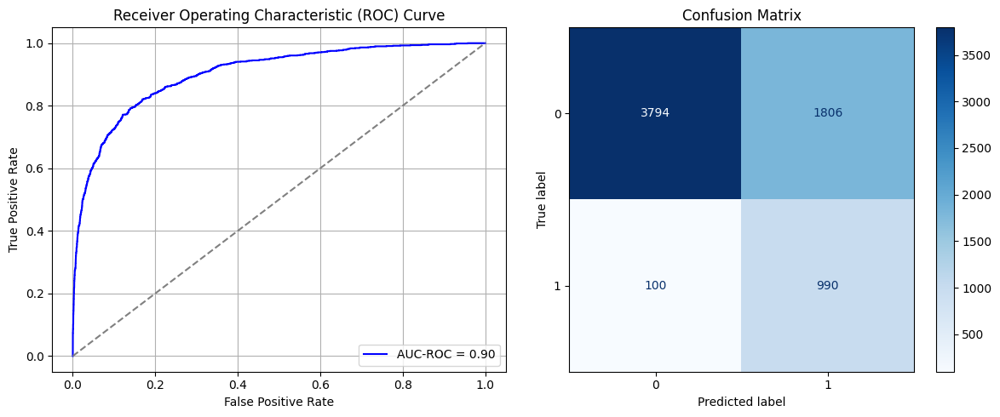

Best threshold based on F1-score: 0.83785480260849
False Negative Rate: 0.09174311926605505
Time elapsed (performance): 1.0734341999996104
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6150 - loss: 0.6755 - val_AUC: 0.7514 - val_loss: 0.6087
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7512 - loss: 0.6016 - val_AUC: 0.8275 - val_loss: 0.5558
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8067 - loss: 0.5486 - val_AUC: 0.8596 - val_loss: 0.5051
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8524 - loss: 0.4890 - val_AUC: 0.8816 - val_loss: 0.5077
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8672 - loss: 0.4639 - val_AUC: 0.9008 - val_loss: 0.4240
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4337 - val_AUC: 0.9103 - val_loss: 0.3969
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8928 - loss: 0.4173 - val_AUC: 0.9185 - val_loss: 0.3951
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9084 - loss: 0.3902 - val_AUC: 0.9244 - val_loss: 0.3627
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9144 -

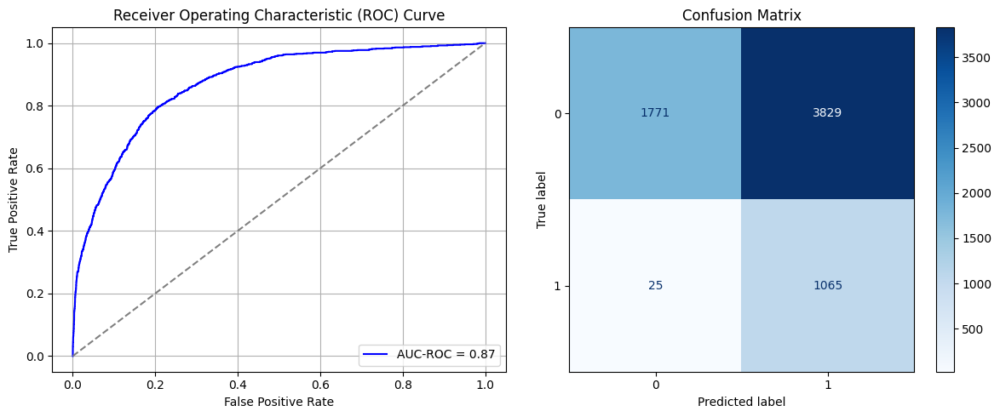

Best threshold based on F1-score: 0.9158745408058167
False Negative Rate: 0.022935779816513763
Time elapsed (performance): 0.919908216001204
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6198 - loss: 0.6704 - val_AUC: 0.7603 - val_loss: 0.6055
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7644 - loss: 0.5888 - val_AUC: 0.8348 - val_loss: 0.5294
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8236 - loss: 0.5293 - val_AUC: 0.8757 - val_loss: 0.4752
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8605 - loss: 0.4762 - val_AUC: 0.8885 - val_loss: 0.4374
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8717 - loss: 0.4522 - val_AUC: 0.9107 - val_loss: 0.4138
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8855 - loss: 0.4296 - val_AUC: 0.9201 - val_loss: 0.3913
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8899 - loss: 0.4202 - val_AUC: 0.9297 - val_loss: 0.3757
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8984 - loss: 0.4056 - val_AUC: 0.9341 - val_loss: 0.3600
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9103 -

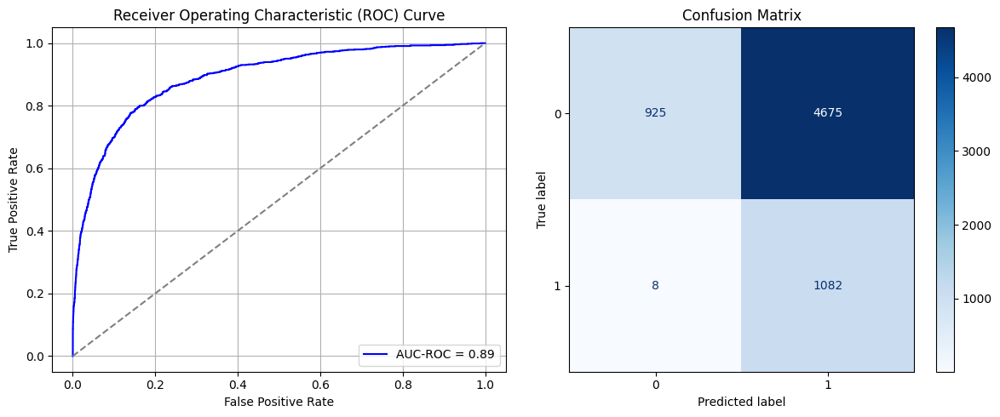

Best threshold based on F1-score: 0.9769500494003296
False Negative Rate: 0.007339449541284404
Time elapsed (performance): 0.893802382001013
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6776 - loss: 0.6561 - val_AUC: 0.7699 - val_loss: 0.5897
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8001 - loss: 0.5635 - val_AUC: 0.8261 - val_loss: 0.5370
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8417 - loss: 0.5088 - val_AUC: 0.8565 - val_loss: 0.4828
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8677 - loss: 0.4618 - val_AUC: 0.8761 - val_loss: 0.4587
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8940 - loss: 0.4234 - val_AUC: 0.8846 - val_loss: 0.4556
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8970 - loss: 0.4125 - val_AUC: 0.8942 - val_loss: 0.4207
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9106 - loss: 0.3850 - val_AUC: 0.9005 - val_loss: 0.4039
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9164 - loss: 0.3738 - val_AUC: 0.9086 - val_loss: 0.3882
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9292 -

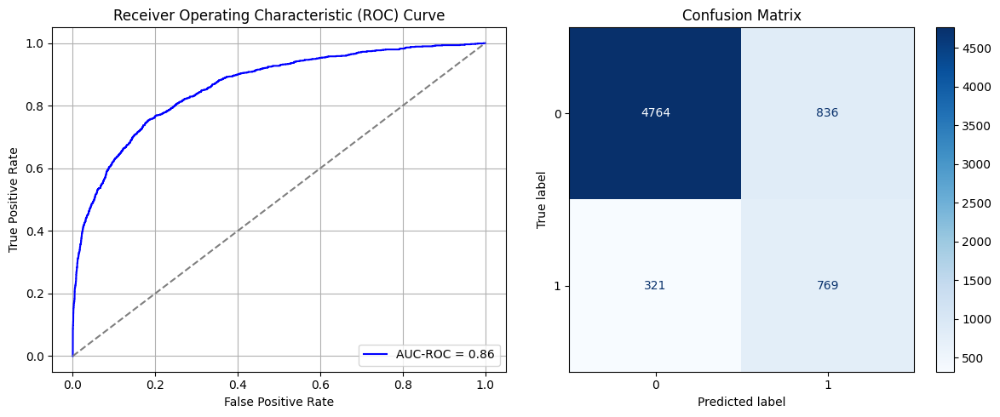

Best threshold based on F1-score: 0.6300433874130249
False Negative Rate: 0.2944954128440367
Time elapsed (performance): 0.8941866389977804
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.5813 - loss: 0.6888 - val_AUC: 0.7623 - val_loss: 0.6030
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7668 - loss: 0.5901 - val_AUC: 0.8352 - val_loss: 0.5378
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8145 - loss: 0.5398 - val_AUC: 0.8676 - val_loss: 0.5055
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8364 - loss: 0.5090 - val_AUC: 0.8764 - val_loss: 0.4678
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8582 - loss: 0.4744 - val_AUC: 0.8939 - val_loss: 0.4289
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8755 - loss: 0.4487 - val_AUC: 0.9009 - val_loss: 0.4115
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8871 - loss: 0.4268 - val_AUC: 0.9093 - val_loss: 0.4055
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8999 - loss: 0.4058 - val_AUC: 0.9115 - val_loss: 0.3882
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8939 -

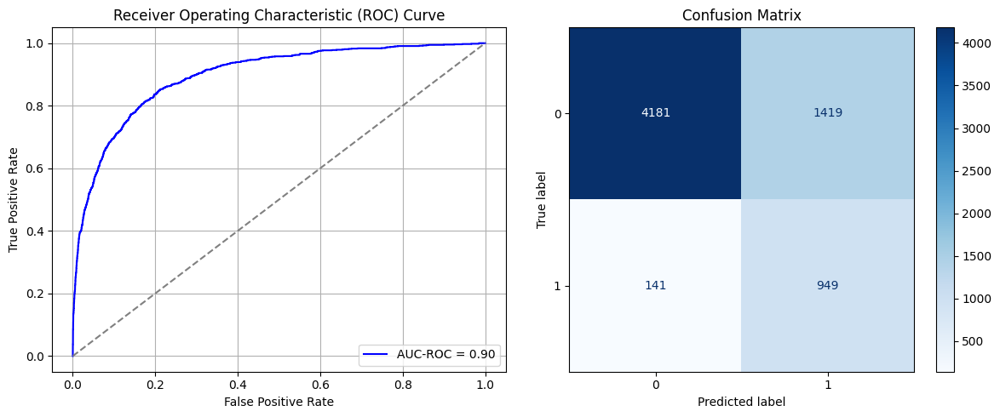

Best threshold based on F1-score: 0.7251437902450562
False Negative Rate: 0.12935779816513762
Time elapsed (performance): 1.0651556189986877
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6301 - loss: 0.6697 - val_AUC: 0.7750 - val_loss: 0.5905
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7578 - loss: 0.5912 - val_AUC: 0.8311 - val_loss: 0.5348
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8058 - loss: 0.5403 - val_AUC: 0.8719 - val_loss: 0.4750
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8490 - loss: 0.4900 - val_AUC: 0.8847 - val_loss: 0.4446
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8624 - loss: 0.4671 - val_AUC: 0.9079 - val_loss: 0.4342
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4433 - val_AUC: 0.9086 - val_loss: 0.4152
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8861 - loss: 0.4280 - val_AUC: 0.9297 - val_loss: 0.3787
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8899 - loss: 0.4213 - val_AUC: 0.9332 - val_loss: 0.3599
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9148 -

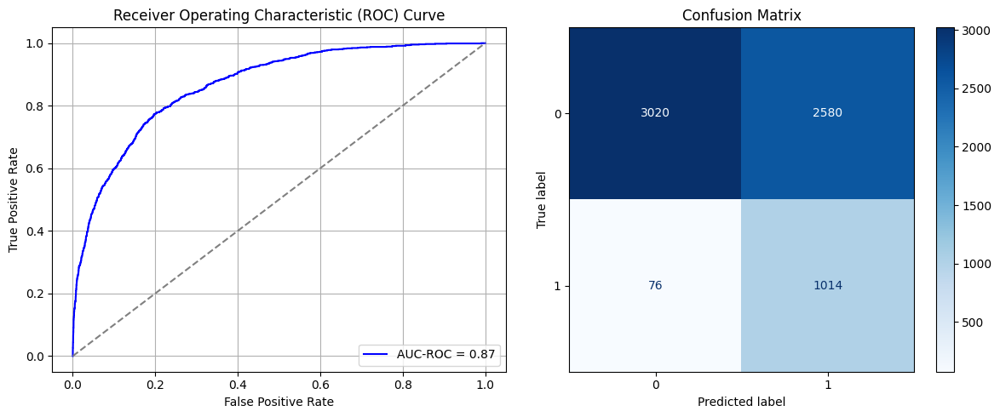

Best threshold based on F1-score: 0.8382670283317566
False Negative Rate: 0.06972477064220184
Time elapsed (performance): 1.356482833998598


In [37]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=False)
    data_S_SRS_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRS = data_S_SRS_RUS.iloc[:, :-1]
    y_S_SRS = data_S_SRS_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS, y_S_SRS, test_size=0.20, random_state=0)
    model_SRS = create_dnn_model(X_S_train.shape[1])
    result_SRS = train_and_evaluate(model_SRS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS = Transductive_TL(model_SRS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS)
    FPR.append(result_TL_SRS[0])
    TNR.append(result_TL_SRS[1])
    FNR.append(result_TL_SRS[2])
    TPR.append(result_TL_SRS[3])
    TL_time.append(result_TL_SRS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [40]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.17572477064220185
Variance: 0.018300741193708364


In [41]:
print(ParamFit)
ParamFit.to_csv('SRS_RUS.csv')

    Source time       FPR       TPR       FNR       TNR  Target time
0      8.545885  0.067143  0.573394  0.426606  0.932857     0.704606
1      9.610394  0.085536  0.721101  0.278899  0.914464     0.747965
2      8.343505  0.572679  0.955046  0.044954  0.427321     1.066014
3      7.667610  0.112500  0.684404  0.315596  0.887500     0.746963
4      8.625445  0.698393  0.976147  0.023853  0.301607     0.739488
5      9.003747  0.097143  0.610092  0.389908  0.902857     1.043747
6      7.894333  0.112321  0.554128  0.445872  0.887679     1.079262
7      8.858516  0.742679  0.984404  0.015596  0.257321     2.518756
8      8.809438  0.501250  0.961468  0.038532  0.498750     1.071921
9      9.880973  0.374286  0.930275  0.069725  0.625714     0.807382
10     9.506452  0.630536  0.948624  0.051376  0.369464     1.045731
11     7.559529  0.190714  0.782569  0.217431  0.809286     1.098497
12     8.398410  0.168393  0.743119  0.256881  0.831607     1.067861
13     9.277788  0.479286  0.96330

## Simple Random Sampling with Replacement:

In [42]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

3910
19400


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6932 - loss: 0.6535 - val_AUC: 0.7769 - val_loss: 0.5846
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7872 - loss: 0.5689 - val_AUC: 0.8304 - val_loss: 0.5390
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8317 - loss: 0.5162 - val_AUC: 0.8529 - val_loss: 0.4842
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8627 - loss: 0.4691 - val_AUC: 0.8731 - val_loss: 0.4591
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8589 - loss: 0.4691 - val_AUC: 0.8856 - val_loss: 0.4359
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4380 - val_AUC: 0.8948 - val_loss: 0.4248
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4276 - val_AUC: 0.9051 - val_loss: 0.4159
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9100 - loss: 0.3843 - val_AUC: 0.9165 - val_loss: 0.3777
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9187 -

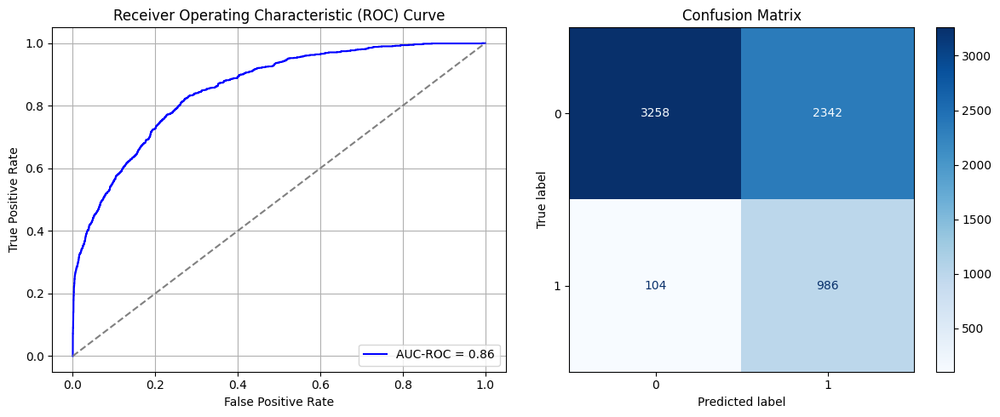

Best threshold based on F1-score: 0.8554633259773254
False Negative Rate: 0.09541284403669725
Time elapsed (performance): 0.7567506349987525
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.5973 - loss: 0.6788 - val_AUC: 0.7370 - val_loss: 0.6200
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7407 - loss: 0.6110 - val_AUC: 0.7990 - val_loss: 0.5856
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7953 - loss: 0.5576 - val_AUC: 0.8452 - val_loss: 0.5328
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8366 - loss: 0.5082 - val_AUC: 0.8785 - val_loss: 0.4629
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8566 - loss: 0.4802 - val_AUC: 0.8892 - val_loss: 0.4847
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8703 - loss: 0.4584 - val_AUC: 0.8992 - val_loss: 0.4107
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8944 - loss: 0.4151 - val_AUC: 0.9115 - val_loss: 0.3896
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8959 - loss: 0.4092 - val_AUC: 0.9212 - val_loss: 0.3711
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9007 -

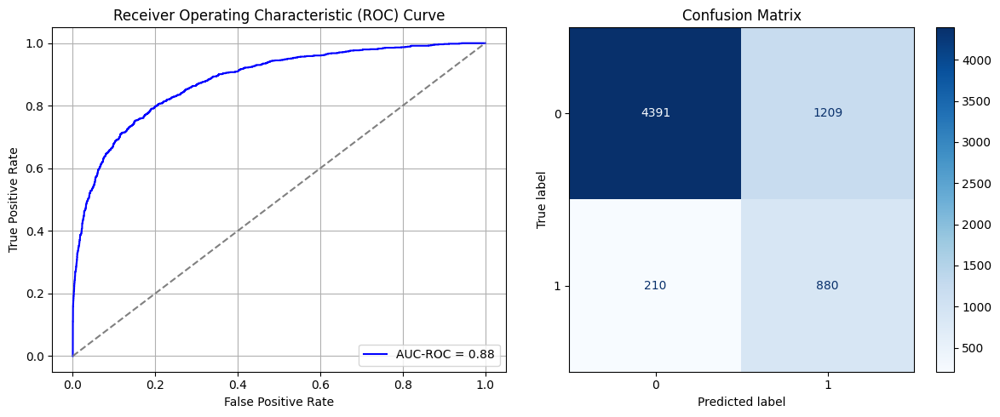

Best threshold based on F1-score: 0.7278417348861694
False Negative Rate: 0.1926605504587156
Time elapsed (performance): 1.1611880050004402
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6404 - loss: 0.6672 - val_AUC: 0.7887 - val_loss: 0.5934
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7803 - loss: 0.5810 - val_AUC: 0.8484 - val_loss: 0.5469
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8158 - loss: 0.5382 - val_AUC: 0.8712 - val_loss: 0.4801
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8517 - loss: 0.4883 - val_AUC: 0.8834 - val_loss: 0.4527
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8597 - loss: 0.4718 - val_AUC: 0.8948 - val_loss: 0.4333
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4513 - val_AUC: 0.9046 - val_loss: 0.4041
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 - loss: 0.4353 - val_AUC: 0.9173 - val_loss: 0.3902
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8974 - loss: 0.4104 - val_AUC: 0.9248 - val_loss: 0.3709
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9101 -

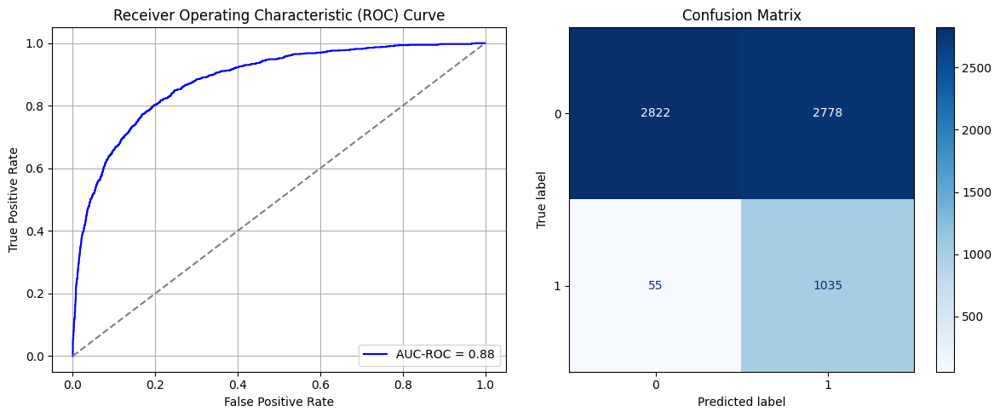

Best threshold based on F1-score: 0.917116105556488
False Negative Rate: 0.05045871559633028
Time elapsed (performance): 0.73115776999839
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5778 - loss: 0.6859 - val_AUC: 0.7176 - val_loss: 0.6343
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7186 - loss: 0.6253 - val_AUC: 0.7821 - val_loss: 0.5747
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7766 - loss: 0.5743 - val_AUC: 0.8460 - val_loss: 0.5247
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8220 - loss: 0.5296 - val_AUC: 0.8700 - val_loss: 0.4915
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8636 - loss: 0.4739 - val_AUC: 0.8909 - val_loss: 0.4520
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4557 - val_AUC: 0.8982 - val_loss: 0.4258
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8820 - loss: 0.4394 - val_AUC: 0.9033 - val_loss: 0.4158
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8873 - loss: 0.4267 - val_AUC: 0.9107 - val_loss: 0.3969
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9016 -

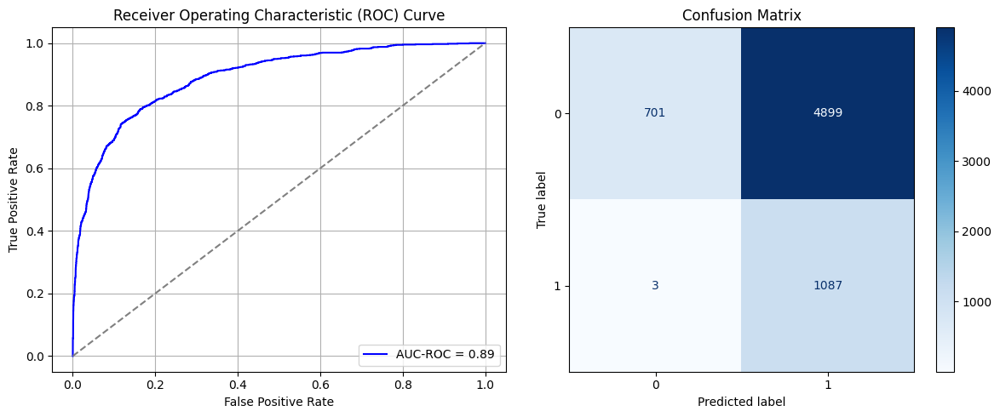

Best threshold based on F1-score: 0.9768115878105164
False Negative Rate: 0.0027522935779816515
Time elapsed (performance): 2.892003102999297
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6288 - loss: 0.6696 - val_AUC: 0.7419 - val_loss: 0.6124
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7626 - loss: 0.5931 - val_AUC: 0.8380 - val_loss: 0.5535
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8204 - loss: 0.5307 - val_AUC: 0.8692 - val_loss: 0.4895
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8516 - loss: 0.4847 - val_AUC: 0.8893 - val_loss: 0.4400
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8923 - loss: 0.4273 - val_AUC: 0.9009 - val_loss: 0.4544
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9013 - loss: 0.4052 - val_AUC: 0.9091 - val_loss: 0.3929
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9165 - loss: 0.3743 - val_AUC: 0.9197 - val_loss: 0.3722
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9239 - loss: 0.3584 - val_AUC: 0.9270 - val_loss: 0.3736
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9271 -

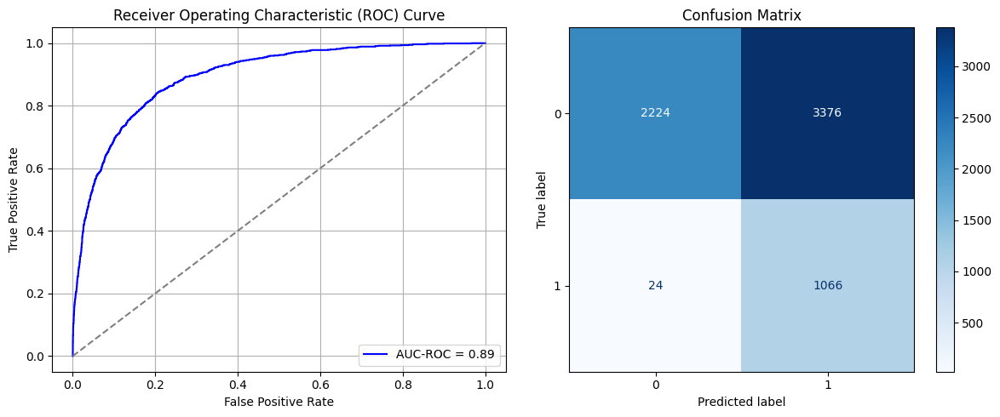

Best threshold based on F1-score: 0.9167067408561707
False Negative Rate: 0.022018348623853212
Time elapsed (performance): 0.794737656997313
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6335 - loss: 0.6662 - val_AUC: 0.7473 - val_loss: 0.6142
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7737 - loss: 0.5827 - val_AUC: 0.8262 - val_loss: 0.5688
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8298 - loss: 0.5214 - val_AUC: 0.8517 - val_loss: 0.5051
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8521 - loss: 0.4855 - val_AUC: 0.8642 - val_loss: 0.5027
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8703 - loss: 0.4550 - val_AUC: 0.8869 - val_loss: 0.4294
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8975 - loss: 0.4123 - val_AUC: 0.8933 - val_loss: 0.4515
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9026 - loss: 0.4021 - val_AUC: 0.9034 - val_loss: 0.3999
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9054 - loss: 0.3944 - val_AUC: 0.9146 - val_loss: 0.3872
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9176 -

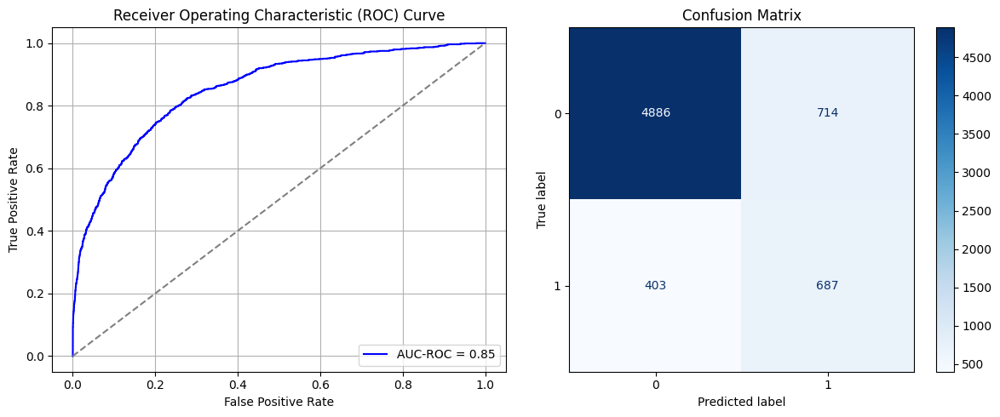

Best threshold based on F1-score: 0.5471689105033875
False Negative Rate: 0.3697247706422018
Time elapsed (performance): 0.779964805002237
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6090 - loss: 0.6738 - val_AUC: 0.7573 - val_loss: 0.6089
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7565 - loss: 0.5972 - val_AUC: 0.8257 - val_loss: 0.5554
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8088 - loss: 0.5476 - val_AUC: 0.8447 - val_loss: 0.5014
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8377 - loss: 0.5033 - val_AUC: 0.8722 - val_loss: 0.4632
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8634 - loss: 0.4642 - val_AUC: 0.8790 - val_loss: 0.4477
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8839 - loss: 0.4328 - val_AUC: 0.8884 - val_loss: 0.4379
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8934 - loss: 0.4168 - val_AUC: 0.8978 - val_loss: 0.4151
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9006 - loss: 0.4021 - val_AUC: 0.9051 - val_loss: 0.4103
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8943 -

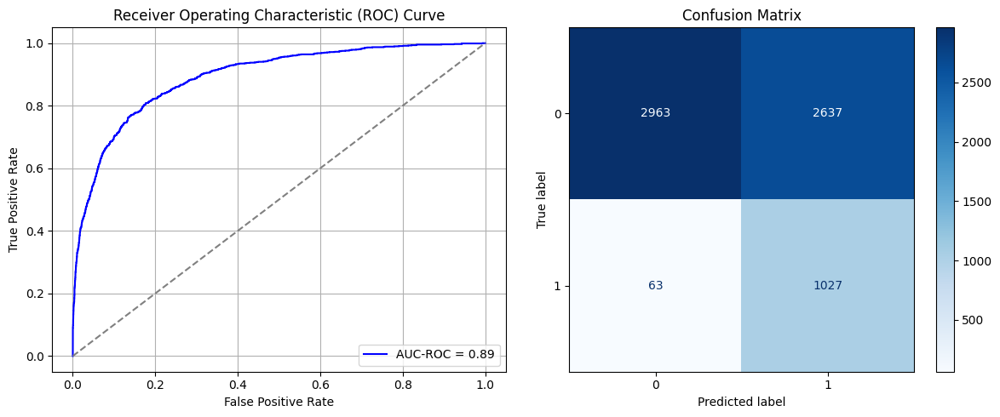

Best threshold based on F1-score: 0.8794655203819275
False Negative Rate: 0.05779816513761468
Time elapsed (performance): 1.3011976950001554
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6414 - loss: 0.6675 - val_AUC: 0.7534 - val_loss: 0.6211
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7491 - loss: 0.6045 - val_AUC: 0.8224 - val_loss: 0.5470
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8106 - loss: 0.5436 - val_AUC: 0.8673 - val_loss: 0.4852
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8429 - loss: 0.5003 - val_AUC: 0.8836 - val_loss: 0.4436
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8560 - loss: 0.4758 - val_AUC: 0.9004 - val_loss: 0.4376
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4438 - val_AUC: 0.9044 - val_loss: 0.4393
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8863 - loss: 0.4312 - val_AUC: 0.9152 - val_loss: 0.3810
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9107 - loss: 0.3897 - val_AUC: 0.9262 - val_loss: 0.3632
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9038 -

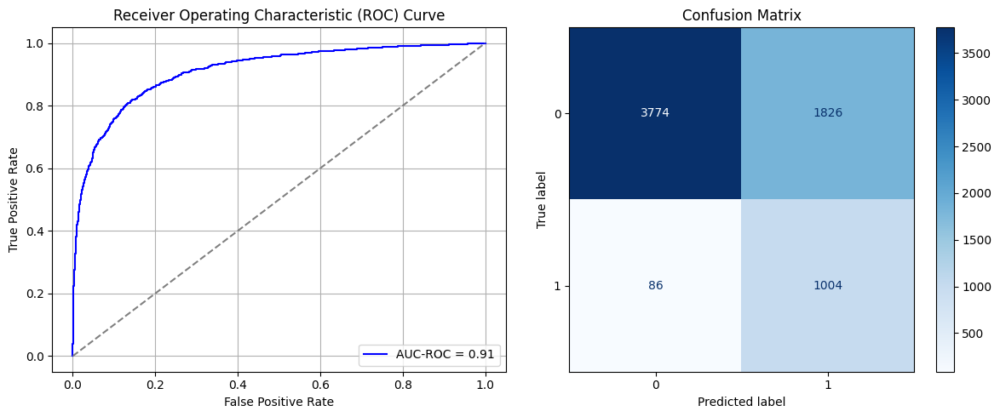

Best threshold based on F1-score: 0.8059247136116028
False Negative Rate: 0.07889908256880734
Time elapsed (performance): 0.7814386130012281
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6594 - loss: 0.6608 - val_AUC: 0.7608 - val_loss: 0.5958
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7840 - loss: 0.5710 - val_AUC: 0.8298 - val_loss: 0.5283
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8440 - loss: 0.5052 - val_AUC: 0.8667 - val_loss: 0.4758
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8701 - loss: 0.4624 - val_AUC: 0.8841 - val_loss: 0.4395
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8957 - loss: 0.4176 - val_AUC: 0.8980 - val_loss: 0.4186
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8980 - loss: 0.4047 - val_AUC: 0.9043 - val_loss: 0.4010
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9193 - loss: 0.3705 - val_AUC: 0.9065 - val_loss: 0.4386
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9169 - loss: 0.3715 - val_AUC: 0.9188 - val_loss: 0.3710
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9246 -

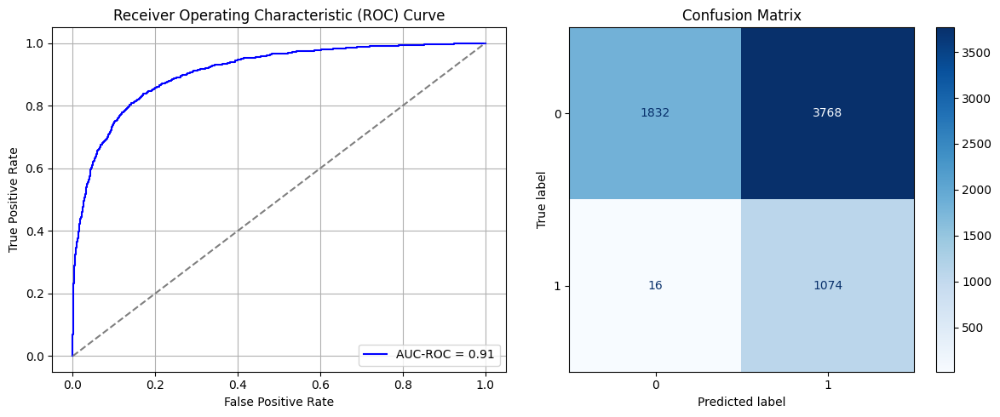

Best threshold based on F1-score: 0.9611610174179077
False Negative Rate: 0.014678899082568808
Time elapsed (performance): 0.7807973589988251
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6855 - loss: 0.6591 - val_AUC: 0.7924 - val_loss: 0.5984
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7944 - loss: 0.5674 - val_AUC: 0.8398 - val_loss: 0.5312
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8312 - loss: 0.5172 - val_AUC: 0.8645 - val_loss: 0.4822
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8529 - loss: 0.4837 - val_AUC: 0.8756 - val_loss: 0.4552
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8639 - loss: 0.4634 - val_AUC: 0.8882 - val_loss: 0.4322
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8742 - loss: 0.4480 - val_AUC: 0.8926 - val_loss: 0.4366
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4451 - val_AUC: 0.9028 - val_loss: 0.4139
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9012 - loss: 0.4029 - val_AUC: 0.9125 - val_loss: 0.4039
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9065 -

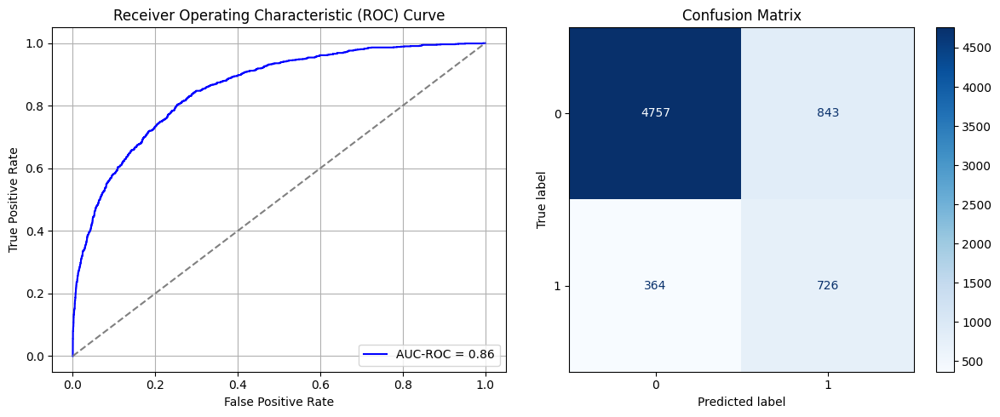

Best threshold based on F1-score: 0.6143168210983276
False Negative Rate: 0.3339449541284404
Time elapsed (performance): 1.0542394460026117
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6264 - loss: 0.6714 - val_AUC: 0.7726 - val_loss: 0.5918
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7818 - loss: 0.5779 - val_AUC: 0.8274 - val_loss: 0.5297
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8353 - loss: 0.5166 - val_AUC: 0.8552 - val_loss: 0.4898
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8563 - loss: 0.4828 - val_AUC: 0.8723 - val_loss: 0.4603
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8651 - loss: 0.4627 - val_AUC: 0.8852 - val_loss: 0.4387
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4377 - val_AUC: 0.9007 - val_loss: 0.4433
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8950 - loss: 0.4175 - val_AUC: 0.9069 - val_loss: 0.4507
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8966 - loss: 0.4108 - val_AUC: 0.9108 - val_loss: 0.3904
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9132 -

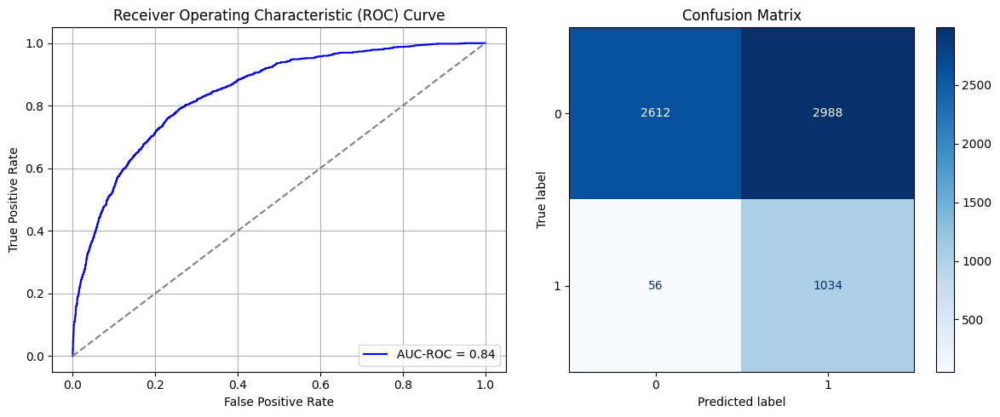

Best threshold based on F1-score: 0.8744317889213562
False Negative Rate: 0.05137614678899083
Time elapsed (performance): 0.7832057790001272
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6048 - loss: 0.6725 - val_AUC: 0.7392 - val_loss: 0.6144
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7511 - loss: 0.5990 - val_AUC: 0.8200 - val_loss: 0.5449
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8008 - loss: 0.5505 - val_AUC: 0.8628 - val_loss: 0.4898
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8484 - loss: 0.4949 - val_AUC: 0.8908 - val_loss: 0.4471
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8656 - loss: 0.4649 - val_AUC: 0.9020 - val_loss: 0.4300
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8893 - loss: 0.4271 - val_AUC: 0.9150 - val_loss: 0.3957
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8926 - loss: 0.4172 - val_AUC: 0.9097 - val_loss: 0.3928
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8949 - loss: 0.4132 - val_AUC: 0.9282 - val_loss: 0.3633
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9090 -

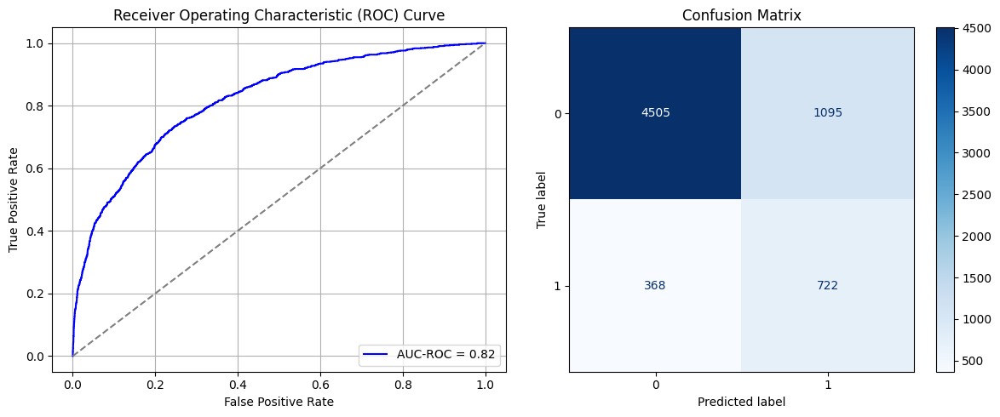

Best threshold based on F1-score: 0.6860276460647583
False Negative Rate: 0.3376146788990826
Time elapsed (performance): 1.2122858349976013
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6138 - loss: 0.6753 - val_AUC: 0.7621 - val_loss: 0.6203
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7628 - loss: 0.6031 - val_AUC: 0.8339 - val_loss: 0.5343
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8246 - loss: 0.5339 - val_AUC: 0.8711 - val_loss: 0.4793
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8613 - loss: 0.4773 - val_AUC: 0.8982 - val_loss: 0.4538
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8623 - loss: 0.4676 - val_AUC: 0.9070 - val_loss: 0.4093
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8967 - loss: 0.4143 - val_AUC: 0.9120 - val_loss: 0.3948
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8956 - loss: 0.4128 - val_AUC: 0.9242 - val_loss: 0.3698
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9046 - loss: 0.3954 - val_AUC: 0.9337 - val_loss: 0.3435
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9252 -

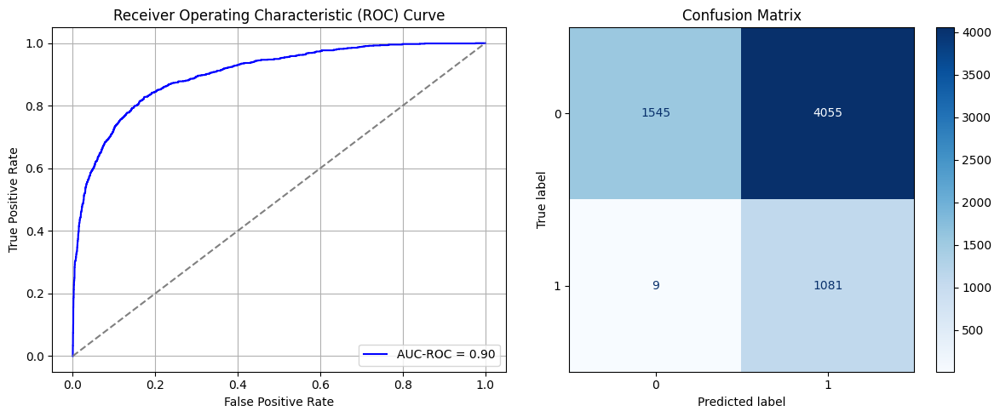

Best threshold based on F1-score: 0.9360626339912415
False Negative Rate: 0.008256880733944955
Time elapsed (performance): 0.76345117800156
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6554 - loss: 0.6612 - val_AUC: 0.7484 - val_loss: 0.6071
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7587 - loss: 0.5912 - val_AUC: 0.8085 - val_loss: 0.5430
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8192 - loss: 0.5286 - val_AUC: 0.8501 - val_loss: 0.5226
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8578 - loss: 0.4795 - val_AUC: 0.8711 - val_loss: 0.4829
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8654 - loss: 0.4606 - val_AUC: 0.8789 - val_loss: 0.4408
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8923 - loss: 0.4185 - val_AUC: 0.8940 - val_loss: 0.4191
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9014 - loss: 0.4008 - val_AUC: 0.9086 - val_loss: 0.4145
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9106 - loss: 0.3846 - val_AUC: 0.9130 - val_loss: 0.3816
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9143 -

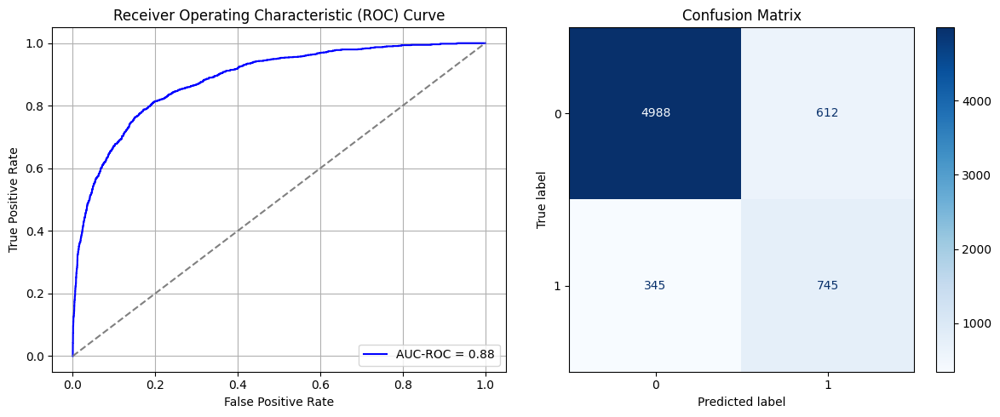

Best threshold based on F1-score: 0.549347996711731
False Negative Rate: 0.3165137614678899
Time elapsed (performance): 0.77806444199814
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6052 - loss: 0.6791 - val_AUC: 0.7428 - val_loss: 0.6215
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7483 - loss: 0.6070 - val_AUC: 0.8233 - val_loss: 0.5648
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8062 - loss: 0.5467 - val_AUC: 0.8645 - val_loss: 0.4848
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8467 - loss: 0.4956 - val_AUC: 0.8840 - val_loss: 0.4455
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8685 - loss: 0.4571 - val_AUC: 0.8994 - val_loss: 0.4412
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8871 - loss: 0.4303 - val_AUC: 0.9161 - val_loss: 0.3901
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9001 - loss: 0.4071 - val_AUC: 0.9245 - val_loss: 0.3954
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9122 - loss: 0.3830 - val_AUC: 0.9304 - val_loss: 0.3537
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9262 -

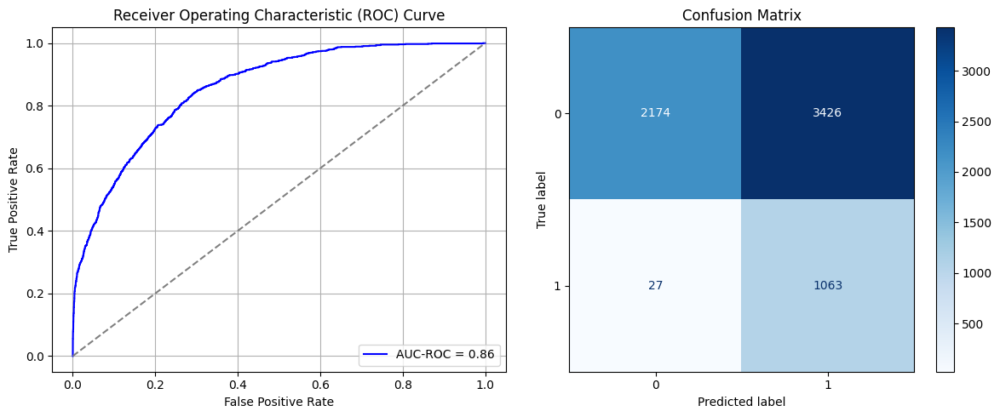

Best threshold based on F1-score: 0.9410514235496521
False Negative Rate: 0.024770642201834864
Time elapsed (performance): 1.0491062580003927
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6333 - loss: 0.6694 - val_AUC: 0.7542 - val_loss: 0.6061
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7531 - loss: 0.5978 - val_AUC: 0.8342 - val_loss: 0.5314
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8262 - loss: 0.5258 - val_AUC: 0.8788 - val_loss: 0.4752
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8535 - loss: 0.4891 - val_AUC: 0.8983 - val_loss: 0.4296
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4482 - val_AUC: 0.9117 - val_loss: 0.4070
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8852 - loss: 0.4327 - val_AUC: 0.9189 - val_loss: 0.3820
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9004 - loss: 0.4076 - val_AUC: 0.9289 - val_loss: 0.3567
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9082 - loss: 0.3892 - val_AUC: 0.9359 - val_loss: 0.3438
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9095 -

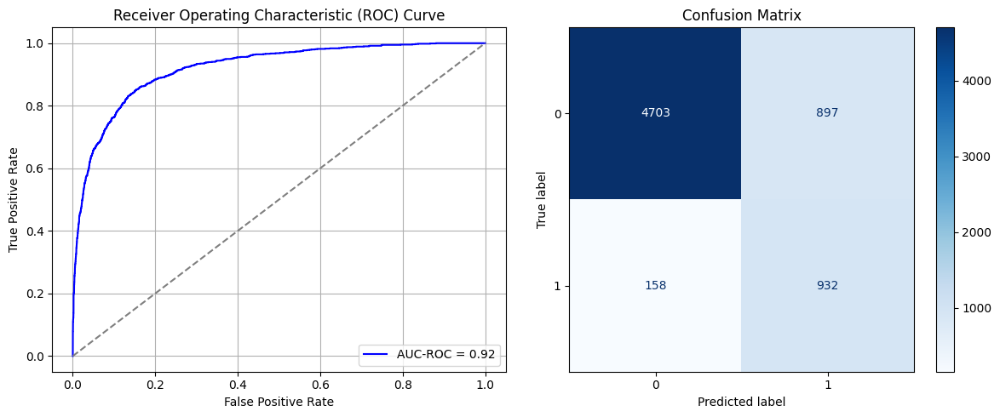

Best threshold based on F1-score: 0.7124207615852356
False Negative Rate: 0.14495412844036698
Time elapsed (performance): 0.7580670499992266
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6231 - loss: 0.6699 - val_AUC: 0.7726 - val_loss: 0.5877
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7822 - loss: 0.5753 - val_AUC: 0.8534 - val_loss: 0.5107
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8467 - loss: 0.5050 - val_AUC: 0.8762 - val_loss: 0.4644
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8678 - loss: 0.4654 - val_AUC: 0.8941 - val_loss: 0.4384
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4435 - val_AUC: 0.9090 - val_loss: 0.4069
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4228 - val_AUC: 0.9130 - val_loss: 0.3858
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9014 - loss: 0.4028 - val_AUC: 0.9138 - val_loss: 0.3772
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9086 - loss: 0.3866 - val_AUC: 0.9247 - val_loss: 0.3579
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9195 -

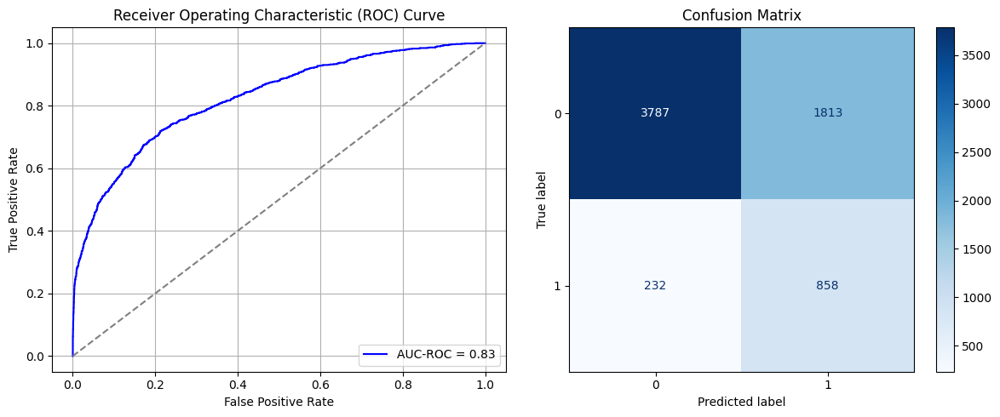

Best threshold based on F1-score: 0.8279366493225098
False Negative Rate: 0.21284403669724772
Time elapsed (performance): 1.0306127240000933
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6363 - loss: 0.6690 - val_AUC: 0.7547 - val_loss: 0.6123
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7547 - loss: 0.5977 - val_AUC: 0.8151 - val_loss: 0.5519
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7990 - loss: 0.5568 - val_AUC: 0.8553 - val_loss: 0.5010
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8339 - loss: 0.5131 - val_AUC: 0.8816 - val_loss: 0.4511
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8700 - loss: 0.4618 - val_AUC: 0.9036 - val_loss: 0.4160
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8867 - loss: 0.4340 - val_AUC: 0.9089 - val_loss: 0.4064
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9039 - loss: 0.3980 - val_AUC: 0.9242 - val_loss: 0.3662
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9129 - loss: 0.3835 - val_AUC: 0.9319 - val_loss: 0.3480
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9233 -

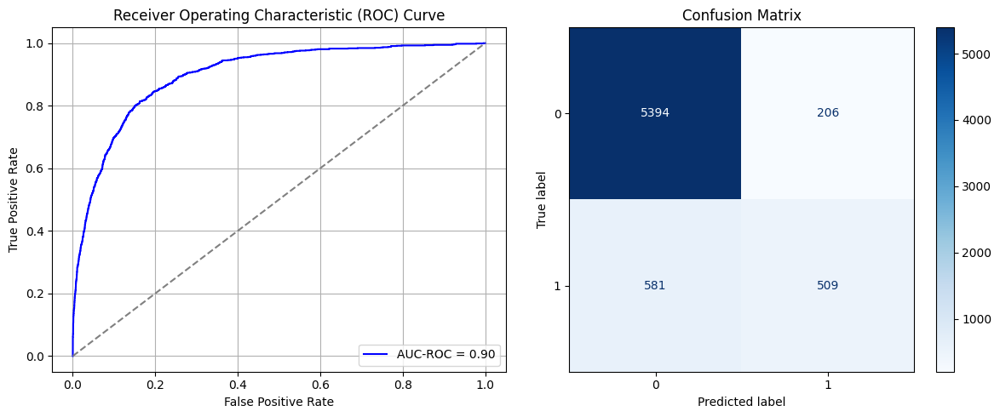

Best threshold based on F1-score: 0.3214452564716339
False Negative Rate: 0.5330275229357798
Time elapsed (performance): 0.7712823240035505
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6143 - loss: 0.6712 - val_AUC: 0.7541 - val_loss: 0.6011
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7452 - loss: 0.6011 - val_AUC: 0.8216 - val_loss: 0.5390
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8228 - loss: 0.5316 - val_AUC: 0.8613 - val_loss: 0.4974
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8458 - loss: 0.4952 - val_AUC: 0.8857 - val_loss: 0.4489
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8707 - loss: 0.4591 - val_AUC: 0.8930 - val_loss: 0.4300
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8868 - loss: 0.4296 - val_AUC: 0.9096 - val_loss: 0.3916
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8998 - loss: 0.4061 - val_AUC: 0.9165 - val_loss: 0.4031
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9061 - loss: 0.3923 - val_AUC: 0.9255 - val_loss: 0.3589
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9126 -

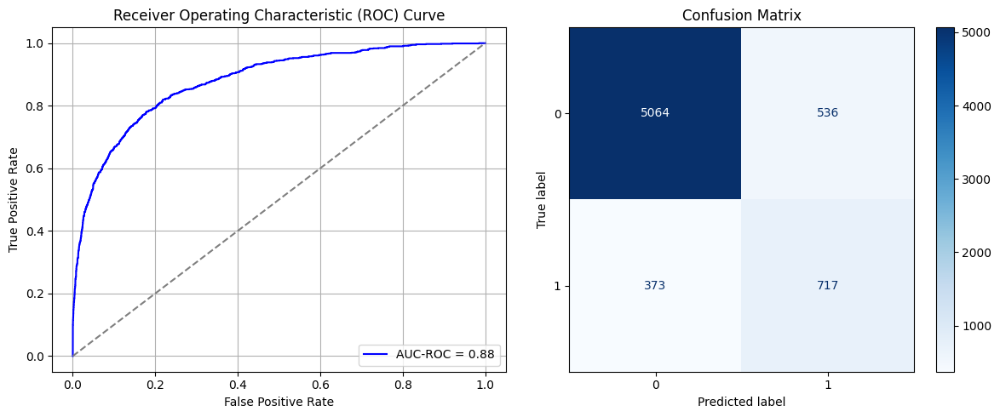

Best threshold based on F1-score: 0.5110737681388855
False Negative Rate: 0.3422018348623853
Time elapsed (performance): 1.022360689999914
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6033 - loss: 0.6774 - val_AUC: 0.7642 - val_loss: 0.6120
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7557 - loss: 0.5980 - val_AUC: 0.8353 - val_loss: 0.5421
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8125 - loss: 0.5398 - val_AUC: 0.8684 - val_loss: 0.4855
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8473 - loss: 0.4959 - val_AUC: 0.8875 - val_loss: 0.4429
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 - loss: 0.4436 - val_AUC: 0.8963 - val_loss: 0.4251
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4397 - val_AUC: 0.9051 - val_loss: 0.4177
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8876 - loss: 0.4250 - val_AUC: 0.9126 - val_loss: 0.3821
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9067 - loss: 0.3908 - val_AUC: 0.9222 - val_loss: 0.3695
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9182 -

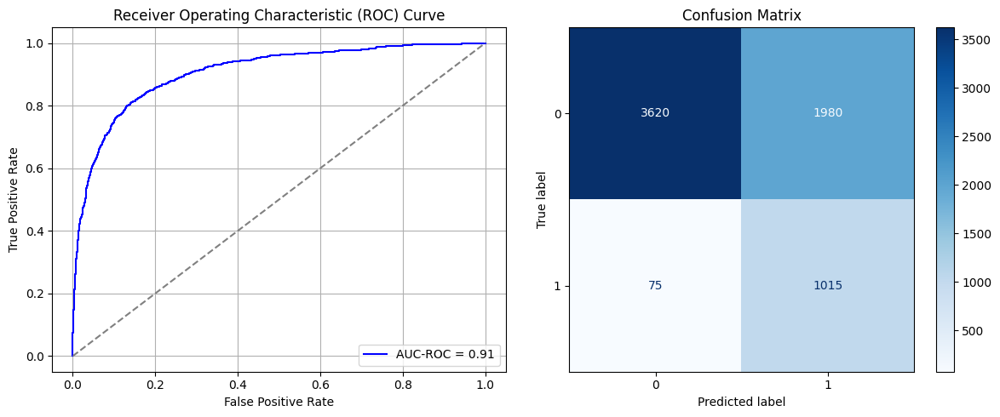

Best threshold based on F1-score: 0.8472822308540344
False Negative Rate: 0.06880733944954129
Time elapsed (performance): 0.7832922419984243
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6082 - loss: 0.6760 - val_AUC: 0.7736 - val_loss: 0.6008
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7531 - loss: 0.5968 - val_AUC: 0.8482 - val_loss: 0.5159
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8299 - loss: 0.5210 - val_AUC: 0.8827 - val_loss: 0.4590
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8649 - loss: 0.4682 - val_AUC: 0.9033 - val_loss: 0.4311
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4524 - val_AUC: 0.9115 - val_loss: 0.3976
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8951 - loss: 0.4151 - val_AUC: 0.9209 - val_loss: 0.3727
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9016 - loss: 0.4015 - val_AUC: 0.9313 - val_loss: 0.3597
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9093 - loss: 0.3880 - val_AUC: 0.9351 - val_loss: 0.3813
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9271 -

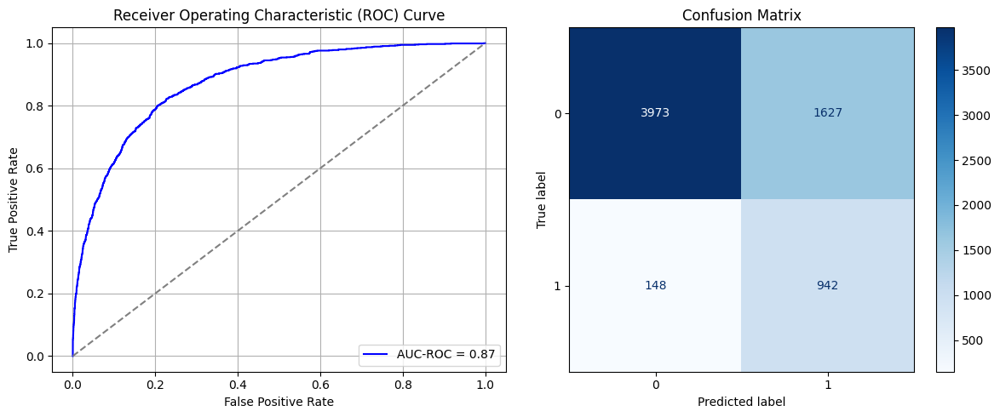

Best threshold based on F1-score: 0.7201728820800781
False Negative Rate: 0.13577981651376148
Time elapsed (performance): 1.2019329379982082
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6089 - loss: 0.6758 - val_AUC: 0.7497 - val_loss: 0.6116
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7483 - loss: 0.5997 - val_AUC: 0.8193 - val_loss: 0.5394
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8085 - loss: 0.5434 - val_AUC: 0.8543 - val_loss: 0.5018
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8323 - loss: 0.5131 - val_AUC: 0.8709 - val_loss: 0.4618
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8592 - loss: 0.4722 - val_AUC: 0.8848 - val_loss: 0.4377
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4477 - val_AUC: 0.8958 - val_loss: 0.4180
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8903 - loss: 0.4212 - val_AUC: 0.9055 - val_loss: 0.4034
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8962 - loss: 0.4074 - val_AUC: 0.9132 - val_loss: 0.3975
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9086 -

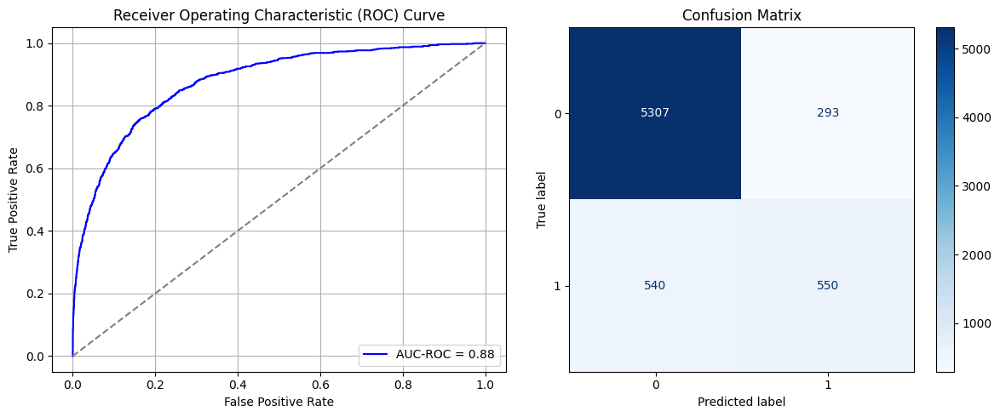

Best threshold based on F1-score: 0.37874579429626465
False Negative Rate: 0.4954128440366973
Time elapsed (performance): 0.8140459109999938
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6194 - loss: 0.6696 - val_AUC: 0.7514 - val_loss: 0.6047
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7663 - loss: 0.5874 - val_AUC: 0.8037 - val_loss: 0.5542
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8166 - loss: 0.5371 - val_AUC: 0.8464 - val_loss: 0.5083
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8516 - loss: 0.4900 - val_AUC: 0.8775 - val_loss: 0.4572
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8659 - loss: 0.4641 - val_AUC: 0.8928 - val_loss: 0.4563
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8934 - loss: 0.4194 - val_AUC: 0.9073 - val_loss: 0.4006
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9131 - loss: 0.3855 - val_AUC: 0.9165 - val_loss: 0.3825
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9246 - loss: 0.3613 - val_AUC: 0.9233 - val_loss: 0.3733
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9315 -

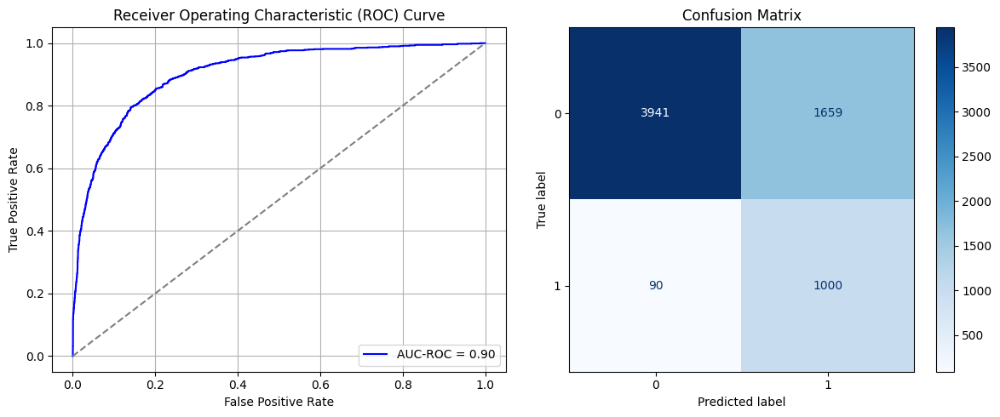

Best threshold based on F1-score: 0.8066142201423645
False Negative Rate: 0.08256880733944955
Time elapsed (performance): 1.0455318839995016
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6498 - loss: 0.6565 - val_AUC: 0.7867 - val_loss: 0.5785
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7739 - loss: 0.5796 - val_AUC: 0.8352 - val_loss: 0.5231
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8423 - loss: 0.5077 - val_AUC: 0.8673 - val_loss: 0.4768
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8471 - loss: 0.4898 - val_AUC: 0.8769 - val_loss: 0.4540
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8741 - loss: 0.4491 - val_AUC: 0.8915 - val_loss: 0.4254
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8949 - loss: 0.4152 - val_AUC: 0.9020 - val_loss: 0.4512
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9004 - loss: 0.4047 - val_AUC: 0.9053 - val_loss: 0.4010
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9118 - loss: 0.3806 - val_AUC: 0.9197 - val_loss: 0.3730
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9152 -

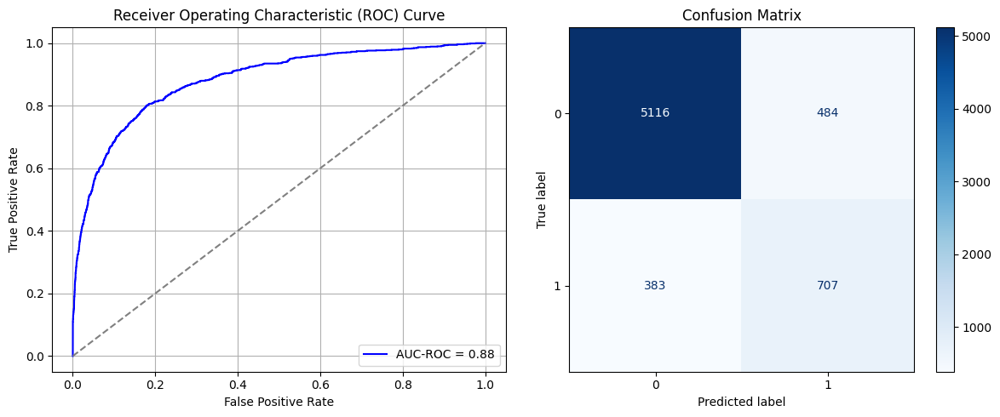

Best threshold based on F1-score: 0.48788607120513916
False Negative Rate: 0.3513761467889908
Time elapsed (performance): 1.0519468439997581
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6178 - loss: 0.6728 - val_AUC: 0.7555 - val_loss: 0.5966
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7526 - loss: 0.5935 - val_AUC: 0.8165 - val_loss: 0.5409
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8175 - loss: 0.5335 - val_AUC: 0.8537 - val_loss: 0.4941
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8330 - loss: 0.5075 - val_AUC: 0.8696 - val_loss: 0.4665
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4508 - val_AUC: 0.8771 - val_loss: 0.4885
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8740 - loss: 0.4493 - val_AUC: 0.8936 - val_loss: 0.4242
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8923 - loss: 0.4195 - val_AUC: 0.9038 - val_loss: 0.4086
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9030 - loss: 0.3995 - val_AUC: 0.9130 - val_loss: 0.3845
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9129 -

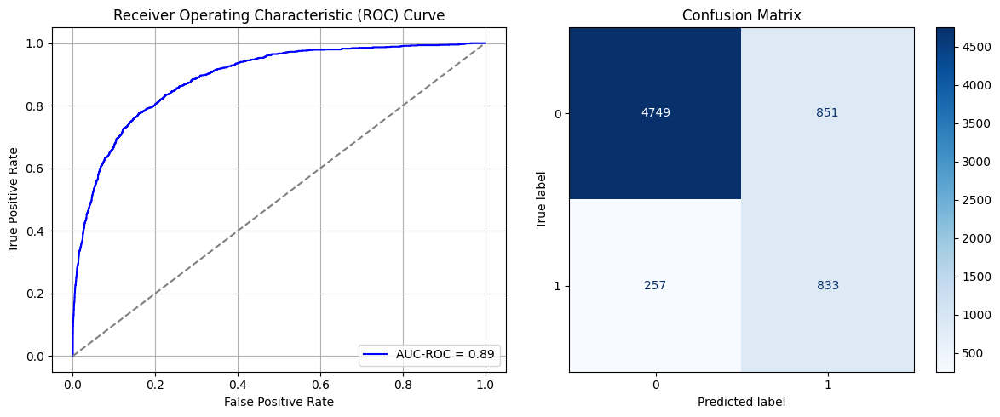

Best threshold based on F1-score: 0.645703911781311
False Negative Rate: 0.23577981651376148
Time elapsed (performance): 1.0546123679996526
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6125 - loss: 0.6756 - val_AUC: 0.7581 - val_loss: 0.6080
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7457 - loss: 0.6037 - val_AUC: 0.8144 - val_loss: 0.5476
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8057 - loss: 0.5459 - val_AUC: 0.8553 - val_loss: 0.5039
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8495 - loss: 0.4926 - val_AUC: 0.8770 - val_loss: 0.4686
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8666 - loss: 0.4643 - val_AUC: 0.8886 - val_loss: 0.4321
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 - loss: 0.4429 - val_AUC: 0.8941 - val_loss: 0.4242
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 - loss: 0.4330 - val_AUC: 0.9042 - val_loss: 0.3994
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8942 - loss: 0.4125 - val_AUC: 0.9126 - val_loss: 0.3852
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9056 -

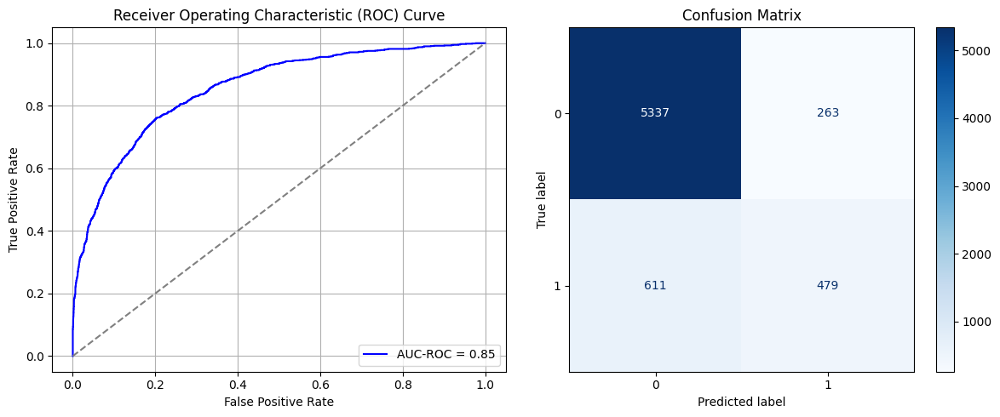

Best threshold based on F1-score: 0.35876768827438354
False Negative Rate: 0.5605504587155963
Time elapsed (performance): 1.2107024539982376
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6322 - loss: 0.6691 - val_AUC: 0.7815 - val_loss: 0.6023
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7718 - loss: 0.5926 - val_AUC: 0.8448 - val_loss: 0.5148
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8269 - loss: 0.5218 - val_AUC: 0.8758 - val_loss: 0.4852
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8675 - loss: 0.4655 - val_AUC: 0.8992 - val_loss: 0.4255
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8922 - loss: 0.4222 - val_AUC: 0.9154 - val_loss: 0.3932
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9047 - loss: 0.3950 - val_AUC: 0.9271 - val_loss: 0.3765
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9215 - loss: 0.3628 - val_AUC: 0.9326 - val_loss: 0.3458
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9312 - loss: 0.3442 - val_AUC: 0.9418 - val_loss: 0.3407
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9358 -

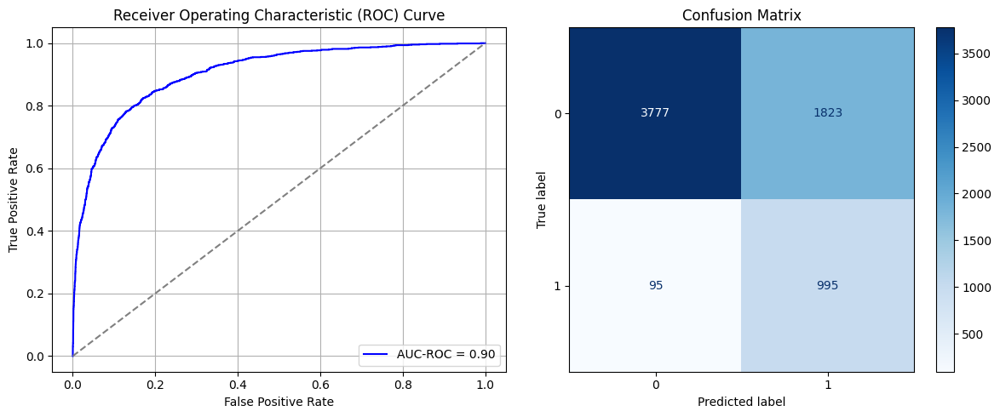

Best threshold based on F1-score: 0.8418828248977661
False Negative Rate: 0.0871559633027523
Time elapsed (performance): 3.91061894700033
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6412 - loss: 0.6698 - val_AUC: 0.7677 - val_loss: 0.6005
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7900 - loss: 0.5733 - val_AUC: 0.8490 - val_loss: 0.5257
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8329 - loss: 0.5175 - val_AUC: 0.8792 - val_loss: 0.4705
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8647 - loss: 0.4698 - val_AUC: 0.8942 - val_loss: 0.4418
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4498 - val_AUC: 0.8998 - val_loss: 0.4191
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 - loss: 0.4284 - val_AUC: 0.9090 - val_loss: 0.3945
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9021 - loss: 0.4031 - val_AUC: 0.9186 - val_loss: 0.3854
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9209 - loss: 0.3653 - val_AUC: 0.9279 - val_loss: 0.3674
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9231 -

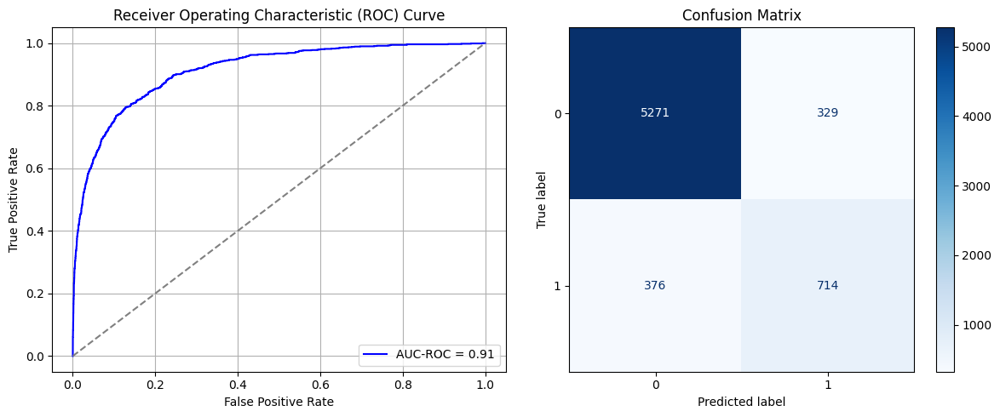

Best threshold based on F1-score: 0.4689800441265106
False Negative Rate: 0.344954128440367
Time elapsed (performance): 1.0534937849988637
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6199 - loss: 0.6715 - val_AUC: 0.7451 - val_loss: 0.6099
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7538 - loss: 0.5966 - val_AUC: 0.8271 - val_loss: 0.5403
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8187 - loss: 0.5338 - val_AUC: 0.8547 - val_loss: 0.4951
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8445 - loss: 0.4958 - val_AUC: 0.8781 - val_loss: 0.4681
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 - loss: 0.4419 - val_AUC: 0.8829 - val_loss: 0.4805
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 - loss: 0.4325 - val_AUC: 0.9041 - val_loss: 0.4618
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8931 - loss: 0.4168 - val_AUC: 0.9150 - val_loss: 0.3823
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9168 - loss: 0.3738 - val_AUC: 0.9221 - val_loss: 0.3664
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9228 -

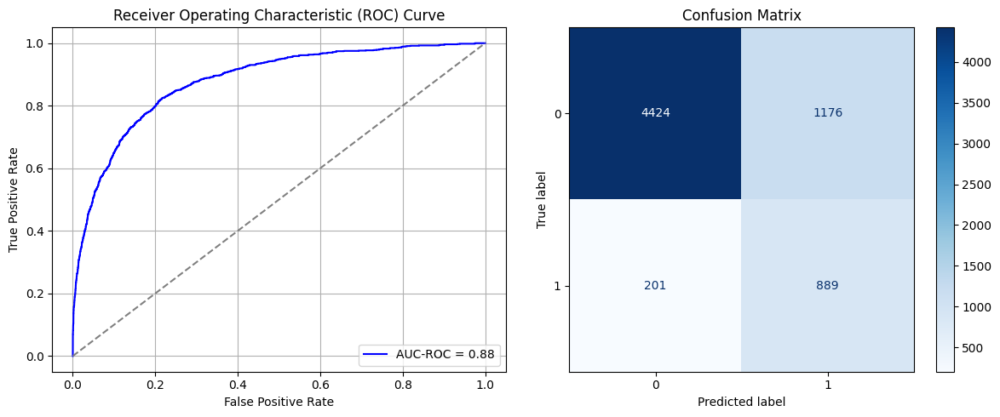

Best threshold based on F1-score: 0.6454841494560242
False Negative Rate: 0.18440366972477065
Time elapsed (performance): 1.0686580619985762
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6801 - loss: 0.6578 - val_AUC: 0.7832 - val_loss: 0.6016
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7949 - loss: 0.5676 - val_AUC: 0.8474 - val_loss: 0.5177
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8362 - loss: 0.5137 - val_AUC: 0.8609 - val_loss: 0.4917
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4632 - val_AUC: 0.8816 - val_loss: 0.4957
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4440 - val_AUC: 0.8986 - val_loss: 0.4177
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8923 - loss: 0.4199 - val_AUC: 0.9076 - val_loss: 0.4100
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8983 - loss: 0.4067 - val_AUC: 0.9137 - val_loss: 0.3892
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9118 - loss: 0.3817 - val_AUC: 0.9251 - val_loss: 0.3705
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9260 -

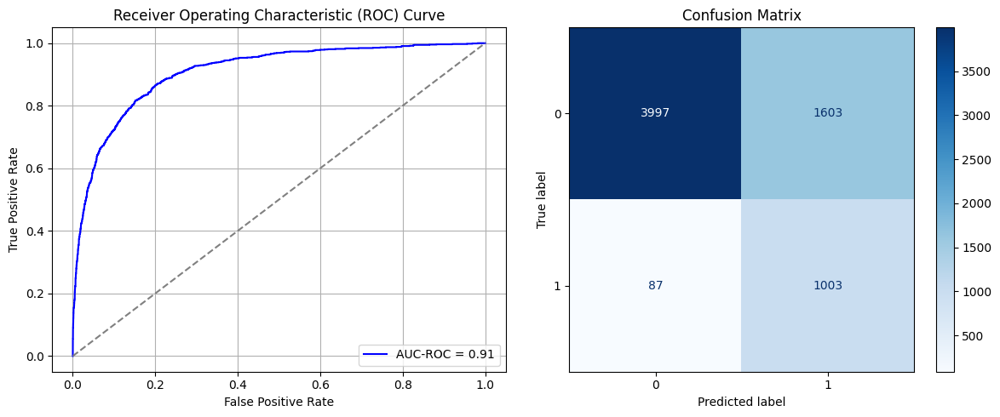

Best threshold based on F1-score: 0.8077037334442139
False Negative Rate: 0.0798165137614679
Time elapsed (performance): 1.0579290950008726
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6305 - loss: 0.6682 - val_AUC: 0.7733 - val_loss: 0.5987
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7615 - loss: 0.5937 - val_AUC: 0.8308 - val_loss: 0.5322
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8240 - loss: 0.5326 - val_AUC: 0.8769 - val_loss: 0.4789
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8499 - loss: 0.4928 - val_AUC: 0.8907 - val_loss: 0.4473
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8847 - loss: 0.4422 - val_AUC: 0.9044 - val_loss: 0.4159
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8941 - loss: 0.4184 - val_AUC: 0.9128 - val_loss: 0.3925
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8999 - loss: 0.4069 - val_AUC: 0.9215 - val_loss: 0.3722
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9152 - loss: 0.3788 - val_AUC: 0.9201 - val_loss: 0.3883
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9173 -

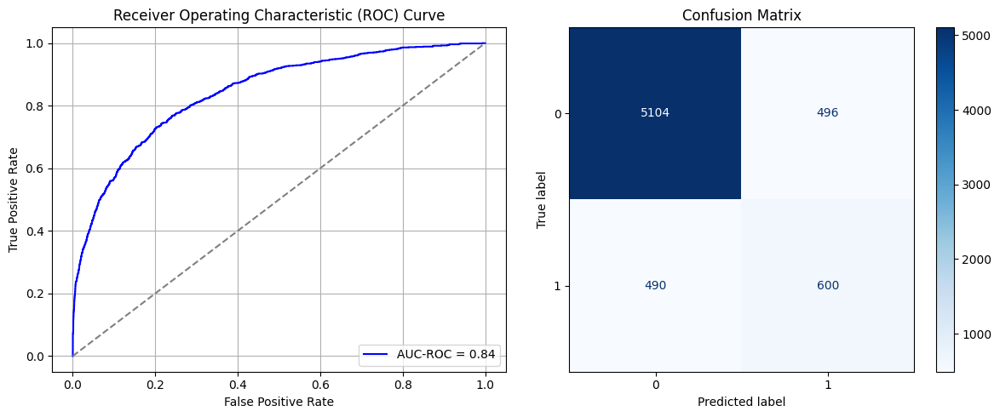

Best threshold based on F1-score: 0.4538313150405884
False Negative Rate: 0.44954128440366975
Time elapsed (performance): 1.068314684998768
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6337 - loss: 0.6687 - val_AUC: 0.7614 - val_loss: 0.5991
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7912 - loss: 0.5739 - val_AUC: 0.8253 - val_loss: 0.5294
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8391 - loss: 0.5080 - val_AUC: 0.8603 - val_loss: 0.5025
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8627 - loss: 0.4721 - val_AUC: 0.8741 - val_loss: 0.4664
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8734 - loss: 0.4513 - val_AUC: 0.8912 - val_loss: 0.4283
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8920 - loss: 0.4224 - val_AUC: 0.8951 - val_loss: 0.4277
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8984 - loss: 0.4072 - val_AUC: 0.9004 - val_loss: 0.4117
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9134 - loss: 0.3787 - val_AUC: 0.9130 - val_loss: 0.3805
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9192 -

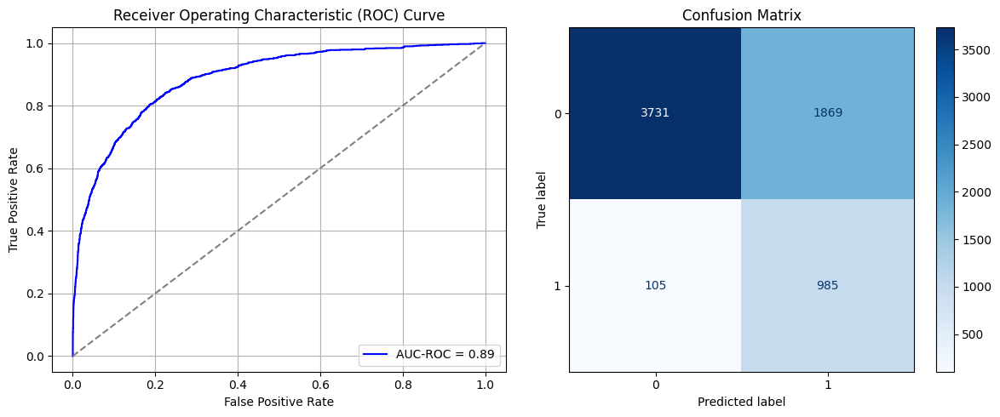

Best threshold based on F1-score: 0.8037828803062439
False Negative Rate: 0.0963302752293578
Time elapsed (performance): 0.8525042319997738
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6476 - loss: 0.6688 - val_AUC: 0.7550 - val_loss: 0.6007
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7795 - loss: 0.5805 - val_AUC: 0.8539 - val_loss: 0.5073
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8487 - loss: 0.5018 - val_AUC: 0.8880 - val_loss: 0.4447
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8696 - loss: 0.4595 - val_AUC: 0.8908 - val_loss: 0.4331
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8737 - loss: 0.4511 - val_AUC: 0.9080 - val_loss: 0.3976
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8988 - loss: 0.4092 - val_AUC: 0.9274 - val_loss: 0.3956
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9030 - loss: 0.4018 - val_AUC: 0.9299 - val_loss: 0.3559
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9147 - loss: 0.3766 - val_AUC: 0.9428 - val_loss: 0.3289
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9259 -

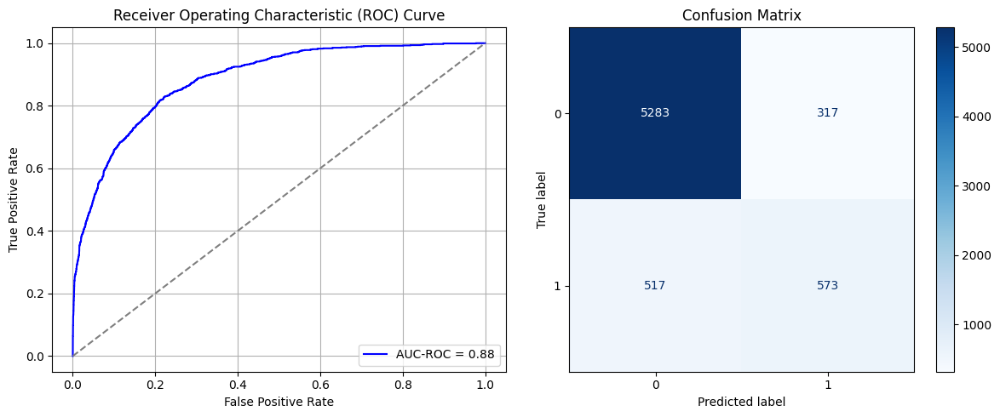

Best threshold based on F1-score: 0.3438335955142975
False Negative Rate: 0.4743119266055046
Time elapsed (performance): 1.0462452960018709
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6479 - loss: 0.6656 - val_AUC: 0.7733 - val_loss: 0.5951
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7919 - loss: 0.5727 - val_AUC: 0.8435 - val_loss: 0.5200
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8416 - loss: 0.5093 - val_AUC: 0.8765 - val_loss: 0.4678
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8689 - loss: 0.4655 - val_AUC: 0.8916 - val_loss: 0.4374
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8938 - loss: 0.4194 - val_AUC: 0.8963 - val_loss: 0.4918
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8954 - loss: 0.4142 - val_AUC: 0.9143 - val_loss: 0.3904
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9203 - loss: 0.3667 - val_AUC: 0.9195 - val_loss: 0.4256
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9142 - loss: 0.3778 - val_AUC: 0.9261 - val_loss: 0.3535
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9321 -

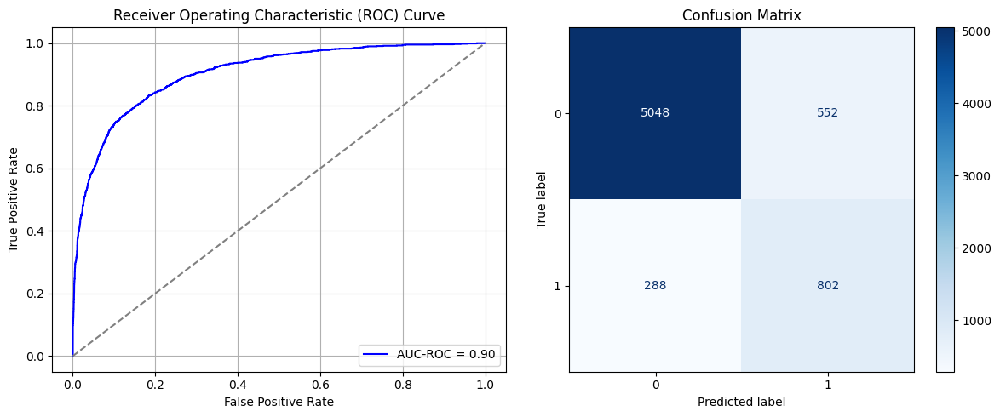

Best threshold based on F1-score: 0.5243217349052429
False Negative Rate: 0.26422018348623855
Time elapsed (performance): 1.061292930997297
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6079 - loss: 0.6758 - val_AUC: 0.7367 - val_loss: 0.6170
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7447 - loss: 0.6039 - val_AUC: 0.8107 - val_loss: 0.5667
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7962 - loss: 0.5570 - val_AUC: 0.8591 - val_loss: 0.4966
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8493 - loss: 0.4963 - val_AUC: 0.8826 - val_loss: 0.4658
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8668 - loss: 0.4651 - val_AUC: 0.8969 - val_loss: 0.4235
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8873 - loss: 0.4308 - val_AUC: 0.9062 - val_loss: 0.4070
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9012 - loss: 0.4055 - val_AUC: 0.9158 - val_loss: 0.3851
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9195 - loss: 0.3702 - val_AUC: 0.9227 - val_loss: 0.3687
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9298 -

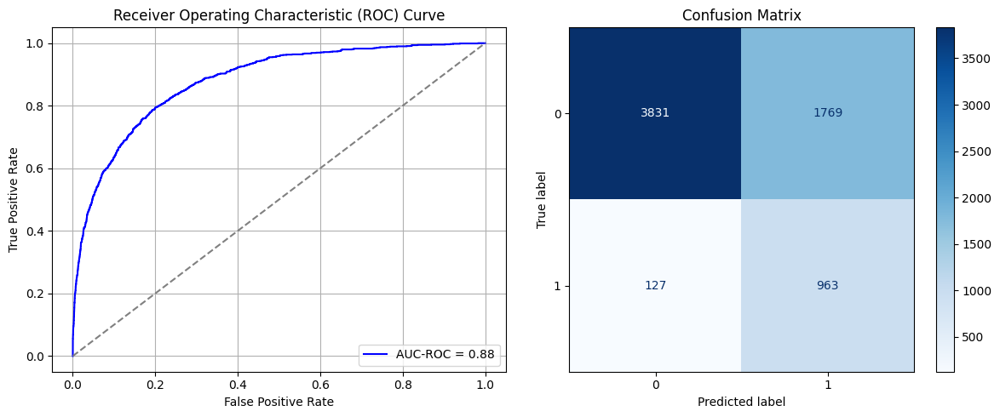

Best threshold based on F1-score: 0.8107741475105286
False Negative Rate: 0.11651376146788991
Time elapsed (performance): 1.0614927860005992
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5858 - loss: 0.6835 - val_AUC: 0.7251 - val_loss: 0.6242
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7326 - loss: 0.6127 - val_AUC: 0.7942 - val_loss: 0.5586
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8036 - loss: 0.5490 - val_AUC: 0.8451 - val_loss: 0.5040
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8385 - loss: 0.5058 - val_AUC: 0.8677 - val_loss: 0.4837
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8639 - loss: 0.4666 - val_AUC: 0.8851 - val_loss: 0.4391
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8818 - loss: 0.4370 - val_AUC: 0.9001 - val_loss: 0.4127
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8979 - loss: 0.4097 - val_AUC: 0.9072 - val_loss: 0.4198
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9127 - loss: 0.3818 - val_AUC: 0.9178 - val_loss: 0.3806
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9068 -

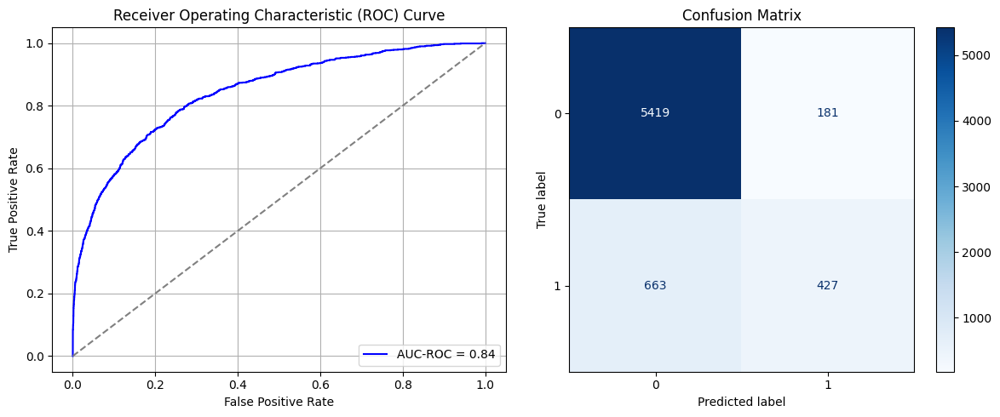

Best threshold based on F1-score: 0.31339696049690247
False Negative Rate: 0.6082568807339449
Time elapsed (performance): 1.0323377220011025
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6188 - loss: 0.6721 - val_AUC: 0.7453 - val_loss: 0.6088
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7546 - loss: 0.5947 - val_AUC: 0.8065 - val_loss: 0.5503
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8131 - loss: 0.5396 - val_AUC: 0.8401 - val_loss: 0.5030
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8414 - loss: 0.4971 - val_AUC: 0.8678 - val_loss: 0.4771
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8574 - loss: 0.4762 - val_AUC: 0.8805 - val_loss: 0.4532
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8800 - loss: 0.4415 - val_AUC: 0.8890 - val_loss: 0.4300
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8857 - loss: 0.4293 - val_AUC: 0.9010 - val_loss: 0.4134
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8910 - loss: 0.4169 - val_AUC: 0.9146 - val_loss: 0.3875
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9116 -

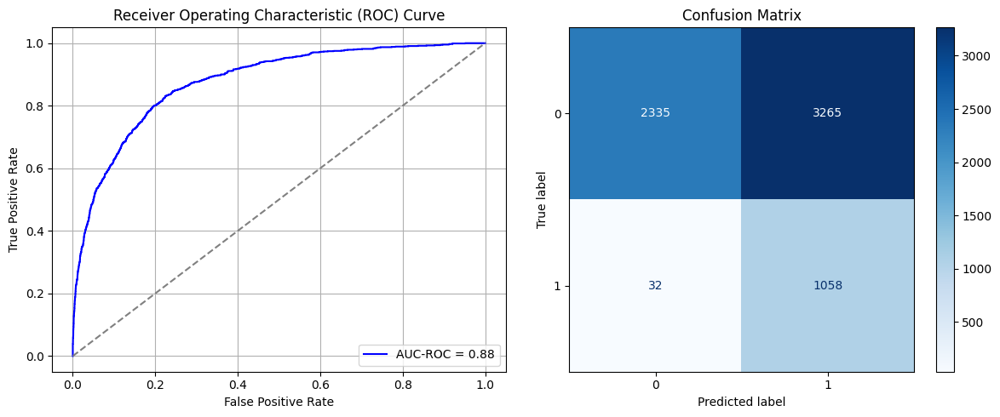

Best threshold based on F1-score: 0.8804135918617249
False Negative Rate: 0.029357798165137616
Time elapsed (performance): 1.0533131049996882
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6060 - loss: 0.6798 - val_AUC: 0.7528 - val_loss: 0.6115
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7769 - loss: 0.5811 - val_AUC: 0.8352 - val_loss: 0.5306
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8283 - loss: 0.5196 - val_AUC: 0.8672 - val_loss: 0.4693
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8542 - loss: 0.4805 - val_AUC: 0.8844 - val_loss: 0.4396
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8688 - loss: 0.4540 - val_AUC: 0.8888 - val_loss: 0.4430
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4401 - val_AUC: 0.9011 - val_loss: 0.4277
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9018 - loss: 0.4028 - val_AUC: 0.9066 - val_loss: 0.3954
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9027 - loss: 0.3976 - val_AUC: 0.9101 - val_loss: 0.3925
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9142 -

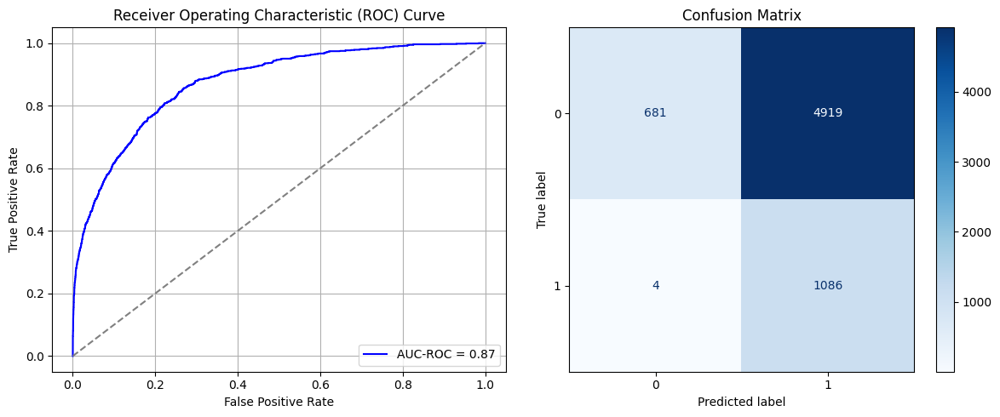

Best threshold based on F1-score: 0.9613299369812012
False Negative Rate: 0.003669724770642202
Time elapsed (performance): 0.8759948949991667
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5532 - loss: 0.6951 - val_AUC: 0.7251 - val_loss: 0.6232
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7468 - loss: 0.6023 - val_AUC: 0.8146 - val_loss: 0.5548
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8139 - loss: 0.5467 - val_AUC: 0.8548 - val_loss: 0.5390
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8516 - loss: 0.4917 - val_AUC: 0.8786 - val_loss: 0.4563
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8729 - loss: 0.4545 - val_AUC: 0.8920 - val_loss: 0.4445
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8948 - loss: 0.4191 - val_AUC: 0.8996 - val_loss: 0.4103
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8931 - loss: 0.4179 - val_AUC: 0.9068 - val_loss: 0.4239
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9050 - loss: 0.3924 - val_AUC: 0.9151 - val_loss: 0.3754
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9252 -

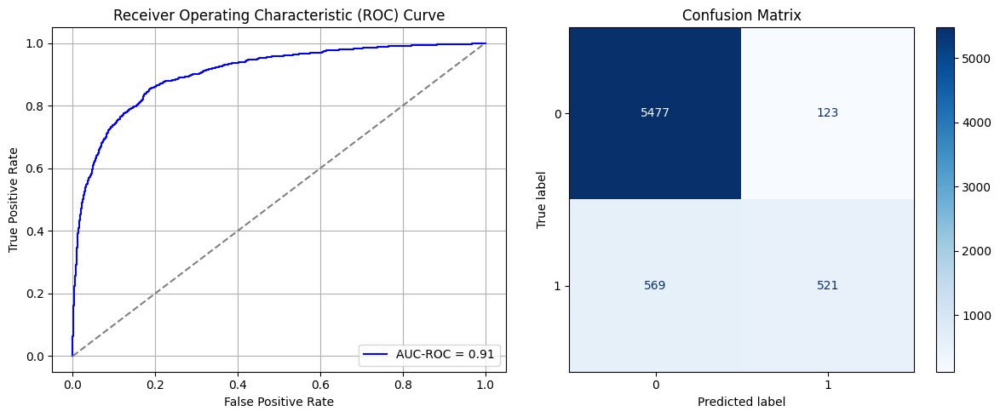

Best threshold based on F1-score: 0.2933734655380249
False Negative Rate: 0.5220183486238532
Time elapsed (performance): 1.039171919997898
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6159 - loss: 0.6754 - val_AUC: 0.7626 - val_loss: 0.6100
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7486 - loss: 0.6020 - val_AUC: 0.8213 - val_loss: 0.5777
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8037 - loss: 0.5490 - val_AUC: 0.8599 - val_loss: 0.4899
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8540 - loss: 0.4897 - val_AUC: 0.8800 - val_loss: 0.4518
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8749 - loss: 0.4529 - val_AUC: 0.8886 - val_loss: 0.4353
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8891 - loss: 0.4240 - val_AUC: 0.9026 - val_loss: 0.4048
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8993 - loss: 0.4075 - val_AUC: 0.9112 - val_loss: 0.3872
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9094 - loss: 0.3869 - val_AUC: 0.9171 - val_loss: 0.3718
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9127 -

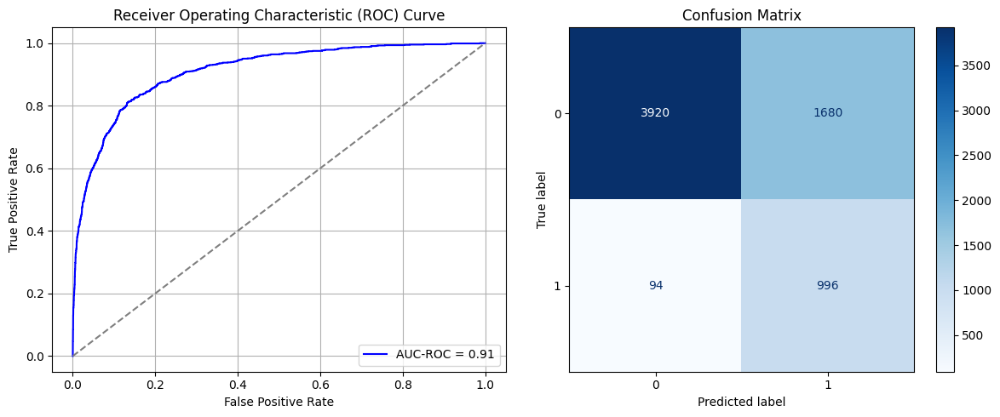

Best threshold based on F1-score: 0.7948842644691467
False Negative Rate: 0.08623853211009175
Time elapsed (performance): 0.8660679959975823
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6598 - loss: 0.6670 - val_AUC: 0.7373 - val_loss: 0.6266
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7704 - loss: 0.5863 - val_AUC: 0.8279 - val_loss: 0.5390
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8155 - loss: 0.5343 - val_AUC: 0.8617 - val_loss: 0.4829
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8661 - loss: 0.4674 - val_AUC: 0.8916 - val_loss: 0.4419
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8894 - loss: 0.4284 - val_AUC: 0.9061 - val_loss: 0.4049
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8986 - loss: 0.4080 - val_AUC: 0.9190 - val_loss: 0.3786
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9107 - loss: 0.3837 - val_AUC: 0.9213 - val_loss: 0.3661
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9135 - loss: 0.3775 - val_AUC: 0.9314 - val_loss: 0.3430
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9267 -

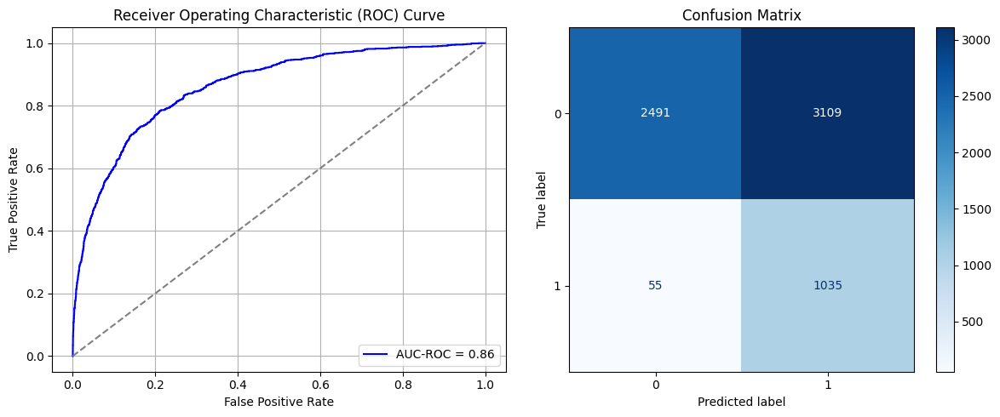

Best threshold based on F1-score: 0.8948161005973816
False Negative Rate: 0.05045871559633028
Time elapsed (performance): 0.8443434690016147
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6568 - loss: 0.6645 - val_AUC: 0.7793 - val_loss: 0.5852
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7745 - loss: 0.5799 - val_AUC: 0.8404 - val_loss: 0.5378
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8429 - loss: 0.5097 - val_AUC: 0.8686 - val_loss: 0.4725
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8658 - loss: 0.4682 - val_AUC: 0.8895 - val_loss: 0.4823
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8724 - loss: 0.4552 - val_AUC: 0.8991 - val_loss: 0.4132
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8972 - loss: 0.4130 - val_AUC: 0.9078 - val_loss: 0.4247
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8977 - loss: 0.4094 - val_AUC: 0.9164 - val_loss: 0.3785
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9150 - loss: 0.3767 - val_AUC: 0.9282 - val_loss: 0.3601
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9271 -

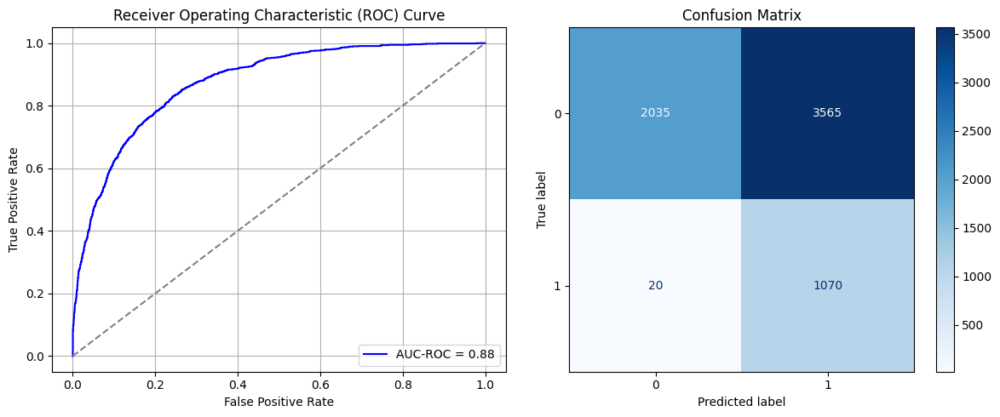

Best threshold based on F1-score: 0.9183685183525085
False Negative Rate: 0.01834862385321101
Time elapsed (performance): 0.883883157002856
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5632 - loss: 0.6886 - val_AUC: 0.7357 - val_loss: 0.6221
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7403 - loss: 0.6069 - val_AUC: 0.8047 - val_loss: 0.5589
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8181 - loss: 0.5367 - val_AUC: 0.8429 - val_loss: 0.5019
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8494 - loss: 0.4898 - val_AUC: 0.8613 - val_loss: 0.4911
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8668 - loss: 0.4643 - val_AUC: 0.8754 - val_loss: 0.4550
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8777 - loss: 0.4456 - val_AUC: 0.8829 - val_loss: 0.4389
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8891 - loss: 0.4267 - val_AUC: 0.8911 - val_loss: 0.4278
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8937 - loss: 0.4169 - val_AUC: 0.9012 - val_loss: 0.4062
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9111 -

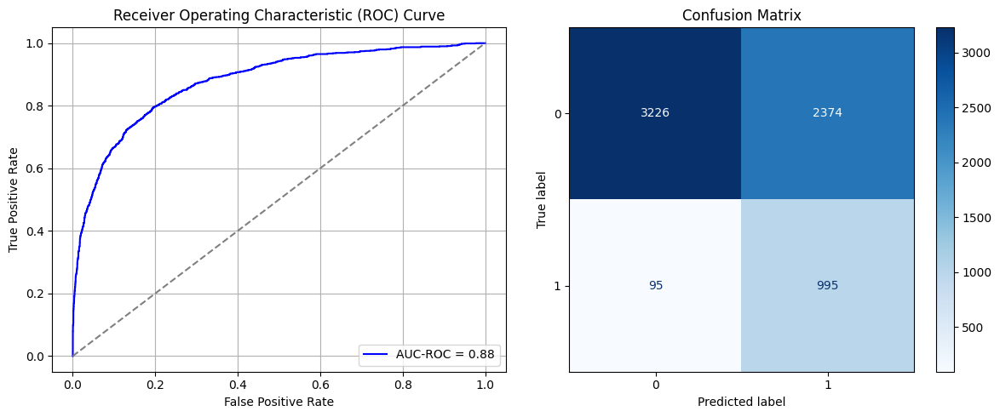

Best threshold based on F1-score: 0.8047930002212524
False Negative Rate: 0.0871559633027523
Time elapsed (performance): 1.0501757739984896
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6409 - loss: 0.6658 - val_AUC: 0.7528 - val_loss: 0.6066
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7756 - loss: 0.5784 - val_AUC: 0.8325 - val_loss: 0.5340
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8306 - loss: 0.5201 - val_AUC: 0.8652 - val_loss: 0.4977
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8782 - loss: 0.4516 - val_AUC: 0.8979 - val_loss: 0.4278
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8951 - loss: 0.4220 - val_AUC: 0.9066 - val_loss: 0.4084
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9026 - loss: 0.4009 - val_AUC: 0.9179 - val_loss: 0.3776
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9215 - loss: 0.3655 - val_AUC: 0.9237 - val_loss: 0.3794
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9308 - loss: 0.3442 - val_AUC: 0.9315 - val_loss: 0.3427
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9358 -

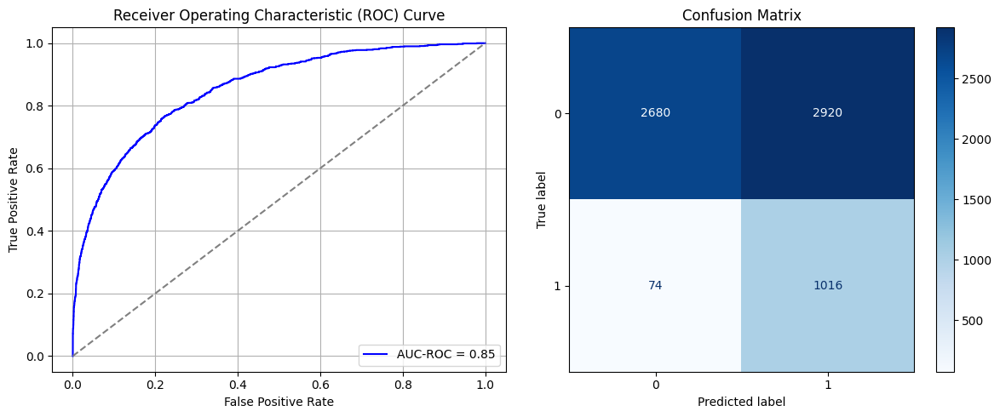

Best threshold based on F1-score: 0.9130756258964539
False Negative Rate: 0.06788990825688074
Time elapsed (performance): 1.0470305390008434
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6287 - loss: 0.6759 - val_AUC: 0.7487 - val_loss: 0.6137
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7537 - loss: 0.6004 - val_AUC: 0.8153 - val_loss: 0.5414
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8223 - loss: 0.5292 - val_AUC: 0.8534 - val_loss: 0.4942
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8527 - loss: 0.4874 - val_AUC: 0.8722 - val_loss: 0.4585
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8691 - loss: 0.4592 - val_AUC: 0.8848 - val_loss: 0.4420
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8772 - loss: 0.4434 - val_AUC: 0.8902 - val_loss: 0.4338
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8895 - loss: 0.4230 - val_AUC: 0.9048 - val_loss: 0.4016
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9021 - loss: 0.3999 - val_AUC: 0.9122 - val_loss: 0.3891
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9169 -

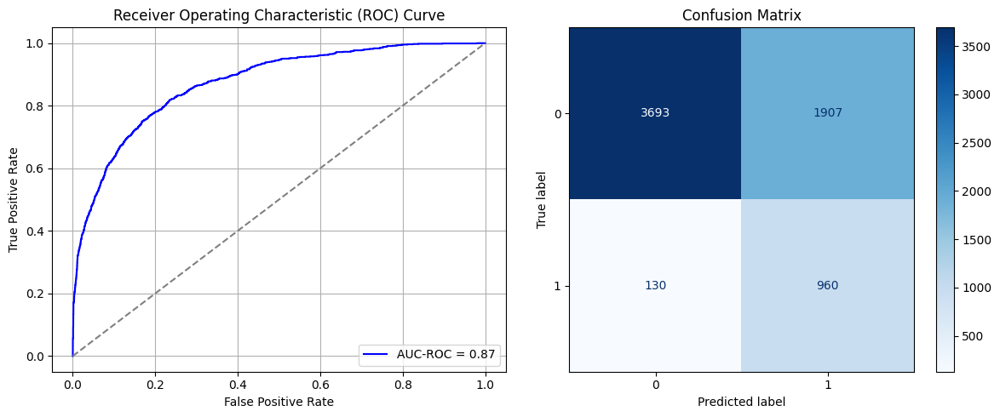

Best threshold based on F1-score: 0.8205983638763428
False Negative Rate: 0.11926605504587157
Time elapsed (performance): 1.0462017479985661
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6176 - loss: 0.6740 - val_AUC: 0.7557 - val_loss: 0.6090
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7465 - loss: 0.6056 - val_AUC: 0.8263 - val_loss: 0.5640
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8033 - loss: 0.5474 - val_AUC: 0.8658 - val_loss: 0.4783
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8527 - loss: 0.4849 - val_AUC: 0.8917 - val_loss: 0.4598
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8670 - loss: 0.4634 - val_AUC: 0.9049 - val_loss: 0.4078
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8888 - loss: 0.4258 - val_AUC: 0.9152 - val_loss: 0.3930
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9019 - loss: 0.4039 - val_AUC: 0.9208 - val_loss: 0.3758
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9067 - loss: 0.3930 - val_AUC: 0.9252 - val_loss: 0.3585
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9155 -

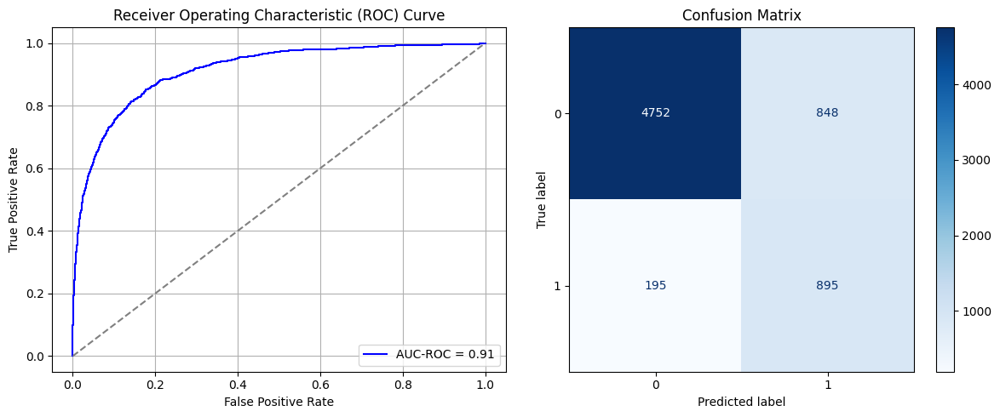

Best threshold based on F1-score: 0.6504105925559998
False Negative Rate: 0.17889908256880735
Time elapsed (performance): 1.0333127129997592
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5830 - loss: 0.6809 - val_AUC: 0.7447 - val_loss: 0.6206
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7324 - loss: 0.6115 - val_AUC: 0.8284 - val_loss: 0.5396
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8148 - loss: 0.5388 - val_AUC: 0.8733 - val_loss: 0.4855
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8680 - loss: 0.4710 - val_AUC: 0.8908 - val_loss: 0.4387
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8826 - loss: 0.4392 - val_AUC: 0.9007 - val_loss: 0.4511
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8891 - loss: 0.4262 - val_AUC: 0.9130 - val_loss: 0.3892
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8981 - loss: 0.4081 - val_AUC: 0.9210 - val_loss: 0.3705
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9112 - loss: 0.3834 - val_AUC: 0.9310 - val_loss: 0.3489
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9237 -

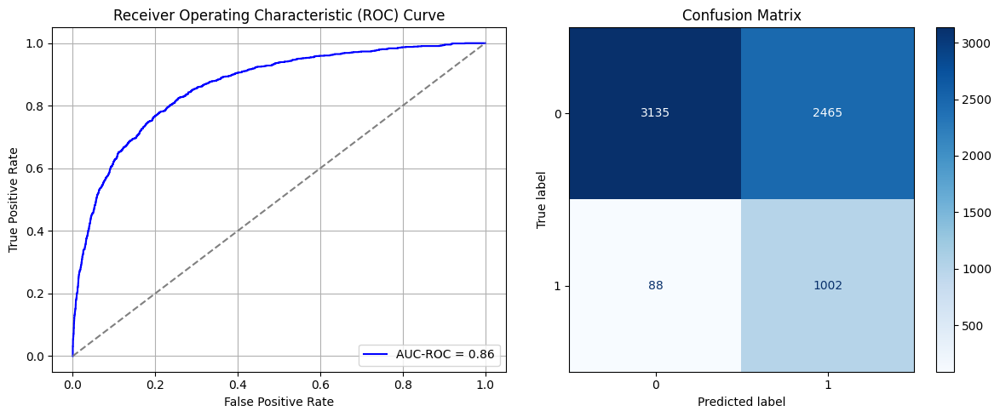

Best threshold based on F1-score: 0.8574572205543518
False Negative Rate: 0.08073394495412844
Time elapsed (performance): 1.0371550599993498
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5922 - loss: 0.6789 - val_AUC: 0.7219 - val_loss: 0.6301
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7277 - loss: 0.6171 - val_AUC: 0.7769 - val_loss: 0.5818
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7832 - loss: 0.5684 - val_AUC: 0.8260 - val_loss: 0.5357
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8319 - loss: 0.5147 - val_AUC: 0.8606 - val_loss: 0.5119
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8593 - loss: 0.4772 - val_AUC: 0.8721 - val_loss: 0.4716
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8771 - loss: 0.4447 - val_AUC: 0.8879 - val_loss: 0.4342
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8869 - loss: 0.4278 - val_AUC: 0.8904 - val_loss: 0.4665
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8886 - loss: 0.4256 - val_AUC: 0.9042 - val_loss: 0.4044
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9157 -

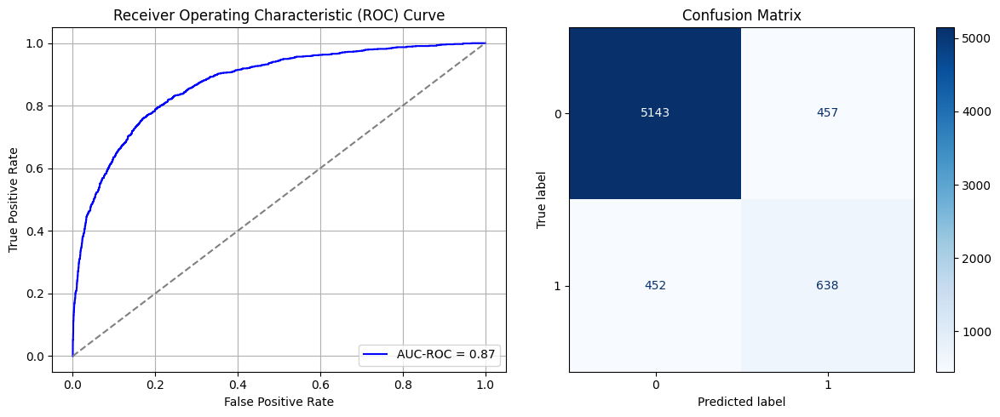

Best threshold based on F1-score: 0.45926594734191895
False Negative Rate: 0.41467889908256883
Time elapsed (performance): 0.9209084649992292
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5886 - loss: 0.6854 - val_AUC: 0.7350 - val_loss: 0.6276
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7496 - loss: 0.6081 - val_AUC: 0.8154 - val_loss: 0.5512
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8114 - loss: 0.5431 - val_AUC: 0.8577 - val_loss: 0.4934
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8344 - loss: 0.5086 - val_AUC: 0.8792 - val_loss: 0.4569
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8618 - loss: 0.4701 - val_AUC: 0.8955 - val_loss: 0.4344
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8999 - loss: 0.4151 - val_AUC: 0.9014 - val_loss: 0.4068
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8904 - loss: 0.4212 - val_AUC: 0.9138 - val_loss: 0.4271
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9058 - loss: 0.3952 - val_AUC: 0.9185 - val_loss: 0.3729
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9143 -

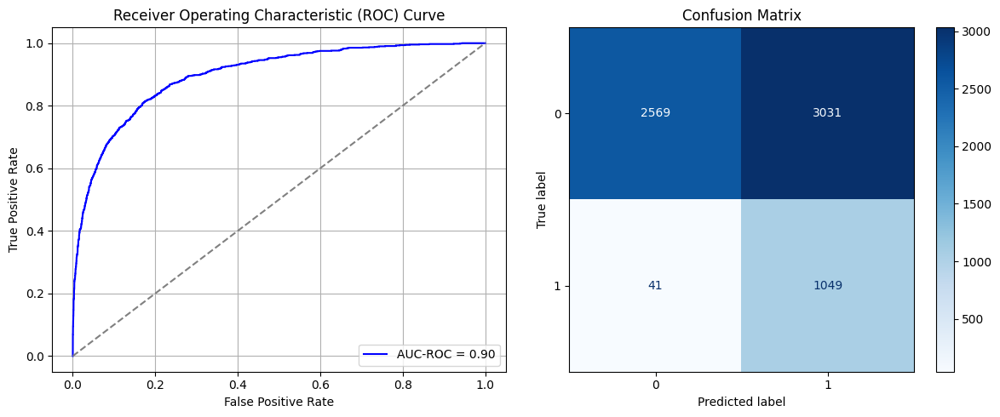

Best threshold based on F1-score: 0.8964933753013611
False Negative Rate: 0.03761467889908257
Time elapsed (performance): 0.8952860169993073
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6184 - loss: 0.6739 - val_AUC: 0.7220 - val_loss: 0.6259
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7454 - loss: 0.6043 - val_AUC: 0.8041 - val_loss: 0.5555
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8029 - loss: 0.5487 - val_AUC: 0.8471 - val_loss: 0.5243
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8467 - loss: 0.4931 - val_AUC: 0.8756 - val_loss: 0.4584
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8694 - loss: 0.4601 - val_AUC: 0.8920 - val_loss: 0.4448
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8886 - loss: 0.4252 - val_AUC: 0.9034 - val_loss: 0.4449
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8952 - loss: 0.4147 - val_AUC: 0.9128 - val_loss: 0.3840
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9264 - loss: 0.3590 - val_AUC: 0.9213 - val_loss: 0.3652
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9221 -

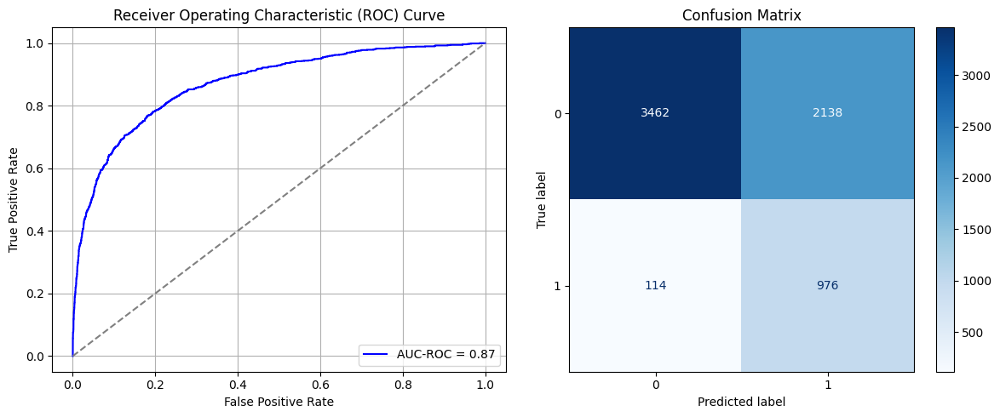

Best threshold based on F1-score: 0.8423799872398376
False Negative Rate: 0.10458715596330276
Time elapsed (performance): 0.9013435640008538


In [46]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=True)
    data_S_SRSwR_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRSwR = data_S_SRSwR_RUS.iloc[:, :-1]
    y_S_SRSwR = data_S_SRSwR_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRSwR, y_S_SRSwR, test_size=0.20, random_state=0)
    model_SRSwR = create_dnn_model(X_S_train.shape[1])
    result_SRSwR = train_and_evaluate(model_SRSwR, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRSwR = Transductive_TL(model_SRSwR, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRSwR)
    FPR.append(result_TL_SRSwR[0])
    TNR.append(result_TL_SRSwR[1])
    FNR.append(result_TL_SRSwR[2])
    TPR.append(result_TL_SRSwR[3])
    TL_time.append(result_TL_SRSwR[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [50]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.19253211009174312
Variance: 0.030554564396249203


In [51]:
print(ParamFit)
ParamFit.to_csv('SRSwR_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      9.707781  0.418214  0.581786  0.095413  0.904587     0.756751
1      7.534321  0.215893  0.784107  0.192661  0.807339     1.161188
2      8.700541  0.496071  0.503929  0.050459  0.949541     0.731158
3      9.008823  0.874821  0.125179  0.002752  0.997248     2.892003
4      8.823541  0.602857  0.397143  0.022018  0.977982     0.794738
5      9.564994  0.127500  0.872500  0.369725  0.630275     0.779965
6      8.085548  0.470893  0.529107  0.057798  0.942202     1.301198
7      8.418153  0.326071  0.673929  0.078899  0.921101     0.781439
8      8.833974  0.672857  0.327143  0.014679  0.985321     0.780797
9      9.941881  0.150536  0.849464  0.333945  0.666055     1.054239
10     9.375465  0.533571  0.466429  0.051376  0.948624     0.783206
11     7.562912  0.195536  0.804464  0.337615  0.662385     1.212286
12     8.348264  0.724107  0.275893  0.008257  0.991743     0.763451
13     9.273102  0.109286  0.89071

## Systematic Sampling:

First, we select a single systematic sample from the majority class, in which $k = \frac{N_0}{N_1}$, where $N_0$ is the majority class size in the source domain and $N_1$ is the minority class in the source domain.

4.961636828644501
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.6516 - loss: 0.6638 - val_AUC: 0.7818 - val_loss: 0.5849
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7855 - loss: 0.5694 - val_AUC: 0.8481 - val_loss: 0.5080
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8395 - loss: 0.5051 - val_AUC: 0.8760 - val_loss: 0.4703
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8681 - loss: 0.4589 - val_AUC: 0.8916 - val_loss: 0.4375
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8873 - loss: 0.4281 - val_AUC: 0.9020 - val_loss: 0.4179
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8963 - loss: 0.4087 - val_AUC: 0.9041 - val_loss: 0.4757
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9045 - loss: 0.3976 - val_AUC: 0.9184 - val_loss: 0.3857
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9099 - loss: 0.3823 - val_AUC: 0.9223 - val_loss: 0.3627
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9244 -

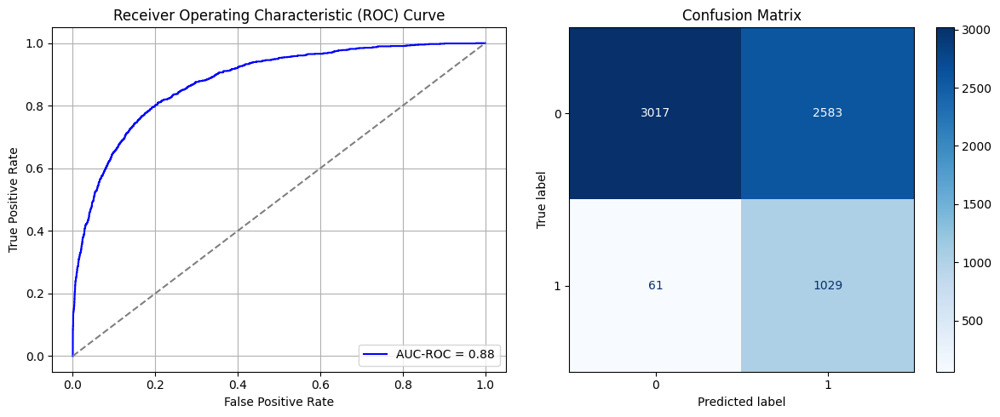

Best threshold based on F1-score: 0.8596968054771423
False Negative Rate: 0.05596330275229358
Time elapsed (performance): 0.722358560997236
(np.float64(0.46125), np.float64(0.5387500000000001))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6206 - loss: 0.6726 - val_AUC: 0.7636 - val_loss: 0.6032
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7727 - loss: 0.5828 - val_AUC: 0.8347 - val_loss: 0.5351
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8294 - loss: 0.5201 - val_AUC: 0.8702 - val_loss: 0.4874
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8570 - loss: 0.4780 - val_AUC: 0.8843 - val_loss: 0.4563
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8751 - loss: 0.4469 - val_AUC: 0.8969 - val_loss: 0.4386
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8858 - loss: 0.4276 - val_AUC: 0.9064 - val_loss: 0.4036
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9014 - loss: 0.4020 - val_AUC: 0.9127 - val_loss: 0.4414
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9101 - loss: 0.3864 - val_AUC: 0.9152 - val_loss: 0.3739
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9184 -

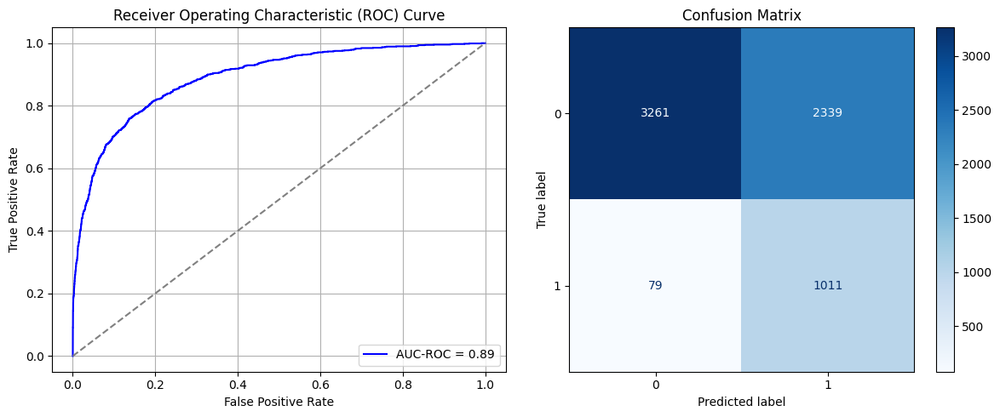

Best threshold based on F1-score: 0.8591480255126953
False Negative Rate: 0.07247706422018349
Time elapsed (performance): 0.744805513000756
(np.float64(0.41767857142857145), np.float64(0.5823214285714285))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6217 - loss: 0.6721 - val_AUC: 0.7324 - val_loss: 0.6251
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7321 - loss: 0.6130 - val_AUC: 0.8052 - val_loss: 0.5536
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7853 - loss: 0.5647 - val_AUC: 0.8493 - val_loss: 0.5045
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8231 - loss: 0.5222 - val_AUC: 0.8704 - val_loss: 0.4741
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8555 - loss: 0.4799 - val_AUC: 0.8810 - val_loss: 0.4626
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4541 - val_AUC: 0.8903 - val_loss: 0.4623
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8887 - loss: 0.4229 - val_AUC: 0.8956 - val_loss: 0.4729
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8965 - loss: 0.4091 - val_AUC: 0.9087 - val_loss: 0.3977
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8989 -

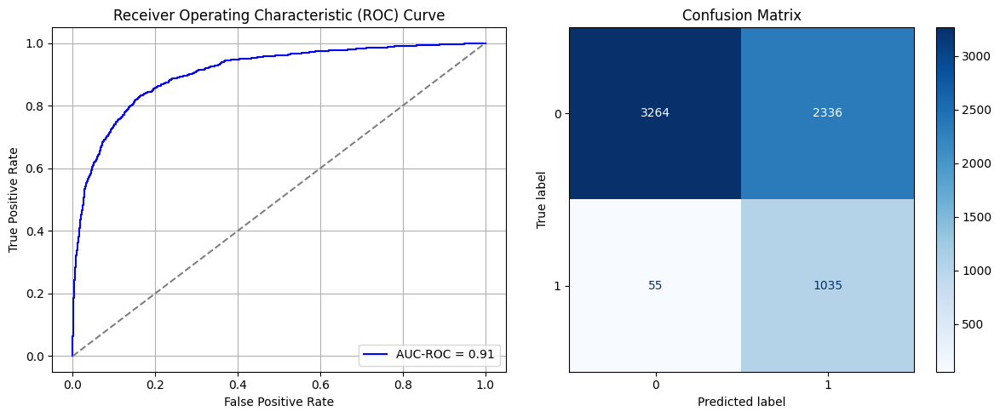

Best threshold based on F1-score: 0.8648459911346436
False Negative Rate: 0.05045871559633028
Time elapsed (performance): 0.807105768002657
(np.float64(0.41714285714285715), np.float64(0.5828571428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6566 - loss: 0.6625 - val_AUC: 0.7600 - val_loss: 0.5978
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7915 - loss: 0.5688 - val_AUC: 0.8267 - val_loss: 0.5332
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8242 - loss: 0.5276 - val_AUC: 0.8533 - val_loss: 0.4926
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8607 - loss: 0.4759 - val_AUC: 0.8668 - val_loss: 0.4674
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8628 - loss: 0.4664 - val_AUC: 0.8684 - val_loss: 0.5299
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8639 - loss: 0.4619 - val_AUC: 0.8882 - val_loss: 0.4375
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4430 - val_AUC: 0.8944 - val_loss: 0.4211
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8889 - loss: 0.4210 - val_AUC: 0.8999 - val_loss: 0.4073
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8983 -

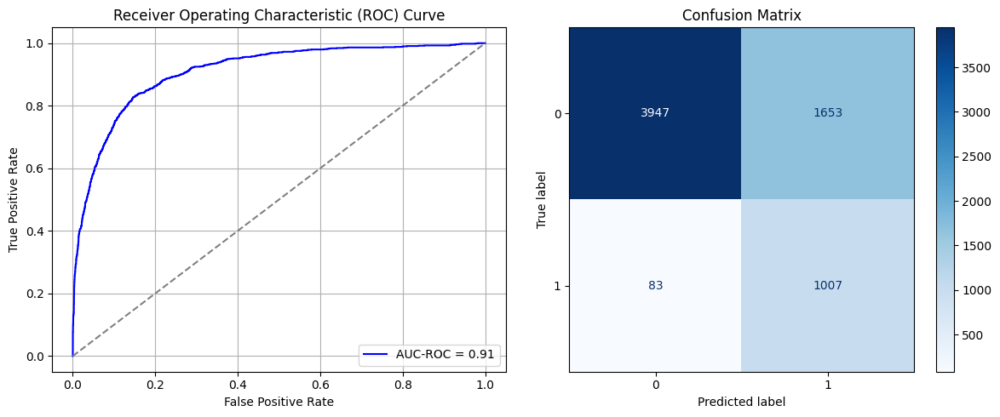

Best threshold based on F1-score: 0.735955536365509
False Negative Rate: 0.07614678899082569
Time elapsed (performance): 1.2197867740032962
(np.float64(0.2951785714285714), np.float64(0.7048214285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5965 - loss: 0.6745 - val_AUC: 0.7589 - val_loss: 0.5977
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7824 - loss: 0.5766 - val_AUC: 0.8589 - val_loss: 0.5229
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8357 - loss: 0.5111 - val_AUC: 0.8814 - val_loss: 0.4563
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4578 - val_AUC: 0.8964 - val_loss: 0.4456
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8895 - loss: 0.4281 - val_AUC: 0.9055 - val_loss: 0.3979
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8967 - loss: 0.4092 - val_AUC: 0.9148 - val_loss: 0.3968
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8977 - loss: 0.4047 - val_AUC: 0.9258 - val_loss: 0.3565
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9286 - loss: 0.3480 - val_AUC: 0.9305 - val_loss: 0.3420
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9289 -

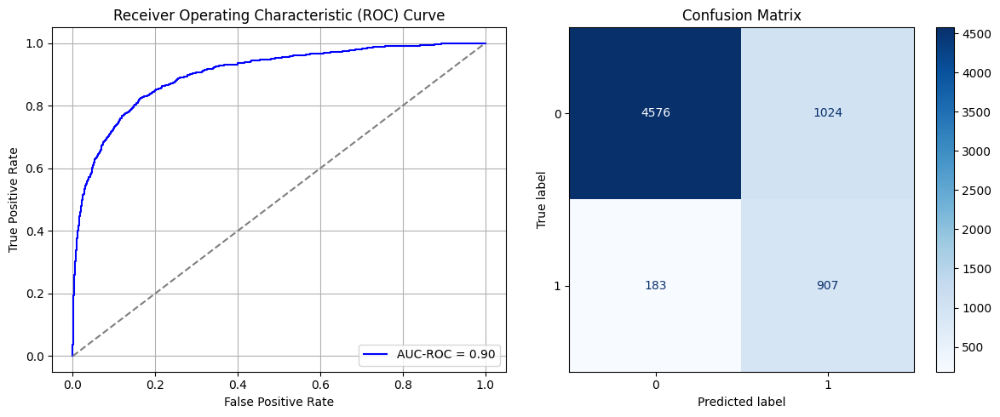

Best threshold based on F1-score: 0.6856521368026733
False Negative Rate: 0.16788990825688074
Time elapsed (performance): 0.8052975239988882
(np.float64(0.18285714285714286), np.float64(0.8171428571428572))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5629 - loss: 0.6855 - val_AUC: 0.7421 - val_loss: 0.6250
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7514 - loss: 0.6054 - val_AUC: 0.8203 - val_loss: 0.5478
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8125 - loss: 0.5401 - val_AUC: 0.8581 - val_loss: 0.5329
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8265 - loss: 0.5147 - val_AUC: 0.8752 - val_loss: 0.4567
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8657 - loss: 0.4625 - val_AUC: 0.8860 - val_loss: 0.4408
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4420 - val_AUC: 0.8966 - val_loss: 0.4324
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8932 - loss: 0.4175 - val_AUC: 0.9046 - val_loss: 0.4087
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8982 - loss: 0.4064 - val_AUC: 0.9128 - val_loss: 0.3904
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9076 -

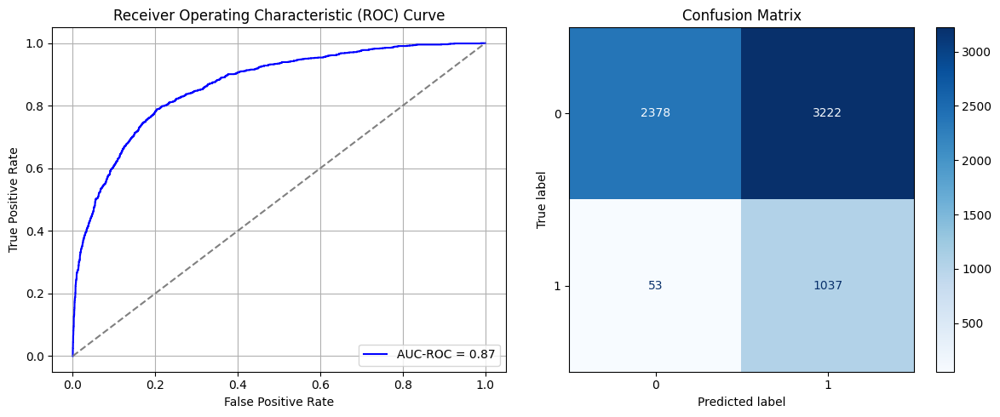

Best threshold based on F1-score: 0.8824199438095093
False Negative Rate: 0.04862385321100918
Time elapsed (performance): 0.7718604219990084
(np.float64(0.5753571428571429), np.float64(0.4246428571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6257 - loss: 0.6677 - val_AUC: 0.7765 - val_loss: 0.5971
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7870 - loss: 0.5760 - val_AUC: 0.8310 - val_loss: 0.5245
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8451 - loss: 0.5056 - val_AUC: 0.8709 - val_loss: 0.4717
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4537 - val_AUC: 0.8826 - val_loss: 0.4404
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8817 - loss: 0.4380 - val_AUC: 0.8906 - val_loss: 0.4304
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8949 - loss: 0.4134 - val_AUC: 0.9064 - val_loss: 0.4432
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9034 - loss: 0.3993 - val_AUC: 0.9209 - val_loss: 0.3860
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9136 - loss: 0.3768 - val_AUC: 0.9265 - val_loss: 0.3627
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9298 -

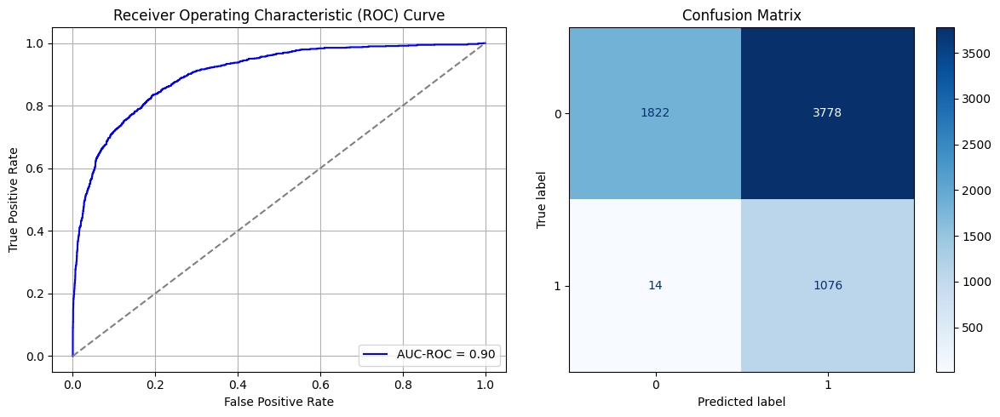

Best threshold based on F1-score: 0.9539419412612915
False Negative Rate: 0.012844036697247707
Time elapsed (performance): 0.7645976530002372
(np.float64(0.6746428571428571), np.float64(0.3253571428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5819 - loss: 0.6855 - val_AUC: 0.7274 - val_loss: 0.6274
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7293 - loss: 0.6171 - val_AUC: 0.8126 - val_loss: 0.5593
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7982 - loss: 0.5589 - val_AUC: 0.8664 - val_loss: 0.4918
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8428 - loss: 0.5015 - val_AUC: 0.8883 - val_loss: 0.4574
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8643 - loss: 0.4690 - val_AUC: 0.9028 - val_loss: 0.4206
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 - loss: 0.4432 - val_AUC: 0.9059 - val_loss: 0.4073
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8911 - loss: 0.4206 - val_AUC: 0.9186 - val_loss: 0.3798
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9016 - loss: 0.4007 - val_AUC: 0.9262 - val_loss: 0.3913
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9061 -

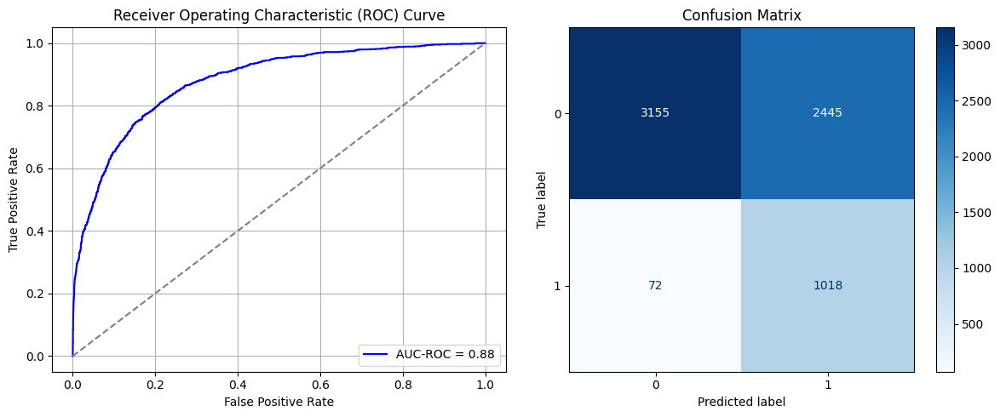

Best threshold based on F1-score: 0.8517380952835083
False Negative Rate: 0.06605504587155964
Time elapsed (performance): 0.7995540550000442
(np.float64(0.43660714285714286), np.float64(0.5633928571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6502 - loss: 0.6655 - val_AUC: 0.7479 - val_loss: 0.6081
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7646 - loss: 0.5920 - val_AUC: 0.8210 - val_loss: 0.5495
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8334 - loss: 0.5199 - val_AUC: 0.8647 - val_loss: 0.4855
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8715 - loss: 0.4638 - val_AUC: 0.8761 - val_loss: 0.4708
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4420 - val_AUC: 0.8949 - val_loss: 0.4233
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8949 - loss: 0.4140 - val_AUC: 0.9086 - val_loss: 0.4196
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9060 - loss: 0.3963 - val_AUC: 0.9102 - val_loss: 0.4224
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9146 - loss: 0.3772 - val_AUC: 0.9173 - val_loss: 0.3806
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9190 -

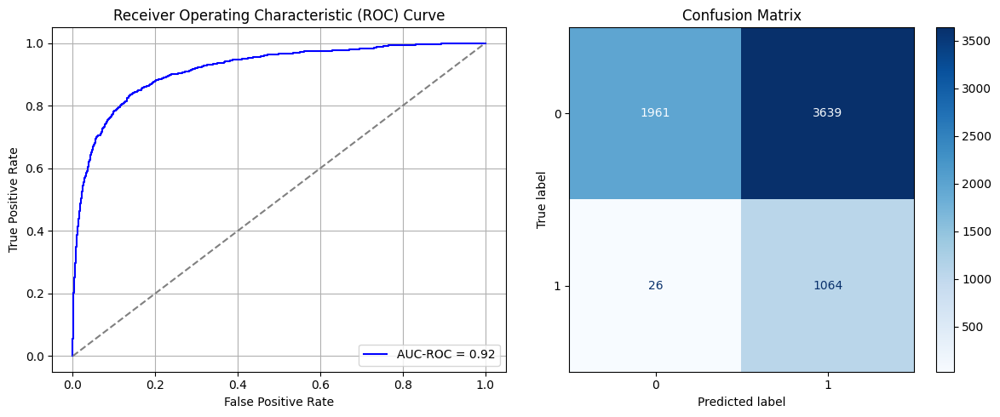

Best threshold based on F1-score: 0.9282817840576172
False Negative Rate: 0.023853211009174313
Time elapsed (performance): 1.2215262639983848
(np.float64(0.6498214285714285), np.float64(0.35017857142857145))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.5935 - loss: 0.6801 - val_AUC: 0.7331 - val_loss: 0.6135
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7672 - loss: 0.5854 - val_AUC: 0.7994 - val_loss: 0.5655
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8134 - loss: 0.5376 - val_AUC: 0.8504 - val_loss: 0.5018
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8480 - loss: 0.4910 - val_AUC: 0.8738 - val_loss: 0.4585
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4457 - val_AUC: 0.8899 - val_loss: 0.4409
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8883 - loss: 0.4276 - val_AUC: 0.9031 - val_loss: 0.4048
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9018 - loss: 0.4002 - val_AUC: 0.9199 - val_loss: 0.4246
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9127 - loss: 0.3800 - val_AUC: 0.9258 - val_loss: 0.3617
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9284 -

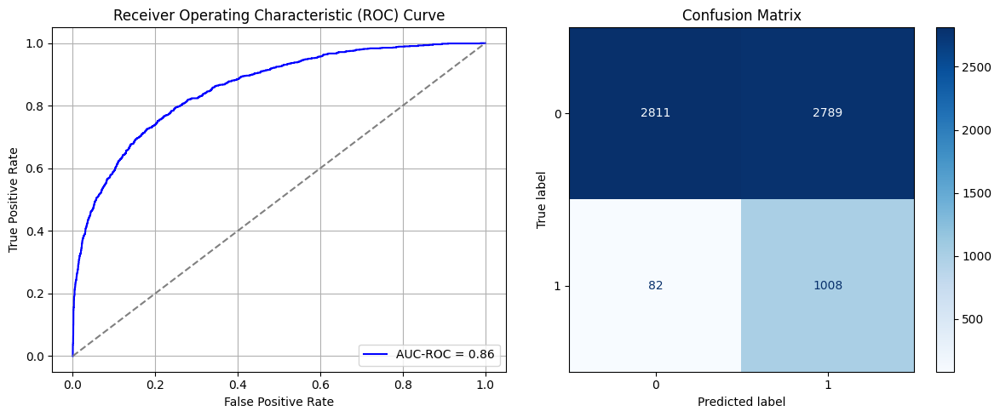

Best threshold based on F1-score: 0.8773199319839478
False Negative Rate: 0.07522935779816514
Time elapsed (performance): 0.7713039070004015
(np.float64(0.4980357142857143), np.float64(0.5019642857142856))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6244 - loss: 0.6675 - val_AUC: 0.7640 - val_loss: 0.5978
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7733 - loss: 0.5873 - val_AUC: 0.8335 - val_loss: 0.5509
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8182 - loss: 0.5367 - val_AUC: 0.8616 - val_loss: 0.4798
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8567 - loss: 0.4797 - val_AUC: 0.8843 - val_loss: 0.4454
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 - loss: 0.4404 - val_AUC: 0.9004 - val_loss: 0.4236
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8965 - loss: 0.4171 - val_AUC: 0.9037 - val_loss: 0.4012
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9026 - loss: 0.3975 - val_AUC: 0.9123 - val_loss: 0.3867
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9215 - loss: 0.3620 - val_AUC: 0.9259 - val_loss: 0.3621
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9272 -

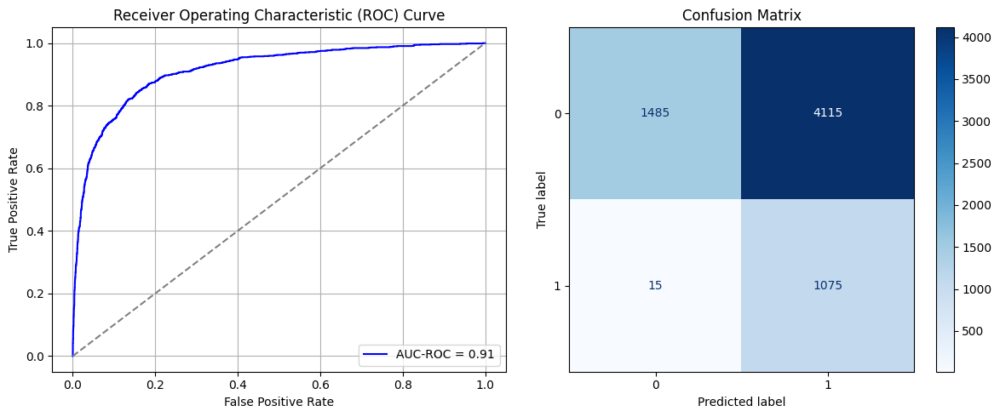

Best threshold based on F1-score: 0.970578670501709
False Negative Rate: 0.013761467889908258
Time elapsed (performance): 0.7672678950002592
(np.float64(0.7348214285714286), np.float64(0.2651785714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6069 - loss: 0.6734 - val_AUC: 0.7436 - val_loss: 0.6095
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7589 - loss: 0.5951 - val_AUC: 0.8295 - val_loss: 0.5401
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8323 - loss: 0.5249 - val_AUC: 0.8717 - val_loss: 0.4801
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8579 - loss: 0.4825 - val_AUC: 0.8892 - val_loss: 0.4449
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8817 - loss: 0.4433 - val_AUC: 0.8979 - val_loss: 0.4245
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8950 - loss: 0.4168 - val_AUC: 0.9088 - val_loss: 0.4002
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8972 - loss: 0.4075 - val_AUC: 0.9136 - val_loss: 0.3885
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9036 - loss: 0.3959 - val_AUC: 0.9217 - val_loss: 0.4003
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9169 -

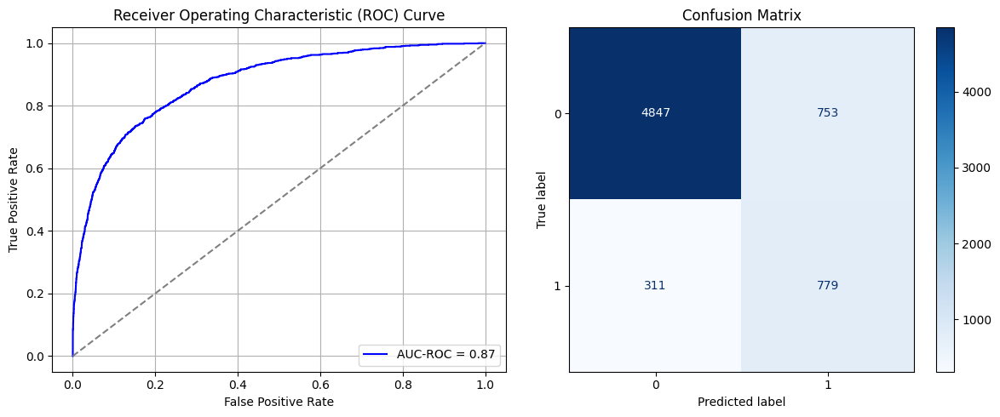

Best threshold based on F1-score: 0.6269477009773254
False Negative Rate: 0.2853211009174312
Time elapsed (performance): 1.0243763720027346
(np.float64(0.1344642857142857), np.float64(0.8655357142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6573 - loss: 0.6636 - val_AUC: 0.7385 - val_loss: 0.6076
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7737 - loss: 0.5853 - val_AUC: 0.8063 - val_loss: 0.5587
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8241 - loss: 0.5264 - val_AUC: 0.8531 - val_loss: 0.4980
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8635 - loss: 0.4755 - val_AUC: 0.8693 - val_loss: 0.4642
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8648 - loss: 0.4613 - val_AUC: 0.8859 - val_loss: 0.4354
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8919 - loss: 0.4207 - val_AUC: 0.8948 - val_loss: 0.4225
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8985 - loss: 0.4075 - val_AUC: 0.9040 - val_loss: 0.4011
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9093 - loss: 0.3859 - val_AUC: 0.9156 - val_loss: 0.3791
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9143 -

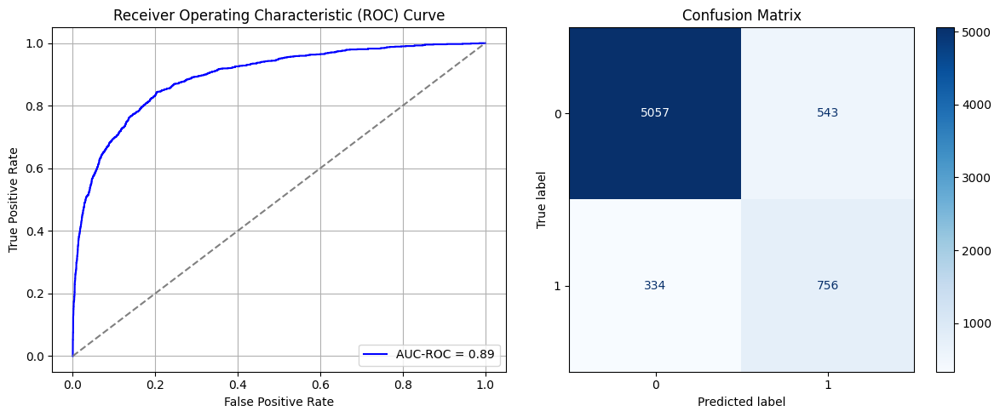

Best threshold based on F1-score: 0.5577902793884277
False Negative Rate: 0.30642201834862387
Time elapsed (performance): 0.7533413320015825
(np.float64(0.09696428571428571), np.float64(0.9030357142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6002 - loss: 0.6734 - val_AUC: 0.7510 - val_loss: 0.6173
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7672 - loss: 0.5909 - val_AUC: 0.8168 - val_loss: 0.5394
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8260 - loss: 0.5260 - val_AUC: 0.8593 - val_loss: 0.4938
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8608 - loss: 0.4814 - val_AUC: 0.8782 - val_loss: 0.4802
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8666 - loss: 0.4614 - val_AUC: 0.8922 - val_loss: 0.4278
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8951 - loss: 0.4177 - val_AUC: 0.9039 - val_loss: 0.4341
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9104 - loss: 0.3893 - val_AUC: 0.9168 - val_loss: 0.3796
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9132 - loss: 0.3780 - val_AUC: 0.9244 - val_loss: 0.3787
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9169 -

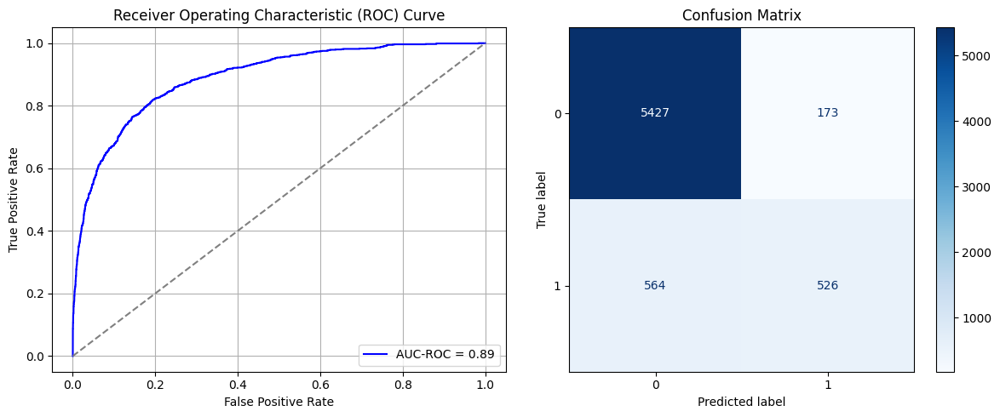

Best threshold based on F1-score: 0.35739701986312866
False Negative Rate: 0.5174311926605505
Time elapsed (performance): 1.1774659269976837
(np.float64(0.030892857142857142), np.float64(0.9691071428571428))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6520 - loss: 0.6621 - val_AUC: 0.7779 - val_loss: 0.5887
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7778 - loss: 0.5810 - val_AUC: 0.8342 - val_loss: 0.5262
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8316 - loss: 0.5189 - val_AUC: 0.8646 - val_loss: 0.4835
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8639 - loss: 0.4736 - val_AUC: 0.8830 - val_loss: 0.4504
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8846 - loss: 0.4372 - val_AUC: 0.8967 - val_loss: 0.4246
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4404 - val_AUC: 0.9037 - val_loss: 0.4176
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9016 - loss: 0.4036 - val_AUC: 0.9147 - val_loss: 0.3871
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9098 - loss: 0.3874 - val_AUC: 0.9164 - val_loss: 0.3749
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9252 -

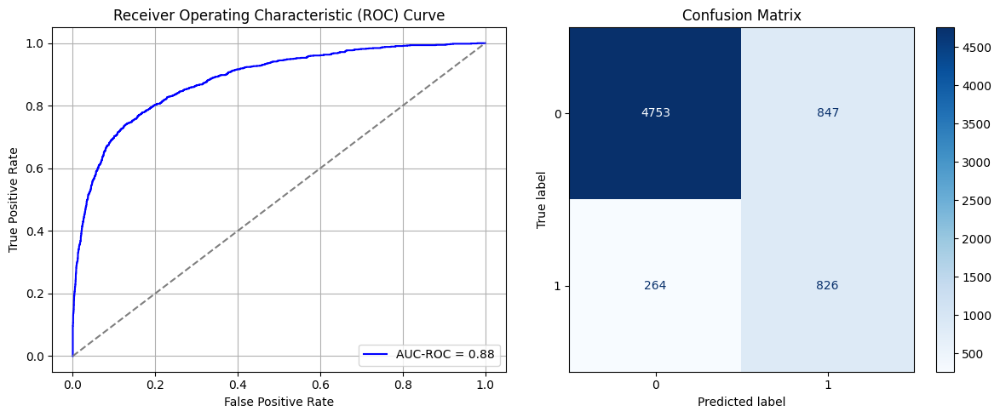

Best threshold based on F1-score: 0.6173167824745178
False Negative Rate: 0.24220183486238533
Time elapsed (performance): 0.8088694680009212
(np.float64(0.15125), np.float64(0.84875))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5730 - loss: 0.6806 - val_AUC: 0.7355 - val_loss: 0.6210
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7239 - loss: 0.6159 - val_AUC: 0.8040 - val_loss: 0.5620
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7967 - loss: 0.5590 - val_AUC: 0.8495 - val_loss: 0.5323
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8192 - loss: 0.5267 - val_AUC: 0.8700 - val_loss: 0.4849
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8516 - loss: 0.4852 - val_AUC: 0.8868 - val_loss: 0.4588
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8490 - loss: 0.4818 - val_AUC: 0.9000 - val_loss: 0.4315
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4345 - val_AUC: 0.9096 - val_loss: 0.4009
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8959 - loss: 0.4127 - val_AUC: 0.9216 - val_loss: 0.3809
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8989 -

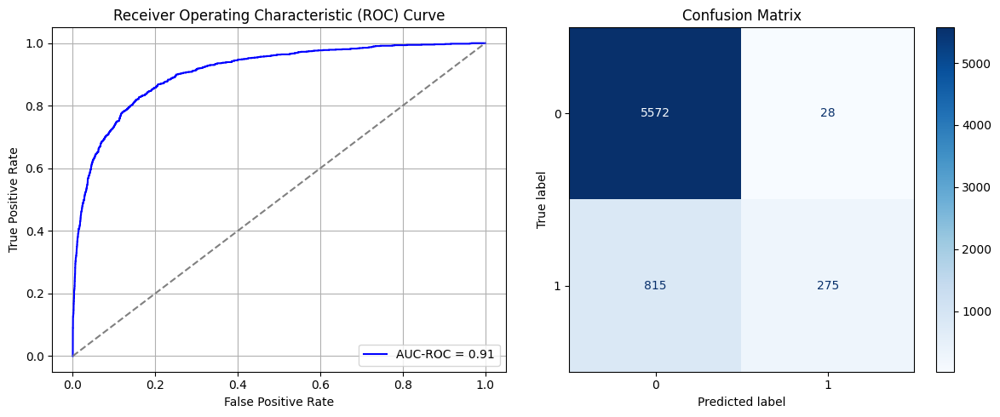

Best threshold based on F1-score: 0.1738678365945816
False Negative Rate: 0.7477064220183486
Time elapsed (performance): 0.7848932380002225
(np.float64(0.005), np.float64(0.995))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6621 - loss: 0.6599 - val_AUC: 0.7926 - val_loss: 0.5783
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7802 - loss: 0.5774 - val_AUC: 0.8458 - val_loss: 0.5015
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8357 - loss: 0.5070 - val_AUC: 0.8708 - val_loss: 0.4892
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8548 - loss: 0.4790 - val_AUC: 0.8835 - val_loss: 0.4411
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8673 - loss: 0.4583 - val_AUC: 0.8911 - val_loss: 0.4401
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8795 - loss: 0.4370 - val_AUC: 0.8981 - val_loss: 0.4128
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8929 - loss: 0.4160 - val_AUC: 0.9051 - val_loss: 0.3957
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8954 - loss: 0.4099 - val_AUC: 0.9123 - val_loss: 0.4437
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9030 -

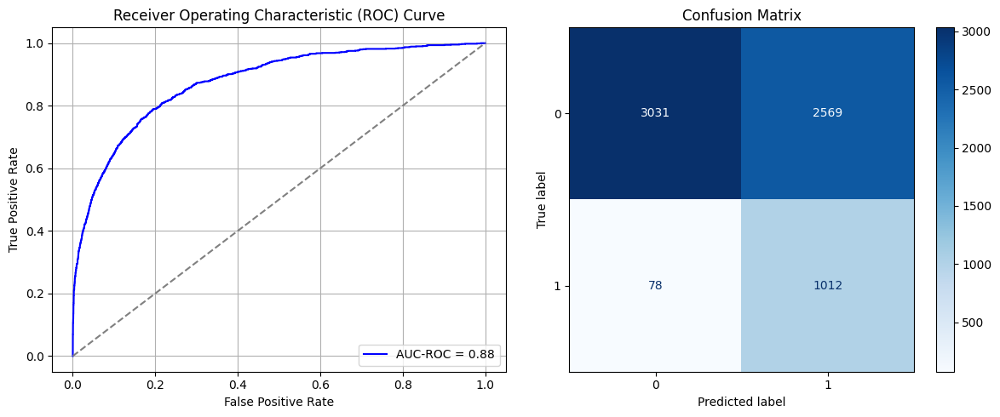

Best threshold based on F1-score: 0.7918685078620911
False Negative Rate: 0.07155963302752294
Time elapsed (performance): 0.7613301880010113
(np.float64(0.45875), np.float64(0.54125))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6395 - loss: 0.6667 - val_AUC: 0.7875 - val_loss: 0.5833
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7795 - loss: 0.5749 - val_AUC: 0.8487 - val_loss: 0.5219
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8348 - loss: 0.5171 - val_AUC: 0.8713 - val_loss: 0.5017
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8564 - loss: 0.4765 - val_AUC: 0.8919 - val_loss: 0.4317
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 - loss: 0.4344 - val_AUC: 0.9015 - val_loss: 0.4105
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8931 - loss: 0.4175 - val_AUC: 0.9091 - val_loss: 0.4121
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9097 - loss: 0.3866 - val_AUC: 0.9157 - val_loss: 0.3758
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9066 - loss: 0.3908 - val_AUC: 0.9234 - val_loss: 0.3712
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9262 -

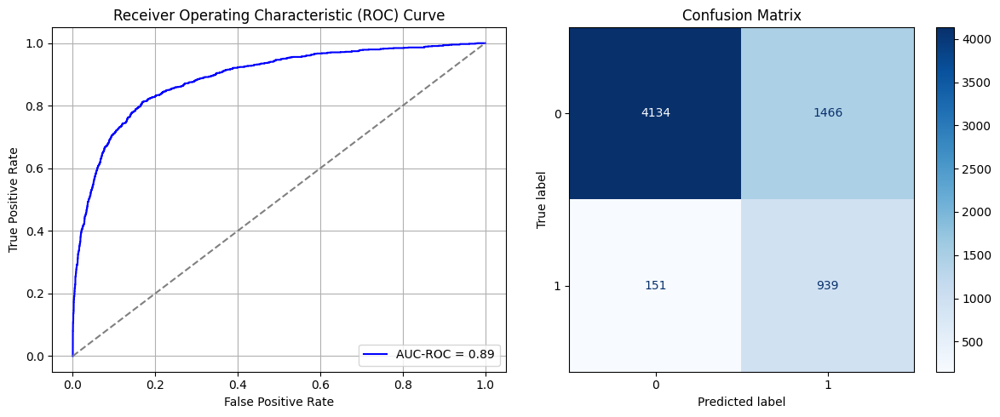

Best threshold based on F1-score: 0.7663308382034302
False Negative Rate: 0.13853211009174313
Time elapsed (performance): 1.1178874899997027
(np.float64(0.2617857142857143), np.float64(0.7382142857142857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6019 - loss: 0.6771 - val_AUC: 0.7395 - val_loss: 0.6242
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7499 - loss: 0.6069 - val_AUC: 0.8103 - val_loss: 0.5582
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7891 - loss: 0.5597 - val_AUC: 0.8542 - val_loss: 0.5019
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8161 - loss: 0.5271 - val_AUC: 0.8740 - val_loss: 0.4664
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8586 - loss: 0.4778 - val_AUC: 0.8923 - val_loss: 0.4376
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4446 - val_AUC: 0.9011 - val_loss: 0.4284
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4420 - val_AUC: 0.9141 - val_loss: 0.3914
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8963 - loss: 0.4108 - val_AUC: 0.9216 - val_loss: 0.3786
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9101 -

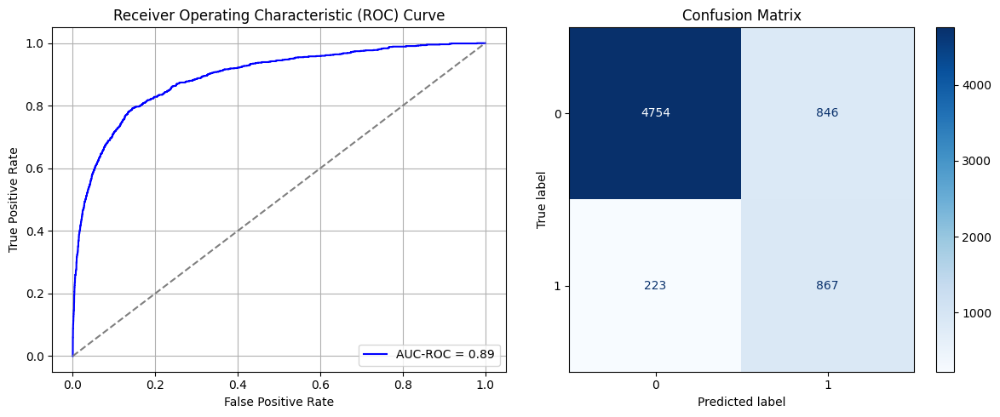

Best threshold based on F1-score: 0.6338374018669128
False Negative Rate: 0.20458715596330276
Time elapsed (performance): 1.0237973969997256
(np.float64(0.15107142857142858), np.float64(0.8489285714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6456 - loss: 0.6672 - val_AUC: 0.7563 - val_loss: 0.6045
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7569 - loss: 0.5970 - val_AUC: 0.8222 - val_loss: 0.5482
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8154 - loss: 0.5400 - val_AUC: 0.8663 - val_loss: 0.5398
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8289 - loss: 0.5144 - val_AUC: 0.8812 - val_loss: 0.4544
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8675 - loss: 0.4668 - val_AUC: 0.8906 - val_loss: 0.4342
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4390 - val_AUC: 0.9029 - val_loss: 0.4567
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8917 - loss: 0.4209 - val_AUC: 0.9097 - val_loss: 0.3965
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9028 - loss: 0.3998 - val_AUC: 0.9140 - val_loss: 0.3824
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9108 -

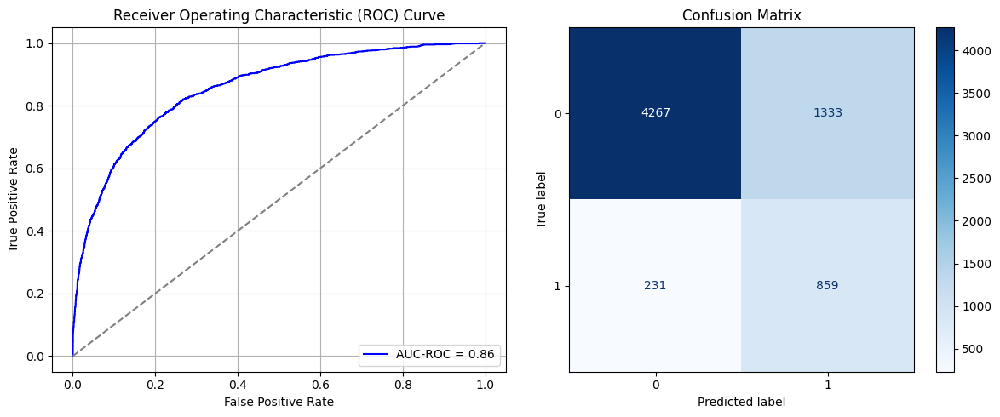

Best threshold based on F1-score: 0.7103345990180969
False Negative Rate: 0.21192660550458717
Time elapsed (performance): 1.0597023379996244
(np.float64(0.2380357142857143), np.float64(0.7619642857142856))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6228 - loss: 0.6739 - val_AUC: 0.7496 - val_loss: 0.6019
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7742 - loss: 0.5788 - val_AUC: 0.8210 - val_loss: 0.5343
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8461 - loss: 0.5027 - val_AUC: 0.8585 - val_loss: 0.4845
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8501 - loss: 0.4846 - val_AUC: 0.8767 - val_loss: 0.4585
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8707 - loss: 0.4543 - val_AUC: 0.8834 - val_loss: 0.4382
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8867 - loss: 0.4277 - val_AUC: 0.8991 - val_loss: 0.4123
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8892 - loss: 0.4202 - val_AUC: 0.9054 - val_loss: 0.4076
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8958 - loss: 0.4089 - val_AUC: 0.9191 - val_loss: 0.3730
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9085 -

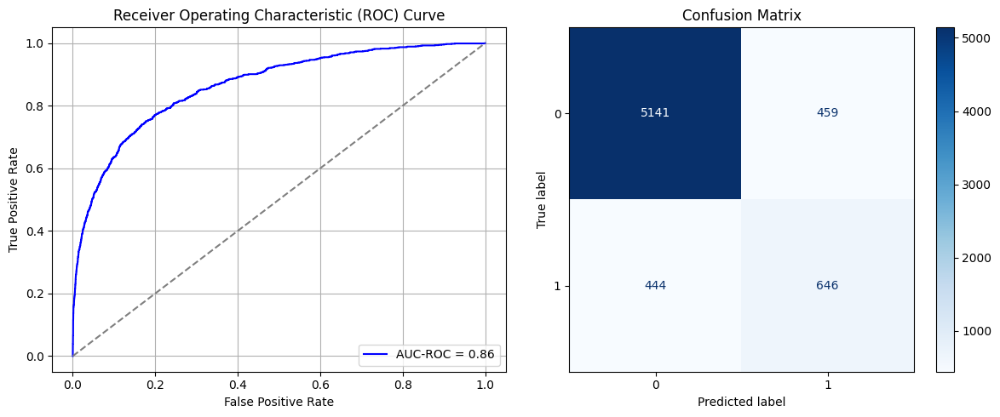

Best threshold based on F1-score: 0.417734295129776
False Negative Rate: 0.4073394495412844
Time elapsed (performance): 1.0411299770021287
(np.float64(0.08196428571428571), np.float64(0.9180357142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6018 - loss: 0.6811 - val_AUC: 0.7246 - val_loss: 0.6311
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7076 - loss: 0.6263 - val_AUC: 0.7917 - val_loss: 0.5852
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7934 - loss: 0.5601 - val_AUC: 0.8539 - val_loss: 0.5103
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8397 - loss: 0.5047 - val_AUC: 0.8794 - val_loss: 0.4570
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8570 - loss: 0.4760 - val_AUC: 0.8935 - val_loss: 0.4425
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4427 - val_AUC: 0.9062 - val_loss: 0.4172
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9015 - loss: 0.4046 - val_AUC: 0.9173 - val_loss: 0.3917
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9096 - loss: 0.3876 - val_AUC: 0.9234 - val_loss: 0.3620
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9209 -

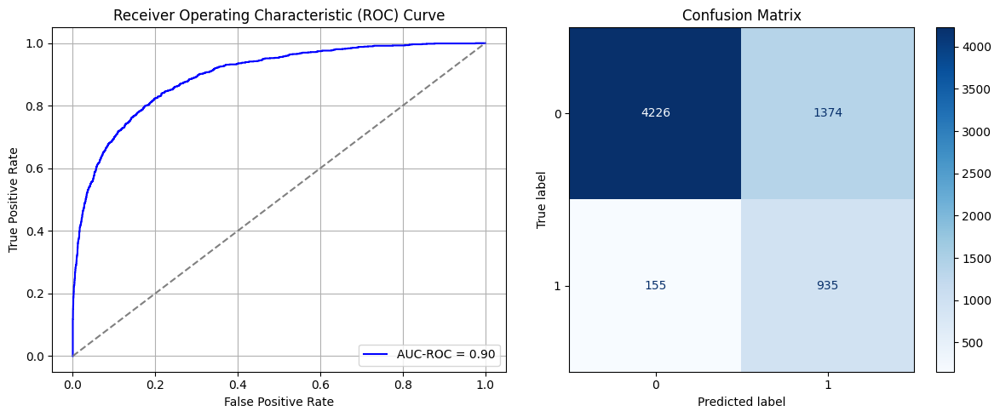

Best threshold based on F1-score: 0.7754042744636536
False Negative Rate: 0.14220183486238533
Time elapsed (performance): 1.0519150519976392
(np.float64(0.24535714285714286), np.float64(0.7546428571428572))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5977 - loss: 0.6780 - val_AUC: 0.7655 - val_loss: 0.6058
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7786 - loss: 0.5839 - val_AUC: 0.8445 - val_loss: 0.5238
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8165 - loss: 0.5320 - val_AUC: 0.8743 - val_loss: 0.4687
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8506 - loss: 0.4845 - val_AUC: 0.8868 - val_loss: 0.4562
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8596 - loss: 0.4675 - val_AUC: 0.8999 - val_loss: 0.4184
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8825 - loss: 0.4331 - val_AUC: 0.9060 - val_loss: 0.4178
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8973 - loss: 0.4074 - val_AUC: 0.9158 - val_loss: 0.3886
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9080 - loss: 0.3908 - val_AUC: 0.9187 - val_loss: 0.3771
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9083 -

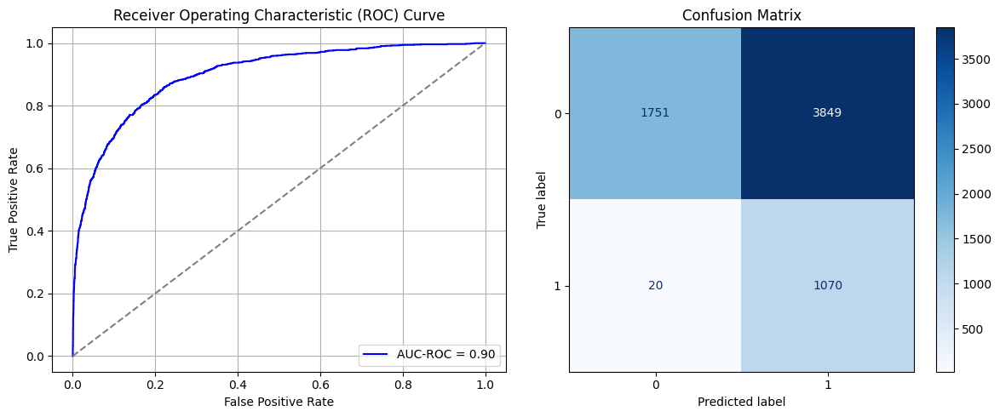

Best threshold based on F1-score: 0.952667236328125
False Negative Rate: 0.01834862385321101
Time elapsed (performance): 1.1033000140014337
(np.float64(0.6873214285714285), np.float64(0.3126785714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6200 - loss: 0.6732 - val_AUC: 0.7613 - val_loss: 0.6064
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7593 - loss: 0.5977 - val_AUC: 0.8285 - val_loss: 0.5359
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8169 - loss: 0.5384 - val_AUC: 0.8748 - val_loss: 0.5030
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8425 - loss: 0.5019 - val_AUC: 0.8949 - val_loss: 0.4397
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8631 - loss: 0.4681 - val_AUC: 0.9092 - val_loss: 0.4261
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4418 - val_AUC: 0.9157 - val_loss: 0.3935
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8969 - loss: 0.4127 - val_AUC: 0.9246 - val_loss: 0.3869
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9048 - loss: 0.3980 - val_AUC: 0.9316 - val_loss: 0.3701
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9142 -

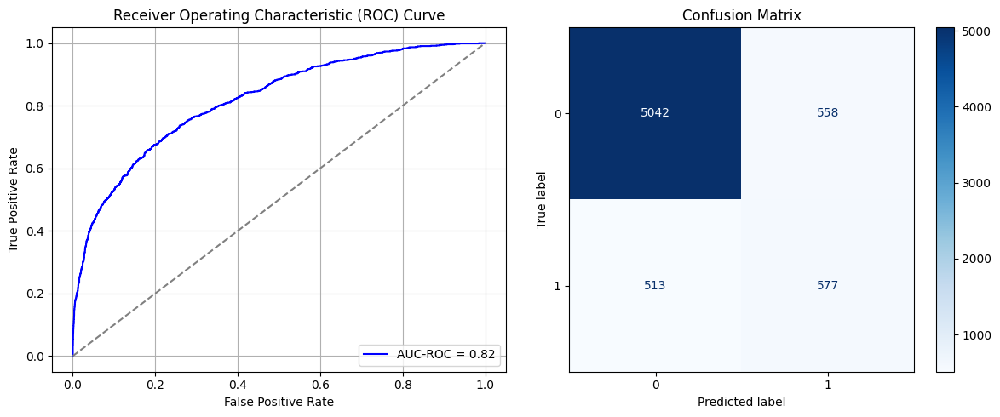

Best threshold based on F1-score: 0.552330493927002
False Negative Rate: 0.4706422018348624
Time elapsed (performance): 0.8231360460013093
(np.float64(0.09964285714285714), np.float64(0.9003571428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6411 - loss: 0.6701 - val_AUC: 0.7382 - val_loss: 0.6106
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7549 - loss: 0.5961 - val_AUC: 0.8068 - val_loss: 0.5436
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8293 - loss: 0.5179 - val_AUC: 0.8521 - val_loss: 0.5041
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8545 - loss: 0.4822 - val_AUC: 0.8663 - val_loss: 0.4893
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4499 - val_AUC: 0.8844 - val_loss: 0.4355
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 - loss: 0.4349 - val_AUC: 0.8927 - val_loss: 0.4174
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8898 - loss: 0.4189 - val_AUC: 0.8996 - val_loss: 0.4094
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9018 - loss: 0.3988 - val_AUC: 0.9092 - val_loss: 0.3872
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9159 -

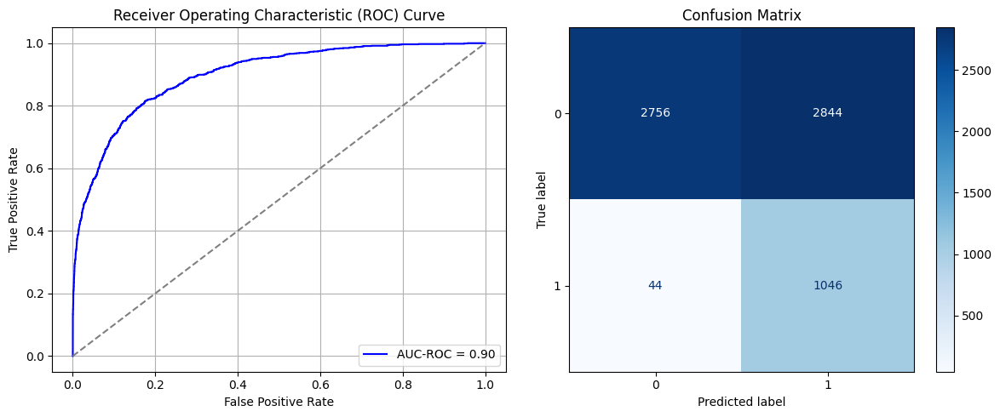

Best threshold based on F1-score: 0.9075917601585388
False Negative Rate: 0.04036697247706422
Time elapsed (performance): 0.8153216520004207
(np.float64(0.5078571428571429), np.float64(0.4921428571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6377 - loss: 0.6673 - val_AUC: 0.7509 - val_loss: 0.6080
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7548 - loss: 0.5951 - val_AUC: 0.8196 - val_loss: 0.5351
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8198 - loss: 0.5263 - val_AUC: 0.8610 - val_loss: 0.4938
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8405 - loss: 0.4994 - val_AUC: 0.8692 - val_loss: 0.4723
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8687 - loss: 0.4564 - val_AUC: 0.8795 - val_loss: 0.4709
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8796 - loss: 0.4417 - val_AUC: 0.8911 - val_loss: 0.4370
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8842 - loss: 0.4316 - val_AUC: 0.8963 - val_loss: 0.4209
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 - loss: 0.4241 - val_AUC: 0.9023 - val_loss: 0.4080
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8991 -

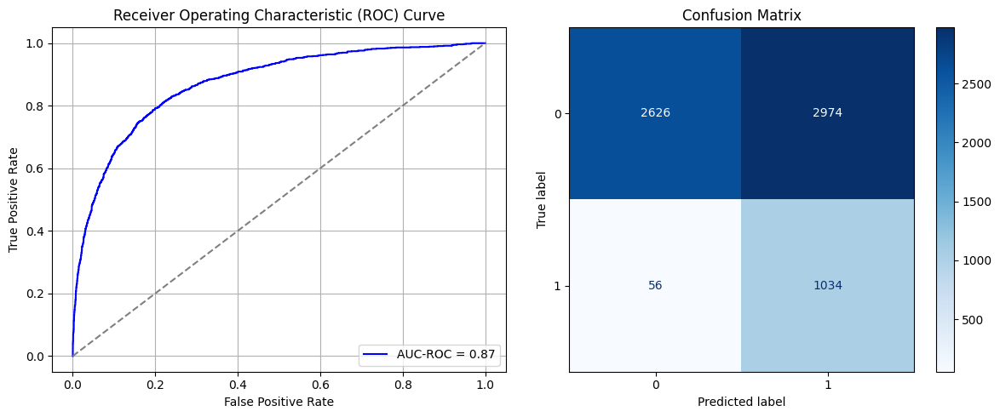

Best threshold based on F1-score: 0.8571589589118958
False Negative Rate: 0.05137614678899083
Time elapsed (performance): 1.0490844749983808
(np.float64(0.5310714285714285), np.float64(0.4689285714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6090 - loss: 0.6739 - val_AUC: 0.7504 - val_loss: 0.6203
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7533 - loss: 0.6040 - val_AUC: 0.8277 - val_loss: 0.5320
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8225 - loss: 0.5318 - val_AUC: 0.8785 - val_loss: 0.4659
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8662 - loss: 0.4705 - val_AUC: 0.8979 - val_loss: 0.4332
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8884 - loss: 0.4334 - val_AUC: 0.9080 - val_loss: 0.4331
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8971 - loss: 0.4133 - val_AUC: 0.9188 - val_loss: 0.3787
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9175 - loss: 0.3738 - val_AUC: 0.9240 - val_loss: 0.3640
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9200 - loss: 0.3669 - val_AUC: 0.9305 - val_loss: 0.3438
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9336 -

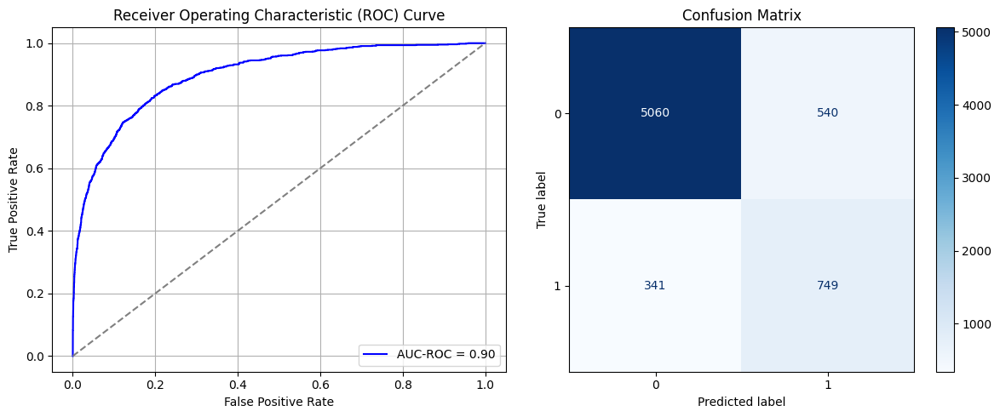

Best threshold based on F1-score: 0.6089013814926147
False Negative Rate: 0.3128440366972477
Time elapsed (performance): 0.8135952830016322
(np.float64(0.09642857142857143), np.float64(0.9035714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6647 - loss: 0.6624 - val_AUC: 0.7651 - val_loss: 0.6055
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7534 - loss: 0.5939 - val_AUC: 0.8240 - val_loss: 0.5607
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8065 - loss: 0.5431 - val_AUC: 0.8597 - val_loss: 0.4929
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8482 - loss: 0.4942 - val_AUC: 0.8785 - val_loss: 0.4584
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8717 - loss: 0.4552 - val_AUC: 0.8902 - val_loss: 0.4338
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4376 - val_AUC: 0.9009 - val_loss: 0.4121
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8955 - loss: 0.4106 - val_AUC: 0.9077 - val_loss: 0.4046
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9089 - loss: 0.3845 - val_AUC: 0.9170 - val_loss: 0.3849
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9046 -

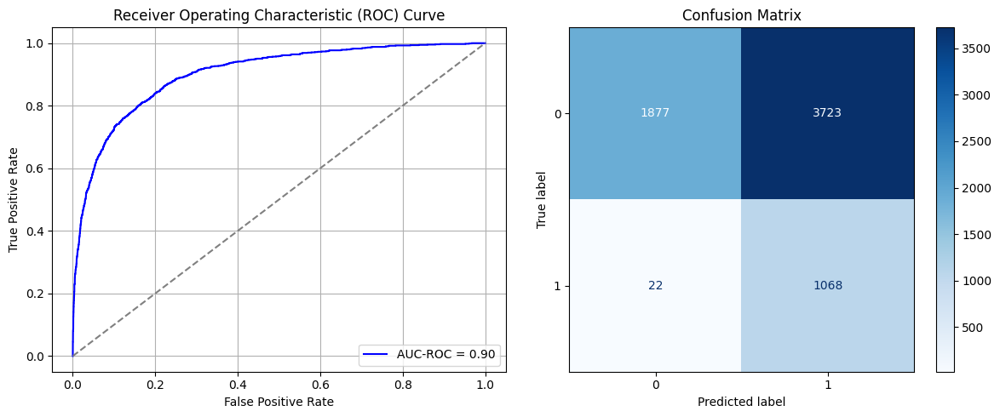

Best threshold based on F1-score: 0.95656818151474
False Negative Rate: 0.02018348623853211
Time elapsed (performance): 0.8704820919992926
(np.float64(0.6648214285714286), np.float64(0.33517857142857144))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6051 - loss: 0.6770 - val_AUC: 0.7720 - val_loss: 0.6048
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7560 - loss: 0.5963 - val_AUC: 0.8365 - val_loss: 0.5312
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8200 - loss: 0.5320 - val_AUC: 0.8734 - val_loss: 0.4873
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8400 - loss: 0.4989 - val_AUC: 0.8832 - val_loss: 0.4508
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8615 - loss: 0.4683 - val_AUC: 0.8969 - val_loss: 0.4241
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8854 - loss: 0.4323 - val_AUC: 0.9122 - val_loss: 0.3970
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8989 - loss: 0.4087 - val_AUC: 0.9214 - val_loss: 0.3754
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9069 - loss: 0.3921 - val_AUC: 0.9302 - val_loss: 0.3782
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9161 -

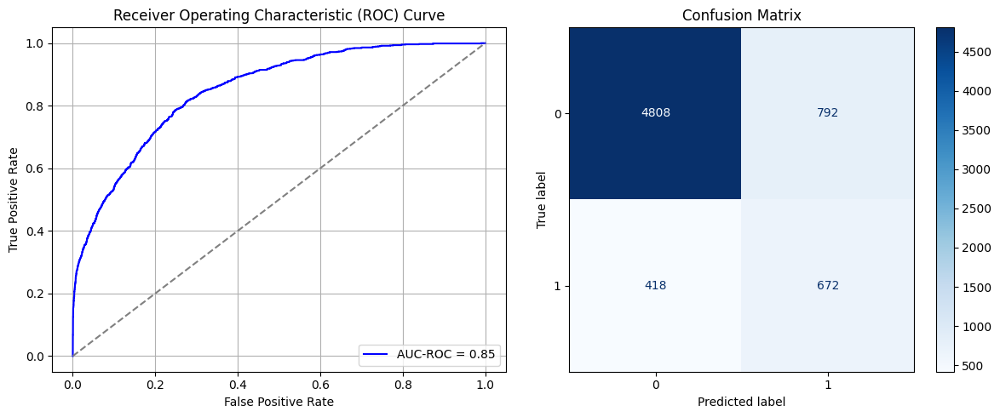

Best threshold based on F1-score: 0.5765156149864197
False Negative Rate: 0.3834862385321101
Time elapsed (performance): 1.0456867399989278
(np.float64(0.14142857142857143), np.float64(0.8585714285714285))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5972 - loss: 0.6811 - val_AUC: 0.7723 - val_loss: 0.5959
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7735 - loss: 0.5845 - val_AUC: 0.8508 - val_loss: 0.5167
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8386 - loss: 0.5140 - val_AUC: 0.8751 - val_loss: 0.4665
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8582 - loss: 0.4755 - val_AUC: 0.8903 - val_loss: 0.4383
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8810 - loss: 0.4400 - val_AUC: 0.8958 - val_loss: 0.4197
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8926 - loss: 0.4191 - val_AUC: 0.9033 - val_loss: 0.4020
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9022 - loss: 0.3989 - val_AUC: 0.9153 - val_loss: 0.3900
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9133 - loss: 0.3787 - val_AUC: 0.9208 - val_loss: 0.3658
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9227 -

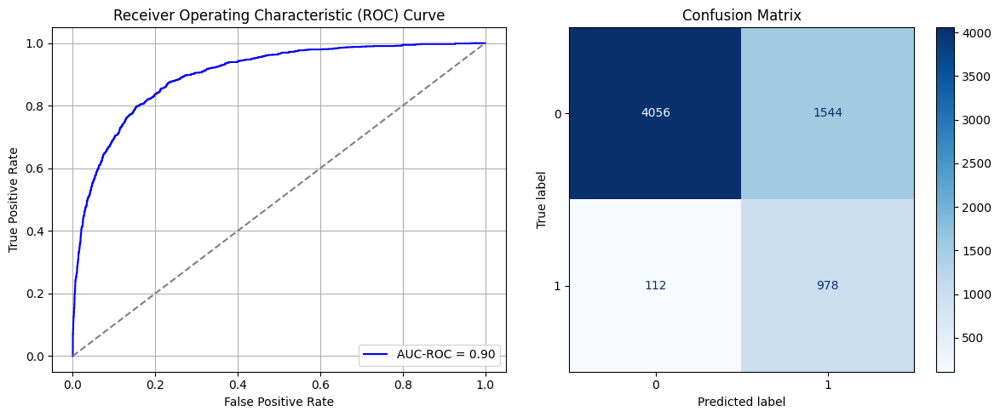

Best threshold based on F1-score: 0.8019534349441528
False Negative Rate: 0.10275229357798166
Time elapsed (performance): 1.121769100001984
(np.float64(0.2757142857142857), np.float64(0.7242857142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.6338 - loss: 0.6714 - val_AUC: 0.7489 - val_loss: 0.6125
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7611 - loss: 0.5965 - val_AUC: 0.8169 - val_loss: 0.5458
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8204 - loss: 0.5338 - val_AUC: 0.8586 - val_loss: 0.4879
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8499 - loss: 0.4912 - val_AUC: 0.8812 - val_loss: 0.4479
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8713 - loss: 0.4558 - val_AUC: 0.8911 - val_loss: 0.4255
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8728 - loss: 0.4470 - val_AUC: 0.8999 - val_loss: 0.4632
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8884 - loss: 0.4275 - val_AUC: 0.9078 - val_loss: 0.4062
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8906 - loss: 0.4181 - val_AUC: 0.9106 - val_loss: 0.3852
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9023 -

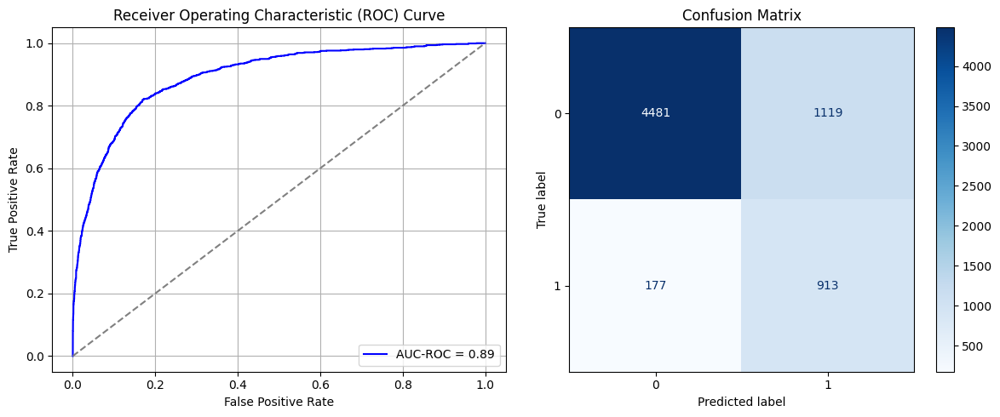

Best threshold based on F1-score: 0.6745007634162903
False Negative Rate: 0.16238532110091744
Time elapsed (performance): 0.8791120099995169
(np.float64(0.19982142857142857), np.float64(0.8001785714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6210 - loss: 0.6701 - val_AUC: 0.7767 - val_loss: 0.5945
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7887 - loss: 0.5703 - val_AUC: 0.8477 - val_loss: 0.5131
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8320 - loss: 0.5148 - val_AUC: 0.8721 - val_loss: 0.4694
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8648 - loss: 0.4672 - val_AUC: 0.9010 - val_loss: 0.4218
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 - loss: 0.4453 - val_AUC: 0.9073 - val_loss: 0.4022
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8941 - loss: 0.4149 - val_AUC: 0.9177 - val_loss: 0.3832
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9054 - loss: 0.3936 - val_AUC: 0.9225 - val_loss: 0.3888
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9157 - loss: 0.3744 - val_AUC: 0.9301 - val_loss: 0.3497
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9331 -

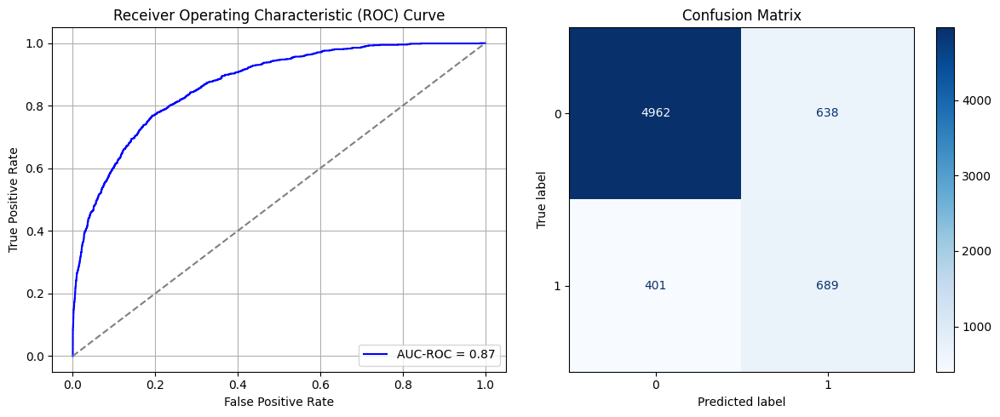

Best threshold based on F1-score: 0.4725017249584198
False Negative Rate: 0.3678899082568807
Time elapsed (performance): 1.2642085109982872
(np.float64(0.11392857142857143), np.float64(0.8860714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6142 - loss: 0.6739 - val_AUC: 0.7728 - val_loss: 0.5961
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7739 - loss: 0.5853 - val_AUC: 0.8383 - val_loss: 0.5544
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8230 - loss: 0.5290 - val_AUC: 0.8777 - val_loss: 0.4779
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8624 - loss: 0.4707 - val_AUC: 0.8947 - val_loss: 0.4327
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8812 - loss: 0.4412 - val_AUC: 0.9054 - val_loss: 0.4022
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8959 - loss: 0.4119 - val_AUC: 0.9149 - val_loss: 0.3813
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9020 - loss: 0.3983 - val_AUC: 0.9218 - val_loss: 0.3653
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9052 - loss: 0.3922 - val_AUC: 0.9270 - val_loss: 0.3550
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9175 -

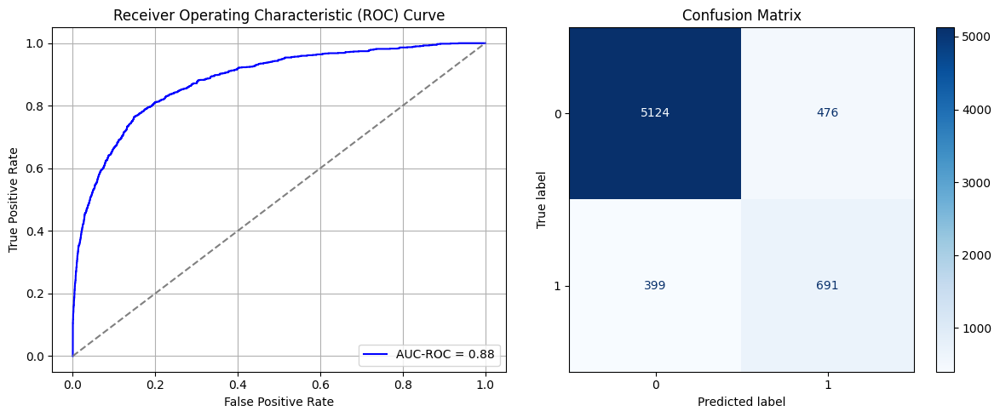

Best threshold based on F1-score: 0.49520039558410645
False Negative Rate: 0.3660550458715596
Time elapsed (performance): 1.0962278979968687
(np.float64(0.085), np.float64(0.915))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6352 - loss: 0.6708 - val_AUC: 0.7487 - val_loss: 0.6132
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7614 - loss: 0.5974 - val_AUC: 0.8521 - val_loss: 0.5691
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8055 - loss: 0.5522 - val_AUC: 0.8826 - val_loss: 0.4694
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8528 - loss: 0.4876 - val_AUC: 0.9014 - val_loss: 0.4459
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8693 - loss: 0.4580 - val_AUC: 0.9152 - val_loss: 0.3999
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 - loss: 0.4324 - val_AUC: 0.9189 - val_loss: 0.3799
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8958 - loss: 0.4118 - val_AUC: 0.9212 - val_loss: 0.3819
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9068 - loss: 0.3897 - val_AUC: 0.9269 - val_loss: 0.3766
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9103 -

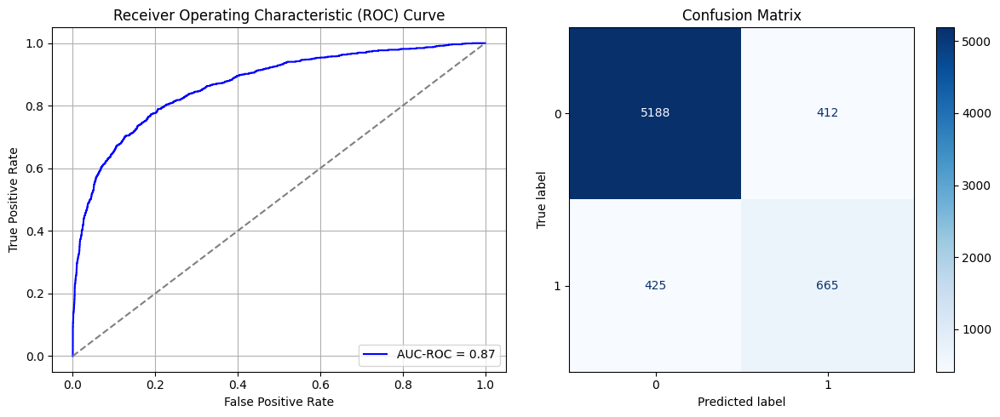

Best threshold based on F1-score: 0.5102273225784302
False Negative Rate: 0.38990825688073394
Time elapsed (performance): 1.192325673000596
(np.float64(0.07357142857142857), np.float64(0.9264285714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6047 - loss: 0.6764 - val_AUC: 0.7263 - val_loss: 0.6191
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7306 - loss: 0.6119 - val_AUC: 0.8149 - val_loss: 0.5490
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7938 - loss: 0.5544 - val_AUC: 0.8543 - val_loss: 0.5143
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8448 - loss: 0.4946 - val_AUC: 0.8789 - val_loss: 0.4635
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8692 - loss: 0.4594 - val_AUC: 0.8869 - val_loss: 0.4383
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8844 - loss: 0.4320 - val_AUC: 0.8996 - val_loss: 0.4168
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8935 - loss: 0.4160 - val_AUC: 0.9097 - val_loss: 0.3937
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8982 - loss: 0.4073 - val_AUC: 0.9162 - val_loss: 0.3925
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9121 -

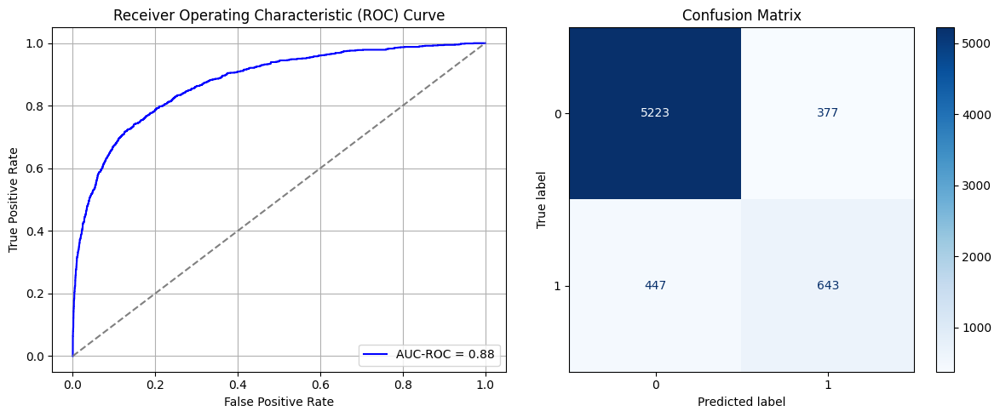

Best threshold based on F1-score: 0.45772987604141235
False Negative Rate: 0.41009174311926605
Time elapsed (performance): 1.26900538100017
(np.float64(0.06732142857142857), np.float64(0.9326785714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6563 - loss: 0.6599 - val_AUC: 0.7644 - val_loss: 0.5966
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7647 - loss: 0.5868 - val_AUC: 0.8212 - val_loss: 0.5364
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8105 - loss: 0.5382 - val_AUC: 0.8627 - val_loss: 0.4999
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8482 - loss: 0.4902 - val_AUC: 0.8813 - val_loss: 0.4556
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 - loss: 0.4434 - val_AUC: 0.8932 - val_loss: 0.4262
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8858 - loss: 0.4291 - val_AUC: 0.9031 - val_loss: 0.4042
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9010 - loss: 0.4018 - val_AUC: 0.9093 - val_loss: 0.3892
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9057 - loss: 0.3930 - val_AUC: 0.9181 - val_loss: 0.3715
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9151 -

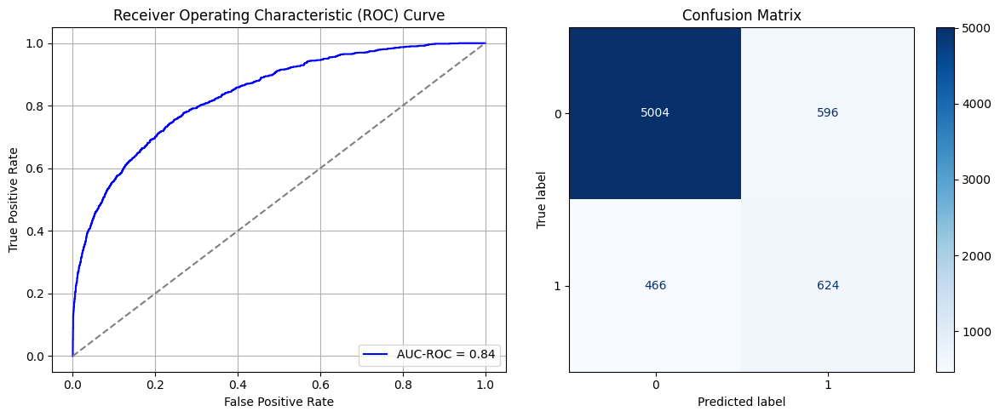

Best threshold based on F1-score: 0.5399636030197144
False Negative Rate: 0.42752293577981654
Time elapsed (performance): 1.2807664690008096
(np.float64(0.10642857142857143), np.float64(0.8935714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6326 - loss: 0.6644 - val_AUC: 0.7572 - val_loss: 0.6025
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7726 - loss: 0.5850 - val_AUC: 0.8344 - val_loss: 0.5274
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8244 - loss: 0.5267 - val_AUC: 0.8640 - val_loss: 0.4811
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8441 - loss: 0.4947 - val_AUC: 0.8773 - val_loss: 0.4583
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8646 - loss: 0.4618 - val_AUC: 0.8847 - val_loss: 0.4555
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8735 - loss: 0.4497 - val_AUC: 0.8885 - val_loss: 0.4278
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4267 - val_AUC: 0.8992 - val_loss: 0.4134
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9020 - loss: 0.4024 - val_AUC: 0.9047 - val_loss: 0.4008
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9030 -

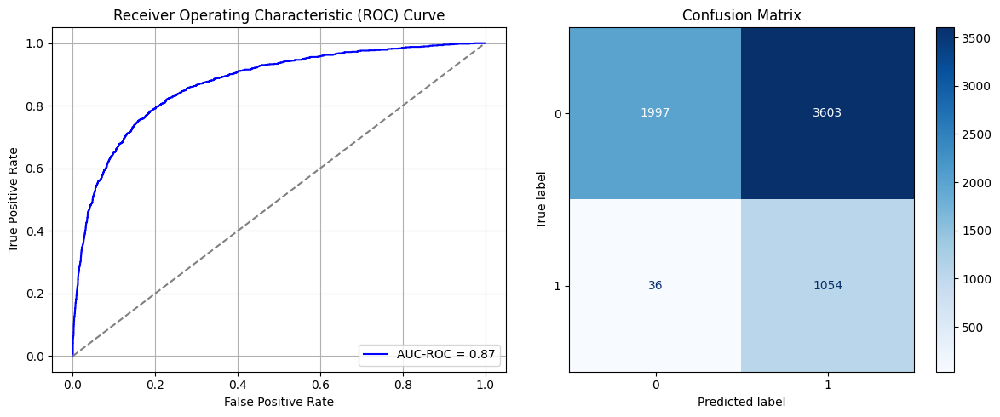

Best threshold based on F1-score: 0.9434276819229126
False Negative Rate: 0.03302752293577982
Time elapsed (performance): 1.2660414269994362
(np.float64(0.6433928571428571), np.float64(0.3566071428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6809 - loss: 0.6534 - val_AUC: 0.7511 - val_loss: 0.6085
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7716 - loss: 0.5841 - val_AUC: 0.8148 - val_loss: 0.5486
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8306 - loss: 0.5237 - val_AUC: 0.8515 - val_loss: 0.5036
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8486 - loss: 0.4910 - val_AUC: 0.8703 - val_loss: 0.4660
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8692 - loss: 0.4574 - val_AUC: 0.8820 - val_loss: 0.4414
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8922 - loss: 0.4224 - val_AUC: 0.8989 - val_loss: 0.4263
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9029 - loss: 0.4005 - val_AUC: 0.9108 - val_loss: 0.4275
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8890 - loss: 0.4203 - val_AUC: 0.9178 - val_loss: 0.3870
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9249 -

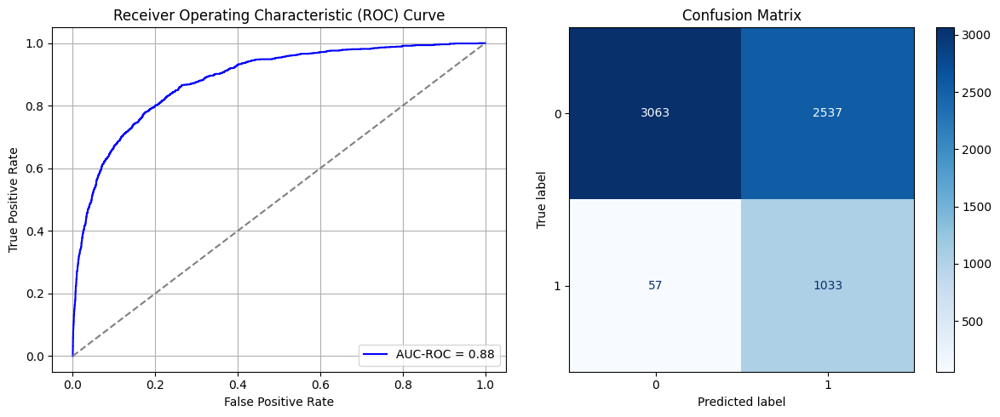

Best threshold based on F1-score: 0.866815984249115
False Negative Rate: 0.05229357798165138
Time elapsed (performance): 1.25741958800063
(np.float64(0.45303571428571426), np.float64(0.5469642857142858))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5427 - loss: 0.6877 - val_AUC: 0.7263 - val_loss: 0.6228
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7473 - loss: 0.6048 - val_AUC: 0.8202 - val_loss: 0.5492
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8237 - loss: 0.5327 - val_AUC: 0.8596 - val_loss: 0.4823
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8558 - loss: 0.4832 - val_AUC: 0.8892 - val_loss: 0.4405
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8887 - loss: 0.4336 - val_AUC: 0.9041 - val_loss: 0.4448
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8989 - loss: 0.4083 - val_AUC: 0.9154 - val_loss: 0.3870
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9238 - loss: 0.3648 - val_AUC: 0.9239 - val_loss: 0.3655
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9254 - loss: 0.3540 - val_AUC: 0.9378 - val_loss: 0.3334
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9348 -

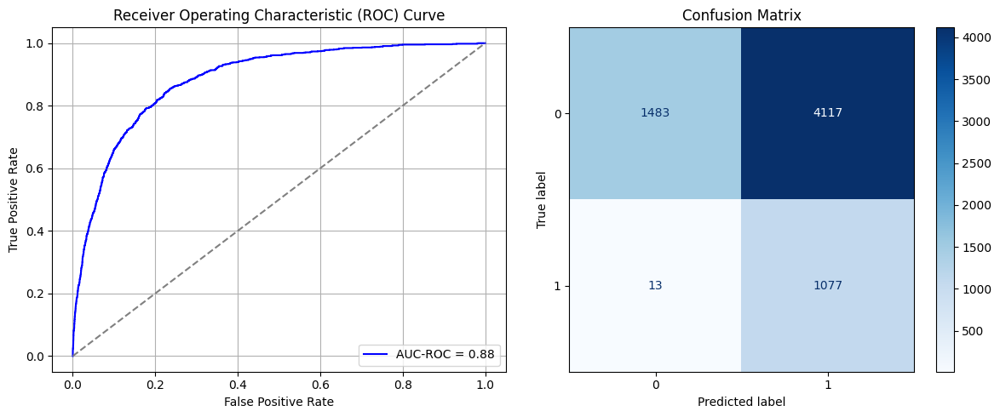

Best threshold based on F1-score: 0.9625032544136047
False Negative Rate: 0.011926605504587157
Time elapsed (performance): 1.23475976500049
(np.float64(0.7351785714285715), np.float64(0.26482142857142854))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6412 - loss: 0.6623 - val_AUC: 0.7570 - val_loss: 0.6189
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7581 - loss: 0.5934 - val_AUC: 0.8466 - val_loss: 0.5443
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8183 - loss: 0.5370 - val_AUC: 0.8726 - val_loss: 0.4881
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8595 - loss: 0.4801 - val_AUC: 0.8903 - val_loss: 0.4491
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8669 - loss: 0.4609 - val_AUC: 0.9067 - val_loss: 0.4177
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8803 - loss: 0.4376 - val_AUC: 0.9150 - val_loss: 0.3969
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8923 - loss: 0.4173 - val_AUC: 0.9187 - val_loss: 0.3807
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9062 - loss: 0.3915 - val_AUC: 0.9242 - val_loss: 0.3675
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9091 -

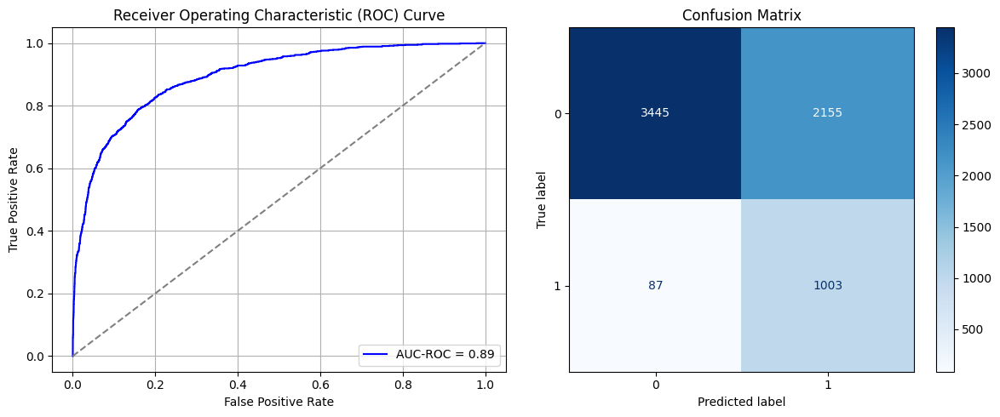

Best threshold based on F1-score: 0.8571465611457825
False Negative Rate: 0.0798165137614679
Time elapsed (performance): 0.9154730760019447
(np.float64(0.3848214285714286), np.float64(0.6151785714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6181 - loss: 0.6739 - val_AUC: 0.7535 - val_loss: 0.6076
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7857 - loss: 0.5723 - val_AUC: 0.8155 - val_loss: 0.5392
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8203 - loss: 0.5275 - val_AUC: 0.8419 - val_loss: 0.5045
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8362 - loss: 0.5026 - val_AUC: 0.8572 - val_loss: 0.4798
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8523 - loss: 0.4788 - val_AUC: 0.8678 - val_loss: 0.4908
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8700 - loss: 0.4541 - val_AUC: 0.8744 - val_loss: 0.4909
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8686 - loss: 0.4531 - val_AUC: 0.8808 - val_loss: 0.4446
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8709 - loss: 0.4493 - val_AUC: 0.8881 - val_loss: 0.4386
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 -

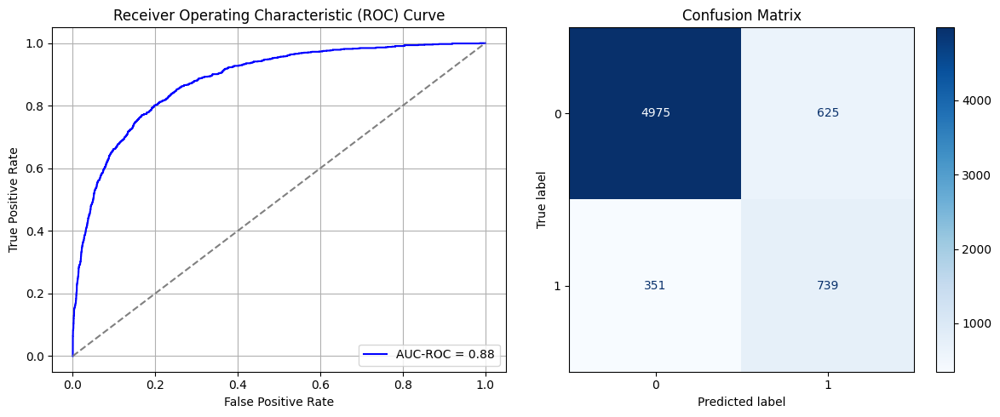

Best threshold based on F1-score: 0.5306351184844971
False Negative Rate: 0.3220183486238532
Time elapsed (performance): 0.8593383770021319
(np.float64(0.11160714285714286), np.float64(0.8883928571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.5957 - loss: 0.6786 - val_AUC: 0.7108 - val_loss: 0.6334
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7337 - loss: 0.6157 - val_AUC: 0.7894 - val_loss: 0.5728
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8077 - loss: 0.5490 - val_AUC: 0.8458 - val_loss: 0.5257
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8454 - loss: 0.4957 - val_AUC: 0.8668 - val_loss: 0.4705
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8686 - loss: 0.4562 - val_AUC: 0.8817 - val_loss: 0.4458
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4338 - val_AUC: 0.8949 - val_loss: 0.4364
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8936 - loss: 0.4135 - val_AUC: 0.9010 - val_loss: 0.4317
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8974 - loss: 0.4055 - val_AUC: 0.9120 - val_loss: 0.4010
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9085 -

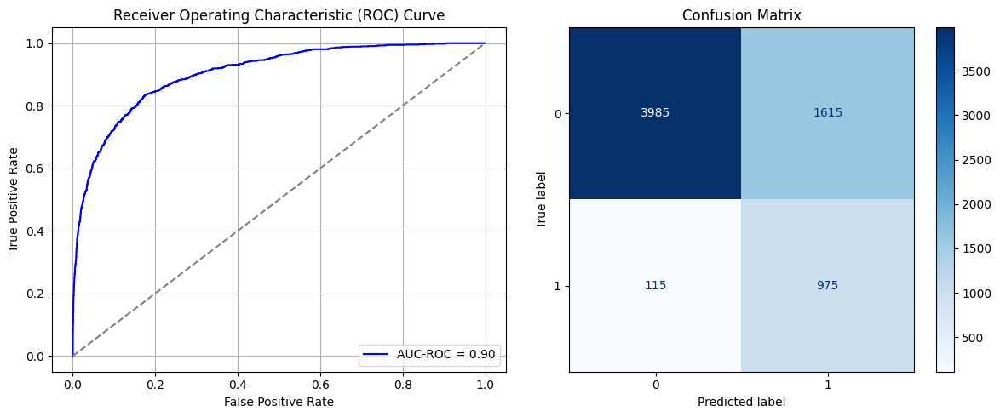

Best threshold based on F1-score: 0.8128634095191956
False Negative Rate: 0.10550458715596331
Time elapsed (performance): 1.2558517629986454
(np.float64(0.2883928571428571), np.float64(0.7116071428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6336 - loss: 0.6696 - val_AUC: 0.7492 - val_loss: 0.6171
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7454 - loss: 0.6056 - val_AUC: 0.8249 - val_loss: 0.5446
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8103 - loss: 0.5461 - val_AUC: 0.8660 - val_loss: 0.4878
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8373 - loss: 0.5061 - val_AUC: 0.8838 - val_loss: 0.4524
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8642 - loss: 0.4666 - val_AUC: 0.8991 - val_loss: 0.4230
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8759 - loss: 0.4440 - val_AUC: 0.9023 - val_loss: 0.4249
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4341 - val_AUC: 0.9138 - val_loss: 0.3876
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8905 - loss: 0.4179 - val_AUC: 0.9229 - val_loss: 0.3712
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9027 -

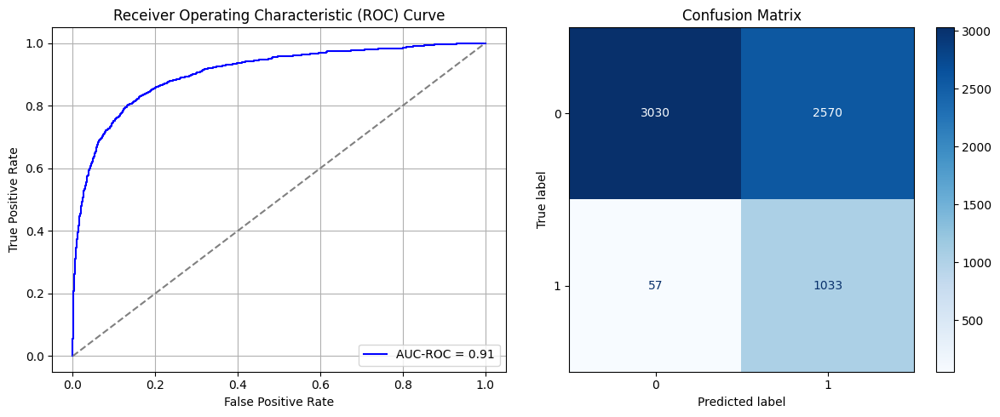

Best threshold based on F1-score: 0.8745306134223938
False Negative Rate: 0.05229357798165138
Time elapsed (performance): 1.3199453449997236
(np.float64(0.4589285714285714), np.float64(0.5410714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6670 - loss: 0.6580 - val_AUC: 0.7736 - val_loss: 0.5913
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7734 - loss: 0.5811 - val_AUC: 0.8387 - val_loss: 0.5210
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8323 - loss: 0.5201 - val_AUC: 0.8689 - val_loss: 0.4754
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8650 - loss: 0.4697 - val_AUC: 0.8882 - val_loss: 0.4445
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4507 - val_AUC: 0.8970 - val_loss: 0.4377
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8886 - loss: 0.4289 - val_AUC: 0.9037 - val_loss: 0.4046
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8961 - loss: 0.4111 - val_AUC: 0.9097 - val_loss: 0.3863
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8965 - loss: 0.4102 - val_AUC: 0.9192 - val_loss: 0.3734
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9154 -

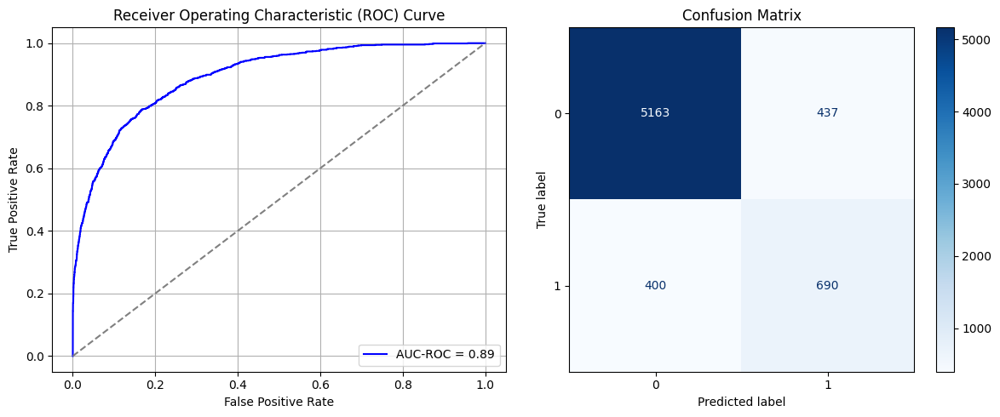

Best threshold based on F1-score: 0.446448415517807
False Negative Rate: 0.3669724770642202
Time elapsed (performance): 1.2703745500002697
(np.float64(0.07803571428571429), np.float64(0.9219642857142857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6208 - loss: 0.6742 - val_AUC: 0.7446 - val_loss: 0.6203
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7447 - loss: 0.6053 - val_AUC: 0.8056 - val_loss: 0.5635
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8124 - loss: 0.5385 - val_AUC: 0.8523 - val_loss: 0.4922
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8475 - loss: 0.4916 - val_AUC: 0.8869 - val_loss: 0.4467
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8788 - loss: 0.4465 - val_AUC: 0.8978 - val_loss: 0.4203
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8885 - loss: 0.4261 - val_AUC: 0.9053 - val_loss: 0.4593
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8972 - loss: 0.4098 - val_AUC: 0.9121 - val_loss: 0.3912
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9014 - loss: 0.4006 - val_AUC: 0.9176 - val_loss: 0.3853
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9108 -

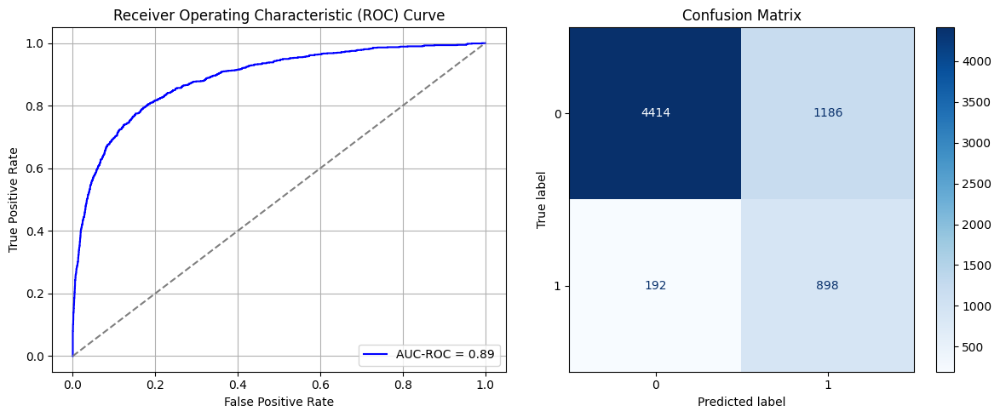

Best threshold based on F1-score: 0.7166805267333984
False Negative Rate: 0.1761467889908257
Time elapsed (performance): 1.2561582410016854
(np.float64(0.2117857142857143), np.float64(0.7882142857142858))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6680 - loss: 0.6606 - val_AUC: 0.7670 - val_loss: 0.5918
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7725 - loss: 0.5804 - val_AUC: 0.8484 - val_loss: 0.5129
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8382 - loss: 0.5123 - val_AUC: 0.8785 - val_loss: 0.4553
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8690 - loss: 0.4609 - val_AUC: 0.8910 - val_loss: 0.4282
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8896 - loss: 0.4258 - val_AUC: 0.9080 - val_loss: 0.4079
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8958 - loss: 0.4113 - val_AUC: 0.9158 - val_loss: 0.3753
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9100 - loss: 0.3852 - val_AUC: 0.9226 - val_loss: 0.4014
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9181 - loss: 0.3701 - val_AUC: 0.9290 - val_loss: 0.3766
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9209 -

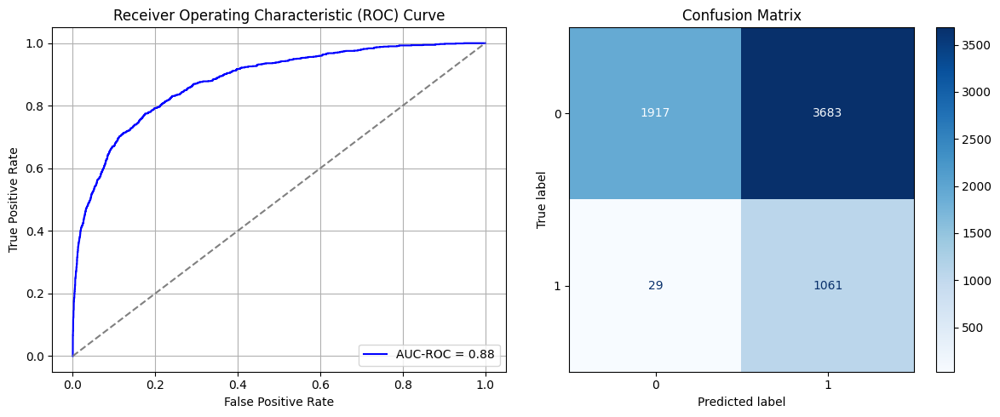

Best threshold based on F1-score: 0.9497160911560059
False Negative Rate: 0.026605504587155965
Time elapsed (performance): 0.9109380429981684
(np.float64(0.6576785714285714), np.float64(0.34232142857142855))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6585 - loss: 0.6621 - val_AUC: 0.7567 - val_loss: 0.6017
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7570 - loss: 0.5940 - val_AUC: 0.8391 - val_loss: 0.5719
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8342 - loss: 0.5204 - val_AUC: 0.8782 - val_loss: 0.4653
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8692 - loss: 0.4661 - val_AUC: 0.8980 - val_loss: 0.4290
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8884 - loss: 0.4302 - val_AUC: 0.9117 - val_loss: 0.4253
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8989 - loss: 0.4094 - val_AUC: 0.9187 - val_loss: 0.3760
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9047 - loss: 0.3934 - val_AUC: 0.9228 - val_loss: 0.3651
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9141 - loss: 0.3743 - val_AUC: 0.9293 - val_loss: 0.3477
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9280 -

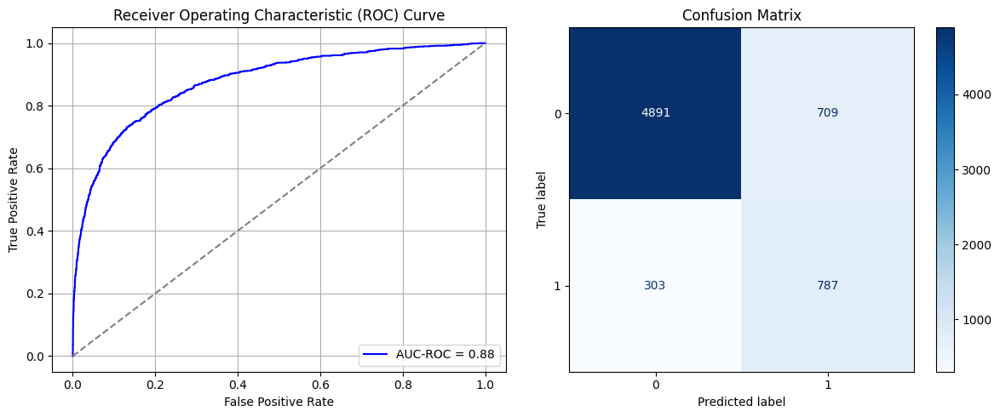

Best threshold based on F1-score: 0.618408203125
False Negative Rate: 0.2779816513761468
Time elapsed (performance): 1.2780136350011162
(np.float64(0.12660714285714286), np.float64(0.8733928571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6454 - loss: 0.6704 - val_AUC: 0.7647 - val_loss: 0.6017
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7934 - loss: 0.5698 - val_AUC: 0.8204 - val_loss: 0.5493
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8299 - loss: 0.5242 - val_AUC: 0.8445 - val_loss: 0.5012
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8603 - loss: 0.4776 - val_AUC: 0.8658 - val_loss: 0.4861
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8778 - loss: 0.4493 - val_AUC: 0.8870 - val_loss: 0.4648
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8729 - loss: 0.4516 - val_AUC: 0.8924 - val_loss: 0.4476
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9034 - loss: 0.4007 - val_AUC: 0.9074 - val_loss: 0.4122
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9080 - loss: 0.3908 - val_AUC: 0.9124 - val_loss: 0.3909
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9082 -

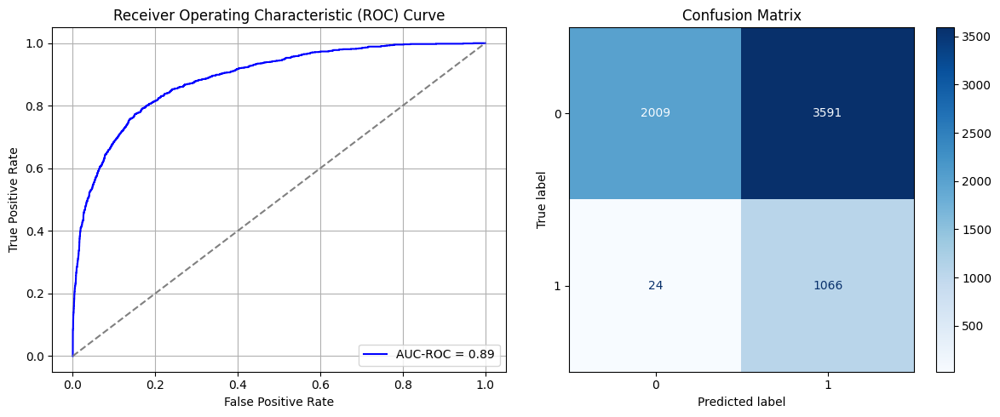

Best threshold based on F1-score: 0.9445110559463501
False Negative Rate: 0.022018348623853212
Time elapsed (performance): 1.050857674999861
(np.float64(0.64125), np.float64(0.35875))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6657 - loss: 0.6578 - val_AUC: 0.7856 - val_loss: 0.5971
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7764 - loss: 0.5810 - val_AUC: 0.8423 - val_loss: 0.5081
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8356 - loss: 0.5096 - val_AUC: 0.8793 - val_loss: 0.4590
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8508 - loss: 0.4844 - val_AUC: 0.8916 - val_loss: 0.4328
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8762 - loss: 0.4460 - val_AUC: 0.8979 - val_loss: 0.4190
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8930 - loss: 0.4191 - val_AUC: 0.9151 - val_loss: 0.4243
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8936 - loss: 0.4148 - val_AUC: 0.9221 - val_loss: 0.3738
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9116 - loss: 0.3825 - val_AUC: 0.9273 - val_loss: 0.4132
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9234 -

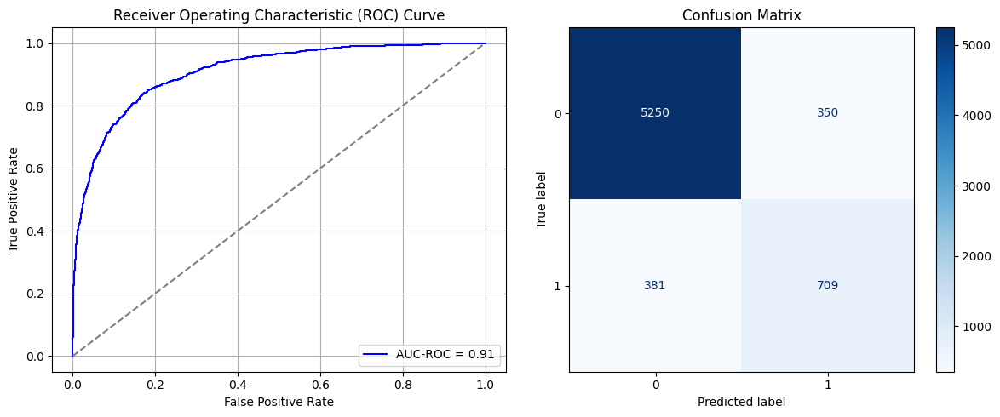

Best threshold based on F1-score: 0.42906060814857483
False Negative Rate: 0.3495412844036697
Time elapsed (performance): 1.086061546997371
(np.float64(0.0625), np.float64(0.9375))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6290 - loss: 0.6700 - val_AUC: 0.7514 - val_loss: 0.5994
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7546 - loss: 0.5937 - val_AUC: 0.8335 - val_loss: 0.5267
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8231 - loss: 0.5278 - val_AUC: 0.8695 - val_loss: 0.4730
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8551 - loss: 0.4820 - val_AUC: 0.8879 - val_loss: 0.4401
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8753 - loss: 0.4488 - val_AUC: 0.8987 - val_loss: 0.4146
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8765 - loss: 0.4425 - val_AUC: 0.9058 - val_loss: 0.4032
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 - loss: 0.4249 - val_AUC: 0.9123 - val_loss: 0.3845
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9057 - loss: 0.3931 - val_AUC: 0.9208 - val_loss: 0.3929
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9111 -

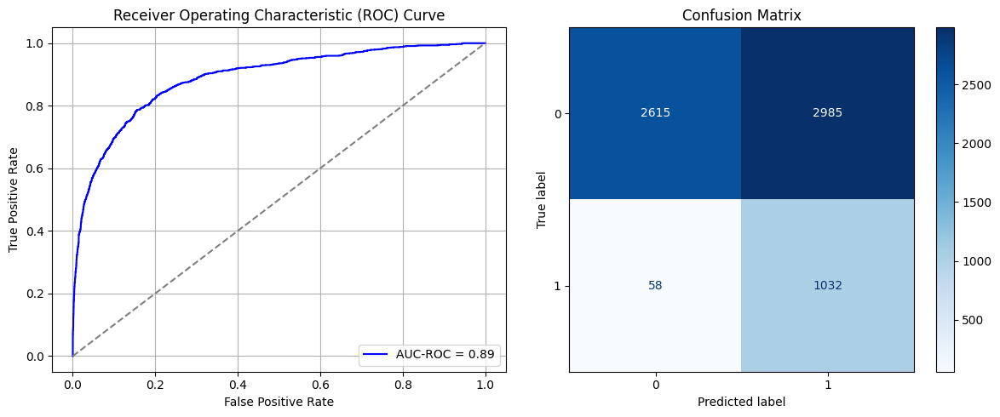

Best threshold based on F1-score: 0.9075126647949219
False Negative Rate: 0.05321100917431193
Time elapsed (performance): 0.9063953139993828
(np.float64(0.5330357142857143), np.float64(0.4669642857142857))
    Source time       FPR       TNR       FNR       TPR  Target time
0      8.451166  0.461250  0.538750  0.055963  0.944037     0.722359
1      8.491557  0.417679  0.582321  0.072477  0.927523     0.744806
2     11.825444  0.417143  0.582857  0.050459  0.949541     0.807106
3      8.001055  0.295179  0.704821  0.076147  0.923853     1.219787
4      8.067710  0.182857  0.817143  0.167890  0.832110     0.805298
5      8.728035  0.575357  0.424643  0.048624  0.951376     0.771860
6      9.931227  0.674643  0.325357  0.012844  0.987156     0.764598
7      9.592872  0.436607  0.563393  0.066055  0.933945     0.799554
8      8.103309  0.649821  0.350179  0.023853  0.976147     1.221526
9      8.355356  0.498036  0.501964  0.075229  0.924771     0.771304
10     9.122196  0.734821  0.265179

In [52]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = oversample_size/undersample_size
print(k)

# np.random.seed(123)

for i in range(times):
    start = random.randint(1, int(k))
    # print(start)

    Row = []

    for j in range(undersample_size):
      row = start+int(k*j)-1
      Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)


In [53]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.1878348623853211
Variance: 0.029181451090662683


In [54]:
print(ParamFit)
ParamFit.to_csv('Sy_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      8.451166  0.461250  0.538750  0.055963  0.944037     0.722359
1      8.491557  0.417679  0.582321  0.072477  0.927523     0.744806
2     11.825444  0.417143  0.582857  0.050459  0.949541     0.807106
3      8.001055  0.295179  0.704821  0.076147  0.923853     1.219787
4      8.067710  0.182857  0.817143  0.167890  0.832110     0.805298
5      8.728035  0.575357  0.424643  0.048624  0.951376     0.771860
6      9.931227  0.674643  0.325357  0.012844  0.987156     0.764598
7      9.592872  0.436607  0.563393  0.066055  0.933945     0.799554
8      8.103309  0.649821  0.350179  0.023853  0.976147     1.221526
9      8.355356  0.498036  0.501964  0.075229  0.924771     0.771304
10     9.122196  0.734821  0.265179  0.013761  0.986239     0.767268
11     9.223113  0.134464  0.865536  0.285321  0.714679     1.024376
12    10.239272  0.096964  0.903036  0.306422  0.693578     0.753341
13     8.472392  0.030893  0.96910

## Systematic Sampling (multiple samples):

Now, we investigate the possibility of conducting $m$ systematic samples, each with a sampling interval of $k=m*\frac{N_0}{N_1}$, and obtaining the undersampled majority class data using all $m$ systematic samples combined. This may more closely approximate SRS sampling.

For convenience, we take $m=10$ in this case.

49.61636828644501
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6081 - loss: 0.6792 - val_AUC: 0.7560 - val_loss: 0.6036
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7610 - loss: 0.5957 - val_AUC: 0.8312 - val_loss: 0.5406
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8073 - loss: 0.5463 - val_AUC: 0.8642 - val_loss: 0.4801
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8389 - loss: 0.5012 - val_AUC: 0.8820 - val_loss: 0.4574
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8666 - loss: 0.4636 - val_AUC: 0.8940 - val_loss: 0.4306
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4450 - val_AUC: 0.8970 - val_loss: 0.4111
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8795 - loss: 0.4395 - val_AUC: 0.9143 - val_loss: 0.3943
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9012 - loss: 0.4027 - val_AUC: 0.9201 - val_loss: 0.3750
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9124 -

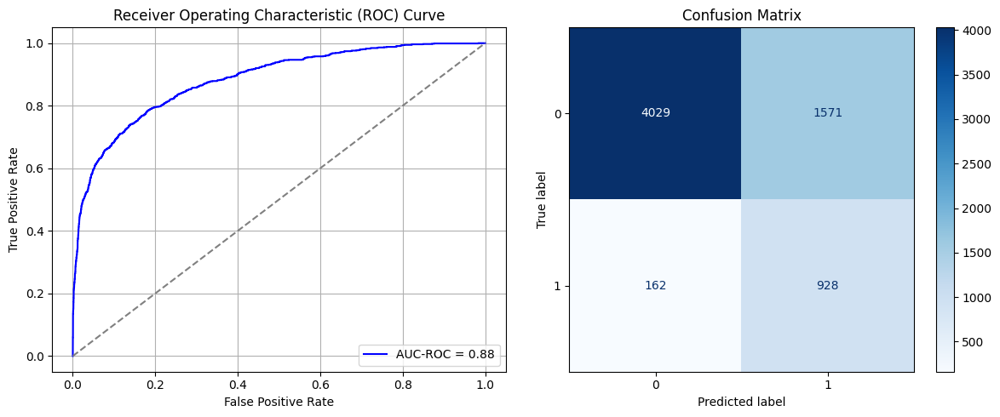

Best threshold based on F1-score: 0.8387935757637024
False Negative Rate: 0.14862385321100918
Time elapsed (performance): 1.043096440997033
(np.float64(0.2805357142857143), np.float64(0.7194642857142857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6160 - loss: 0.6715 - val_AUC: 0.7707 - val_loss: 0.5972
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7926 - loss: 0.5697 - val_AUC: 0.8376 - val_loss: 0.5572
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8452 - loss: 0.5012 - val_AUC: 0.8676 - val_loss: 0.4798
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8677 - loss: 0.4662 - val_AUC: 0.8898 - val_loss: 0.4348
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8983 - loss: 0.4152 - val_AUC: 0.8964 - val_loss: 0.4209
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8905 - loss: 0.4223 - val_AUC: 0.9130 - val_loss: 0.3942
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9029 - loss: 0.3983 - val_AUC: 0.9227 - val_loss: 0.3663
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9199 - loss: 0.3655 - val_AUC: 0.9292 - val_loss: 0.3485
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9275 -

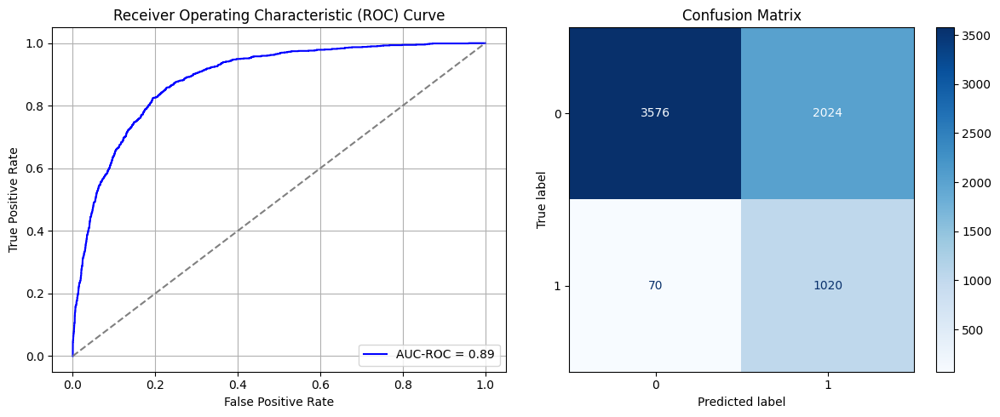

Best threshold based on F1-score: 0.8529518842697144
False Negative Rate: 0.06422018348623854
Time elapsed (performance): 0.7415019740001298
(np.float64(0.36142857142857143), np.float64(0.6385714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6569 - loss: 0.6606 - val_AUC: 0.7779 - val_loss: 0.5944
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7943 - loss: 0.5673 - val_AUC: 0.8280 - val_loss: 0.5465
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8334 - loss: 0.5159 - val_AUC: 0.8524 - val_loss: 0.4938
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8657 - loss: 0.4677 - val_AUC: 0.8722 - val_loss: 0.4733
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4446 - val_AUC: 0.8823 - val_loss: 0.4420
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9028 - loss: 0.4056 - val_AUC: 0.8946 - val_loss: 0.4261
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8990 - loss: 0.4086 - val_AUC: 0.9032 - val_loss: 0.4140
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9110 - loss: 0.3830 - val_AUC: 0.9098 - val_loss: 0.4249
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9159 -

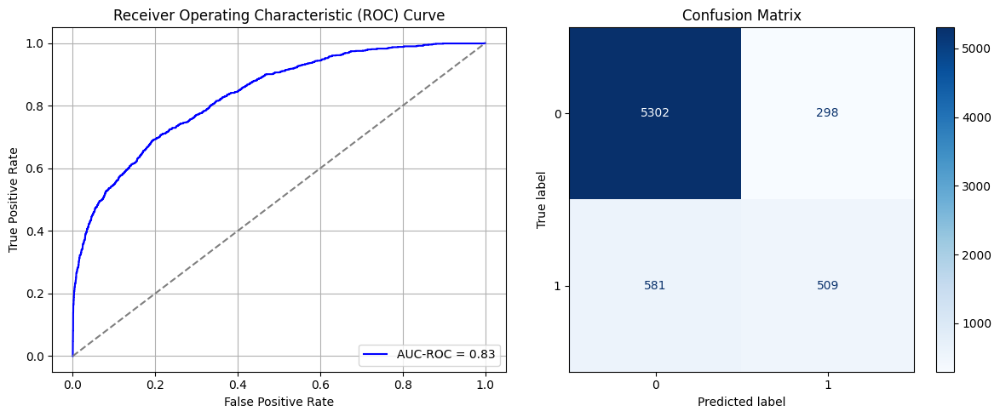

Best threshold based on F1-score: 0.4135728180408478
False Negative Rate: 0.5330275229357798
Time elapsed (performance): 0.7220510789993568
(np.float64(0.053214285714285714), np.float64(0.9467857142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6672 - loss: 0.6555 - val_AUC: 0.7561 - val_loss: 0.6013
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7694 - loss: 0.5849 - val_AUC: 0.8241 - val_loss: 0.5388
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8025 - loss: 0.5468 - val_AUC: 0.8593 - val_loss: 0.5059
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8548 - loss: 0.4868 - val_AUC: 0.8699 - val_loss: 0.4679
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8617 - loss: 0.4684 - val_AUC: 0.8878 - val_loss: 0.4379
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8741 - loss: 0.4485 - val_AUC: 0.8988 - val_loss: 0.4157
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8933 - loss: 0.4183 - val_AUC: 0.9074 - val_loss: 0.4031
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9066 - loss: 0.3949 - val_AUC: 0.9117 - val_loss: 0.4246
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9064 -

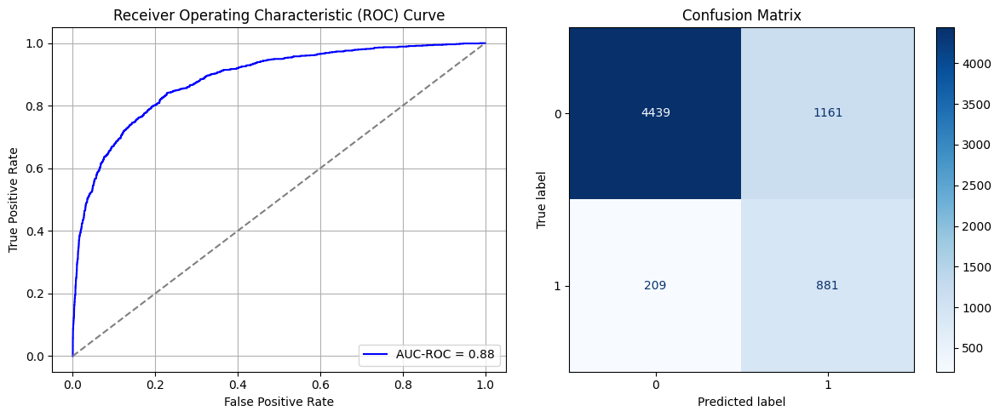

Best threshold based on F1-score: 0.7017433643341064
False Negative Rate: 0.19174311926605506
Time elapsed (performance): 0.9374793129973114
(np.float64(0.20732142857142857), np.float64(0.7926785714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.5851 - loss: 0.6821 - val_AUC: 0.7235 - val_loss: 0.6230
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7523 - loss: 0.6012 - val_AUC: 0.8201 - val_loss: 0.5474
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8240 - loss: 0.5283 - val_AUC: 0.8579 - val_loss: 0.4926
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8477 - loss: 0.4942 - val_AUC: 0.8806 - val_loss: 0.4481
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8733 - loss: 0.4512 - val_AUC: 0.8913 - val_loss: 0.4240
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8966 - loss: 0.4150 - val_AUC: 0.9040 - val_loss: 0.4295
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9002 - loss: 0.4080 - val_AUC: 0.9133 - val_loss: 0.3856
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9099 - loss: 0.3845 - val_AUC: 0.9218 - val_loss: 0.3634
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9169 -

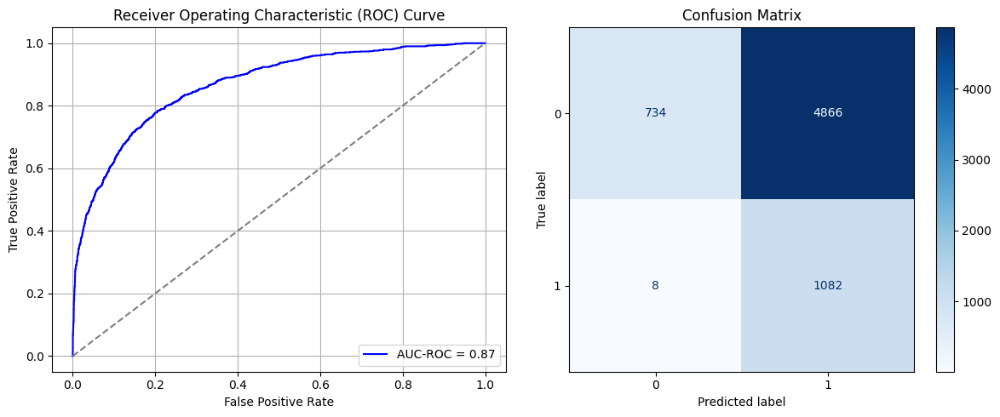

Best threshold based on F1-score: 0.9749112725257874
False Negative Rate: 0.007339449541284404
Time elapsed (performance): 0.7525538830013829
(np.float64(0.8689285714285714), np.float64(0.13107142857142862))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5869 - loss: 0.6780 - val_AUC: 0.7575 - val_loss: 0.6110
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7719 - loss: 0.5857 - val_AUC: 0.8253 - val_loss: 0.5299
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8325 - loss: 0.5136 - val_AUC: 0.8522 - val_loss: 0.4850
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8576 - loss: 0.4757 - val_AUC: 0.8707 - val_loss: 0.4570
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8798 - loss: 0.4420 - val_AUC: 0.8843 - val_loss: 0.4518
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8825 - loss: 0.4352 - val_AUC: 0.8920 - val_loss: 0.4211
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8904 - loss: 0.4222 - val_AUC: 0.8984 - val_loss: 0.4199
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8948 - loss: 0.4112 - val_AUC: 0.9108 - val_loss: 0.3892
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9152 -

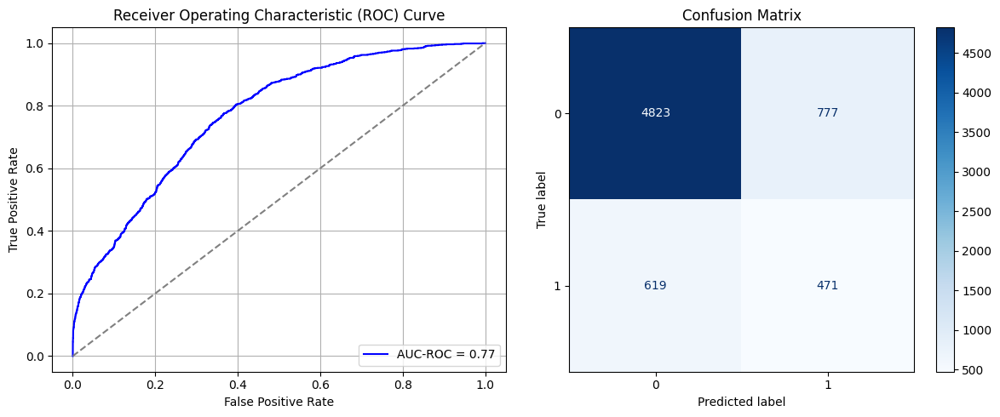

Best threshold based on F1-score: 0.22201640903949738
False Negative Rate: 0.5678899082568807
Time elapsed (performance): 1.0317387570030405
(np.float64(0.13875), np.float64(0.86125))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6500 - loss: 0.6602 - val_AUC: 0.7849 - val_loss: 0.5847
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7835 - loss: 0.5735 - val_AUC: 0.8455 - val_loss: 0.5097
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8370 - loss: 0.5098 - val_AUC: 0.8673 - val_loss: 0.4681
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8545 - loss: 0.4756 - val_AUC: 0.8859 - val_loss: 0.4383
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4443 - val_AUC: 0.8931 - val_loss: 0.4244
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8814 - loss: 0.4329 - val_AUC: 0.9047 - val_loss: 0.4083
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9037 - loss: 0.3975 - val_AUC: 0.9159 - val_loss: 0.3800
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9083 - loss: 0.3860 - val_AUC: 0.9203 - val_loss: 0.4169
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9167 -

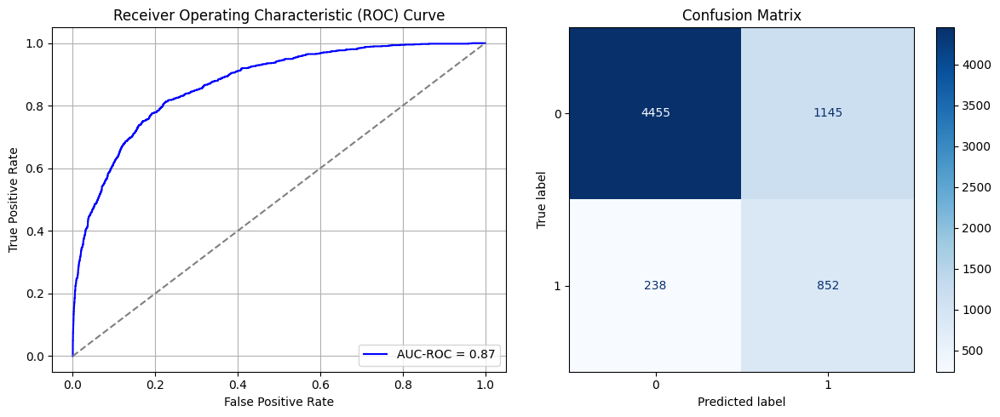

Best threshold based on F1-score: 0.6284815669059753
False Negative Rate: 0.21834862385321102
Time elapsed (performance): 0.7494494879974809
(np.float64(0.2044642857142857), np.float64(0.7955357142857142))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6240 - loss: 0.6713 - val_AUC: 0.7803 - val_loss: 0.5912
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7871 - loss: 0.5676 - val_AUC: 0.8537 - val_loss: 0.5072
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8421 - loss: 0.5068 - val_AUC: 0.8792 - val_loss: 0.4615
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8662 - loss: 0.4654 - val_AUC: 0.8948 - val_loss: 0.4259
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4469 - val_AUC: 0.9058 - val_loss: 0.4477
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8885 - loss: 0.4238 - val_AUC: 0.9149 - val_loss: 0.3870
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9034 - loss: 0.3971 - val_AUC: 0.9185 - val_loss: 0.3745
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9146 - loss: 0.3760 - val_AUC: 0.9276 - val_loss: 0.3530
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9178 -

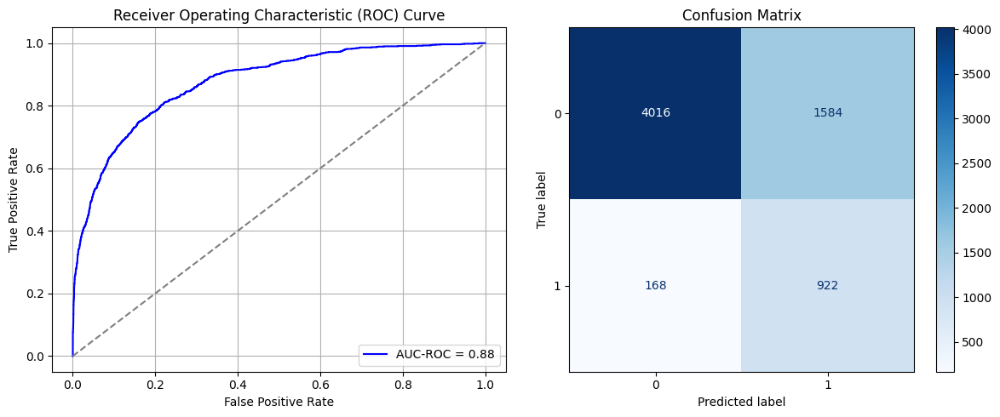

Best threshold based on F1-score: 0.765032947063446
False Negative Rate: 0.15412844036697249
Time elapsed (performance): 1.1367248420028773
(np.float64(0.28285714285714286), np.float64(0.7171428571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6510 - loss: 0.6648 - val_AUC: 0.7365 - val_loss: 0.6177
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.7719 - loss: 0.5858 - val_AUC: 0.8065 - val_loss: 0.5800
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8119 - loss: 0.5393 - val_AUC: 0.8409 - val_loss: 0.5034
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8521 - loss: 0.4865 - val_AUC: 0.8615 - val_loss: 0.4790
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8762 - loss: 0.4485 - val_AUC: 0.8817 - val_loss: 0.4393
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4418 - val_AUC: 0.8901 - val_loss: 0.4264
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8967 - loss: 0.4089 - val_AUC: 0.9043 - val_loss: 0.4048
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9101 - loss: 0.3888 - val_AUC: 0.9099 - val_loss: 0.3934
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9123 -

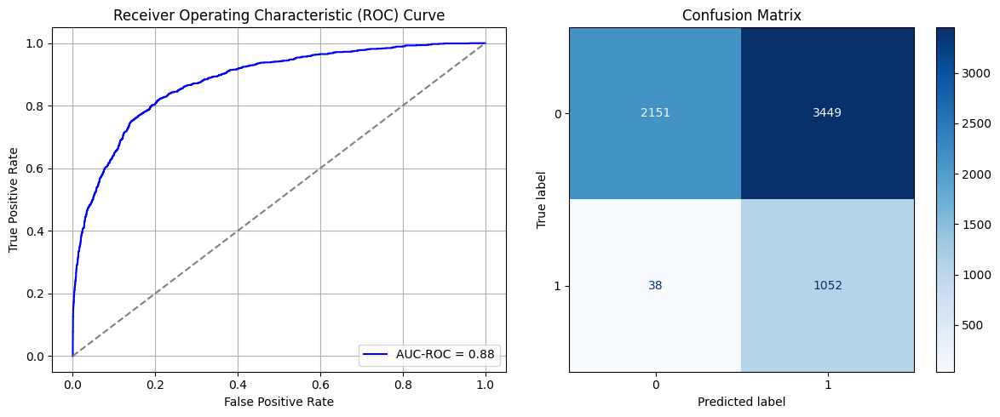

Best threshold based on F1-score: 0.8862777948379517
False Negative Rate: 0.03486238532110092
Time elapsed (performance): 0.7647909609986527
(np.float64(0.6158928571428571), np.float64(0.38410714285714287))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6060 - loss: 0.6815 - val_AUC: 0.7385 - val_loss: 0.6219
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7416 - loss: 0.6072 - val_AUC: 0.8096 - val_loss: 0.5834
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8051 - loss: 0.5503 - val_AUC: 0.8481 - val_loss: 0.5050
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8572 - loss: 0.4843 - val_AUC: 0.8646 - val_loss: 0.4704
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4594 - val_AUC: 0.8858 - val_loss: 0.4340
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8906 - loss: 0.4237 - val_AUC: 0.9024 - val_loss: 0.4133
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8962 - loss: 0.4132 - val_AUC: 0.9123 - val_loss: 0.3863
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9139 - loss: 0.3813 - val_AUC: 0.9230 - val_loss: 0.3689
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.9282 -

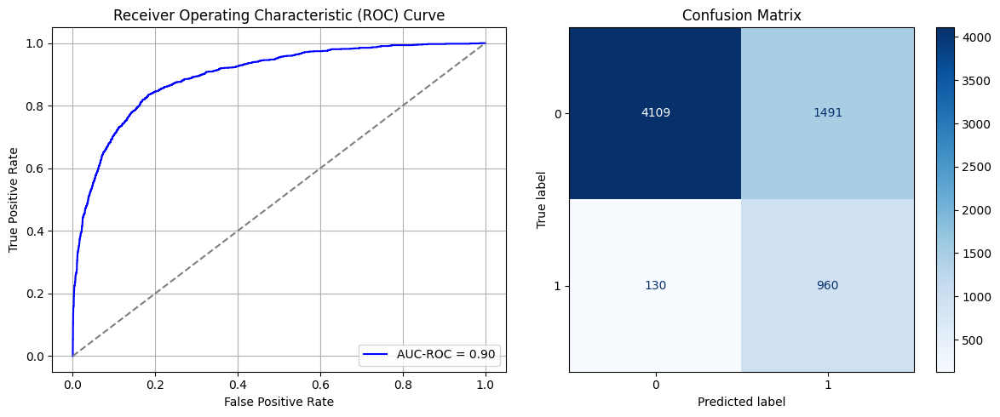

Best threshold based on F1-score: 0.7837892174720764
False Negative Rate: 0.11926605504587157
Time elapsed (performance): 0.7726304979987617
(np.float64(0.26625), np.float64(0.73375))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6343 - loss: 0.6683 - val_AUC: 0.7638 - val_loss: 0.6028
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7555 - loss: 0.5962 - val_AUC: 0.8170 - val_loss: 0.5450
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8120 - loss: 0.5425 - val_AUC: 0.8600 - val_loss: 0.4888
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8589 - loss: 0.4832 - val_AUC: 0.8847 - val_loss: 0.4481
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8726 - loss: 0.4555 - val_AUC: 0.8982 - val_loss: 0.4265
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8969 - loss: 0.4137 - val_AUC: 0.9094 - val_loss: 0.3972
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8938 - loss: 0.4152 - val_AUC: 0.9116 - val_loss: 0.3874
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9138 - loss: 0.3794 - val_AUC: 0.9214 - val_loss: 0.3726
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9182 -

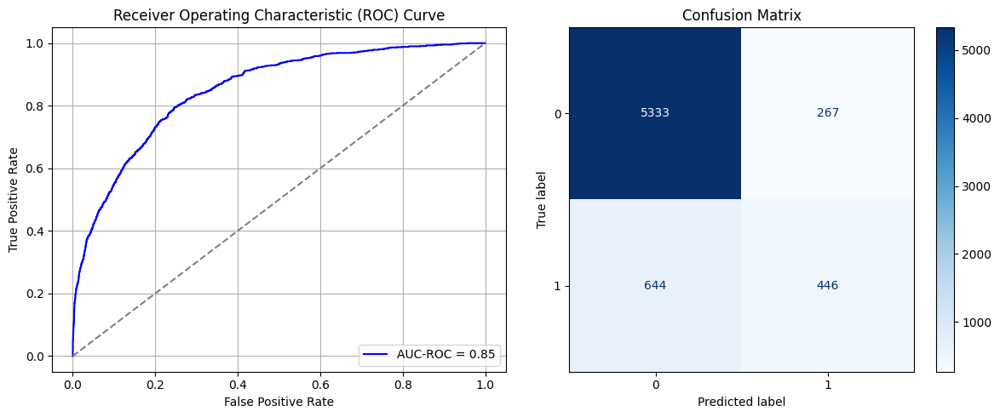

Best threshold based on F1-score: 0.2929382920265198
False Negative Rate: 0.5908256880733945
Time elapsed (performance): 1.0210524089998216
(np.float64(0.04767857142857143), np.float64(0.9523214285714285))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6200 - loss: 0.6737 - val_AUC: 0.7324 - val_loss: 0.6305
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7476 - loss: 0.6052 - val_AUC: 0.8047 - val_loss: 0.5759
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8079 - loss: 0.5521 - val_AUC: 0.8337 - val_loss: 0.5290
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8250 - loss: 0.5196 - val_AUC: 0.8534 - val_loss: 0.5189
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8537 - loss: 0.4807 - val_AUC: 0.8657 - val_loss: 0.4758
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8659 - loss: 0.4616 - val_AUC: 0.8706 - val_loss: 0.4556
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8683 - loss: 0.4534 - val_AUC: 0.8851 - val_loss: 0.4313
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8958 - loss: 0.4122 - val_AUC: 0.8930 - val_loss: 0.4187
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8902 -

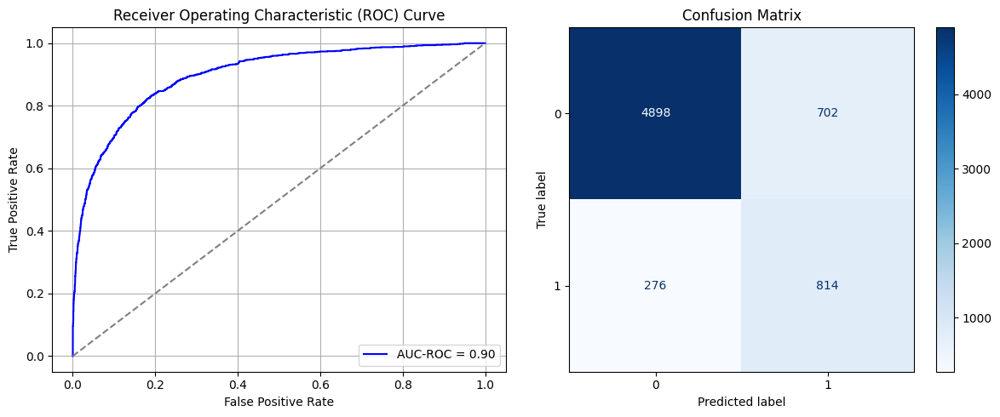

Best threshold based on F1-score: 0.5985419154167175
False Negative Rate: 0.25321100917431194
Time elapsed (performance): 4.28319109199947
(np.float64(0.12535714285714286), np.float64(0.8746428571428572))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6348 - loss: 0.6709 - val_AUC: 0.7497 - val_loss: 0.6108
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7543 - loss: 0.5962 - val_AUC: 0.8301 - val_loss: 0.5384
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8183 - loss: 0.5317 - val_AUC: 0.8681 - val_loss: 0.4784
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8547 - loss: 0.4831 - val_AUC: 0.8874 - val_loss: 0.4424
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8879 - loss: 0.4326 - val_AUC: 0.8977 - val_loss: 0.4163
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8875 - loss: 0.4258 - val_AUC: 0.9136 - val_loss: 0.4185
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9018 - loss: 0.4027 - val_AUC: 0.9236 - val_loss: 0.3736
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8993 - loss: 0.4042 - val_AUC: 0.9288 - val_loss: 0.3542
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9217 -

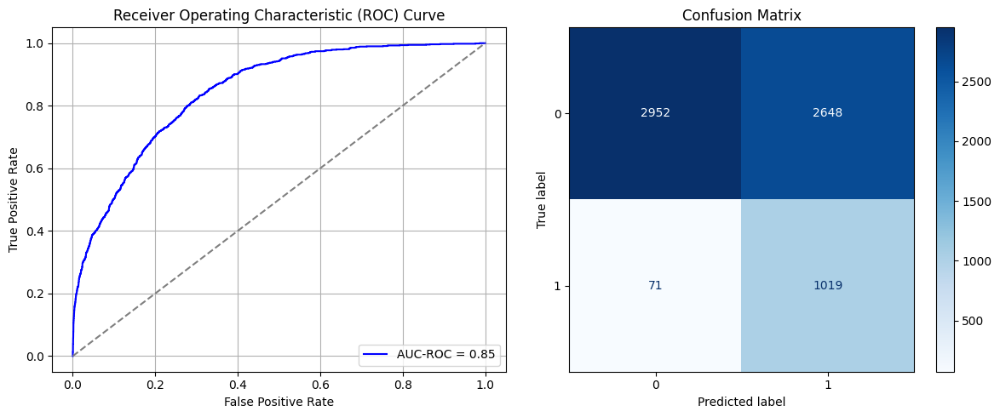

Best threshold based on F1-score: 0.8227801322937012
False Negative Rate: 0.06513761467889909
Time elapsed (performance): 1.0556348860009166
(np.float64(0.47285714285714286), np.float64(0.5271428571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6049 - loss: 0.6754 - val_AUC: 0.7595 - val_loss: 0.6023
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7599 - loss: 0.5956 - val_AUC: 0.8293 - val_loss: 0.5337
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8161 - loss: 0.5359 - val_AUC: 0.8575 - val_loss: 0.5181
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8508 - loss: 0.4880 - val_AUC: 0.8866 - val_loss: 0.4479
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4494 - val_AUC: 0.8976 - val_loss: 0.4134
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8965 - loss: 0.4137 - val_AUC: 0.9119 - val_loss: 0.3875
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9107 - loss: 0.3877 - val_AUC: 0.9178 - val_loss: 0.3739
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9165 - loss: 0.3734 - val_AUC: 0.9277 - val_loss: 0.3525
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9243 -

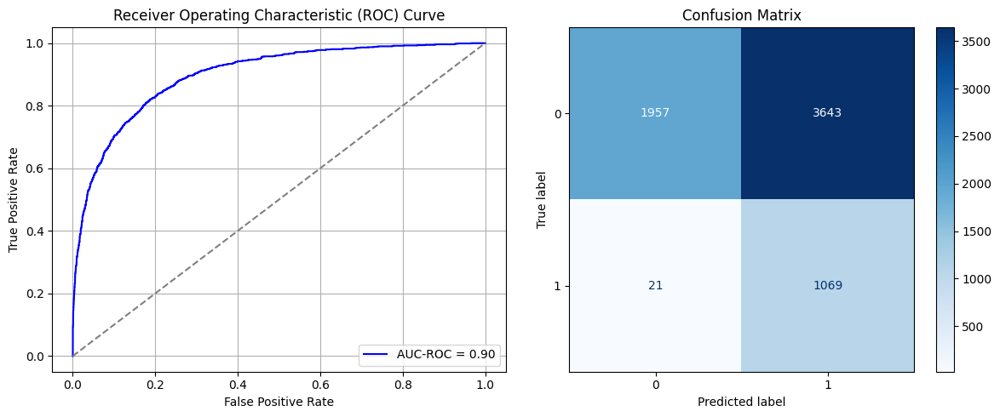

Best threshold based on F1-score: 0.9438278079032898
False Negative Rate: 0.01926605504587156
Time elapsed (performance): 0.7943012350006029
(np.float64(0.6505357142857143), np.float64(0.34946428571428567))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6500 - loss: 0.6615 - val_AUC: 0.7385 - val_loss: 0.6087
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7592 - loss: 0.5902 - val_AUC: 0.8225 - val_loss: 0.5768
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8234 - loss: 0.5299 - val_AUC: 0.8558 - val_loss: 0.4966
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8507 - loss: 0.4879 - val_AUC: 0.8805 - val_loss: 0.4639
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8719 - loss: 0.4527 - val_AUC: 0.8973 - val_loss: 0.4308
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4287 - val_AUC: 0.8995 - val_loss: 0.4100
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8975 - loss: 0.4082 - val_AUC: 0.9134 - val_loss: 0.3841
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9091 - loss: 0.3860 - val_AUC: 0.9208 - val_loss: 0.3689
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9175 -

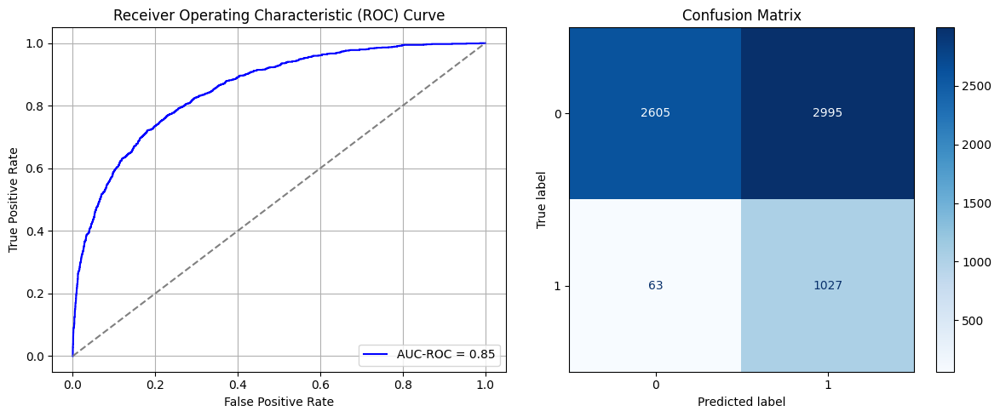

Best threshold based on F1-score: 0.9256109595298767
False Negative Rate: 0.05779816513761468
Time elapsed (performance): 1.2072170589999587
(np.float64(0.5348214285714286), np.float64(0.46517857142857144))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6214 - loss: 0.6726 - val_AUC: 0.7497 - val_loss: 0.6106
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7473 - loss: 0.6017 - val_AUC: 0.8257 - val_loss: 0.5343
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8199 - loss: 0.5308 - val_AUC: 0.8606 - val_loss: 0.4848
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8536 - loss: 0.4849 - val_AUC: 0.8850 - val_loss: 0.4472
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8590 - loss: 0.4698 - val_AUC: 0.8990 - val_loss: 0.4558
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8900 - loss: 0.4278 - val_AUC: 0.9097 - val_loss: 0.3948
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8959 - loss: 0.4128 - val_AUC: 0.9172 - val_loss: 0.3752
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9095 - loss: 0.3864 - val_AUC: 0.9229 - val_loss: 0.3598
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9173 -

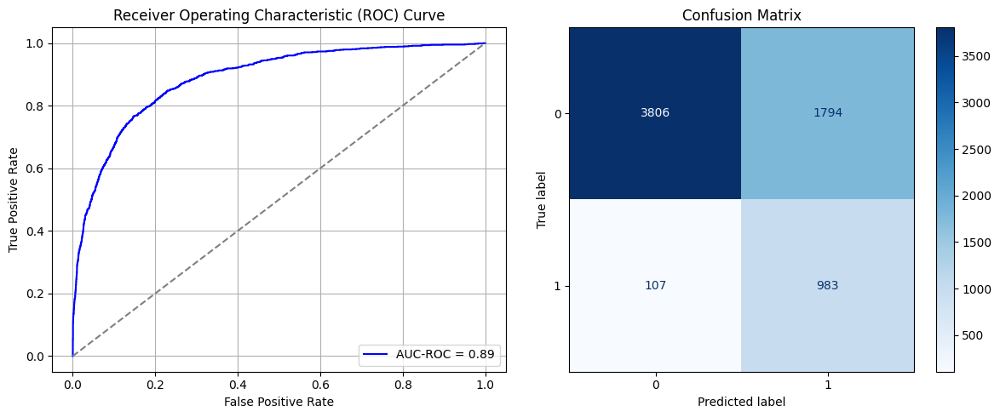

Best threshold based on F1-score: 0.7854412794113159
False Negative Rate: 0.0981651376146789
Time elapsed (performance): 0.8595267259988759
(np.float64(0.32035714285714284), np.float64(0.6796428571428572))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6569 - loss: 0.6604 - val_AUC: 0.7728 - val_loss: 0.5983
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7620 - loss: 0.5908 - val_AUC: 0.8350 - val_loss: 0.5245
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8191 - loss: 0.5277 - val_AUC: 0.8654 - val_loss: 0.4705
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8507 - loss: 0.4839 - val_AUC: 0.8885 - val_loss: 0.4347
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8722 - loss: 0.4510 - val_AUC: 0.9008 - val_loss: 0.4125
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4290 - val_AUC: 0.9109 - val_loss: 0.3926
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9043 - loss: 0.3960 - val_AUC: 0.9151 - val_loss: 0.3782
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9071 - loss: 0.3892 - val_AUC: 0.9245 - val_loss: 0.3850
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9064 -

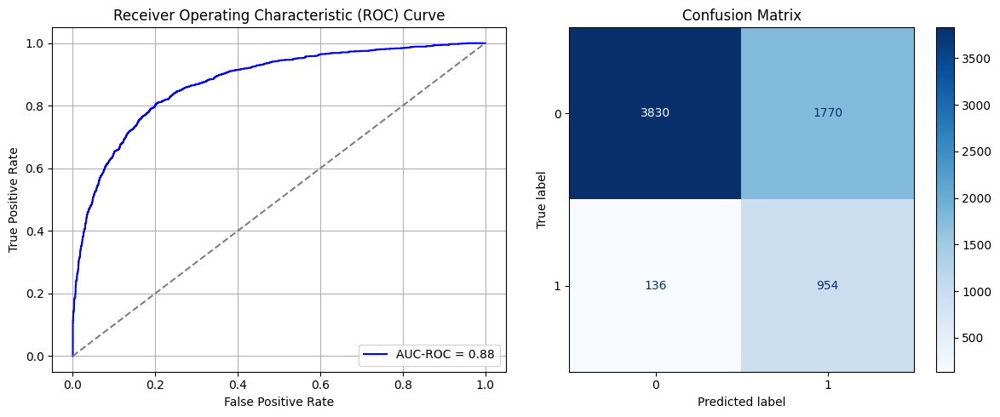

Best threshold based on F1-score: 0.7946220636367798
False Negative Rate: 0.12477064220183487
Time elapsed (performance): 0.8364160780001839
(np.float64(0.31607142857142856), np.float64(0.6839285714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6386 - loss: 0.6614 - val_AUC: 0.7804 - val_loss: 0.5935
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7721 - loss: 0.5772 - val_AUC: 0.8291 - val_loss: 0.5204
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8199 - loss: 0.5249 - val_AUC: 0.8613 - val_loss: 0.4801
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8501 - loss: 0.4831 - val_AUC: 0.8784 - val_loss: 0.4478
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8806 - loss: 0.4415 - val_AUC: 0.8891 - val_loss: 0.4255
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4233 - val_AUC: 0.9025 - val_loss: 0.4068
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9071 - loss: 0.3960 - val_AUC: 0.9083 - val_loss: 0.3895
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9138 - loss: 0.3793 - val_AUC: 0.9198 - val_loss: 0.3706
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9196 -

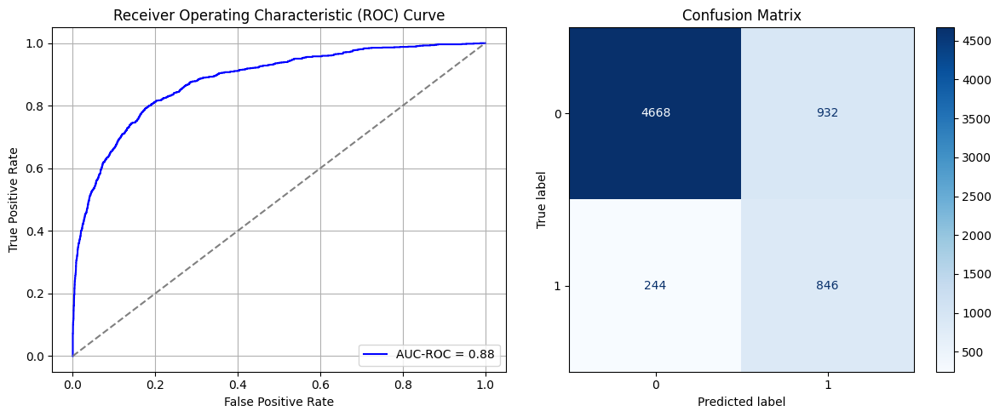

Best threshold based on F1-score: 0.6463902592658997
False Negative Rate: 0.22385321100917432
Time elapsed (performance): 0.8376649819983868
(np.float64(0.16642857142857143), np.float64(0.8335714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6349 - loss: 0.6679 - val_AUC: 0.7462 - val_loss: 0.6060
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7684 - loss: 0.5859 - val_AUC: 0.8370 - val_loss: 0.5202
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8332 - loss: 0.5150 - val_AUC: 0.8752 - val_loss: 0.4865
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8611 - loss: 0.4778 - val_AUC: 0.8847 - val_loss: 0.4403
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8778 - loss: 0.4471 - val_AUC: 0.8937 - val_loss: 0.4166
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8886 - loss: 0.4252 - val_AUC: 0.9103 - val_loss: 0.3916
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8957 - loss: 0.4089 - val_AUC: 0.9208 - val_loss: 0.3722
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9177 - loss: 0.3709 - val_AUC: 0.9264 - val_loss: 0.3587
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9168 -

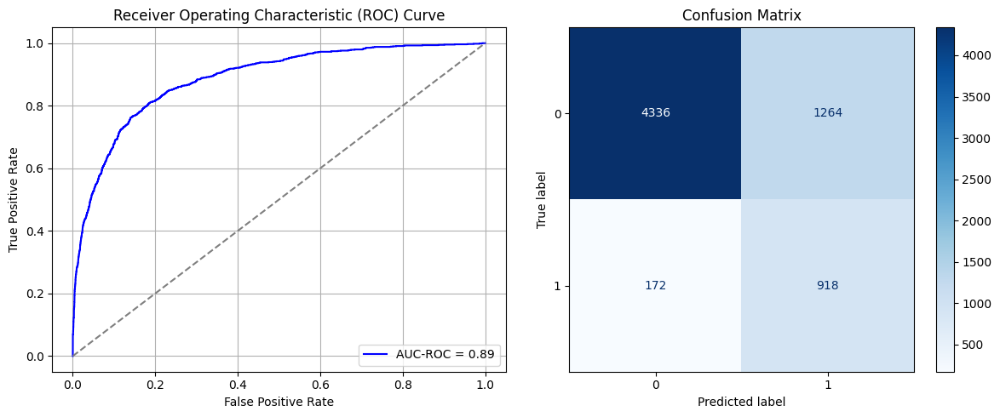

Best threshold based on F1-score: 0.6654042601585388
False Negative Rate: 0.1577981651376147
Time elapsed (performance): 1.0549203880000277
(np.float64(0.2257142857142857), np.float64(0.7742857142857142))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6446 - loss: 0.6626 - val_AUC: 0.7845 - val_loss: 0.5744
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7924 - loss: 0.5627 - val_AUC: 0.8508 - val_loss: 0.5097
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8347 - loss: 0.5119 - val_AUC: 0.8819 - val_loss: 0.4666
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8592 - loss: 0.4752 - val_AUC: 0.8982 - val_loss: 0.4293
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8860 - loss: 0.4336 - val_AUC: 0.9091 - val_loss: 0.4052
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9058 - loss: 0.3979 - val_AUC: 0.9212 - val_loss: 0.3804
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9118 - loss: 0.3868 - val_AUC: 0.9245 - val_loss: 0.3647
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9218 - loss: 0.3622 - val_AUC: 0.9316 - val_loss: 0.3632
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9205 -

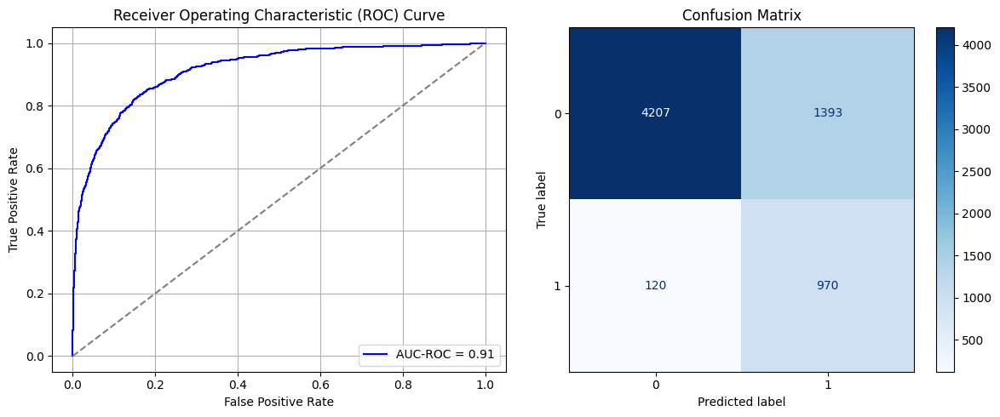

Best threshold based on F1-score: 0.8174657821655273
False Negative Rate: 0.11009174311926606
Time elapsed (performance): 1.1895439069994609
(np.float64(0.24875), np.float64(0.75125))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6130 - loss: 0.6713 - val_AUC: 0.7283 - val_loss: 0.6307
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7426 - loss: 0.6058 - val_AUC: 0.8171 - val_loss: 0.5497
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7990 - loss: 0.5534 - val_AUC: 0.8635 - val_loss: 0.5058
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8429 - loss: 0.4985 - val_AUC: 0.8791 - val_loss: 0.4564
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8676 - loss: 0.4624 - val_AUC: 0.8951 - val_loss: 0.4185
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8716 - loss: 0.4499 - val_AUC: 0.9058 - val_loss: 0.4540
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8879 - loss: 0.4259 - val_AUC: 0.9166 - val_loss: 0.3772
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8997 - loss: 0.4032 - val_AUC: 0.9254 - val_loss: 0.3658
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9162 -

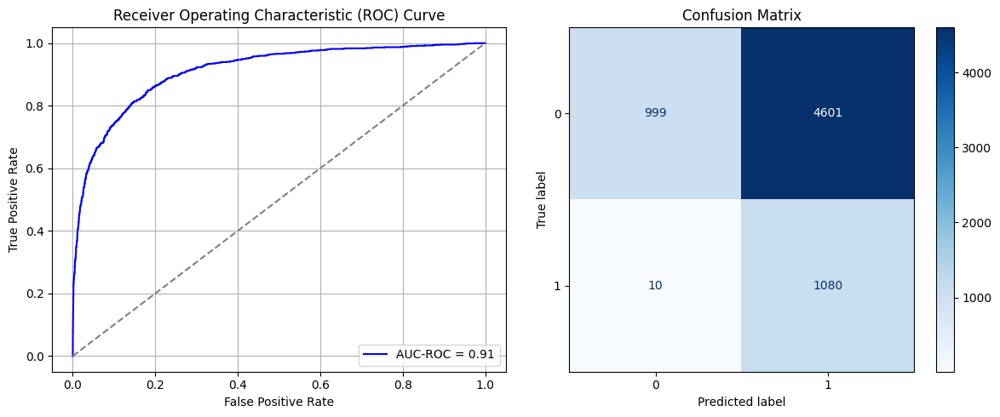

Best threshold based on F1-score: 0.964424729347229
False Negative Rate: 0.009174311926605505
Time elapsed (performance): 0.8315526810001757
(np.float64(0.8216071428571429), np.float64(0.17839285714285713))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6126 - loss: 0.6736 - val_AUC: 0.7574 - val_loss: 0.6132
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7570 - loss: 0.5969 - val_AUC: 0.8240 - val_loss: 0.5559
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8066 - loss: 0.5465 - val_AUC: 0.8602 - val_loss: 0.5000
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8495 - loss: 0.4927 - val_AUC: 0.8863 - val_loss: 0.4500
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8757 - loss: 0.4542 - val_AUC: 0.9015 - val_loss: 0.4154
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8920 - loss: 0.4232 - val_AUC: 0.9095 - val_loss: 0.4047
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9057 - loss: 0.3983 - val_AUC: 0.9146 - val_loss: 0.3774
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9108 - loss: 0.3854 - val_AUC: 0.9266 - val_loss: 0.4362
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9159 -

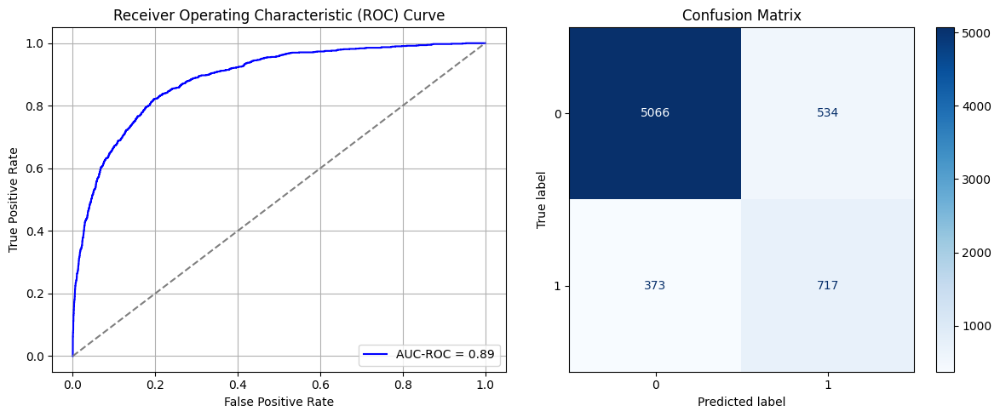

Best threshold based on F1-score: 0.5531824827194214
False Negative Rate: 0.3422018348623853
Time elapsed (performance): 1.0471502709988272
(np.float64(0.09535714285714286), np.float64(0.9046428571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6370 - loss: 0.6651 - val_AUC: 0.7417 - val_loss: 0.6031
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7661 - loss: 0.5849 - val_AUC: 0.8231 - val_loss: 0.5407
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8209 - loss: 0.5325 - val_AUC: 0.8475 - val_loss: 0.5158
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8536 - loss: 0.4835 - val_AUC: 0.8805 - val_loss: 0.4681
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8607 - loss: 0.4684 - val_AUC: 0.8925 - val_loss: 0.4325
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4408 - val_AUC: 0.9046 - val_loss: 0.4015
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8942 - loss: 0.4136 - val_AUC: 0.9137 - val_loss: 0.4055
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9084 - loss: 0.3912 - val_AUC: 0.9221 - val_loss: 0.3864
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9123 -

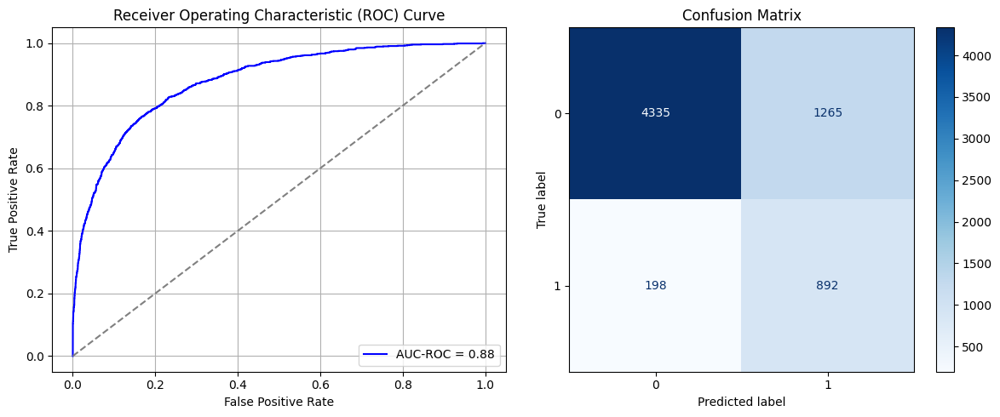

Best threshold based on F1-score: 0.7323341965675354
False Negative Rate: 0.181651376146789
Time elapsed (performance): 1.0675382039989927
(np.float64(0.22589285714285715), np.float64(0.7741071428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6220 - loss: 0.6671 - val_AUC: 0.7863 - val_loss: 0.5792
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7866 - loss: 0.5708 - val_AUC: 0.8323 - val_loss: 0.5481
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8318 - loss: 0.5146 - val_AUC: 0.8702 - val_loss: 0.4751
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8673 - loss: 0.4657 - val_AUC: 0.8880 - val_loss: 0.4324
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8910 - loss: 0.4245 - val_AUC: 0.9012 - val_loss: 0.4094
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9015 - loss: 0.4041 - val_AUC: 0.9070 - val_loss: 0.3908
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9113 - loss: 0.3841 - val_AUC: 0.9122 - val_loss: 0.3783
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9144 - loss: 0.3735 - val_AUC: 0.9198 - val_loss: 0.3706
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9226 -

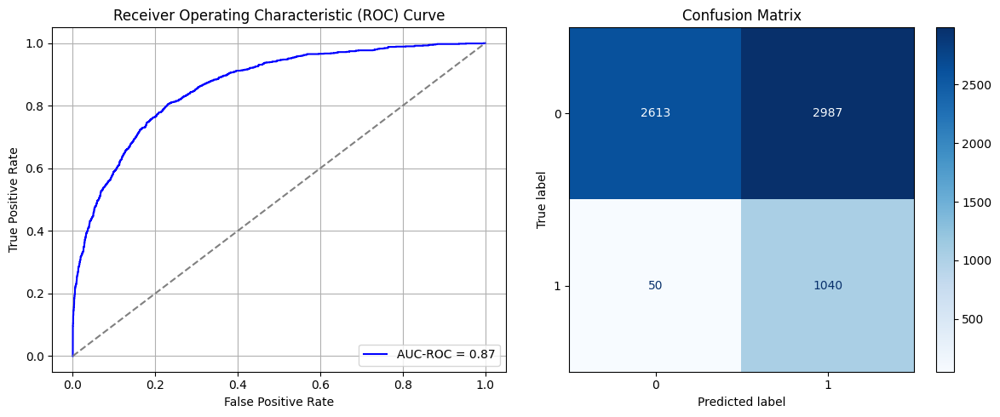

Best threshold based on F1-score: 0.8824530243873596
False Negative Rate: 0.045871559633027525
Time elapsed (performance): 1.04915518299822
(np.float64(0.5333928571428571), np.float64(0.4666071428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6071 - loss: 0.6697 - val_AUC: 0.7671 - val_loss: 0.6019
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7810 - loss: 0.5740 - val_AUC: 0.8292 - val_loss: 0.5303
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8299 - loss: 0.5186 - val_AUC: 0.8574 - val_loss: 0.4871
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8598 - loss: 0.4759 - val_AUC: 0.8760 - val_loss: 0.4549
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4488 - val_AUC: 0.8807 - val_loss: 0.4446
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8827 - loss: 0.4330 - val_AUC: 0.8915 - val_loss: 0.4232
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8883 - loss: 0.4225 - val_AUC: 0.8964 - val_loss: 0.4170
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9031 - loss: 0.3951 - val_AUC: 0.9015 - val_loss: 0.4063
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9029 -

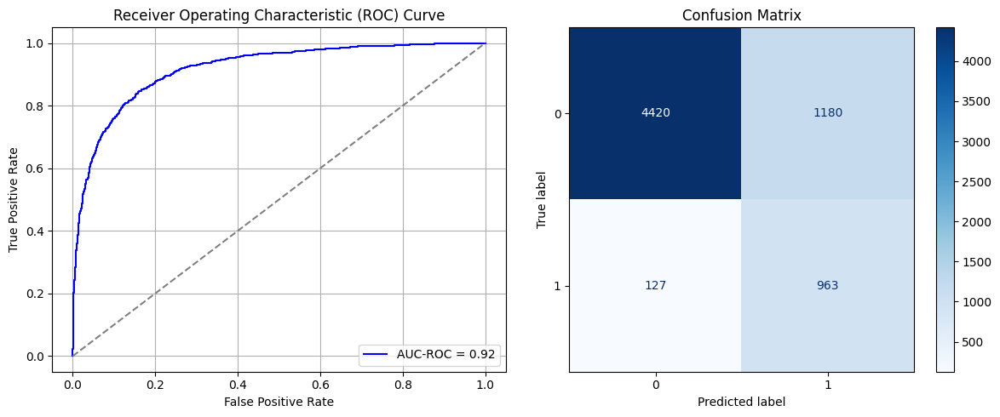

Best threshold based on F1-score: 0.7422698140144348
False Negative Rate: 0.11651376146788991
Time elapsed (performance): 0.8410456660021737
(np.float64(0.21071428571428572), np.float64(0.7892857142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6513 - loss: 0.6599 - val_AUC: 0.7491 - val_loss: 0.6004
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7662 - loss: 0.5847 - val_AUC: 0.8055 - val_loss: 0.5445
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8234 - loss: 0.5266 - val_AUC: 0.8388 - val_loss: 0.5104
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8401 - loss: 0.4987 - val_AUC: 0.8596 - val_loss: 0.5148
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8635 - loss: 0.4638 - val_AUC: 0.8722 - val_loss: 0.4560
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4438 - val_AUC: 0.8827 - val_loss: 0.4381
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8882 - loss: 0.4247 - val_AUC: 0.8910 - val_loss: 0.4236
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8866 - loss: 0.4240 - val_AUC: 0.9012 - val_loss: 0.4044
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8956 -

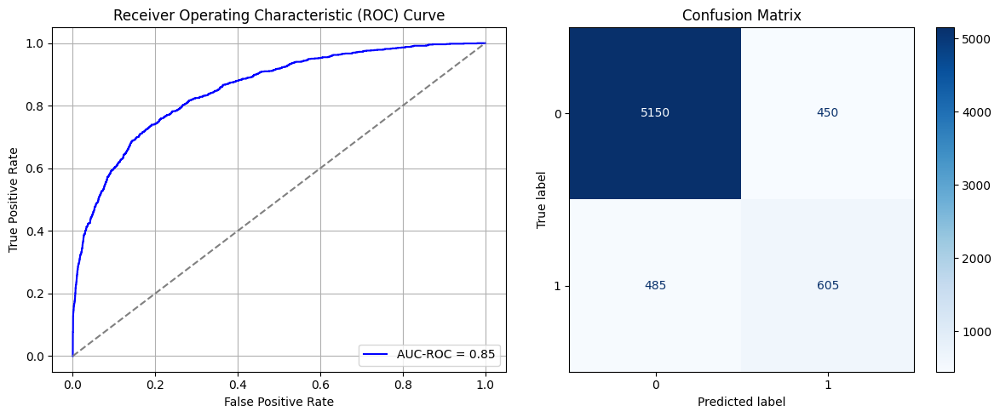

Best threshold based on F1-score: 0.46715059876441956
False Negative Rate: 0.44495412844036697
Time elapsed (performance): 1.1953531810031564
(np.float64(0.08035714285714286), np.float64(0.9196428571428571))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6344 - loss: 0.6645 - val_AUC: 0.7573 - val_loss: 0.6001
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7578 - loss: 0.5903 - val_AUC: 0.8358 - val_loss: 0.5198
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8179 - loss: 0.5298 - val_AUC: 0.8612 - val_loss: 0.4846
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8428 - loss: 0.4958 - val_AUC: 0.8755 - val_loss: 0.4625
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8506 - loss: 0.4838 - val_AUC: 0.8916 - val_loss: 0.4246
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4373 - val_AUC: 0.9092 - val_loss: 0.4211
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8933 - loss: 0.4179 - val_AUC: 0.9156 - val_loss: 0.3883
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9014 - loss: 0.4031 - val_AUC: 0.9223 - val_loss: 0.3663
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9129 -

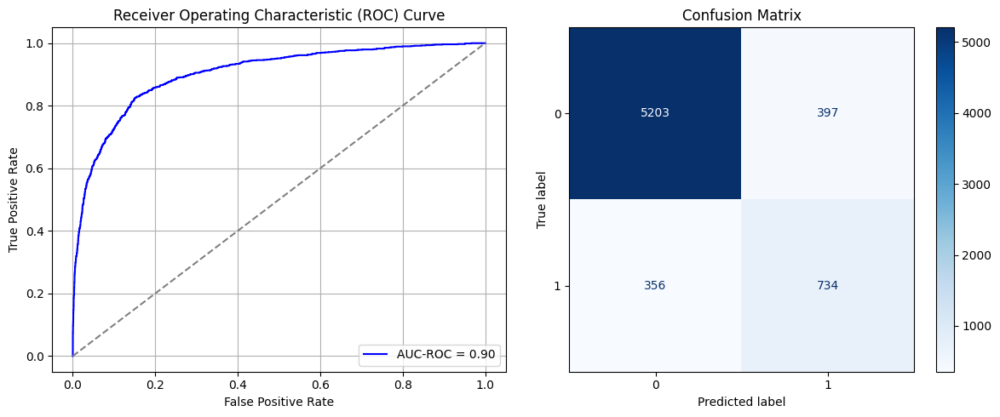

Best threshold based on F1-score: 0.5000100135803223
False Negative Rate: 0.326605504587156
Time elapsed (performance): 0.8249767839988635
(np.float64(0.07089285714285715), np.float64(0.9291071428571429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6548 - loss: 0.6593 - val_AUC: 0.7982 - val_loss: 0.5744
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7846 - loss: 0.5725 - val_AUC: 0.8534 - val_loss: 0.5071
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8095 - loss: 0.5389 - val_AUC: 0.8690 - val_loss: 0.4680
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8482 - loss: 0.4889 - val_AUC: 0.8858 - val_loss: 0.4502
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8691 - loss: 0.4590 - val_AUC: 0.8924 - val_loss: 0.4243
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4453 - val_AUC: 0.9014 - val_loss: 0.4183
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8878 - loss: 0.4256 - val_AUC: 0.9122 - val_loss: 0.3918
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8984 - loss: 0.4064 - val_AUC: 0.9218 - val_loss: 0.3663
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9090 -

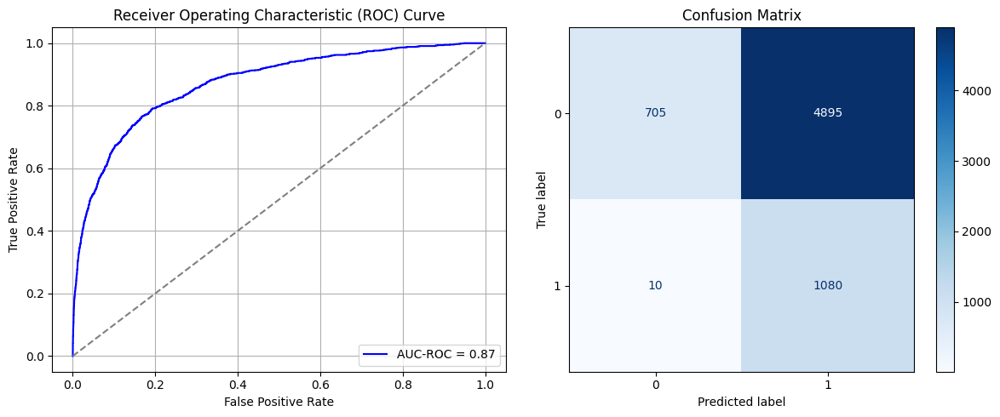

Best threshold based on F1-score: 0.9762806296348572
False Negative Rate: 0.009174311926605505
Time elapsed (performance): 0.8245127029986179
(np.float64(0.8741071428571429), np.float64(0.12589285714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6877 - loss: 0.6487 - val_AUC: 0.7919 - val_loss: 0.5700
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7969 - loss: 0.5620 - val_AUC: 0.8513 - val_loss: 0.5093
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8389 - loss: 0.5060 - val_AUC: 0.8763 - val_loss: 0.4908
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8563 - loss: 0.4767 - val_AUC: 0.8866 - val_loss: 0.4356
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8947 - loss: 0.4199 - val_AUC: 0.9013 - val_loss: 0.4107
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9012 - loss: 0.4055 - val_AUC: 0.9128 - val_loss: 0.3885
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9065 - loss: 0.3935 - val_AUC: 0.9211 - val_loss: 0.3689
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9111 - loss: 0.3811 - val_AUC: 0.9283 - val_loss: 0.3529
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9246 -

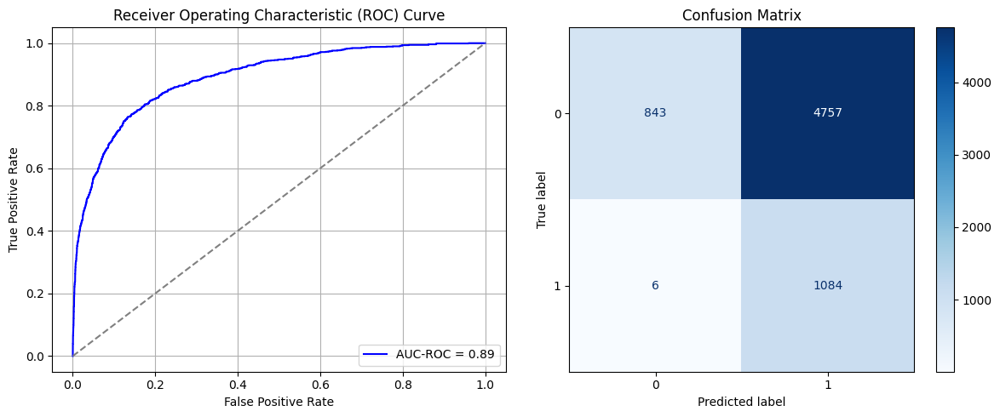

Best threshold based on F1-score: 0.9745112657546997
False Negative Rate: 0.005504587155963303
Time elapsed (performance): 0.8403067380022549
(np.float64(0.8494642857142857), np.float64(0.15053571428571433))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6266 - loss: 0.6686 - val_AUC: 0.7560 - val_loss: 0.6016
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7796 - loss: 0.5805 - val_AUC: 0.8483 - val_loss: 0.5240
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8361 - loss: 0.5192 - val_AUC: 0.8771 - val_loss: 0.4625
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8645 - loss: 0.4736 - val_AUC: 0.8989 - val_loss: 0.4332
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8910 - loss: 0.4309 - val_AUC: 0.9050 - val_loss: 0.4729
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9001 - loss: 0.4100 - val_AUC: 0.9140 - val_loss: 0.3981
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9134 - loss: 0.3831 - val_AUC: 0.9254 - val_loss: 0.3772
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9317 - loss: 0.3474 - val_AUC: 0.9312 - val_loss: 0.3753
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9359 -

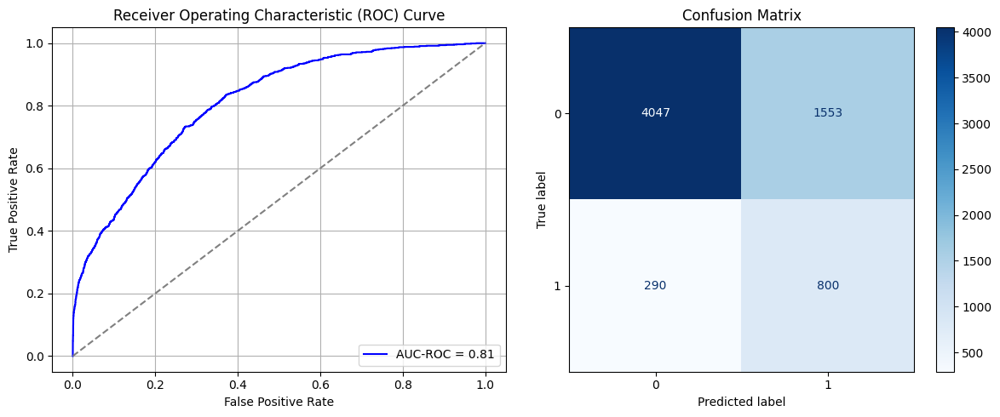

Best threshold based on F1-score: 0.5828233957290649
False Negative Rate: 0.26605504587155965
Time elapsed (performance): 1.0546430559988949
(np.float64(0.27732142857142855), np.float64(0.7226785714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6601 - loss: 0.6630 - val_AUC: 0.7800 - val_loss: 0.5978
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7678 - loss: 0.5830 - val_AUC: 0.8392 - val_loss: 0.5179
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8289 - loss: 0.5191 - val_AUC: 0.8745 - val_loss: 0.4747
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8523 - loss: 0.4844 - val_AUC: 0.8845 - val_loss: 0.4428
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8625 - loss: 0.4656 - val_AUC: 0.8968 - val_loss: 0.4837
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8773 - loss: 0.4407 - val_AUC: 0.9098 - val_loss: 0.4037
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8929 - loss: 0.4177 - val_AUC: 0.9178 - val_loss: 0.3810
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9040 - loss: 0.3975 - val_AUC: 0.9235 - val_loss: 0.3854
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9167 -

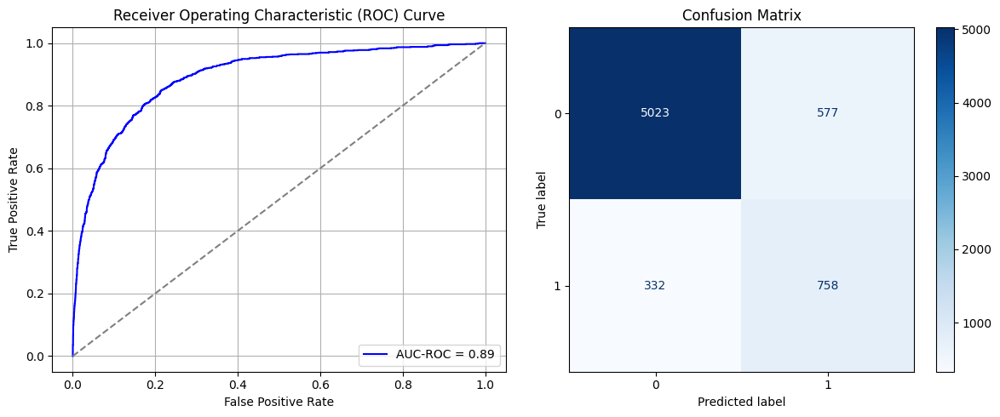

Best threshold based on F1-score: 0.5413645505905151
False Negative Rate: 0.30458715596330277
Time elapsed (performance): 1.036088998997002
(np.float64(0.10303571428571429), np.float64(0.8969642857142857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6148 - loss: 0.6780 - val_AUC: 0.7493 - val_loss: 0.6261
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7585 - loss: 0.5938 - val_AUC: 0.8080 - val_loss: 0.5468
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8269 - loss: 0.5261 - val_AUC: 0.8621 - val_loss: 0.4860
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8611 - loss: 0.4775 - val_AUC: 0.8845 - val_loss: 0.4460
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4533 - val_AUC: 0.8970 - val_loss: 0.4247
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4341 - val_AUC: 0.9095 - val_loss: 0.3949
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8986 - loss: 0.4057 - val_AUC: 0.9108 - val_loss: 0.3878
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9067 - loss: 0.3926 - val_AUC: 0.9218 - val_loss: 0.3690
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9162 -

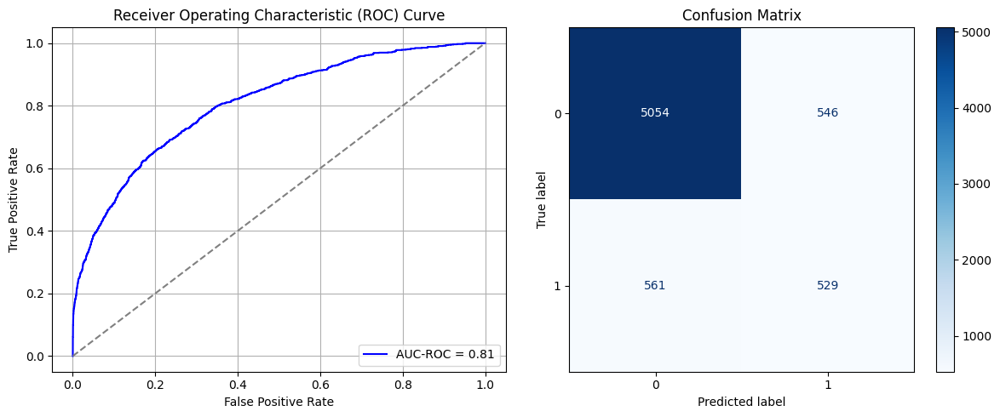

Best threshold based on F1-score: 0.40298449993133545
False Negative Rate: 0.5146788990825688
Time elapsed (performance): 1.0531821149997995
(np.float64(0.0975), np.float64(0.9025))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6235 - loss: 0.6735 - val_AUC: 0.7645 - val_loss: 0.6061
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7677 - loss: 0.5908 - val_AUC: 0.8335 - val_loss: 0.5325
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8269 - loss: 0.5221 - val_AUC: 0.8678 - val_loss: 0.4757
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8511 - loss: 0.4848 - val_AUC: 0.8831 - val_loss: 0.4662
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8715 - loss: 0.4527 - val_AUC: 0.8983 - val_loss: 0.4195
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8889 - loss: 0.4242 - val_AUC: 0.9099 - val_loss: 0.4028
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8936 - loss: 0.4156 - val_AUC: 0.9162 - val_loss: 0.4016
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9032 - loss: 0.3994 - val_AUC: 0.9257 - val_loss: 0.3583
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9104 -

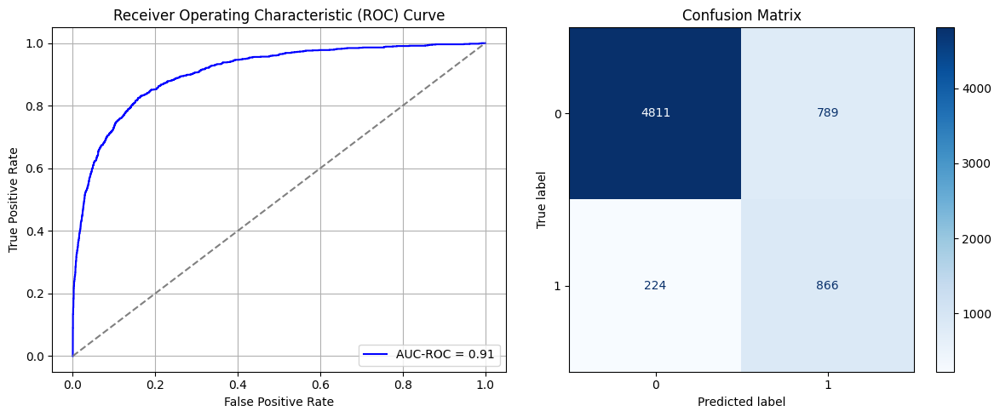

Best threshold based on F1-score: 0.6561943888664246
False Negative Rate: 0.20550458715596331
Time elapsed (performance): 1.2042670590017224
(np.float64(0.14089285714285715), np.float64(0.8591071428571428))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.5978 - loss: 0.6775 - val_AUC: 0.7464 - val_loss: 0.6083
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7708 - loss: 0.5870 - val_AUC: 0.8177 - val_loss: 0.5397
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8196 - loss: 0.5291 - val_AUC: 0.8519 - val_loss: 0.5117
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8528 - loss: 0.4870 - val_AUC: 0.8765 - val_loss: 0.4618
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4544 - val_AUC: 0.8853 - val_loss: 0.4448
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8857 - loss: 0.4325 - val_AUC: 0.8966 - val_loss: 0.4169
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8922 - loss: 0.4169 - val_AUC: 0.9063 - val_loss: 0.4057
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9036 - loss: 0.3959 - val_AUC: 0.9157 - val_loss: 0.3987
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9065 -

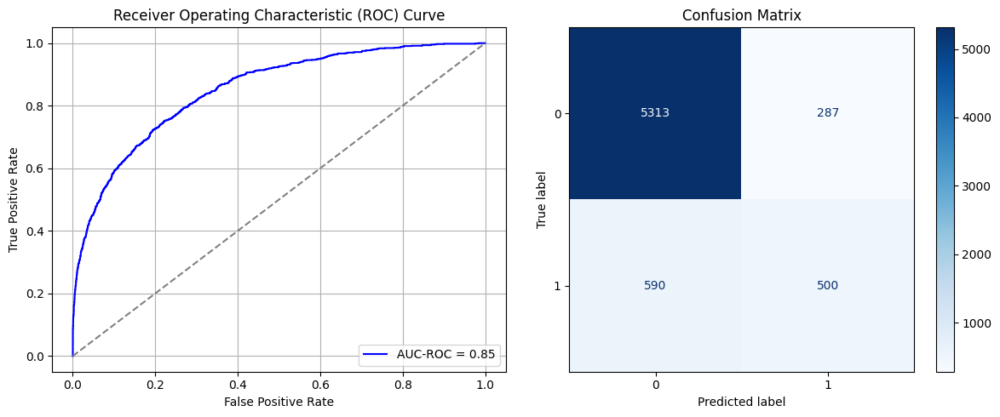

Best threshold based on F1-score: 0.36566296219825745
False Negative Rate: 0.5412844036697247
Time elapsed (performance): 1.2124290770007065
(np.float64(0.05125), np.float64(0.94875))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6199 - loss: 0.6729 - val_AUC: 0.7734 - val_loss: 0.5950
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7747 - loss: 0.5855 - val_AUC: 0.8384 - val_loss: 0.5372
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8288 - loss: 0.5218 - val_AUC: 0.8716 - val_loss: 0.4881
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8645 - loss: 0.4718 - val_AUC: 0.8928 - val_loss: 0.4327
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 - loss: 0.4398 - val_AUC: 0.9027 - val_loss: 0.4208
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.4243 - val_AUC: 0.9152 - val_loss: 0.3887
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9031 - loss: 0.4000 - val_AUC: 0.9190 - val_loss: 0.3853
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.9120 - loss: 0.3822 - val_AUC: 0.9227 - val_loss: 0.3745
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9178 -

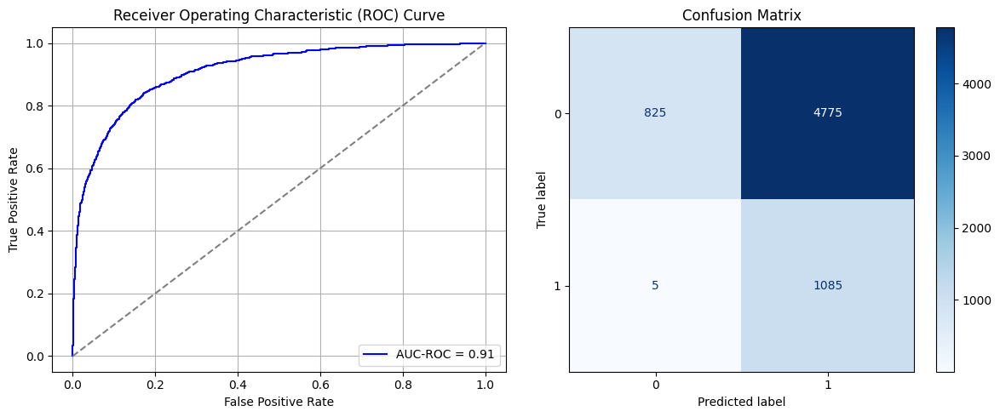

Best threshold based on F1-score: 0.9640597105026245
False Negative Rate: 0.0045871559633027525
Time elapsed (performance): 0.8105219270000816
(np.float64(0.8526785714285714), np.float64(0.1473214285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6472 - loss: 0.6641 - val_AUC: 0.7950 - val_loss: 0.5838
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7837 - loss: 0.5754 - val_AUC: 0.8510 - val_loss: 0.5124
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8304 - loss: 0.5195 - val_AUC: 0.8746 - val_loss: 0.4699
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8487 - loss: 0.4913 - val_AUC: 0.8875 - val_loss: 0.4506
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8609 - loss: 0.4701 - val_AUC: 0.9048 - val_loss: 0.4170
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4313 - val_AUC: 0.9150 - val_loss: 0.3853
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8990 - loss: 0.4074 - val_AUC: 0.9234 - val_loss: 0.3929
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9046 - loss: 0.3954 - val_AUC: 0.9282 - val_loss: 0.4020
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9152 -

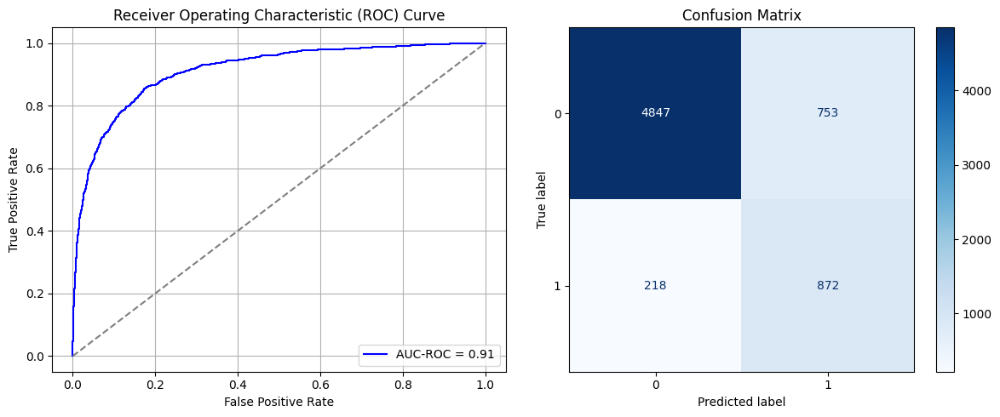

Best threshold based on F1-score: 0.6335211396217346
False Negative Rate: 0.2
Time elapsed (performance): 1.0240562129984028
(np.float64(0.1344642857142857), np.float64(0.8655357142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6463 - loss: 0.6642 - val_AUC: 0.7634 - val_loss: 0.6014
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7637 - loss: 0.5881 - val_AUC: 0.8314 - val_loss: 0.5418
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8156 - loss: 0.5360 - val_AUC: 0.8699 - val_loss: 0.4794
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8654 - loss: 0.4733 - val_AUC: 0.8832 - val_loss: 0.4612
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8769 - loss: 0.4499 - val_AUC: 0.8935 - val_loss: 0.4211
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8922 - loss: 0.4193 - val_AUC: 0.9040 - val_loss: 0.4064
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8998 - loss: 0.4059 - val_AUC: 0.9153 - val_loss: 0.4031
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8988 - loss: 0.4037 - val_AUC: 0.9193 - val_loss: 0.3794
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9140 -

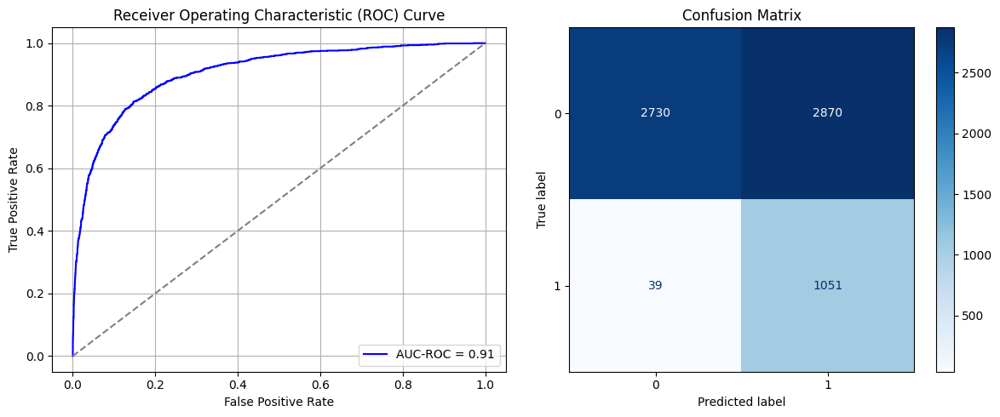

Best threshold based on F1-score: 0.8895952701568604
False Negative Rate: 0.03577981651376147
Time elapsed (performance): 1.0419773190005799
(np.float64(0.5125), np.float64(0.48750000000000004))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6333 - loss: 0.6632 - val_AUC: 0.7817 - val_loss: 0.5817
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7872 - loss: 0.5691 - val_AUC: 0.8543 - val_loss: 0.5163
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8457 - loss: 0.5021 - val_AUC: 0.8791 - val_loss: 0.4603
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8711 - loss: 0.4608 - val_AUC: 0.8931 - val_loss: 0.4300
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8939 - loss: 0.4210 - val_AUC: 0.9059 - val_loss: 0.4118
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9066 - loss: 0.3959 - val_AUC: 0.9152 - val_loss: 0.3922
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9070 - loss: 0.3904 - val_AUC: 0.9267 - val_loss: 0.3557
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9170 - loss: 0.3706 - val_AUC: 0.9272 - val_loss: 0.3544
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9298 -

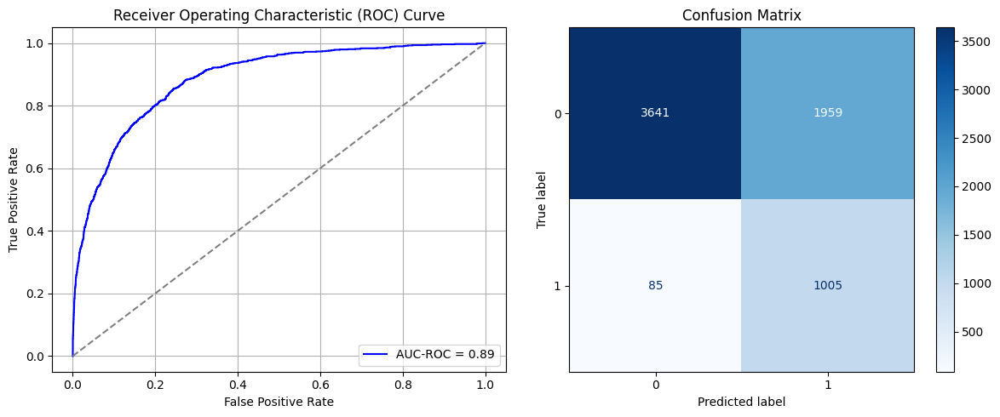

Best threshold based on F1-score: 0.7887577414512634
False Negative Rate: 0.0779816513761468
Time elapsed (performance): 1.0616337529972952
(np.float64(0.34982142857142856), np.float64(0.6501785714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6148 - loss: 0.6730 - val_AUC: 0.7209 - val_loss: 0.6273
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7470 - loss: 0.6047 - val_AUC: 0.7867 - val_loss: 0.5819
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8001 - loss: 0.5543 - val_AUC: 0.8466 - val_loss: 0.5159
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8442 - loss: 0.5029 - val_AUC: 0.8685 - val_loss: 0.4714
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8690 - loss: 0.4642 - val_AUC: 0.8790 - val_loss: 0.4783
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8781 - loss: 0.4444 - val_AUC: 0.8973 - val_loss: 0.4322
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8918 - loss: 0.4207 - val_AUC: 0.8963 - val_loss: 0.4160
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9073 - loss: 0.3917 - val_AUC: 0.9088 - val_loss: 0.3971
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9109 -

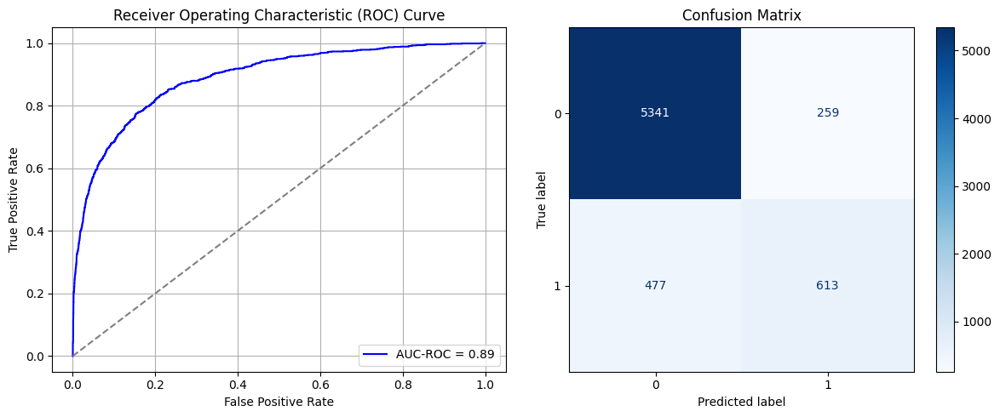

Best threshold based on F1-score: 0.44349509477615356
False Negative Rate: 0.43761467889908257
Time elapsed (performance): 1.0678656259988202
(np.float64(0.04625), np.float64(0.95375))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6383 - loss: 0.6674 - val_AUC: 0.7611 - val_loss: 0.6119
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7374 - loss: 0.6125 - val_AUC: 0.8225 - val_loss: 0.5510
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7825 - loss: 0.5676 - val_AUC: 0.8563 - val_loss: 0.5015
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8318 - loss: 0.5153 - val_AUC: 0.8828 - val_loss: 0.4509
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8542 - loss: 0.4793 - val_AUC: 0.8999 - val_loss: 0.4593
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8634 - loss: 0.4638 - val_AUC: 0.9037 - val_loss: 0.4027
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8939 - loss: 0.4150 - val_AUC: 0.9234 - val_loss: 0.3770
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9011 - loss: 0.4017 - val_AUC: 0.9286 - val_loss: 0.3547
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9209 -

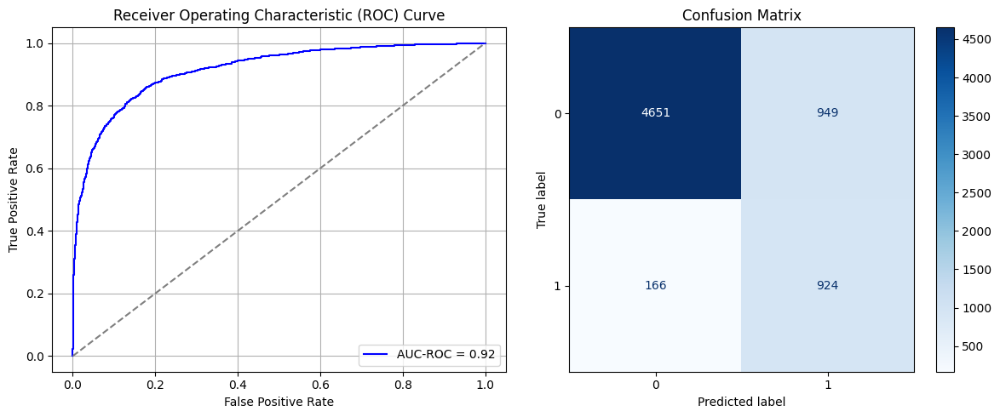

Best threshold based on F1-score: 0.739360511302948
False Negative Rate: 0.15229357798165138
Time elapsed (performance): 0.8834066910021647
(np.float64(0.1694642857142857), np.float64(0.8305357142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6465 - loss: 0.6627 - val_AUC: 0.7570 - val_loss: 0.6078
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7514 - loss: 0.5992 - val_AUC: 0.8348 - val_loss: 0.5780
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8111 - loss: 0.5426 - val_AUC: 0.8689 - val_loss: 0.4782
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8546 - loss: 0.4846 - val_AUC: 0.8848 - val_loss: 0.4426
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8658 - loss: 0.4604 - val_AUC: 0.8980 - val_loss: 0.4169
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8825 - loss: 0.4350 - val_AUC: 0.9078 - val_loss: 0.4143
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8916 - loss: 0.4169 - val_AUC: 0.9190 - val_loss: 0.3807
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9087 - loss: 0.3891 - val_AUC: 0.9237 - val_loss: 0.3704
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9194 -

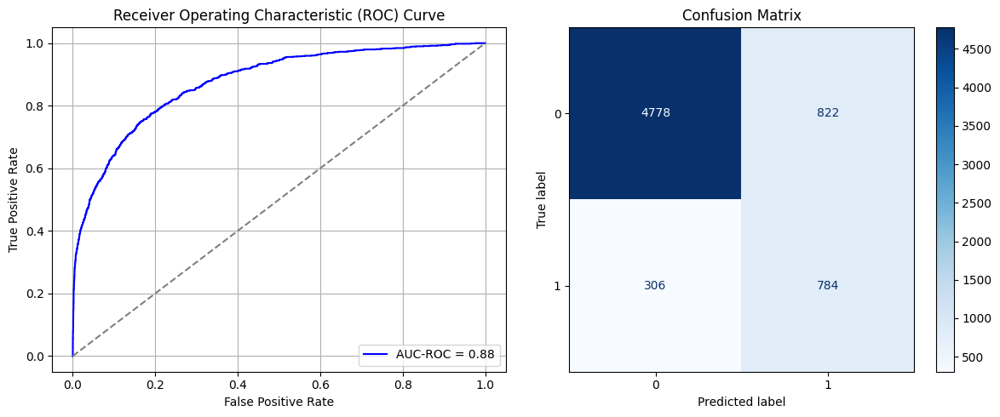

Best threshold based on F1-score: 0.6180169582366943
False Negative Rate: 0.28073394495412846
Time elapsed (performance): 0.888451390001137
(np.float64(0.1467857142857143), np.float64(0.8532142857142857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6400 - loss: 0.6720 - val_AUC: 0.7696 - val_loss: 0.6041
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7662 - loss: 0.5910 - val_AUC: 0.8296 - val_loss: 0.5364
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8210 - loss: 0.5335 - val_AUC: 0.8561 - val_loss: 0.4865
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8524 - loss: 0.4835 - val_AUC: 0.8818 - val_loss: 0.4507
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8748 - loss: 0.4505 - val_AUC: 0.8931 - val_loss: 0.4230
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8866 - loss: 0.4268 - val_AUC: 0.9001 - val_loss: 0.4103
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8932 - loss: 0.4148 - val_AUC: 0.9144 - val_loss: 0.3859
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9123 - loss: 0.3835 - val_AUC: 0.9231 - val_loss: 0.3731
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9138 -

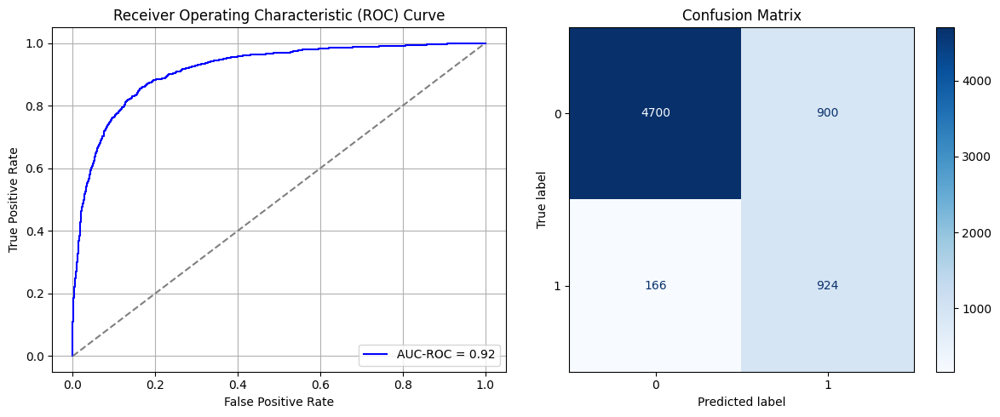

Best threshold based on F1-score: 0.6517845392227173
False Negative Rate: 0.15229357798165138
Time elapsed (performance): 1.0352481820009416
(np.float64(0.16071428571428573), np.float64(0.8392857142857143))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6365 - loss: 0.6662 - val_AUC: 0.7659 - val_loss: 0.5938
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7684 - loss: 0.5836 - val_AUC: 0.8378 - val_loss: 0.5281
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8274 - loss: 0.5198 - val_AUC: 0.8755 - val_loss: 0.4645
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8542 - loss: 0.4807 - val_AUC: 0.8917 - val_loss: 0.4282
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8915 - loss: 0.4275 - val_AUC: 0.9069 - val_loss: 0.4263
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8960 - loss: 0.4153 - val_AUC: 0.9105 - val_loss: 0.4193
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.9047 - loss: 0.3976 - val_AUC: 0.9169 - val_loss: 0.3722
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9225 - loss: 0.3599 - val_AUC: 0.9262 - val_loss: 0.3518
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9264 -

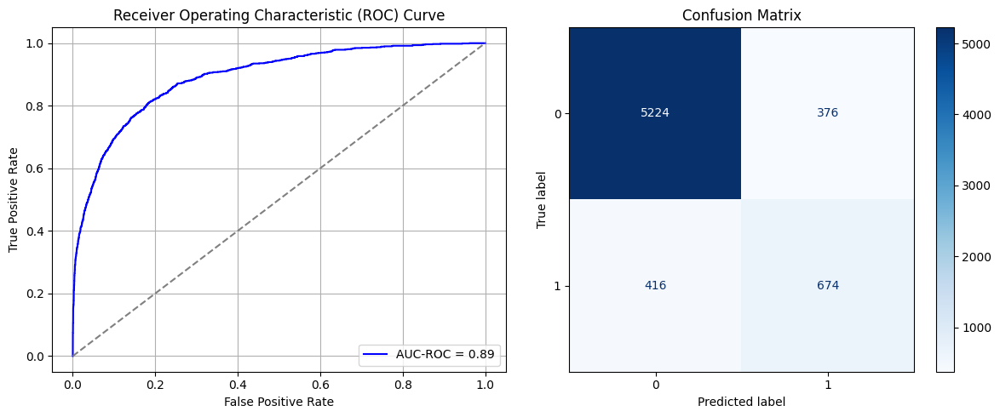

Best threshold based on F1-score: 0.47356271743774414
False Negative Rate: 0.381651376146789
Time elapsed (performance): 0.9279218970004877
(np.float64(0.06714285714285714), np.float64(0.9328571428571428))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6212 - loss: 0.6708 - val_AUC: 0.7237 - val_loss: 0.6382
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7551 - loss: 0.5988 - val_AUC: 0.8085 - val_loss: 0.5654
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8095 - loss: 0.5431 - val_AUC: 0.8478 - val_loss: 0.5039
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8467 - loss: 0.4925 - val_AUC: 0.8758 - val_loss: 0.4563
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8722 - loss: 0.4545 - val_AUC: 0.8939 - val_loss: 0.4262
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4298 - val_AUC: 0.9060 - val_loss: 0.4005
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9038 - loss: 0.3976 - val_AUC: 0.9088 - val_loss: 0.3917
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.9071 - loss: 0.3904 - val_AUC: 0.9190 - val_loss: 0.3692
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9118 -

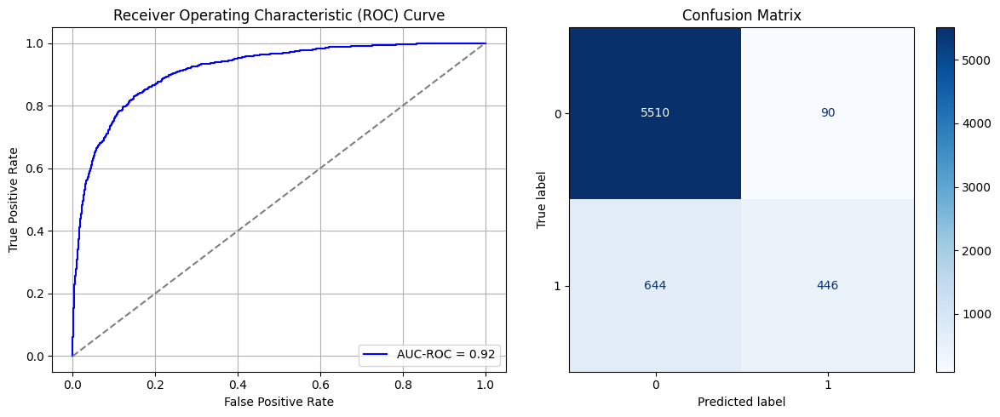

Best threshold based on F1-score: 0.30503788590431213
False Negative Rate: 0.5908256880733945
Time elapsed (performance): 0.8600058880001598
(np.float64(0.01607142857142857), np.float64(0.9839285714285715))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6393 - loss: 0.6663 - val_AUC: 0.7641 - val_loss: 0.5973
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7817 - loss: 0.5810 - val_AUC: 0.8301 - val_loss: 0.5231
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8297 - loss: 0.5177 - val_AUC: 0.8643 - val_loss: 0.4734
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8584 - loss: 0.4745 - val_AUC: 0.8743 - val_loss: 0.4509
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8698 - loss: 0.4541 - val_AUC: 0.8796 - val_loss: 0.4430
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4469 - val_AUC: 0.8878 - val_loss: 0.4358
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8820 - loss: 0.4335 - val_AUC: 0.8980 - val_loss: 0.4094
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8921 - loss: 0.4157 - val_AUC: 0.9027 - val_loss: 0.4005
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8991 -

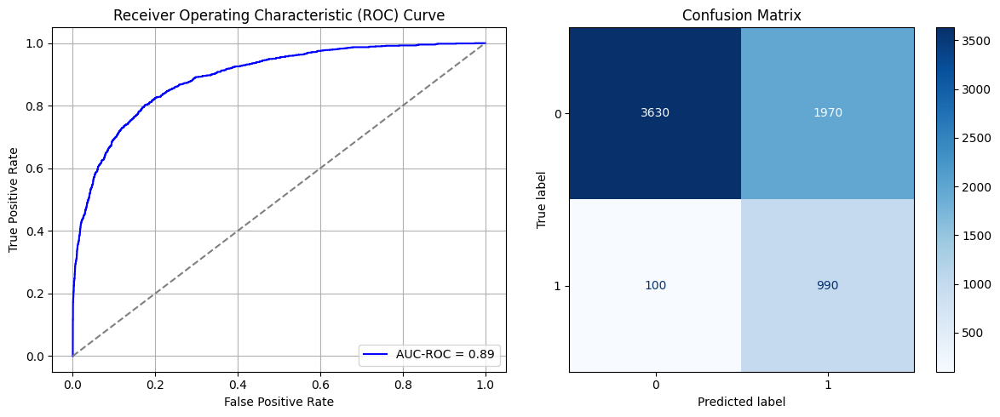

Best threshold based on F1-score: 0.7974966168403625
False Negative Rate: 0.09174311926605505
Time elapsed (performance): 0.9250584639994486
(np.float64(0.3517857142857143), np.float64(0.6482142857142856))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6164 - loss: 0.6734 - val_AUC: 0.7517 - val_loss: 0.6066
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7400 - loss: 0.6060 - val_AUC: 0.8172 - val_loss: 0.5457
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8057 - loss: 0.5478 - val_AUC: 0.8568 - val_loss: 0.5175
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8255 - loss: 0.5210 - val_AUC: 0.8809 - val_loss: 0.4536
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8570 - loss: 0.4758 - val_AUC: 0.8921 - val_loss: 0.4305
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8703 - loss: 0.4534 - val_AUC: 0.9045 - val_loss: 0.4117
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8788 - loss: 0.4396 - val_AUC: 0.9115 - val_loss: 0.3892
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4186 - val_AUC: 0.9198 - val_loss: 0.3806
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9084 -

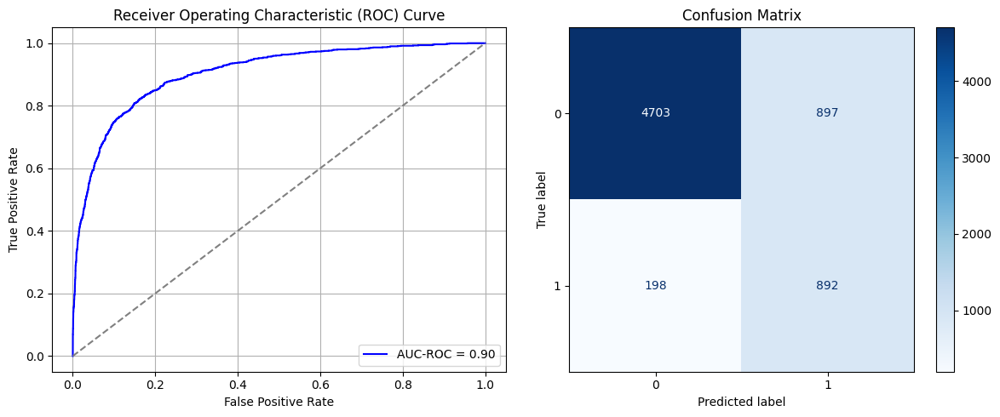

Best threshold based on F1-score: 0.6326277852058411
False Negative Rate: 0.181651376146789
Time elapsed (performance): 0.9015938619995723
(np.float64(0.16017857142857142), np.float64(0.8398214285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6533 - loss: 0.6621 - val_AUC: 0.7293 - val_loss: 0.6207
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7483 - loss: 0.6023 - val_AUC: 0.8226 - val_loss: 0.5498
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8100 - loss: 0.5422 - val_AUC: 0.8536 - val_loss: 0.5046
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8364 - loss: 0.5059 - val_AUC: 0.8684 - val_loss: 0.4815
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8574 - loss: 0.4744 - val_AUC: 0.8717 - val_loss: 0.4591
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8714 - loss: 0.4521 - val_AUC: 0.8827 - val_loss: 0.4600
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8777 - loss: 0.4413 - val_AUC: 0.8965 - val_loss: 0.4178
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8894 - loss: 0.4217 - val_AUC: 0.9037 - val_loss: 0.3986
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9069 -

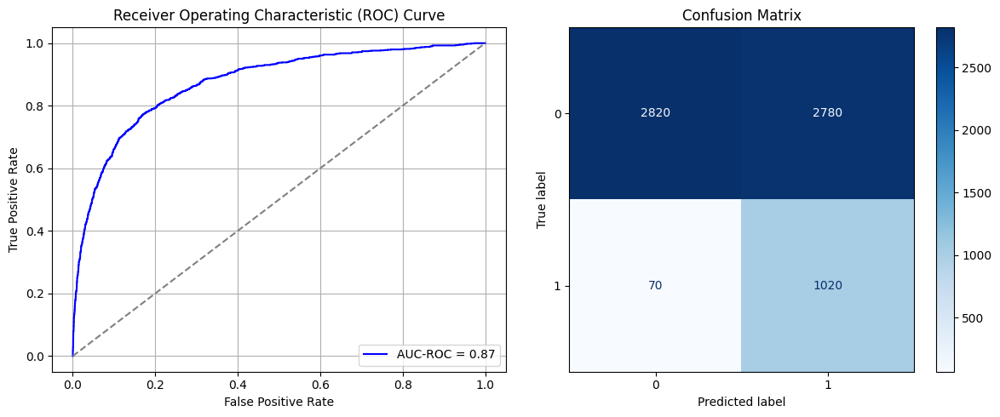

Best threshold based on F1-score: 0.8451285362243652
False Negative Rate: 0.06422018348623854
Time elapsed (performance): 0.950037937000161
(np.float64(0.49642857142857144), np.float64(0.5035714285714286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.6124 - loss: 0.6771 - val_AUC: 0.7467 - val_loss: 0.6115
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7649 - loss: 0.5931 - val_AUC: 0.8230 - val_loss: 0.5560
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8222 - loss: 0.5293 - val_AUC: 0.8608 - val_loss: 0.5138
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8512 - loss: 0.4878 - val_AUC: 0.8798 - val_loss: 0.4565
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8730 - loss: 0.4549 - val_AUC: 0.8876 - val_loss: 0.4438
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8854 - loss: 0.4327 - val_AUC: 0.9008 - val_loss: 0.4141
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8845 - loss: 0.4292 - val_AUC: 0.9113 - val_loss: 0.3871
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9075 - loss: 0.3902 - val_AUC: 0.9179 - val_loss: 0.3750
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9184 -

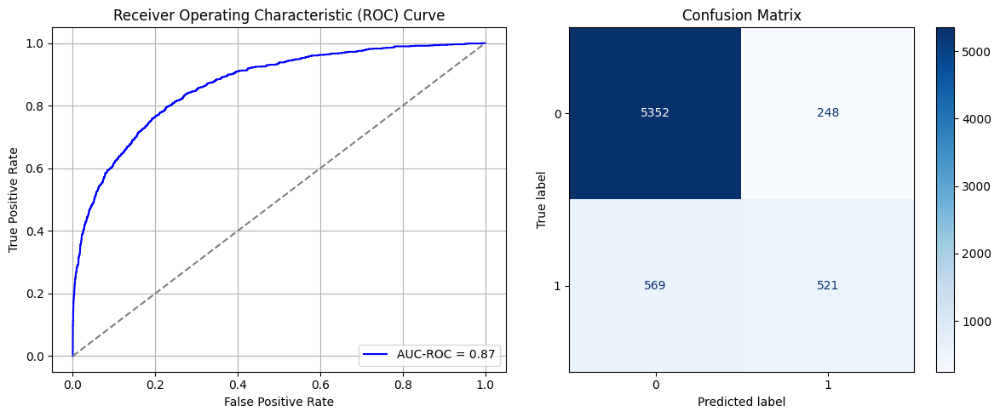

Best threshold based on F1-score: 0.39746978878974915
False Negative Rate: 0.5220183486238532
Time elapsed (performance): 0.910700963002455
(np.float64(0.04428571428571428), np.float64(0.9557142857142857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6362 - loss: 0.6650 - val_AUC: 0.7598 - val_loss: 0.5956
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7743 - loss: 0.5793 - val_AUC: 0.8272 - val_loss: 0.5277
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8349 - loss: 0.5133 - val_AUC: 0.8614 - val_loss: 0.4805
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8683 - loss: 0.4640 - val_AUC: 0.8847 - val_loss: 0.4413
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8818 - loss: 0.4393 - val_AUC: 0.8924 - val_loss: 0.4228
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8908 - loss: 0.4187 - val_AUC: 0.9048 - val_loss: 0.4241
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8905 - loss: 0.4169 - val_AUC: 0.9117 - val_loss: 0.4002
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9019 - loss: 0.3981 - val_AUC: 0.9185 - val_loss: 0.3690
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9151 -

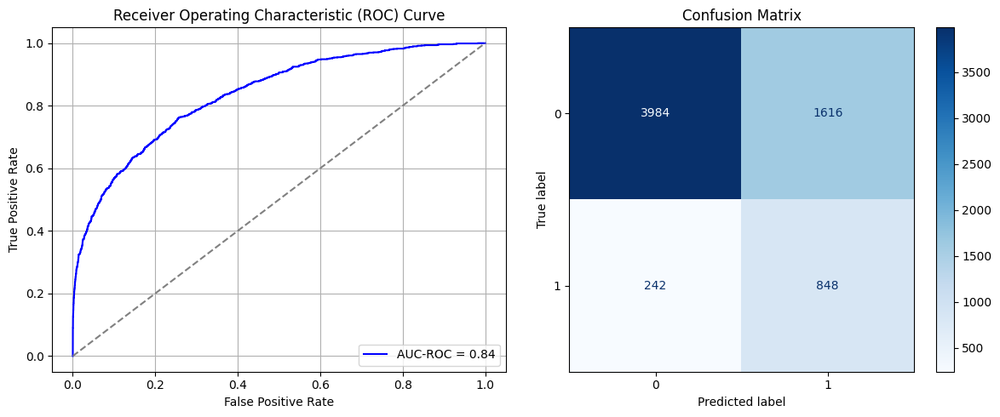

Best threshold based on F1-score: 0.8211633563041687
False Negative Rate: 0.22201834862385322
Time elapsed (performance): 1.1030382799981453
(np.float64(0.2885714285714286), np.float64(0.7114285714285714))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6745 - loss: 0.6599 - val_AUC: 0.7810 - val_loss: 0.6028
Epoch 2/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7722 - loss: 0.5912 - val_AUC: 0.8396 - val_loss: 0.5166
Epoch 3/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8375 - loss: 0.5121 - val_AUC: 0.8800 - val_loss: 0.4623
Epoch 4/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8584 - loss: 0.4761 - val_AUC: 0.8930 - val_loss: 0.4634
Epoch 5/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8809 - loss: 0.4423 - val_AUC: 0.8994 - val_loss: 0.4181
Epoch 6/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8927 - loss: 0.4195 - val_AUC: 0.9130 - val_loss: 0.3900
Epoch 7/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.9059 - loss: 0.3942 - val_AUC: 0.9157 - val_loss: 0.3816
Epoch 8/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9084 - loss: 0.3891 - val_AUC: 0.9251 - val_loss: 0.3598
Epoch 9/10
157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9208 -

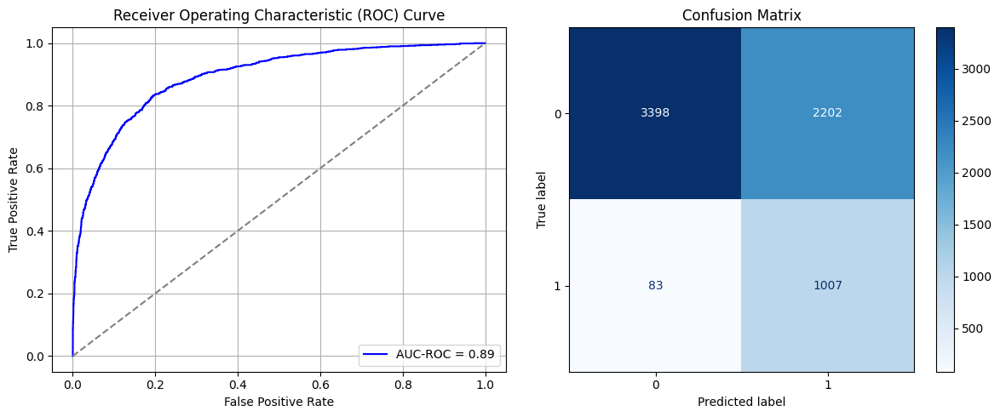

Best threshold based on F1-score: 0.8421215415000916
False Negative Rate: 0.07614678899082569
Time elapsed (performance): 1.0738374770007795
(np.float64(0.39321428571428574), np.float64(0.6067857142857143))
    Source time       FPR       TNR       FNR       TPR  Target time
0      9.509272  0.280536  0.719464  0.148624  0.851376     1.043096
1      9.730195  0.361429  0.638571  0.064220  0.935780     0.741502
2      9.108134  0.053214  0.946786  0.533028  0.466972     0.722051
3      7.976608  0.207321  0.792679  0.191743  0.808257     0.937479
4      8.862626  0.868929  0.131071  0.007339  0.992661     0.752554
5      8.661479  0.138750  0.861250  0.567890  0.432110     1.031739
6      9.637263  0.204464  0.795536  0.218349  0.781651     0.749449
7      9.177193  0.282857  0.717143  0.154128  0.845872     1.136725
8      7.757487  0.615893  0.384107  0.034862  0.965138     0.764791
9      8.691876  0.266250  0.733750  0.119266  0.880734     0.772630
10    10.332039  0.047679  0.95232

In [55]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

m = 10

k = oversample_size/undersample_size * m
print(k)

# np.random.seed(123)

for i in range(times):
    start = np.random.choice(int(k), 10)
    # print(start)

    Row = []

    Row = []

    for j in range(len(start)):
      for l in range(int(undersample_size/m)):
        row = start[j]+int(k*l)-1
        Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)

In [56]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.21051376146788991
Variance: 0.0314379230086109


In [57]:
print(ParamFit)
ParamFit.to_csv('Sy2_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      9.509272  0.280536  0.719464  0.148624  0.851376     1.043096
1      9.730195  0.361429  0.638571  0.064220  0.935780     0.741502
2      9.108134  0.053214  0.946786  0.533028  0.466972     0.722051
3      7.976608  0.207321  0.792679  0.191743  0.808257     0.937479
4      8.862626  0.868929  0.131071  0.007339  0.992661     0.752554
5      8.661479  0.138750  0.861250  0.567890  0.432110     1.031739
6      9.637263  0.204464  0.795536  0.218349  0.781651     0.749449
7      9.177193  0.282857  0.717143  0.154128  0.845872     1.136725
8      7.757487  0.615893  0.384107  0.034862  0.965138     0.764791
9      8.691876  0.266250  0.733750  0.119266  0.880734     0.772630
10    10.332039  0.047679  0.952321  0.590826  0.409174     1.021052
11     8.854868  0.125357  0.874643  0.253211  0.746789     4.283191
12     9.749132  0.472857  0.527143  0.065138  0.934862     1.055635
13     9.957090  0.650536  0.34946

# Random Oversampling (ROS):

## Simple Random Sampling with Replacement:

In this case, we investigate the effectiveness of Random Oversampling methods, beginning with Simple Random Sampling (SRS) with replacement. For this, we perform random resampling from the minority class of size $N_1$ to generate an additional sample of size $N_0-N_1$, such that the oversampled minority class will have the same size as the majority class.

In [59]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

3910
19400


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7404 - loss: 0.5989 - val_AUC: 0.8748 - val_loss: 0.4526
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8842 - loss: 0.4305 - val_AUC: 0.9248 - val_loss: 0.3590
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9315 - loss: 0.3401 - val_AUC: 0.9487 - val_loss: 0.3045
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9465 - loss: 0.2992 - val_AUC: 0.9592 - val_loss: 0.2859
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9589 - loss: 0.2621 - val_AUC: 0.9648 - val_loss: 0.2558
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9646 - loss: 0.2425 - val_AUC: 0.9696 - val_loss: 0.2532
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9690 - loss: 0.2269 - val_AUC: 0.9717 - val_loss: 0.2195
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9704 - loss: 0.2212 - val_AUC: 0.9735 - val_loss: 0.2220
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9729 -

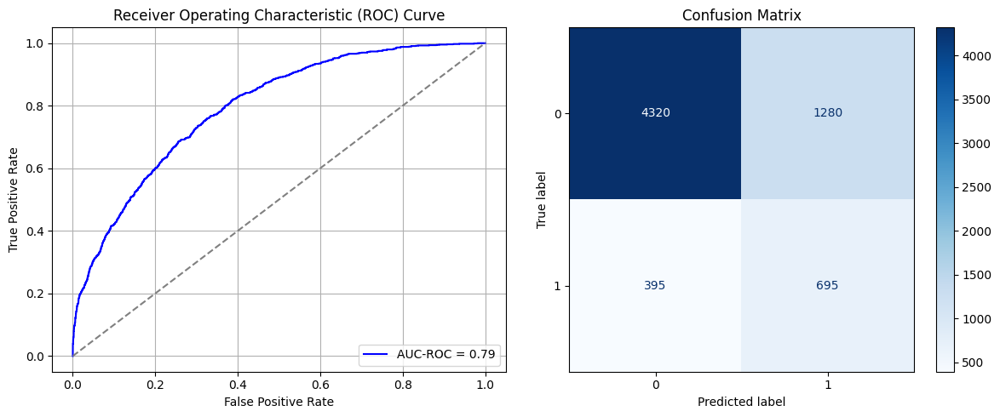

Best threshold based on F1-score: 0.6170361638069153
False Negative Rate: 0.3623853211009174
Time elapsed (performance): 0.8028289750000113
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7339 - loss: 0.5987 - val_AUC: 0.8997 - val_loss: 0.4225
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9008 - loss: 0.4018 - val_AUC: 0.9302 - val_loss: 0.3518
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9332 - loss: 0.3330 - val_AUC: 0.9489 - val_loss: 0.3109
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9480 - loss: 0.2946 - val_AUC: 0.9576 - val_loss: 0.2686
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9575 - loss: 0.2667 - val_AUC: 0.9622 - val_loss: 0.2534
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9617 - loss: 0.2525 - val_AUC: 0.9659 - val_loss: 0.2369
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9652 - loss: 0.2399 - val_AUC: 0.9648 - val_loss: 0.2422
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9696 - loss: 0.2247 - val_AUC: 0.9704 - val_loss: 0.2288
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9712 -

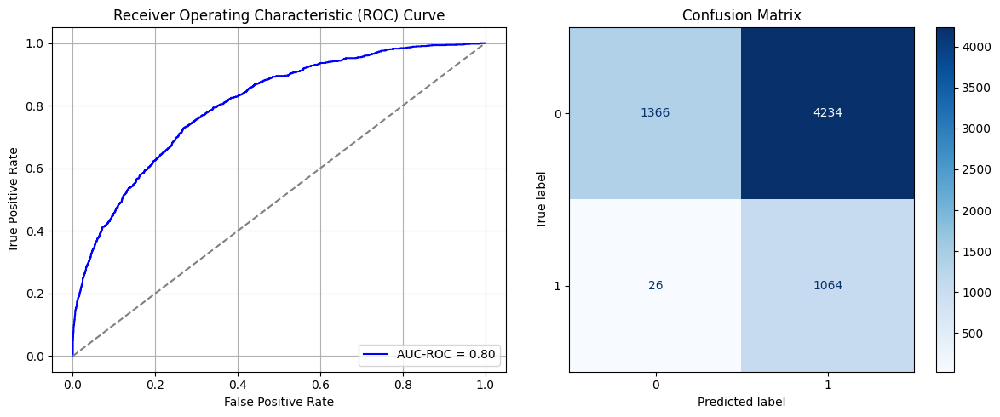

Best threshold based on F1-score: 0.9919381141662598
False Negative Rate: 0.023853211009174313
Time elapsed (performance): 1.061955837001733
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7454 - loss: 0.5978 - val_AUC: 0.9052 - val_loss: 0.4301
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9076 - loss: 0.3916 - val_AUC: 0.9400 - val_loss: 0.3577
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9398 - loss: 0.3176 - val_AUC: 0.9612 - val_loss: 0.2622
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9541 - loss: 0.2770 - val_AUC: 0.9664 - val_loss: 0.2422
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9633 - loss: 0.2472 - val_AUC: 0.9701 - val_loss: 0.2253
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9682 - loss: 0.2299 - val_AUC: 0.9693 - val_loss: 0.2478
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9713 - loss: 0.2172 - val_AUC: 0.9761 - val_loss: 0.2013
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9729 - loss: 0.2109 - val_AUC: 0.9740 - val_loss: 0.2145
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9744 -

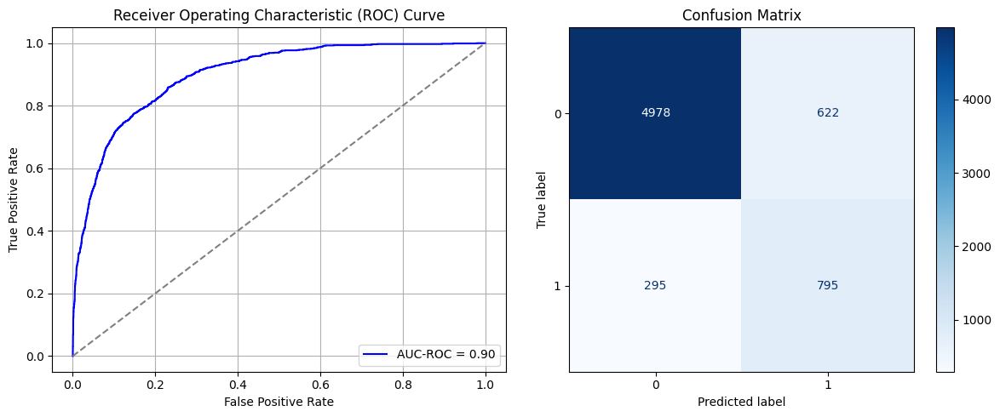

Best threshold based on F1-score: 0.6141468286514282
False Negative Rate: 0.2706422018348624
Time elapsed (performance): 0.7777046250012063
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7270 - loss: 0.6034 - val_AUC: 0.8907 - val_loss: 0.4293
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8924 - loss: 0.4169 - val_AUC: 0.9306 - val_loss: 0.3629
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9357 - loss: 0.3275 - val_AUC: 0.9513 - val_loss: 0.2881
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9528 - loss: 0.2824 - val_AUC: 0.9654 - val_loss: 0.2657
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9624 - loss: 0.2522 - val_AUC: 0.9694 - val_loss: 0.2301
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9682 - loss: 0.2314 - val_AUC: 0.9739 - val_loss: 0.2117
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9723 - loss: 0.2157 - val_AUC: 0.9766 - val_loss: 0.2001
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9727 - loss: 0.2133 - val_AUC: 0.9783 - val_loss: 0.2214
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9750 -

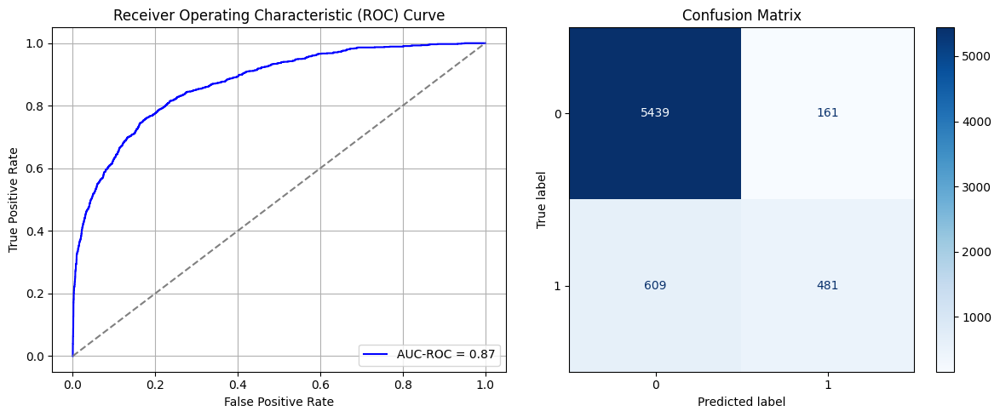

Best threshold based on F1-score: 0.22812344133853912
False Negative Rate: 0.5587155963302752
Time elapsed (performance): 1.0448834600028931
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7598 - loss: 0.5869 - val_AUC: 0.8963 - val_loss: 0.4229
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9024 - loss: 0.4009 - val_AUC: 0.9322 - val_loss: 0.3444
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9314 - loss: 0.3389 - val_AUC: 0.9495 - val_loss: 0.2977
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9480 - loss: 0.2955 - val_AUC: 0.9583 - val_loss: 0.2732
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9561 - loss: 0.2706 - val_AUC: 0.9659 - val_loss: 0.2406
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9594 - loss: 0.2590 - val_AUC: 0.9680 - val_loss: 0.2323
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9669 - loss: 0.2339 - val_AUC: 0.9710 - val_loss: 0.2412
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9669 - loss: 0.2331 - val_AUC: 0.9720 - val_loss: 0.2145
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9679 -

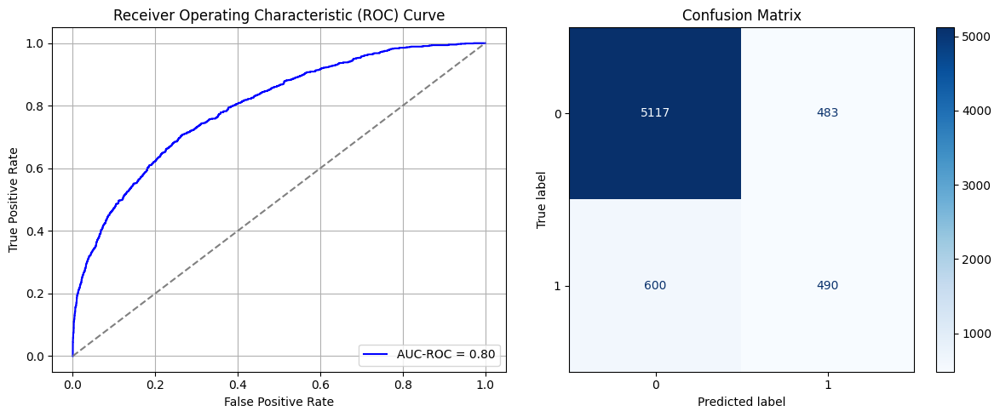

Best threshold based on F1-score: 0.4181007742881775
False Negative Rate: 0.5504587155963303
Time elapsed (performance): 1.0471696650020021
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7350 - loss: 0.6013 - val_AUC: 0.8954 - val_loss: 0.4266
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8977 - loss: 0.4114 - val_AUC: 0.9285 - val_loss: 0.3452
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9325 - loss: 0.3361 - val_AUC: 0.9532 - val_loss: 0.2839
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9498 - loss: 0.2904 - val_AUC: 0.9622 - val_loss: 0.2544
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9591 - loss: 0.2623 - val_AUC: 0.9684 - val_loss: 0.2332
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9669 - loss: 0.2365 - val_AUC: 0.9715 - val_loss: 0.2186
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9720 - loss: 0.2167 - val_AUC: 0.9734 - val_loss: 0.2225
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9729 - loss: 0.2128 - val_AUC: 0.9743 - val_loss: 0.2096
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9742 -

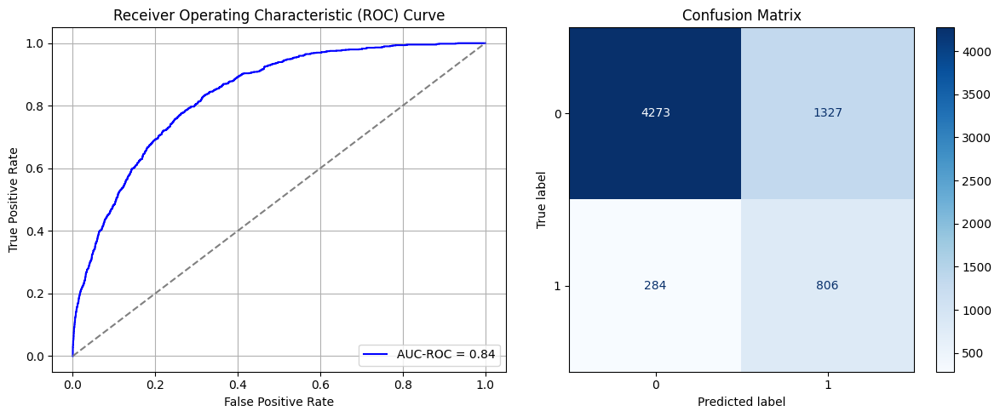

Best threshold based on F1-score: 0.6630001664161682
False Negative Rate: 0.26055045871559634
Time elapsed (performance): 0.9686725220017252
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7127 - loss: 0.6087 - val_AUC: 0.8804 - val_loss: 0.4473
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8915 - loss: 0.4196 - val_AUC: 0.9251 - val_loss: 0.3617
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9277 - loss: 0.3478 - val_AUC: 0.9461 - val_loss: 0.3176
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9466 - loss: 0.2990 - val_AUC: 0.9588 - val_loss: 0.2705
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9570 - loss: 0.2691 - val_AUC: 0.9641 - val_loss: 0.2482
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9628 - loss: 0.2489 - val_AUC: 0.9683 - val_loss: 0.2336
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9652 - loss: 0.2398 - val_AUC: 0.9705 - val_loss: 0.2217
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9693 - loss: 0.2254 - val_AUC: 0.9739 - val_loss: 0.2077
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9706 -

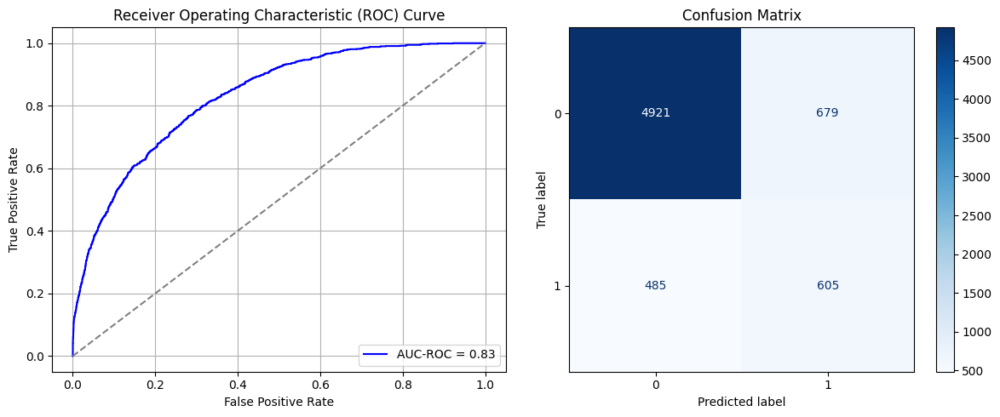

Best threshold based on F1-score: 0.4503408372402191
False Negative Rate: 0.44495412844036697
Time elapsed (performance): 1.0726925689996278
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7419 - loss: 0.5979 - val_AUC: 0.9002 - val_loss: 0.4124
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8990 - loss: 0.4060 - val_AUC: 0.9388 - val_loss: 0.3274
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9386 - loss: 0.3214 - val_AUC: 0.9536 - val_loss: 0.2891
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9510 - loss: 0.2858 - val_AUC: 0.9576 - val_loss: 0.2797
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9603 - loss: 0.2578 - val_AUC: 0.9682 - val_loss: 0.2397
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9661 - loss: 0.2374 - val_AUC: 0.9700 - val_loss: 0.2258
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9691 - loss: 0.2265 - val_AUC: 0.9744 - val_loss: 0.2047
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9713 - loss: 0.2174 - val_AUC: 0.9761 - val_loss: 0.2247
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9721 -

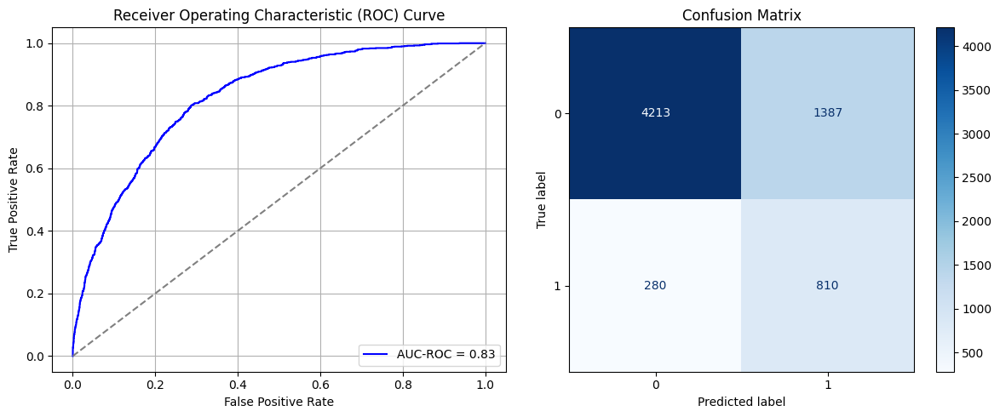

Best threshold based on F1-score: 0.7535301446914673
False Negative Rate: 0.25688073394495414
Time elapsed (performance): 1.0781249110004865
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7507 - loss: 0.5944 - val_AUC: 0.8946 - val_loss: 0.4292
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8945 - loss: 0.4138 - val_AUC: 0.9313 - val_loss: 0.3490
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9310 - loss: 0.3391 - val_AUC: 0.9483 - val_loss: 0.3753
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9436 - loss: 0.3064 - val_AUC: 0.9582 - val_loss: 0.3021
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9517 - loss: 0.2840 - val_AUC: 0.9635 - val_loss: 0.2473
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9587 - loss: 0.2622 - val_AUC: 0.9671 - val_loss: 0.2369
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9623 - loss: 0.2494 - val_AUC: 0.9694 - val_loss: 0.2300
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9658 - loss: 0.2375 - val_AUC: 0.9723 - val_loss: 0.2214
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9685 -

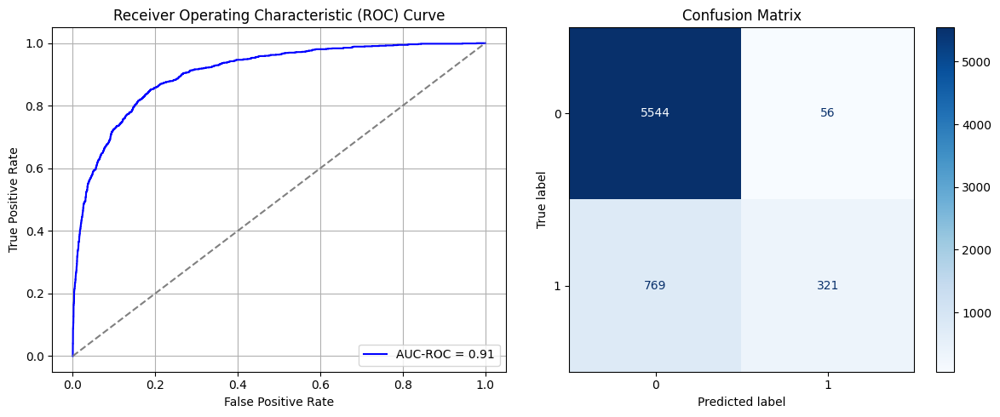

Best threshold based on F1-score: 0.030153634026646614
False Negative Rate: 0.7055045871559633
Time elapsed (performance): 1.042817980000109
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7570 - loss: 0.5849 - val_AUC: 0.8878 - val_loss: 0.4497
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8898 - loss: 0.4207 - val_AUC: 0.9308 - val_loss: 0.3530
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9279 - loss: 0.3464 - val_AUC: 0.9459 - val_loss: 0.3157
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9479 - loss: 0.2958 - val_AUC: 0.9542 - val_loss: 0.3089
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9554 - loss: 0.2728 - val_AUC: 0.9619 - val_loss: 0.2534
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9626 - loss: 0.2493 - val_AUC: 0.9685 - val_loss: 0.2375
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9640 - loss: 0.2439 - val_AUC: 0.9704 - val_loss: 0.2278
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9674 - loss: 0.2316 - val_AUC: 0.9739 - val_loss: 0.2106
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9691 -

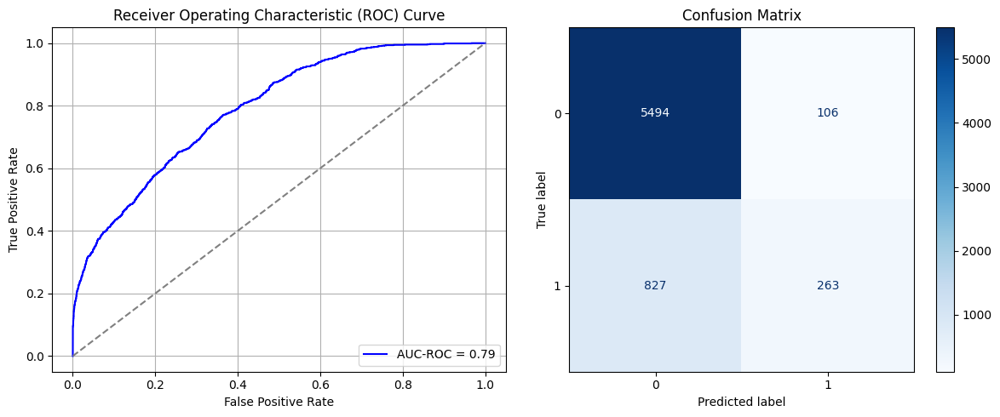

Best threshold based on F1-score: 0.05168715491890907
False Negative Rate: 0.7587155963302752
Time elapsed (performance): 0.8106954659997427
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6956 - loss: 0.6254 - val_AUC: 0.8804 - val_loss: 0.4484
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.4424 - val_AUC: 0.9226 - val_loss: 0.3777
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9257 - loss: 0.3523 - val_AUC: 0.9415 - val_loss: 0.3254
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9442 - loss: 0.3050 - val_AUC: 0.9523 - val_loss: 0.2863
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9536 - loss: 0.2778 - val_AUC: 0.9581 - val_loss: 0.2682
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9554 - loss: 0.2715 - val_AUC: 0.9636 - val_loss: 0.2565
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9642 - loss: 0.2443 - val_AUC: 0.9668 - val_loss: 0.2382
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9660 - loss: 0.2377 - val_AUC: 0.9704 - val_loss: 0.2267
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9688 -

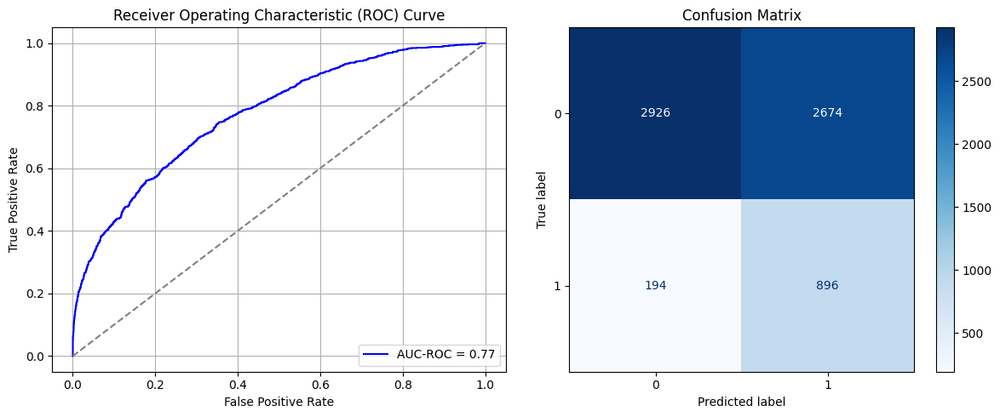

Best threshold based on F1-score: 0.8857700824737549
False Negative Rate: 0.1779816513761468
Time elapsed (performance): 1.070395793998614
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7487 - loss: 0.5939 - val_AUC: 0.8988 - val_loss: 0.4185
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9049 - loss: 0.3960 - val_AUC: 0.9407 - val_loss: 0.3521
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9361 - loss: 0.3269 - val_AUC: 0.9533 - val_loss: 0.2838
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9494 - loss: 0.2897 - val_AUC: 0.9658 - val_loss: 0.2425
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9588 - loss: 0.2601 - val_AUC: 0.9693 - val_loss: 0.2417
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9640 - loss: 0.2443 - val_AUC: 0.9722 - val_loss: 0.2221
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9709 - loss: 0.2198 - val_AUC: 0.9742 - val_loss: 0.2087
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9695 - loss: 0.2232 - val_AUC: 0.9758 - val_loss: 0.2033
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9730 -

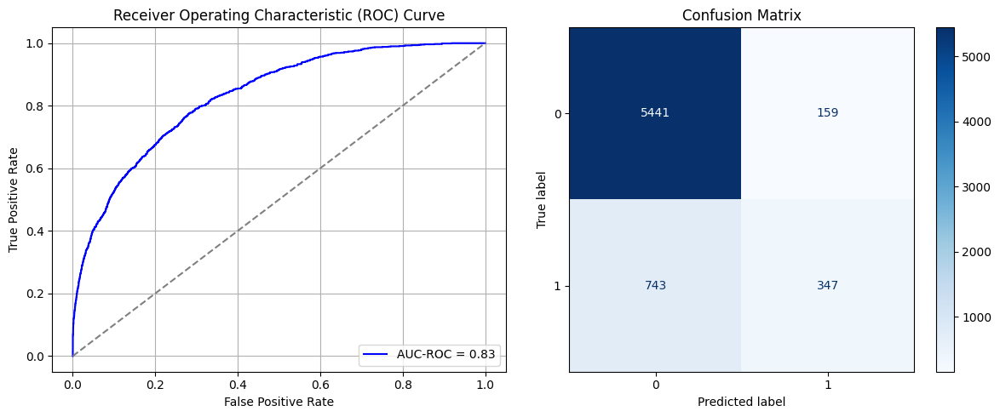

Best threshold based on F1-score: 0.13729071617126465
False Negative Rate: 0.681651376146789
Time elapsed (performance): 0.7693076070027018
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7391 - loss: 0.5952 - val_AUC: 0.8955 - val_loss: 0.4553
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9043 - loss: 0.3967 - val_AUC: 0.9368 - val_loss: 0.3292
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9379 - loss: 0.3214 - val_AUC: 0.9554 - val_loss: 0.2780
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9535 - loss: 0.2788 - val_AUC: 0.9630 - val_loss: 0.2517
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9610 - loss: 0.2553 - val_AUC: 0.9686 - val_loss: 0.2313
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9642 - loss: 0.2433 - val_AUC: 0.9702 - val_loss: 0.2308
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9685 - loss: 0.2278 - val_AUC: 0.9726 - val_loss: 0.2133
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9682 - loss: 0.2289 - val_AUC: 0.9748 - val_loss: 0.2096
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9724 -

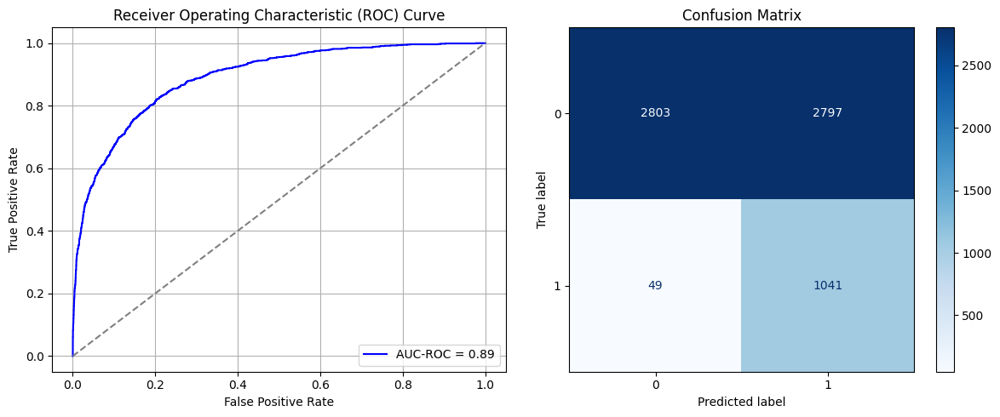

Best threshold based on F1-score: 0.9791621565818787
False Negative Rate: 0.044954128440366975
Time elapsed (performance): 0.7966240870009642
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7403 - loss: 0.5960 - val_AUC: 0.8984 - val_loss: 0.4126
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9010 - loss: 0.4036 - val_AUC: 0.9402 - val_loss: 0.3223
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9371 - loss: 0.3240 - val_AUC: 0.9568 - val_loss: 0.2980
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9505 - loss: 0.2879 - val_AUC: 0.9685 - val_loss: 0.2352
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9606 - loss: 0.2555 - val_AUC: 0.9728 - val_loss: 0.2259
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9657 - loss: 0.2390 - val_AUC: 0.9754 - val_loss: 0.2036
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9690 - loss: 0.2261 - val_AUC: 0.9766 - val_loss: 0.2012
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9727 - loss: 0.2127 - val_AUC: 0.9784 - val_loss: 0.1913
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9758 -

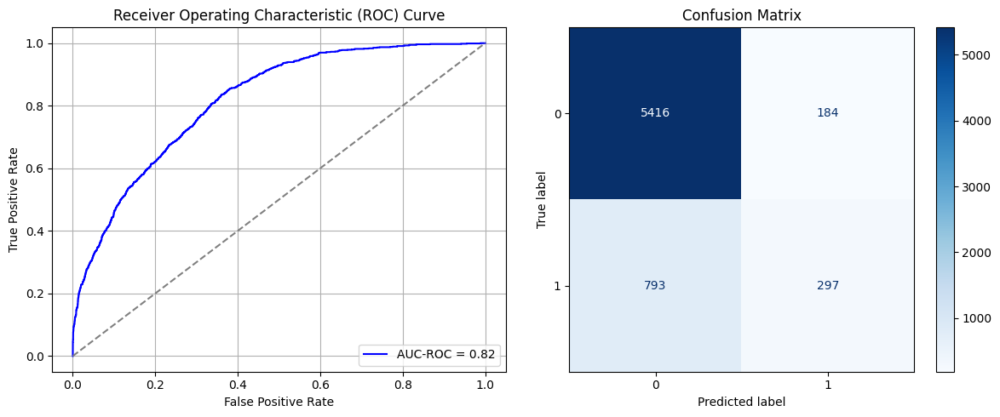

Best threshold based on F1-score: 0.09307268261909485
False Negative Rate: 0.7275229357798165
Time elapsed (performance): 1.083758251999825
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7414 - loss: 0.6027 - val_AUC: 0.8899 - val_loss: 0.4262
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8990 - loss: 0.4068 - val_AUC: 0.9391 - val_loss: 0.3319
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9389 - loss: 0.3226 - val_AUC: 0.9568 - val_loss: 0.2849
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9534 - loss: 0.2809 - val_AUC: 0.9666 - val_loss: 0.2406
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9634 - loss: 0.2484 - val_AUC: 0.9736 - val_loss: 0.2261
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9692 - loss: 0.2282 - val_AUC: 0.9736 - val_loss: 0.2166
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9718 - loss: 0.2164 - val_AUC: 0.9751 - val_loss: 0.2056
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9738 - loss: 0.2093 - val_AUC: 0.9770 - val_loss: 0.1981
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9745 -

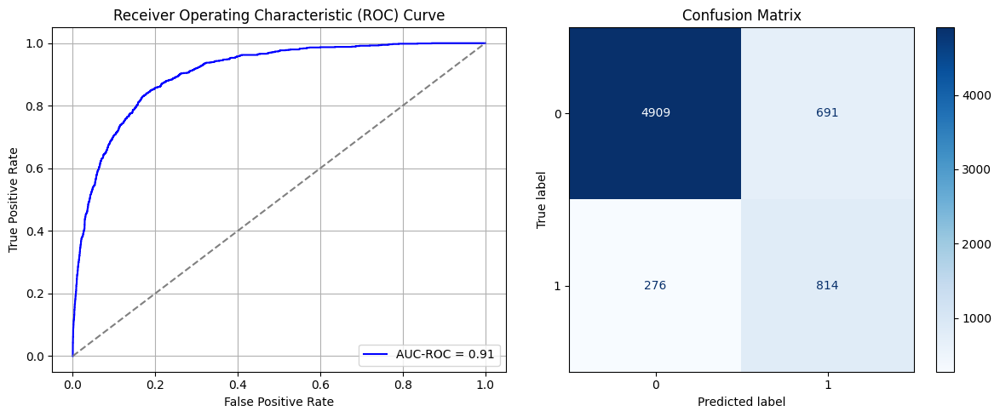

Best threshold based on F1-score: 0.6100199818611145
False Negative Rate: 0.25321100917431194
Time elapsed (performance): 0.8046503179975844
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7314 - loss: 0.6014 - val_AUC: 0.9052 - val_loss: 0.4047
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9040 - loss: 0.3978 - val_AUC: 0.9406 - val_loss: 0.3314
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9400 - loss: 0.3171 - val_AUC: 0.9569 - val_loss: 0.3126
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9490 - loss: 0.2904 - val_AUC: 0.9642 - val_loss: 0.2601
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9591 - loss: 0.2603 - val_AUC: 0.9683 - val_loss: 0.2373
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9657 - loss: 0.2386 - val_AUC: 0.9710 - val_loss: 0.2500
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9699 - loss: 0.2229 - val_AUC: 0.9732 - val_loss: 0.2096
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9726 - loss: 0.2126 - val_AUC: 0.9771 - val_loss: 0.1976
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9740 -

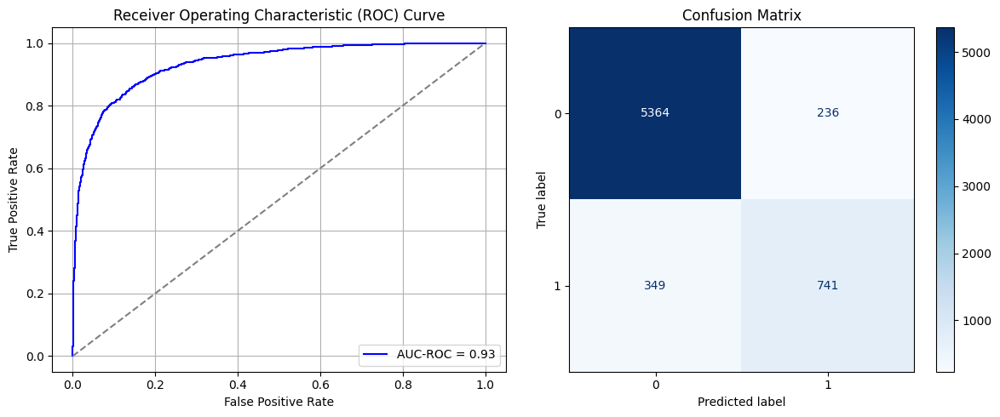

Best threshold based on F1-score: 0.3307836353778839
False Negative Rate: 0.3201834862385321
Time elapsed (performance): 0.8036484990007011
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7396 - loss: 0.5967 - val_AUC: 0.8921 - val_loss: 0.4284
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8948 - loss: 0.4135 - val_AUC: 0.9274 - val_loss: 0.3624
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9215 - loss: 0.3589 - val_AUC: 0.9469 - val_loss: 0.3006
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9403 - loss: 0.3141 - val_AUC: 0.9580 - val_loss: 0.2696
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9535 - loss: 0.2779 - val_AUC: 0.9666 - val_loss: 0.2391
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9619 - loss: 0.2511 - val_AUC: 0.9709 - val_loss: 0.2226
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9662 - loss: 0.2366 - val_AUC: 0.9722 - val_loss: 0.2250
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9688 - loss: 0.2272 - val_AUC: 0.9748 - val_loss: 0.2069
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9721 -

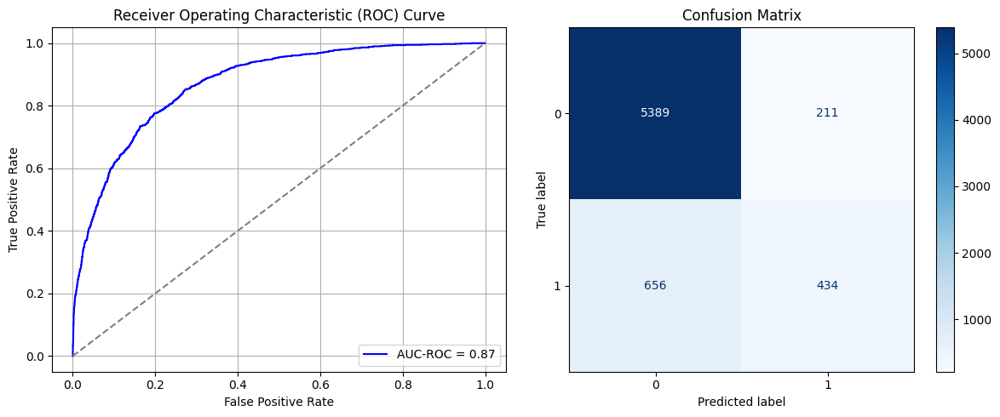

Best threshold based on F1-score: 0.14309687912464142
False Negative Rate: 0.6018348623853211
Time elapsed (performance): 1.2022622910008067
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7392 - loss: 0.5963 - val_AUC: 0.8998 - val_loss: 0.4131
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9058 - loss: 0.3932 - val_AUC: 0.9358 - val_loss: 0.3534
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9358 - loss: 0.3269 - val_AUC: 0.9516 - val_loss: 0.2850
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9529 - loss: 0.2805 - val_AUC: 0.9583 - val_loss: 0.2689
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9618 - loss: 0.2525 - val_AUC: 0.9676 - val_loss: 0.2466
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9674 - loss: 0.2325 - val_AUC: 0.9709 - val_loss: 0.2210
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9718 - loss: 0.2154 - val_AUC: 0.9724 - val_loss: 0.2138
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9733 - loss: 0.2086 - val_AUC: 0.9741 - val_loss: 0.2052
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9766 -

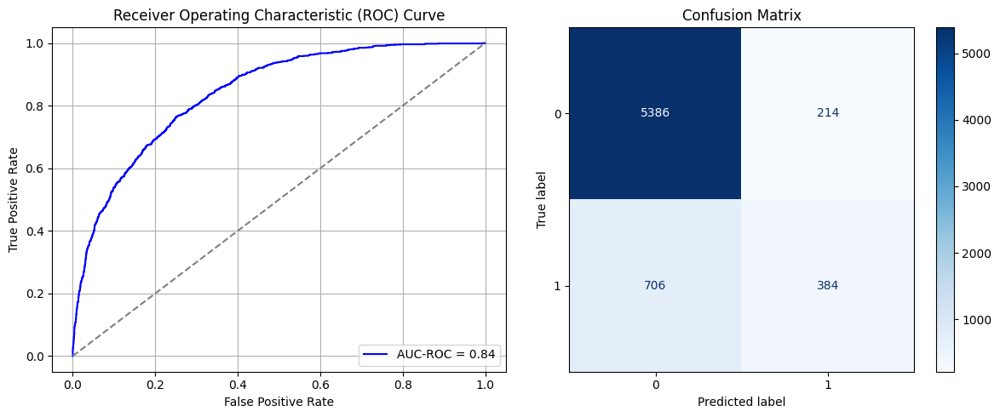

Best threshold based on F1-score: 0.1497054547071457
False Negative Rate: 0.6477064220183486
Time elapsed (performance): 0.8062856830001692
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7224 - loss: 0.6085 - val_AUC: 0.8888 - val_loss: 0.4332
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8997 - loss: 0.4064 - val_AUC: 0.9387 - val_loss: 0.3296
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9372 - loss: 0.3237 - val_AUC: 0.9590 - val_loss: 0.2669
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9560 - loss: 0.2716 - val_AUC: 0.9680 - val_loss: 0.2476
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9643 - loss: 0.2434 - val_AUC: 0.9695 - val_loss: 0.2305
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9679 - loss: 0.2293 - val_AUC: 0.9732 - val_loss: 0.2159
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9697 - loss: 0.2229 - val_AUC: 0.9704 - val_loss: 0.2203
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9723 - loss: 0.2126 - val_AUC: 0.9779 - val_loss: 0.1953
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9750 -

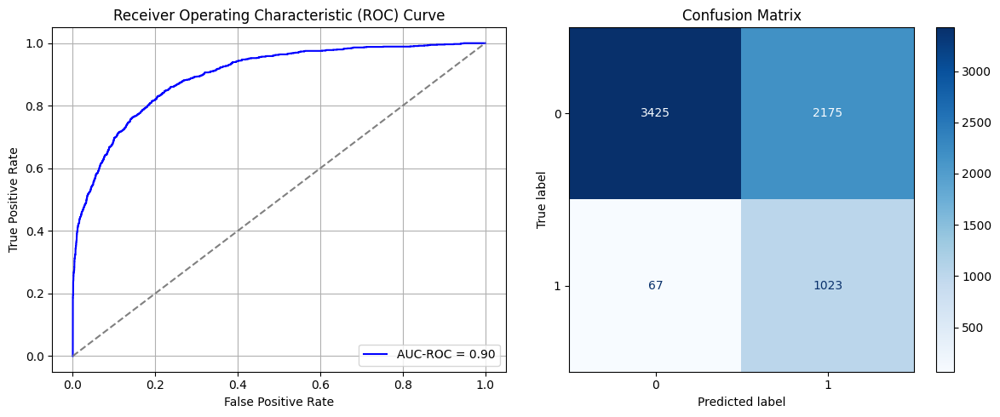

Best threshold based on F1-score: 0.9509333968162537
False Negative Rate: 0.061467889908256884
Time elapsed (performance): 0.7848987220022536
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7382 - loss: 0.5986 - val_AUC: 0.8843 - val_loss: 0.4339
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8926 - loss: 0.4165 - val_AUC: 0.9209 - val_loss: 0.3612
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9222 - loss: 0.3569 - val_AUC: 0.9405 - val_loss: 0.3157
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9420 - loss: 0.3100 - val_AUC: 0.9506 - val_loss: 0.2885
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9547 - loss: 0.2754 - val_AUC: 0.9617 - val_loss: 0.2550
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9619 - loss: 0.2530 - val_AUC: 0.9680 - val_loss: 0.2393
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9668 - loss: 0.2354 - val_AUC: 0.9700 - val_loss: 0.2390
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9691 - loss: 0.2273 - val_AUC: 0.9728 - val_loss: 0.2132
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9721 -

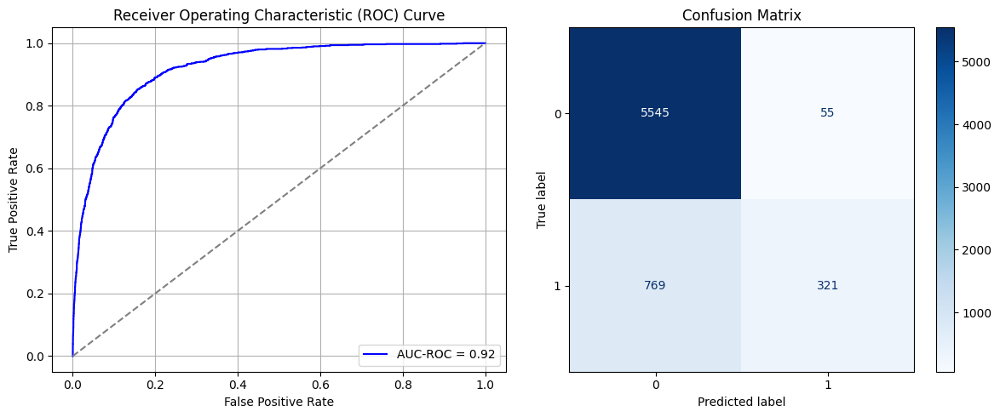

Best threshold based on F1-score: 0.058129023760557175
False Negative Rate: 0.7055045871559633
Time elapsed (performance): 0.8140143079981499
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7493 - loss: 0.5886 - val_AUC: 0.9120 - val_loss: 0.3931
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9091 - loss: 0.3875 - val_AUC: 0.9462 - val_loss: 0.3139
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9422 - loss: 0.3106 - val_AUC: 0.9560 - val_loss: 0.2970
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9525 - loss: 0.2821 - val_AUC: 0.9628 - val_loss: 0.2777
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9589 - loss: 0.2612 - val_AUC: 0.9694 - val_loss: 0.2326
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9656 - loss: 0.2390 - val_AUC: 0.9726 - val_loss: 0.2328
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9701 - loss: 0.2224 - val_AUC: 0.9741 - val_loss: 0.2067
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9713 - loss: 0.2174 - val_AUC: 0.9768 - val_loss: 0.1943
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9729 -

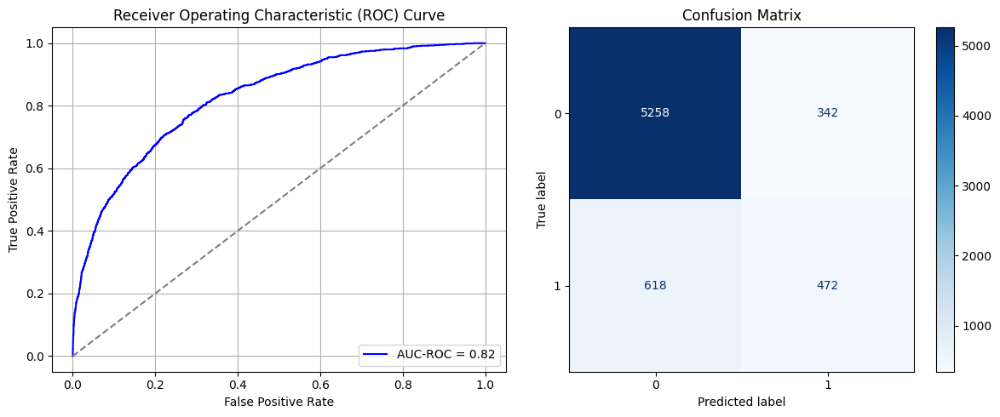

Best threshold based on F1-score: 0.21910732984542847
False Negative Rate: 0.5669724770642202
Time elapsed (performance): 0.8069633390005038
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7297 - loss: 0.6056 - val_AUC: 0.8917 - val_loss: 0.4332
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8989 - loss: 0.4078 - val_AUC: 0.9338 - val_loss: 0.3367
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9327 - loss: 0.3351 - val_AUC: 0.9529 - val_loss: 0.2884
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9469 - loss: 0.2979 - val_AUC: 0.9620 - val_loss: 0.2563
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9579 - loss: 0.2652 - val_AUC: 0.9673 - val_loss: 0.2401
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9635 - loss: 0.2464 - val_AUC: 0.9703 - val_loss: 0.2249
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9668 - loss: 0.2345 - val_AUC: 0.9732 - val_loss: 0.2497
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9694 - loss: 0.2255 - val_AUC: 0.9762 - val_loss: 0.2235
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9731 -

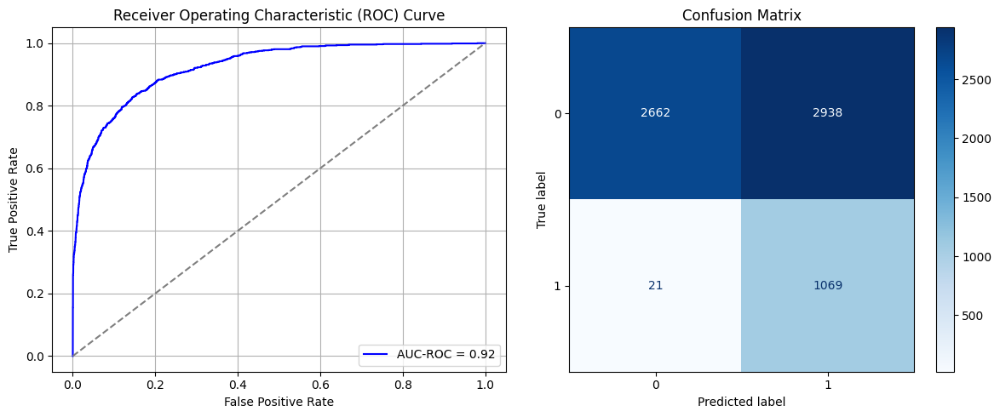

Best threshold based on F1-score: 0.9839124083518982
False Negative Rate: 0.01926605504587156
Time elapsed (performance): 0.8129060339997523
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7503 - loss: 0.5896 - val_AUC: 0.8955 - val_loss: 0.4304
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8976 - loss: 0.4087 - val_AUC: 0.9403 - val_loss: 0.3225
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9360 - loss: 0.3277 - val_AUC: 0.9557 - val_loss: 0.3137
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9538 - loss: 0.2783 - val_AUC: 0.9674 - val_loss: 0.2391
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9634 - loss: 0.2472 - val_AUC: 0.9730 - val_loss: 0.2159
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9685 - loss: 0.2292 - val_AUC: 0.9757 - val_loss: 0.2083
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9711 - loss: 0.2192 - val_AUC: 0.9781 - val_loss: 0.2030
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9721 - loss: 0.2146 - val_AUC: 0.9794 - val_loss: 0.1922
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9745 -

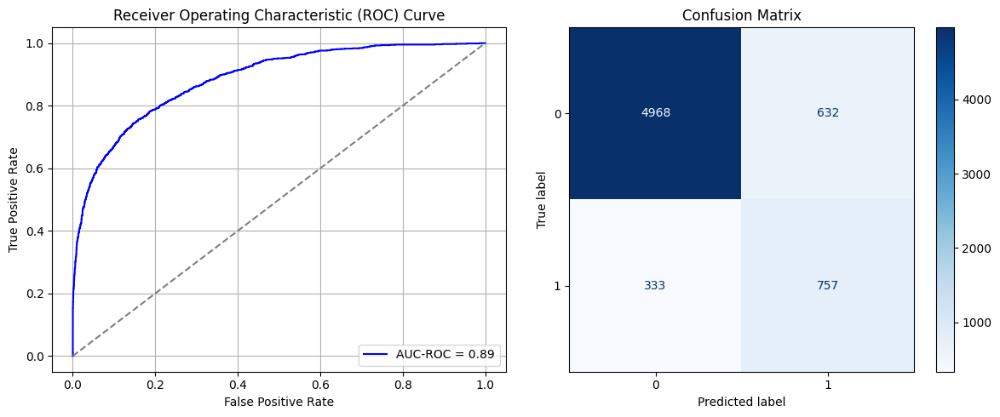

Best threshold based on F1-score: 0.6931267976760864
False Negative Rate: 0.3055045871559633
Time elapsed (performance): 0.7984616209978412
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7093 - loss: 0.6167 - val_AUC: 0.8962 - val_loss: 0.4292
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8950 - loss: 0.4156 - val_AUC: 0.9338 - val_loss: 0.3386
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9300 - loss: 0.3420 - val_AUC: 0.9489 - val_loss: 0.3377
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9433 - loss: 0.3067 - val_AUC: 0.9598 - val_loss: 0.2686
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9561 - loss: 0.2705 - val_AUC: 0.9640 - val_loss: 0.2628
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9626 - loss: 0.2502 - val_AUC: 0.9663 - val_loss: 0.2464
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9645 - loss: 0.2424 - val_AUC: 0.9714 - val_loss: 0.2214
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9705 - loss: 0.2215 - val_AUC: 0.9734 - val_loss: 0.2106
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9731 -

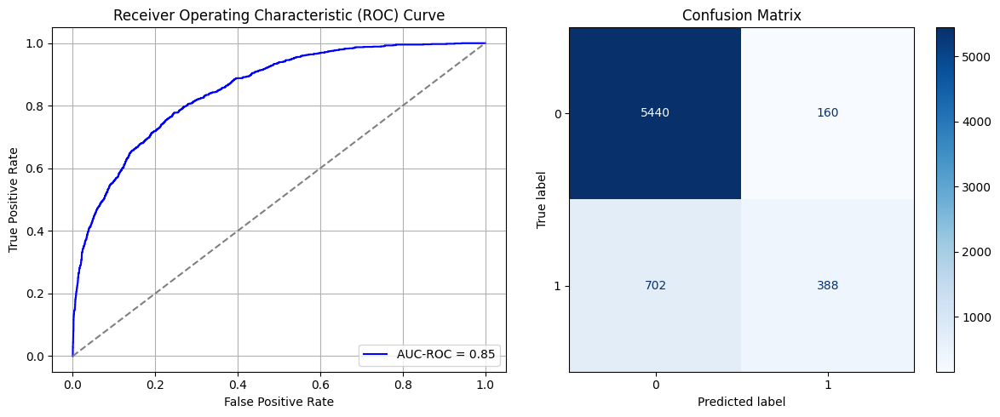

Best threshold based on F1-score: 0.09060681611299515
False Negative Rate: 0.6440366972477064
Time elapsed (performance): 0.8300106630013033
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7373 - loss: 0.6001 - val_AUC: 0.8874 - val_loss: 0.4321
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8994 - loss: 0.4064 - val_AUC: 0.9353 - val_loss: 0.3343
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9376 - loss: 0.3243 - val_AUC: 0.9564 - val_loss: 0.2773
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9549 - loss: 0.2760 - val_AUC: 0.9597 - val_loss: 0.2939
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9645 - loss: 0.2445 - val_AUC: 0.9693 - val_loss: 0.2272
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9675 - loss: 0.2329 - val_AUC: 0.9712 - val_loss: 0.2211
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9694 - loss: 0.2246 - val_AUC: 0.9703 - val_loss: 0.2220
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9723 - loss: 0.2130 - val_AUC: 0.9757 - val_loss: 0.2094
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9759 -

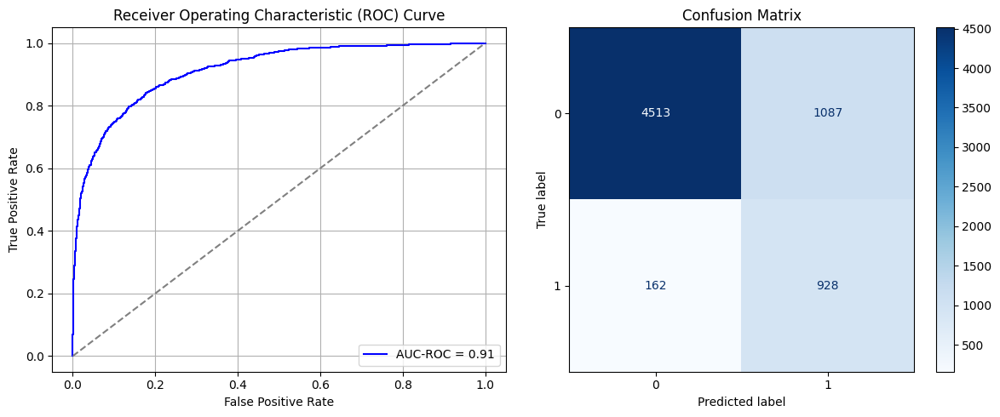

Best threshold based on F1-score: 0.7896715998649597
False Negative Rate: 0.14862385321100918
Time elapsed (performance): 0.8404555249981058
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7383 - loss: 0.6064 - val_AUC: 0.8879 - val_loss: 0.4528
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8934 - loss: 0.4158 - val_AUC: 0.9367 - val_loss: 0.3431
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9359 - loss: 0.3278 - val_AUC: 0.9529 - val_loss: 0.2981
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9551 - loss: 0.2756 - val_AUC: 0.9632 - val_loss: 0.2544
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9634 - loss: 0.2479 - val_AUC: 0.9679 - val_loss: 0.2336
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9636 - loss: 0.2446 - val_AUC: 0.9700 - val_loss: 0.2353
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9680 - loss: 0.2291 - val_AUC: 0.9722 - val_loss: 0.2172
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9699 - loss: 0.2222 - val_AUC: 0.9729 - val_loss: 0.2274
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9710 -

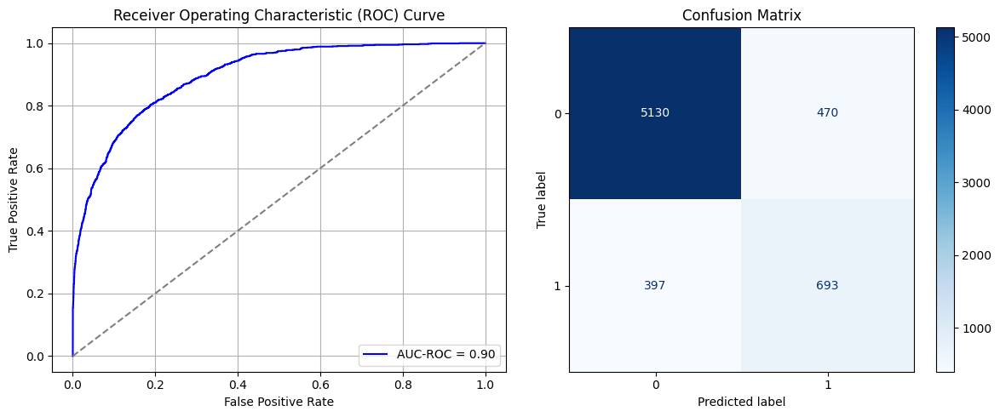

Best threshold based on F1-score: 0.43265631794929504
False Negative Rate: 0.3642201834862385
Time elapsed (performance): 0.8141585480007052
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7273 - loss: 0.6096 - val_AUC: 0.8944 - val_loss: 0.4488
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8995 - loss: 0.4063 - val_AUC: 0.9322 - val_loss: 0.3541
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9368 - loss: 0.3265 - val_AUC: 0.9559 - val_loss: 0.2799
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9526 - loss: 0.2829 - val_AUC: 0.9644 - val_loss: 0.2549
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9609 - loss: 0.2554 - val_AUC: 0.9692 - val_loss: 0.2289
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9657 - loss: 0.2388 - val_AUC: 0.9737 - val_loss: 0.2381
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9696 - loss: 0.2246 - val_AUC: 0.9742 - val_loss: 0.2201
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9727 - loss: 0.2132 - val_AUC: 0.9775 - val_loss: 0.1981
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9758 -

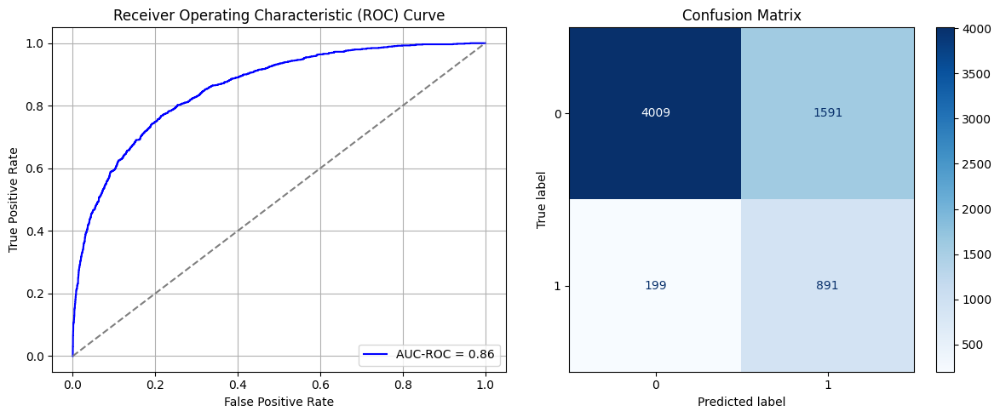

Best threshold based on F1-score: 0.8568141460418701
False Negative Rate: 0.18256880733944955
Time elapsed (performance): 1.0359346650002408
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7650 - loss: 0.5776 - val_AUC: 0.8921 - val_loss: 0.4283
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9018 - loss: 0.4015 - val_AUC: 0.9341 - val_loss: 0.3571
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9386 - loss: 0.3227 - val_AUC: 0.9564 - val_loss: 0.2806
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9477 - loss: 0.2949 - val_AUC: 0.9629 - val_loss: 0.2516
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9609 - loss: 0.2559 - val_AUC: 0.9624 - val_loss: 0.2529
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9645 - loss: 0.2433 - val_AUC: 0.9700 - val_loss: 0.2247
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9680 - loss: 0.2310 - val_AUC: 0.9710 - val_loss: 0.2246
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9701 - loss: 0.2229 - val_AUC: 0.9735 - val_loss: 0.2104
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9737 -

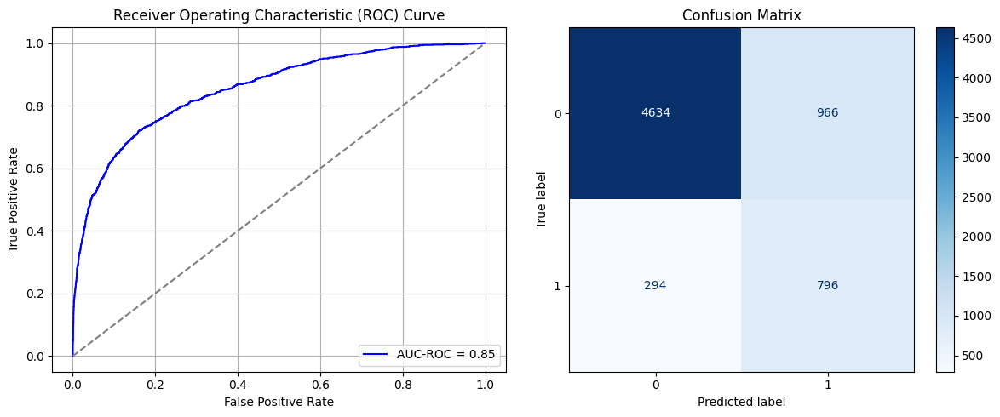

Best threshold based on F1-score: 0.756172239780426
False Negative Rate: 0.26972477064220185
Time elapsed (performance): 0.9272664609998174
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7505 - loss: 0.5924 - val_AUC: 0.9011 - val_loss: 0.4076
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9010 - loss: 0.4026 - val_AUC: 0.9353 - val_loss: 0.3323
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9330 - loss: 0.3333 - val_AUC: 0.9500 - val_loss: 0.3140
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9489 - loss: 0.2913 - val_AUC: 0.9582 - val_loss: 0.2673
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9563 - loss: 0.2696 - val_AUC: 0.9631 - val_loss: 0.2473
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9650 - loss: 0.2413 - val_AUC: 0.9689 - val_loss: 0.2296
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9676 - loss: 0.2309 - val_AUC: 0.9722 - val_loss: 0.2164
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9697 - loss: 0.2230 - val_AUC: 0.9734 - val_loss: 0.2092
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9707 -

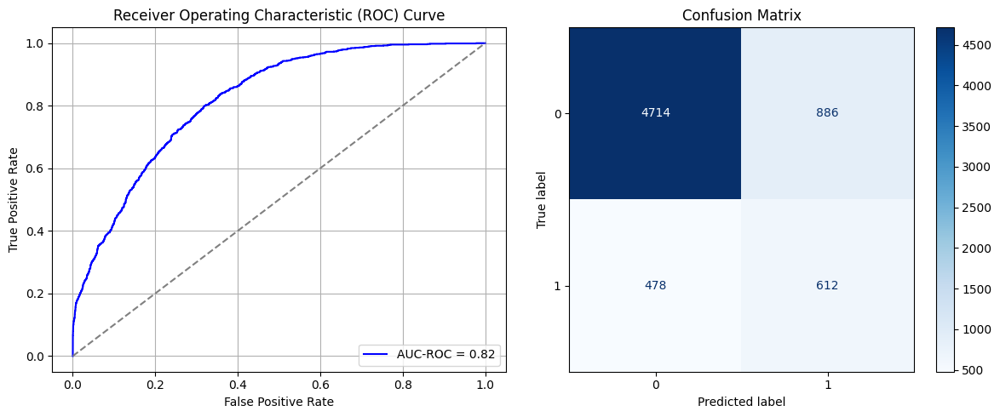

Best threshold based on F1-score: 0.40013203024864197
False Negative Rate: 0.43853211009174314
Time elapsed (performance): 1.2614988059976895
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7320 - loss: 0.5994 - val_AUC: 0.8950 - val_loss: 0.4458
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8946 - loss: 0.4113 - val_AUC: 0.9366 - val_loss: 0.3354
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9300 - loss: 0.3413 - val_AUC: 0.9488 - val_loss: 0.2953
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9451 - loss: 0.3018 - val_AUC: 0.9604 - val_loss: 0.2595
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9533 - loss: 0.2782 - val_AUC: 0.9658 - val_loss: 0.2688
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9606 - loss: 0.2560 - val_AUC: 0.9719 - val_loss: 0.2242
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9662 - loss: 0.2366 - val_AUC: 0.9748 - val_loss: 0.2111
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9684 - loss: 0.2283 - val_AUC: 0.9765 - val_loss: 0.2002
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9716 -

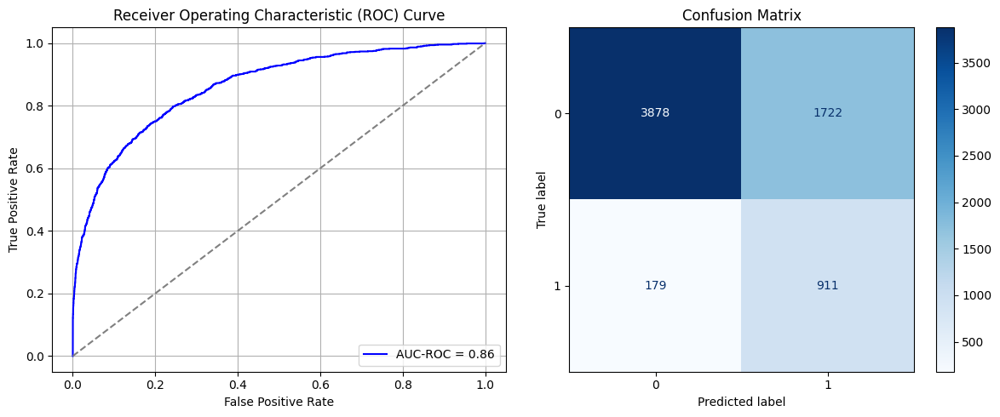

Best threshold based on F1-score: 0.9152641296386719
False Negative Rate: 0.16422018348623854
Time elapsed (performance): 0.8346794549979677
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7319 - loss: 0.6022 - val_AUC: 0.8836 - val_loss: 0.4345
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8884 - loss: 0.4229 - val_AUC: 0.9223 - val_loss: 0.3597
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9273 - loss: 0.3465 - val_AUC: 0.9434 - val_loss: 0.3424
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9430 - loss: 0.3079 - val_AUC: 0.9551 - val_loss: 0.2814
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9525 - loss: 0.2812 - val_AUC: 0.9620 - val_loss: 0.2529
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9607 - loss: 0.2557 - val_AUC: 0.9654 - val_loss: 0.2629
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9639 - loss: 0.2449 - val_AUC: 0.9689 - val_loss: 0.2346
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9671 - loss: 0.2331 - val_AUC: 0.9713 - val_loss: 0.2201
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9691 -

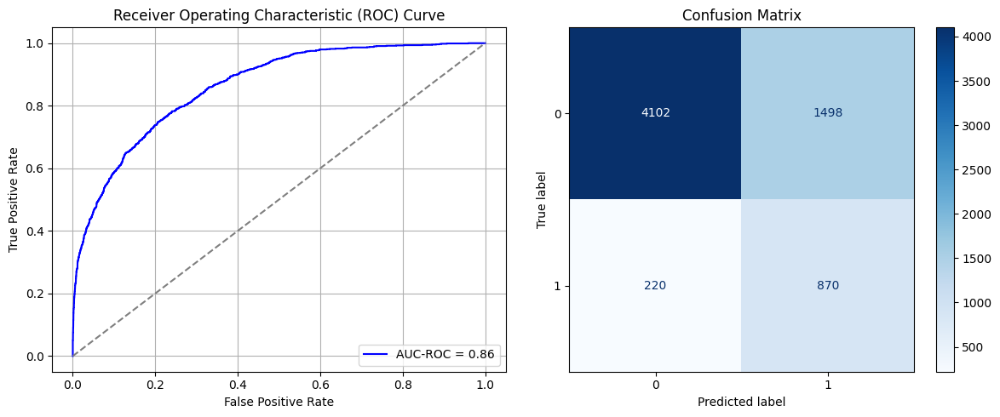

Best threshold based on F1-score: 0.8085145354270935
False Negative Rate: 0.2018348623853211
Time elapsed (performance): 1.031992068998079
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7460 - loss: 0.5929 - val_AUC: 0.8937 - val_loss: 0.4170
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9044 - loss: 0.3955 - val_AUC: 0.9389 - val_loss: 0.3219
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9386 - loss: 0.3199 - val_AUC: 0.9506 - val_loss: 0.2876
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9523 - loss: 0.2815 - val_AUC: 0.9586 - val_loss: 0.2749
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9600 - loss: 0.2575 - val_AUC: 0.9699 - val_loss: 0.2306
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9628 - loss: 0.2476 - val_AUC: 0.9712 - val_loss: 0.2271
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9669 - loss: 0.2336 - val_AUC: 0.9727 - val_loss: 0.2248
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9705 - loss: 0.2197 - val_AUC: 0.9755 - val_loss: 0.2101
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9727 -

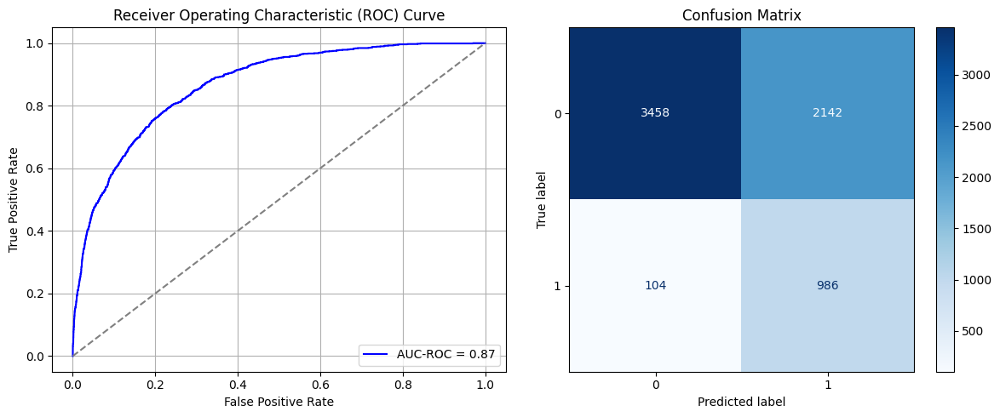

Best threshold based on F1-score: 0.9646967649459839
False Negative Rate: 0.09541284403669725
Time elapsed (performance): 0.8394421269986196
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7166 - loss: 0.6149 - val_AUC: 0.8942 - val_loss: 0.4286
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8944 - loss: 0.4135 - val_AUC: 0.9298 - val_loss: 0.3484
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9310 - loss: 0.3387 - val_AUC: 0.9525 - val_loss: 0.3222
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9486 - loss: 0.2937 - val_AUC: 0.9631 - val_loss: 0.2711
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9596 - loss: 0.2601 - val_AUC: 0.9690 - val_loss: 0.2297
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9645 - loss: 0.2434 - val_AUC: 0.9716 - val_loss: 0.2334
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9666 - loss: 0.2363 - val_AUC: 0.9758 - val_loss: 0.2102
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9695 - loss: 0.2248 - val_AUC: 0.9768 - val_loss: 0.1998
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9724 -

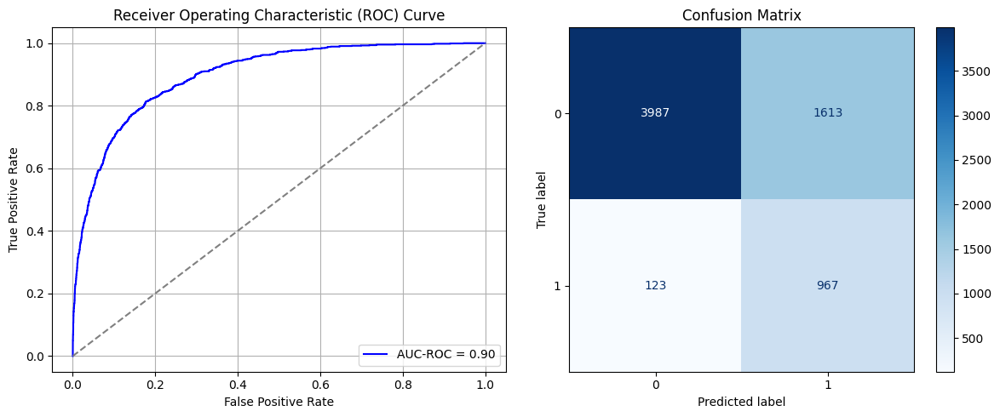

Best threshold based on F1-score: 0.8903512358665466
False Negative Rate: 0.11284403669724771
Time elapsed (performance): 1.0490387190002366
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7376 - loss: 0.5932 - val_AUC: 0.9075 - val_loss: 0.3972
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9137 - loss: 0.3771 - val_AUC: 0.9441 - val_loss: 0.3107
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9457 - loss: 0.3020 - val_AUC: 0.9575 - val_loss: 0.2850
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9557 - loss: 0.2716 - val_AUC: 0.9685 - val_loss: 0.2571
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9643 - loss: 0.2440 - val_AUC: 0.9695 - val_loss: 0.2299
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9683 - loss: 0.2296 - val_AUC: 0.9741 - val_loss: 0.2225
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9700 - loss: 0.2221 - val_AUC: 0.9741 - val_loss: 0.2072
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9691 - loss: 0.2258 - val_AUC: 0.9770 - val_loss: 0.1957
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9756 -

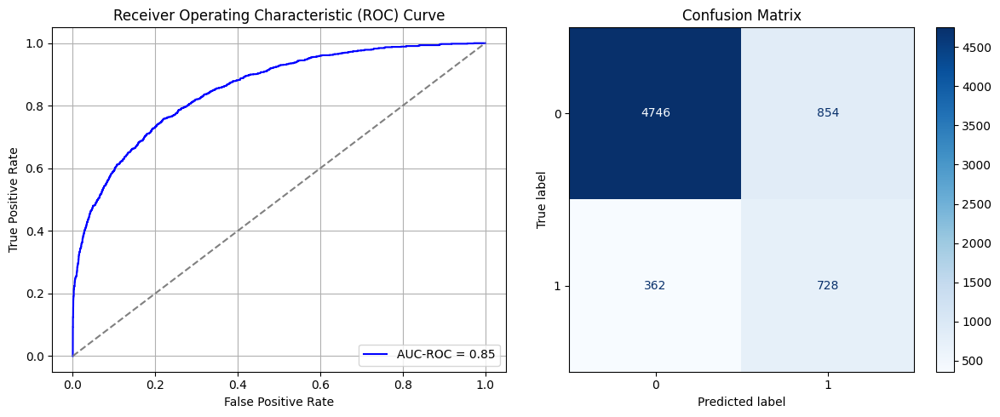

Best threshold based on F1-score: 0.6316360831260681
False Negative Rate: 0.3321100917431193
Time elapsed (performance): 0.8586107789997186
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6833 - loss: 0.6317 - val_AUC: 0.8806 - val_loss: 0.4502
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8838 - loss: 0.4341 - val_AUC: 0.9285 - val_loss: 0.3506
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9288 - loss: 0.3455 - val_AUC: 0.9478 - val_loss: 0.2998
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9478 - loss: 0.2974 - val_AUC: 0.9600 - val_loss: 0.2745
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9563 - loss: 0.2708 - val_AUC: 0.9644 - val_loss: 0.2538
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9615 - loss: 0.2534 - val_AUC: 0.9710 - val_loss: 0.2216
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9684 - loss: 0.2291 - val_AUC: 0.9695 - val_loss: 0.2438
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9708 - loss: 0.2205 - val_AUC: 0.9754 - val_loss: 0.2038
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9737 -

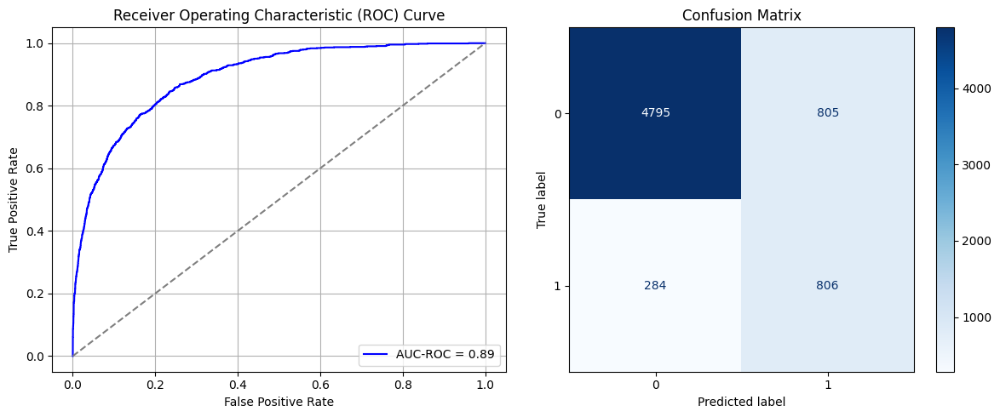

Best threshold based on F1-score: 0.6690942049026489
False Negative Rate: 0.26055045871559634
Time elapsed (performance): 0.8035115439997753
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7553 - loss: 0.5881 - val_AUC: 0.8940 - val_loss: 0.4276
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8965 - loss: 0.4087 - val_AUC: 0.9352 - val_loss: 0.3390
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9373 - loss: 0.3245 - val_AUC: 0.9566 - val_loss: 0.2794
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9540 - loss: 0.2781 - val_AUC: 0.9635 - val_loss: 0.2589
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9631 - loss: 0.2482 - val_AUC: 0.9679 - val_loss: 0.2380
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9683 - loss: 0.2296 - val_AUC: 0.9731 - val_loss: 0.2122
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9707 - loss: 0.2204 - val_AUC: 0.9746 - val_loss: 0.2205
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9733 - loss: 0.2096 - val_AUC: 0.9747 - val_loss: 0.2068
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9767 -

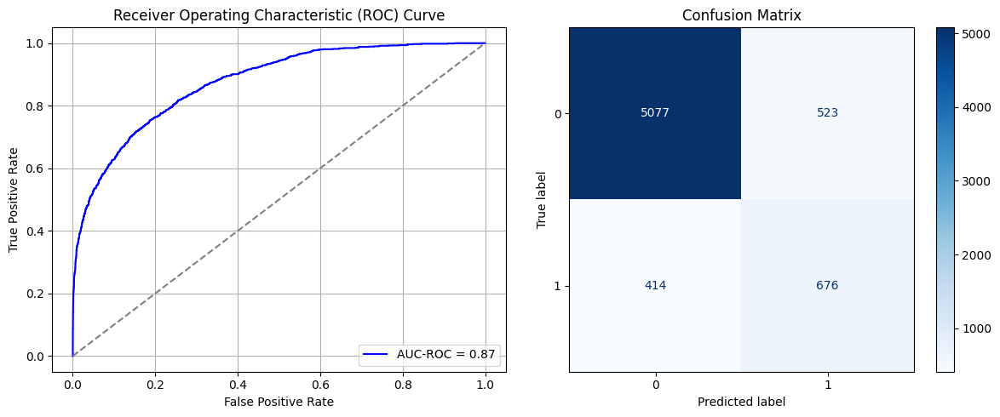

Best threshold based on F1-score: 0.5731698870658875
False Negative Rate: 0.3798165137614679
Time elapsed (performance): 1.0379491349995078
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7394 - loss: 0.5981 - val_AUC: 0.8865 - val_loss: 0.4330
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8958 - loss: 0.4127 - val_AUC: 0.9340 - val_loss: 0.3524
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9394 - loss: 0.3201 - val_AUC: 0.9542 - val_loss: 0.2858
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9548 - loss: 0.2749 - val_AUC: 0.9648 - val_loss: 0.2494
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9647 - loss: 0.2439 - val_AUC: 0.9700 - val_loss: 0.2336
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9659 - loss: 0.2388 - val_AUC: 0.9724 - val_loss: 0.2195
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9699 - loss: 0.2233 - val_AUC: 0.9742 - val_loss: 0.2164
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9728 - loss: 0.2123 - val_AUC: 0.9753 - val_loss: 0.2046
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9750 -

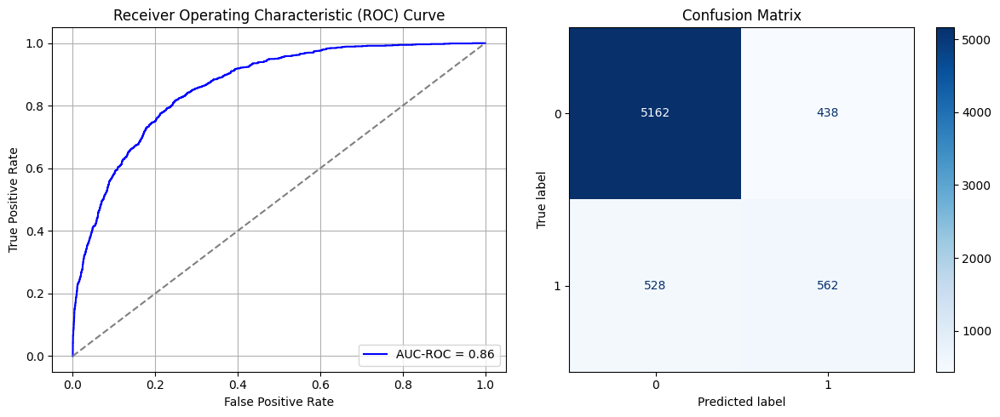

Best threshold based on F1-score: 0.3777177333831787
False Negative Rate: 0.48440366972477067
Time elapsed (performance): 1.21740739100278
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.7100 - loss: 0.6159 - val_AUC: 0.8646 - val_loss: 0.4997
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 - loss: 0.4373 - val_AUC: 0.9135 - val_loss: 0.3793
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9189 - loss: 0.3651 - val_AUC: 0.9391 - val_loss: 0.3300
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9427 - loss: 0.3098 - val_AUC: 0.9530 - val_loss: 0.3064
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9486 - loss: 0.2910 - val_AUC: 0.9588 - val_loss: 0.2626
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9583 - loss: 0.2628 - val_AUC: 0.9631 - val_loss: 0.2544
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9623 - loss: 0.2498 - val_AUC: 0.9642 - val_loss: 0.2576
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9655 - loss: 0.2389 - val_AUC: 0.9703 - val_loss: 0.2228
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9673 

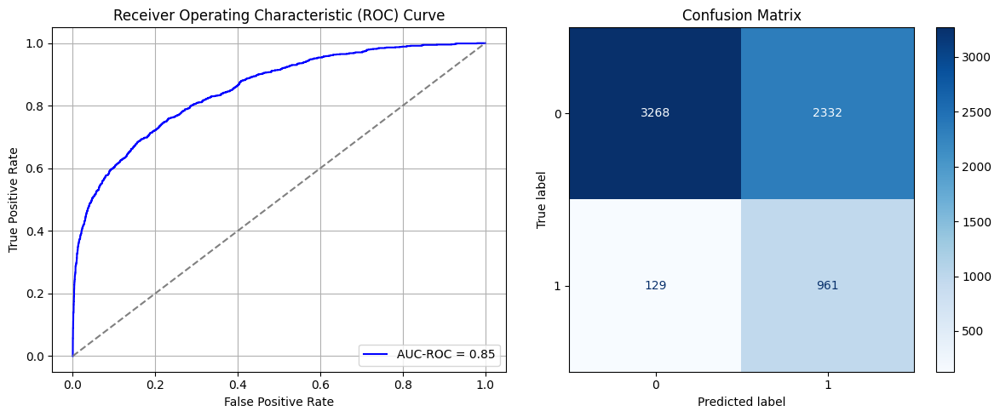

Best threshold based on F1-score: 0.9222998023033142
False Negative Rate: 0.11834862385321102
Time elapsed (performance): 0.9226132449985016
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7256 - loss: 0.6089 - val_AUC: 0.8768 - val_loss: 0.4440
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8881 - loss: 0.4245 - val_AUC: 0.9262 - val_loss: 0.3538
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9268 - loss: 0.3481 - val_AUC: 0.9450 - val_loss: 0.3041
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9440 - loss: 0.3050 - val_AUC: 0.9571 - val_loss: 0.2704
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9564 - loss: 0.2700 - val_AUC: 0.9659 - val_loss: 0.2426
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9618 - loss: 0.2521 - val_AUC: 0.9693 - val_loss: 0.2317
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9667 - loss: 0.2355 - val_AUC: 0.9726 - val_loss: 0.2184
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9709 - loss: 0.2205 - val_AUC: 0.9730 - val_loss: 0.2147
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9698 -

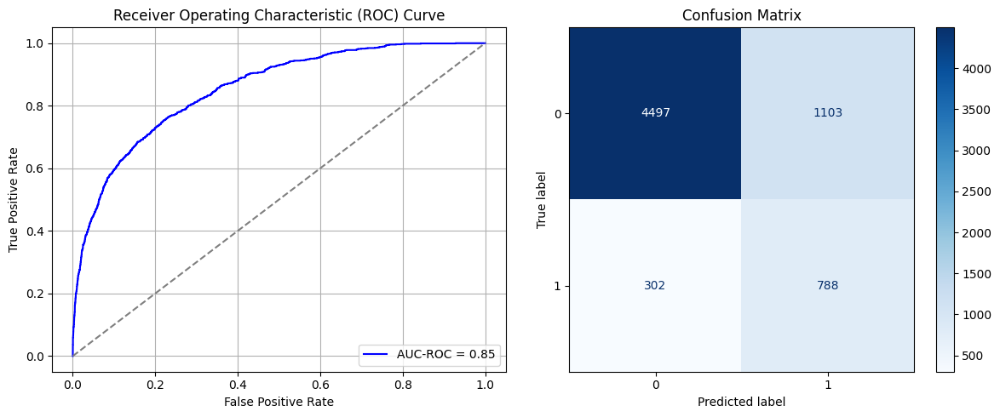

Best threshold based on F1-score: 0.7548416256904602
False Negative Rate: 0.27706422018348625
Time elapsed (performance): 1.3324005249996844
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7317 - loss: 0.5999 - val_AUC: 0.8903 - val_loss: 0.4493
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8952 - loss: 0.4127 - val_AUC: 0.9286 - val_loss: 0.3509
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9301 - loss: 0.3405 - val_AUC: 0.9488 - val_loss: 0.3003
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9465 - loss: 0.2997 - val_AUC: 0.9601 - val_loss: 0.2652
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9580 - loss: 0.2652 - val_AUC: 0.9648 - val_loss: 0.2623
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9642 - loss: 0.2444 - val_AUC: 0.9697 - val_loss: 0.2843
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9666 - loss: 0.2354 - val_AUC: 0.9728 - val_loss: 0.2352
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9701 - loss: 0.2222 - val_AUC: 0.9739 - val_loss: 0.2172
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9736 -

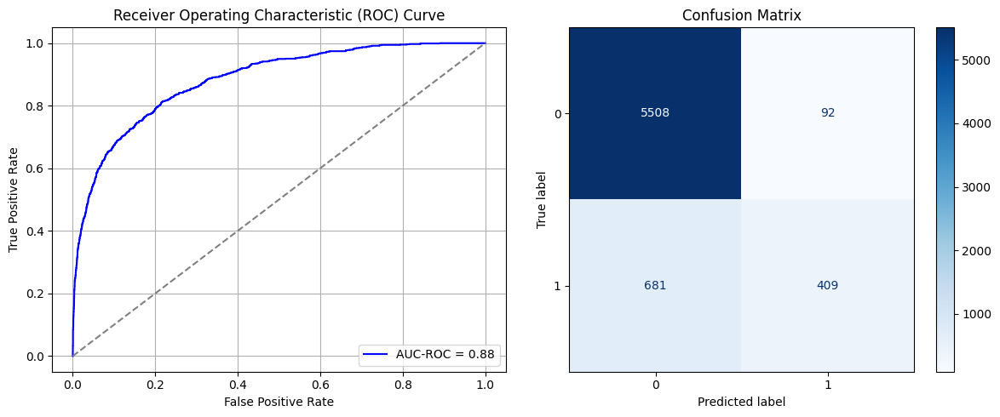

Best threshold based on F1-score: 0.0971408262848854
False Negative Rate: 0.6247706422018349
Time elapsed (performance): 1.094299806998606
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7451 - loss: 0.5928 - val_AUC: 0.9008 - val_loss: 0.4119
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9038 - loss: 0.3960 - val_AUC: 0.9427 - val_loss: 0.3265
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9392 - loss: 0.3202 - val_AUC: 0.9573 - val_loss: 0.2738
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9528 - loss: 0.2811 - val_AUC: 0.9659 - val_loss: 0.2628
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9589 - loss: 0.2612 - val_AUC: 0.9705 - val_loss: 0.2233
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9634 - loss: 0.2463 - val_AUC: 0.9727 - val_loss: 0.2155
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9689 - loss: 0.2271 - val_AUC: 0.9732 - val_loss: 0.2134
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9717 - loss: 0.2161 - val_AUC: 0.9750 - val_loss: 0.2088
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9711 -

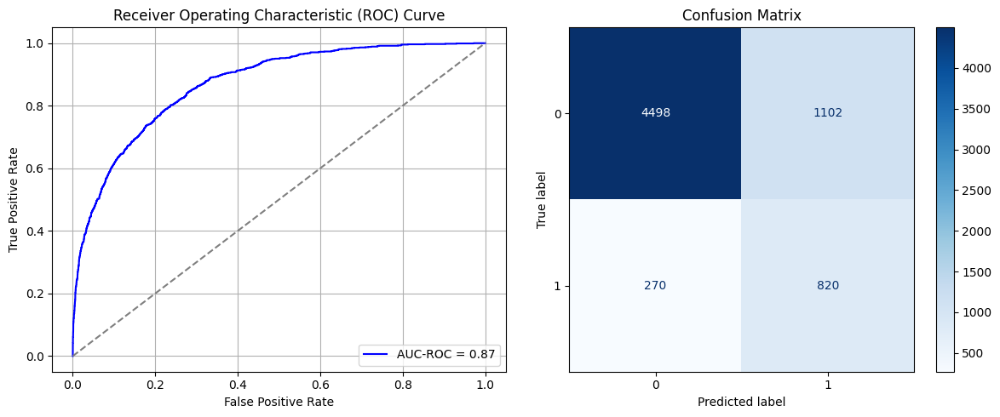

Best threshold based on F1-score: 0.7409955263137817
False Negative Rate: 0.24770642201834864
Time elapsed (performance): 1.1091081509985088
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7483 - loss: 0.5931 - val_AUC: 0.8894 - val_loss: 0.4306
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8952 - loss: 0.4129 - val_AUC: 0.9292 - val_loss: 0.3495
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9265 - loss: 0.3491 - val_AUC: 0.9433 - val_loss: 0.3103
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9441 - loss: 0.3059 - val_AUC: 0.9554 - val_loss: 0.2797
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9553 - loss: 0.2732 - val_AUC: 0.9621 - val_loss: 0.2527
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9614 - loss: 0.2532 - val_AUC: 0.9672 - val_loss: 0.2395
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9639 - loss: 0.2457 - val_AUC: 0.9690 - val_loss: 0.2315
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9667 - loss: 0.2356 - val_AUC: 0.9716 - val_loss: 0.2218
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9681 -

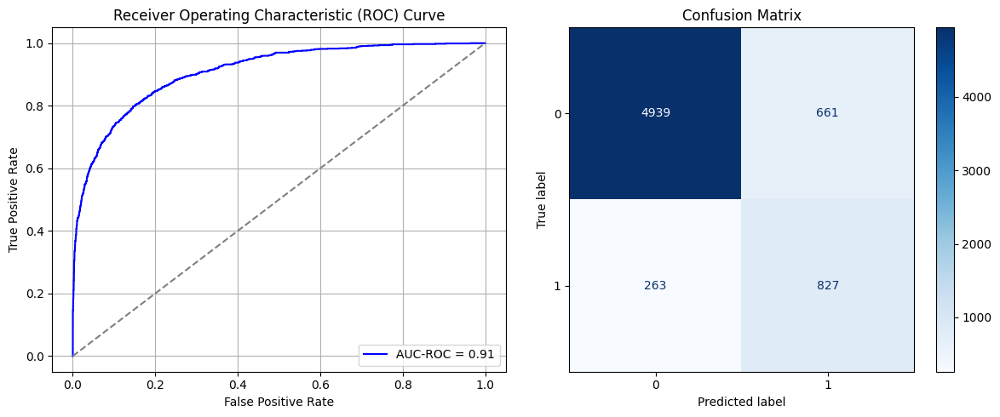

Best threshold based on F1-score: 0.7384393215179443
False Negative Rate: 0.24128440366972478
Time elapsed (performance): 0.9115970519997063
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7529 - loss: 0.5934 - val_AUC: 0.8937 - val_loss: 0.4550
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8929 - loss: 0.4152 - val_AUC: 0.9295 - val_loss: 0.3695
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9315 - loss: 0.3374 - val_AUC: 0.9475 - val_loss: 0.2999
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9456 - loss: 0.3010 - val_AUC: 0.9560 - val_loss: 0.2805
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9547 - loss: 0.2744 - val_AUC: 0.9651 - val_loss: 0.2466
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9616 - loss: 0.2525 - val_AUC: 0.9675 - val_loss: 0.2394
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9646 - loss: 0.2413 - val_AUC: 0.9695 - val_loss: 0.2234
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9700 - loss: 0.2209 - val_AUC: 0.9730 - val_loss: 0.2110
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9718 -

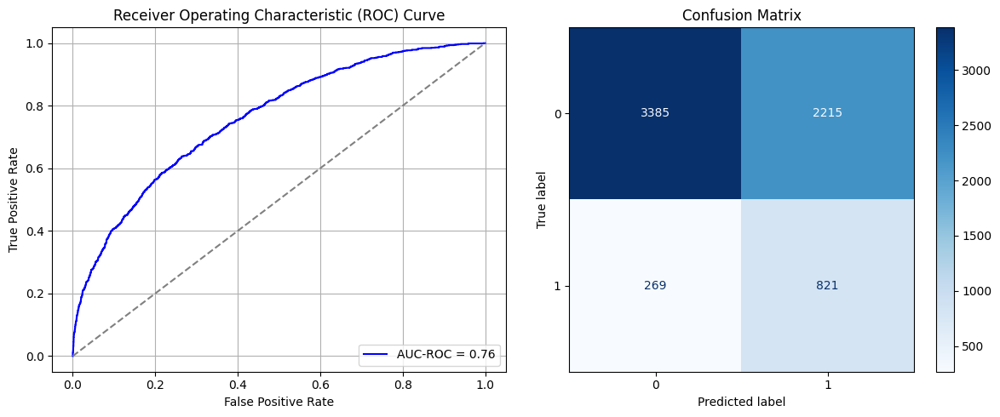

Best threshold based on F1-score: 0.8457815051078796
False Negative Rate: 0.2467889908256881
Time elapsed (performance): 1.0955818479997106
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7296 - loss: 0.6040 - val_AUC: 0.8879 - val_loss: 0.4322
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8927 - loss: 0.4168 - val_AUC: 0.9351 - val_loss: 0.3395
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9320 - loss: 0.3368 - val_AUC: 0.9537 - val_loss: 0.2893
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9491 - loss: 0.2916 - val_AUC: 0.9635 - val_loss: 0.2538
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9594 - loss: 0.2603 - val_AUC: 0.9679 - val_loss: 0.2431
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9632 - loss: 0.2468 - val_AUC: 0.9702 - val_loss: 0.2252
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9685 - loss: 0.2279 - val_AUC: 0.9712 - val_loss: 0.2227
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9705 - loss: 0.2206 - val_AUC: 0.9739 - val_loss: 0.2144
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9729 -

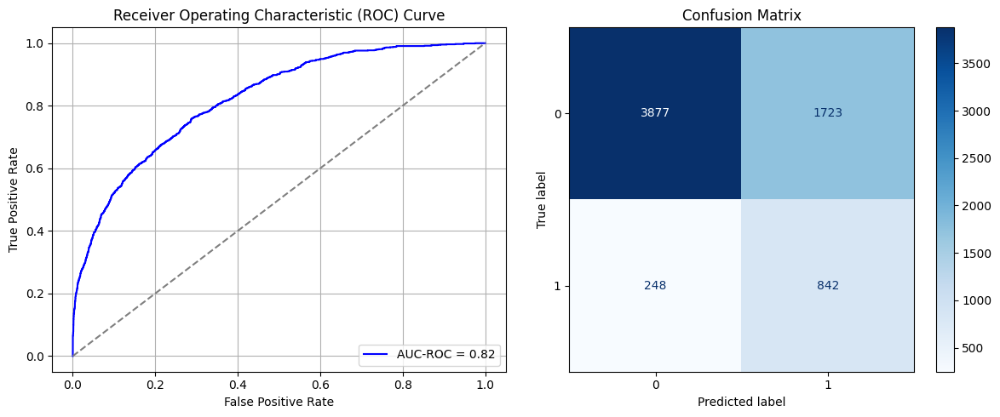

Best threshold based on F1-score: 0.935496985912323
False Negative Rate: 0.22752293577981653
Time elapsed (performance): 0.8992746280018764
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7380 - loss: 0.6008 - val_AUC: 0.8889 - val_loss: 0.4401
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8843 - loss: 0.4306 - val_AUC: 0.9240 - val_loss: 0.3577
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9258 - loss: 0.3511 - val_AUC: 0.9440 - val_loss: 0.3108
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9443 - loss: 0.3049 - val_AUC: 0.9542 - val_loss: 0.2777
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9525 - loss: 0.2817 - val_AUC: 0.9613 - val_loss: 0.2566
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9605 - loss: 0.2567 - val_AUC: 0.9658 - val_loss: 0.2428
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9656 - loss: 0.2400 - val_AUC: 0.9685 - val_loss: 0.2384
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9688 - loss: 0.2281 - val_AUC: 0.9731 - val_loss: 0.2215
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9719 -

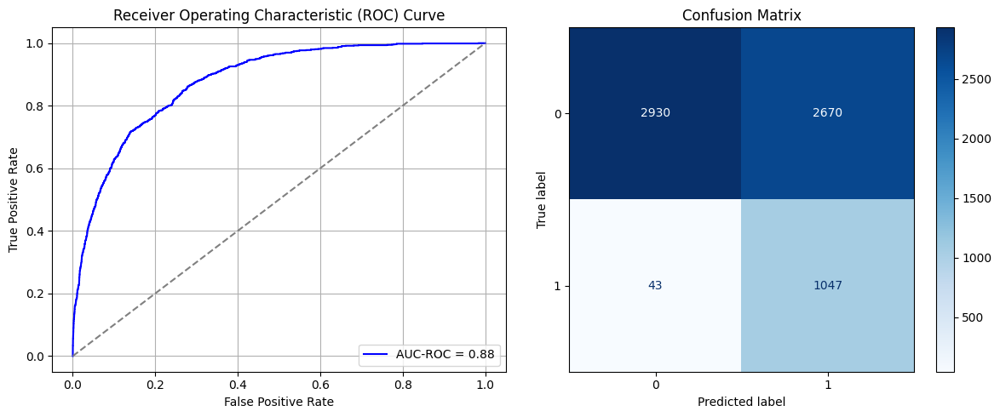

Best threshold based on F1-score: 0.9412559866905212
False Negative Rate: 0.03944954128440367
Time elapsed (performance): 1.2013714790009544
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7415 - loss: 0.5941 - val_AUC: 0.8904 - val_loss: 0.4365
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8868 - loss: 0.4270 - val_AUC: 0.9269 - val_loss: 0.3526
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9266 - loss: 0.3486 - val_AUC: 0.9463 - val_loss: 0.3131
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9437 - loss: 0.3058 - val_AUC: 0.9595 - val_loss: 0.2843
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9528 - loss: 0.2801 - val_AUC: 0.9648 - val_loss: 0.2502
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9600 - loss: 0.2580 - val_AUC: 0.9690 - val_loss: 0.2298
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9654 - loss: 0.2397 - val_AUC: 0.9726 - val_loss: 0.2158
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9685 - loss: 0.2284 - val_AUC: 0.9742 - val_loss: 0.2171
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9715 -

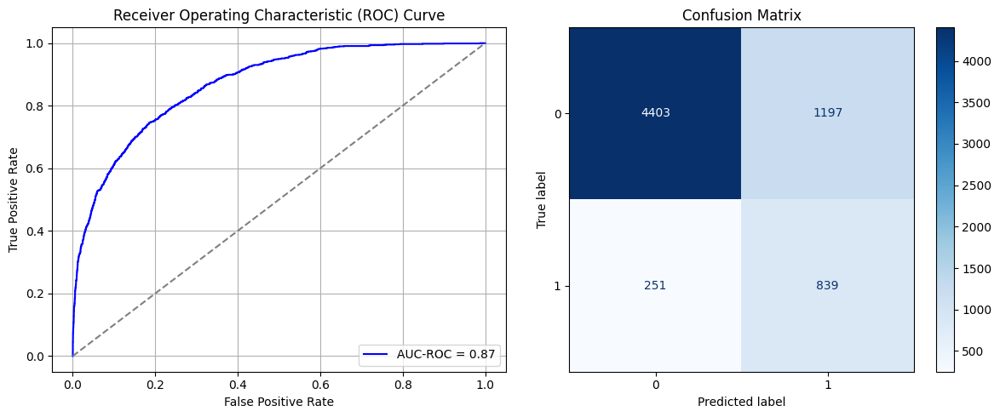

Best threshold based on F1-score: 0.7815211415290833
False Negative Rate: 0.23027522935779818
Time elapsed (performance): 1.880117661999975
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7249 - loss: 0.6083 - val_AUC: 0.8825 - val_loss: 0.4503
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8825 - loss: 0.4329 - val_AUC: 0.9276 - val_loss: 0.3509
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9274 - loss: 0.3465 - val_AUC: 0.9506 - val_loss: 0.2922
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9465 - loss: 0.2987 - val_AUC: 0.9619 - val_loss: 0.2702
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9610 - loss: 0.2562 - val_AUC: 0.9684 - val_loss: 0.2333
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9658 - loss: 0.2385 - val_AUC: 0.9711 - val_loss: 0.2264
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9691 - loss: 0.2262 - val_AUC: 0.9728 - val_loss: 0.2120
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9706 - loss: 0.2196 - val_AUC: 0.9758 - val_loss: 0.1990
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9733 -

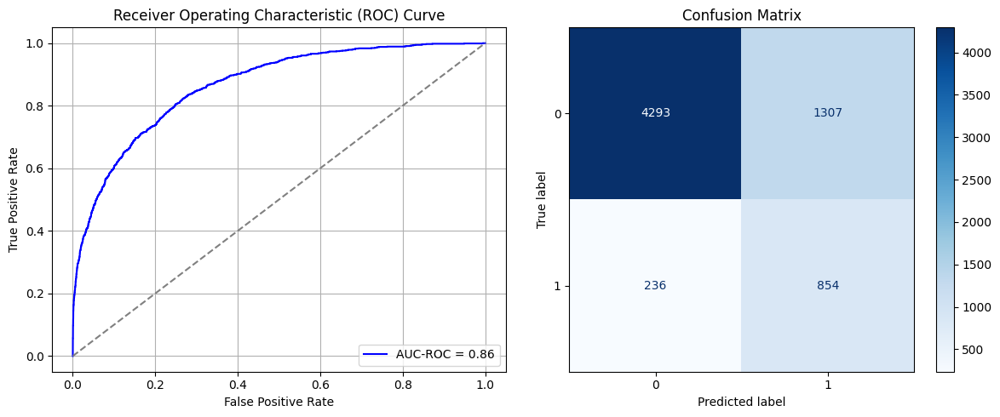

Best threshold based on F1-score: 0.8615045547485352
False Negative Rate: 0.21651376146788992
Time elapsed (performance): 1.9244196459985687
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7166 - loss: 0.6116 - val_AUC: 0.8824 - val_loss: 0.4397
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8890 - loss: 0.4244 - val_AUC: 0.9244 - val_loss: 0.3644
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9242 - loss: 0.3539 - val_AUC: 0.9508 - val_loss: 0.3003
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9473 - loss: 0.2977 - val_AUC: 0.9615 - val_loss: 0.2595
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9592 - loss: 0.2624 - val_AUC: 0.9681 - val_loss: 0.2376
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9638 - loss: 0.2467 - val_AUC: 0.9720 - val_loss: 0.2282
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9677 - loss: 0.2318 - val_AUC: 0.9741 - val_loss: 0.2193
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9700 - loss: 0.2225 - val_AUC: 0.9755 - val_loss: 0.2071
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9712 -

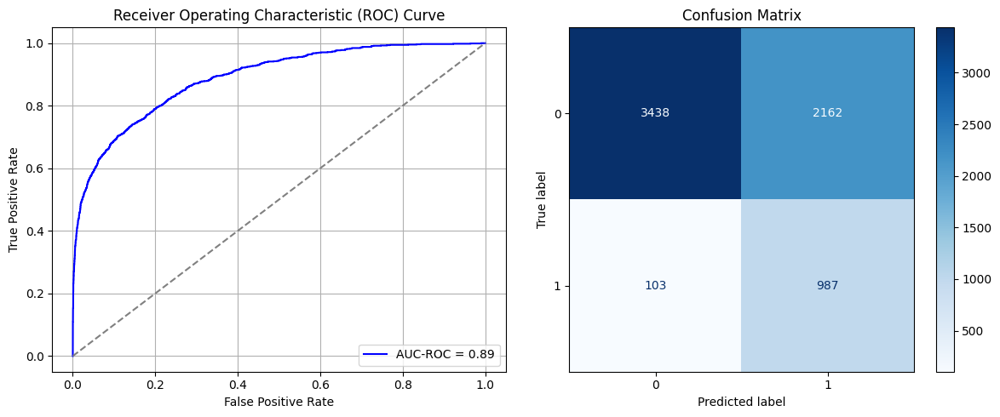

Best threshold based on F1-score: 0.9428849816322327
False Negative Rate: 0.0944954128440367
Time elapsed (performance): 1.099359726998955
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6957 - loss: 0.6213 - val_AUC: 0.8809 - val_loss: 0.4515
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8848 - loss: 0.4305 - val_AUC: 0.9223 - val_loss: 0.3632
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9277 - loss: 0.3466 - val_AUC: 0.9477 - val_loss: 0.3087
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9473 - loss: 0.2968 - val_AUC: 0.9586 - val_loss: 0.2675
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9608 - loss: 0.2562 - val_AUC: 0.9636 - val_loss: 0.2480
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9629 - loss: 0.2484 - val_AUC: 0.9696 - val_loss: 0.2302
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9675 - loss: 0.2317 - val_AUC: 0.9714 - val_loss: 0.2183
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9695 - loss: 0.2236 - val_AUC: 0.9733 - val_loss: 0.2176
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9738 -

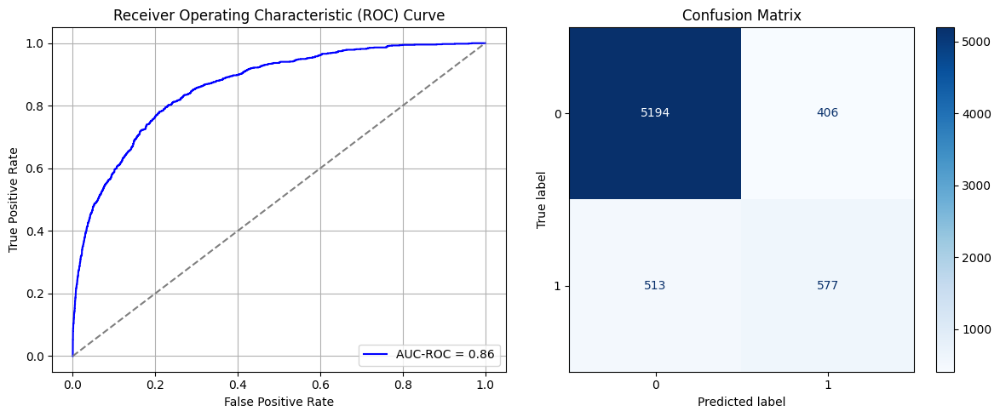

Best threshold based on F1-score: 0.338645339012146
False Negative Rate: 0.4706422018348624
Time elapsed (performance): 1.0963511870031653
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7604 - loss: 0.5795 - val_AUC: 0.9006 - val_loss: 0.4126
Epoch 2/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9071 - loss: 0.3912 - val_AUC: 0.9355 - val_loss: 0.3329
Epoch 3/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9393 - loss: 0.3198 - val_AUC: 0.9546 - val_loss: 0.2822
Epoch 4/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9552 - loss: 0.2749 - val_AUC: 0.9587 - val_loss: 0.2674
Epoch 5/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9605 - loss: 0.2570 - val_AUC: 0.9689 - val_loss: 0.2298
Epoch 6/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9674 - loss: 0.2333 - val_AUC: 0.9720 - val_loss: 0.2192
Epoch 7/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9685 - loss: 0.2286 - val_AUC: 0.9747 - val_loss: 0.2268
Epoch 8/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9751 - loss: 0.2039 - val_AUC: 0.9772 - val_loss: 0.1950
Epoch 9/10
776/776 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9756 -

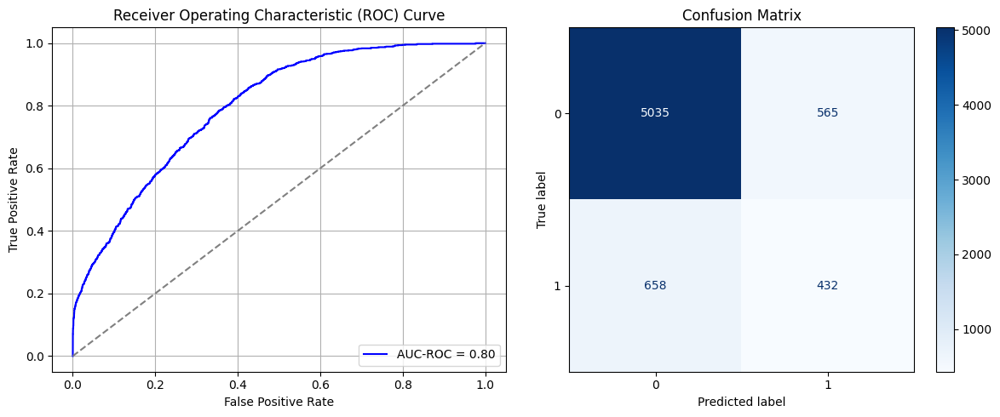

Best threshold based on F1-score: 0.1620970070362091
False Negative Rate: 0.6036697247706422
Time elapsed (performance): 1.0776623199999449


In [60]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_min_ros = data_S_minority.sample(n=oversample_size - undersample_size, replace=True)
    data_S_SRS_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_SRS_ROS = data_S_SRS_ROS.iloc[:, :-1]
    y_S_SRS_ROS = data_S_SRS_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS_ROS, y_S_SRS_ROS, test_size=0.20, random_state=0)
    model_SRS_ROS = create_dnn_model(X_S_train.shape[1])
    result_SRS_ROS = train_and_evaluate(model_SRS_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS_ROS = Transductive_TL(model_SRS_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS_ROS)
    FPR.append(result_TL_SRS_ROS[0])
    TNR.append(result_TL_SRS_ROS[1])
    FNR.append(result_TL_SRS_ROS[2])
    TPR.append(result_TL_SRS_ROS[3])
    TL_time.append(result_TL_SRS_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [61]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.34047706422018353
Variance: 0.04584124678572717


In [62]:
print(ParamFit)
ParamFit.to_csv('SRS_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     27.113152  0.228571  0.771429  0.362385  0.637615     0.802829
1     26.098208  0.756071  0.243929  0.023853  0.976147     1.061956
2     27.853751  0.111071  0.888929  0.270642  0.729358     0.777705
3     35.104571  0.028750  0.971250  0.558716  0.441284     1.044883
4     32.705346  0.086250  0.913750  0.550459  0.449541     1.047170
5     31.730809  0.236964  0.763036  0.260550  0.739450     0.968673
6     33.377465  0.121250  0.878750  0.444954  0.555046     1.072693
7     31.047769  0.247679  0.752321  0.256881  0.743119     1.078125
8     32.790637  0.010000  0.990000  0.705505  0.294495     1.042818
9     32.507714  0.018929  0.981071  0.758716  0.241284     0.810695
10    31.791247  0.477500  0.522500  0.177982  0.822018     1.070396
11    33.706867  0.028393  0.971607  0.681651  0.318349     0.769308
12    30.495296  0.499464  0.500536  0.044954  0.955046     0.796624
13    30.579773  0.032857  0.96714

## Systematic Resampling:

In this case, we examine the possibility of performing Random Oversampling on the minority class using systematic sampling. For this purpose, taking a sampling interval of $k$, we would compile a total of $k*\frac{N_0-N_1}{N_1}$ systematic samples from the minority class in order to balance the dataset. We sample the starting point from 1 to $k$ *with replacement*, since a highly imbalanced dataset will require sampling with replacement in order to achieve a balanced dataset.

In particular, we take $k=10$.

In [63]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

3910
19400


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7409 - loss: 0.6021 - val_AUC: 0.8911 - val_loss: 0.4585
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8998 - loss: 0.4050 - val_AUC: 0.9366 - val_loss: 0.3337
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9399 - loss: 0.3182 - val_AUC: 0.9532 - val_loss: 0.2945
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9530 - loss: 0.2804 - val_AUC: 0.9606 - val_loss: 0.2559
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9630 - loss: 0.2490 - val_AUC: 0.9672 - val_loss: 0.2483
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9665 - loss: 0.2356 - val_AUC: 0.9685 - val_loss: 0.2280
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9708 - loss: 0.2195 - val_AUC: 0.9727 - val_loss: 0.2152
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9743 - loss: 0.2062 - val_AUC: 0.9722 - val_loss: 0.2380
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9752 -

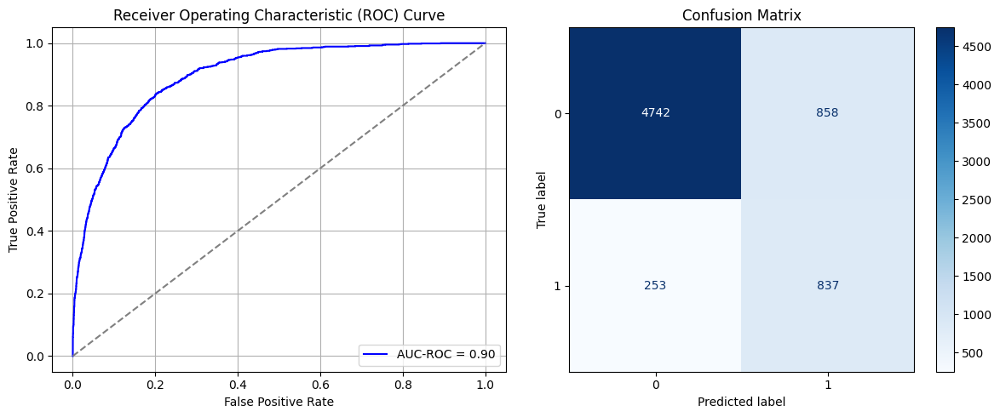

Best threshold based on F1-score: 0.6197632551193237
False Negative Rate: 0.23211009174311928
Time elapsed (performance): 0.7796432180002739
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7301 - loss: 0.6005 - val_AUC: 0.8871 - val_loss: 0.4320
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8915 - loss: 0.4202 - val_AUC: 0.9282 - val_loss: 0.3747
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9236 - loss: 0.3547 - val_AUC: 0.9518 - val_loss: 0.2860
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.9495 - loss: 0.2917 - val_AUC: 0.9622 - val_loss: 0.2567
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9577 - loss: 0.2659 - val_AUC: 0.9679 - val_loss: 0.2501
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9638 - loss: 0.2460 - val_AUC: 0.9734 - val_loss: 0.2153
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9683 - loss: 0.2292 - val_AUC: 0.9731 - val_loss: 0.2153
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9718 - loss: 0.2158 - val_AUC: 0.9786 - val_loss: 0.1878
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9762 -

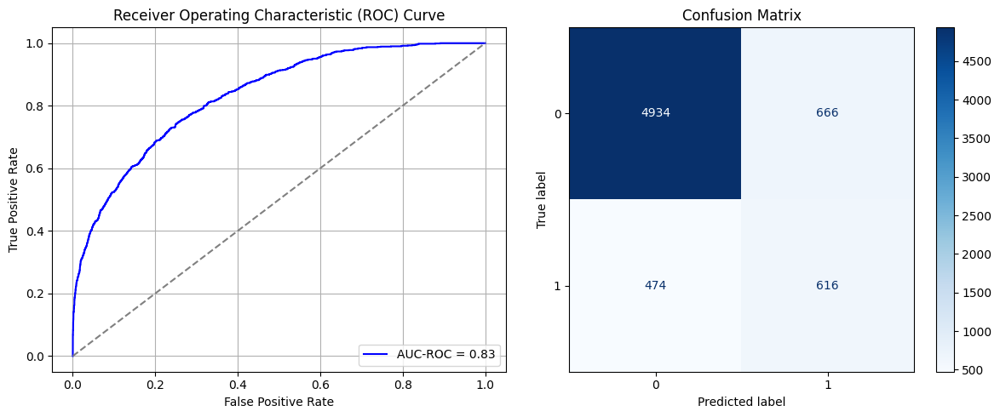

Best threshold based on F1-score: 0.599288821220398
False Negative Rate: 0.43486238532110094
Time elapsed (performance): 0.8029320589994313
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7297 - loss: 0.6056 - val_AUC: 0.8875 - val_loss: 0.4543
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8968 - loss: 0.4116 - val_AUC: 0.9302 - val_loss: 0.3483
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9328 - loss: 0.3350 - val_AUC: 0.9502 - val_loss: 0.2981
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9458 - loss: 0.2999 - val_AUC: 0.9527 - val_loss: 0.2950
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9573 - loss: 0.2677 - val_AUC: 0.9621 - val_loss: 0.2551
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9632 - loss: 0.2471 - val_AUC: 0.9658 - val_loss: 0.2367
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.9648 - loss: 0.2420 - val_AUC: 0.9701 - val_loss: 0.2226
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9700 - loss: 0.2232 - val_AUC: 0.9719 - val_loss: 0.2370
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9714 -

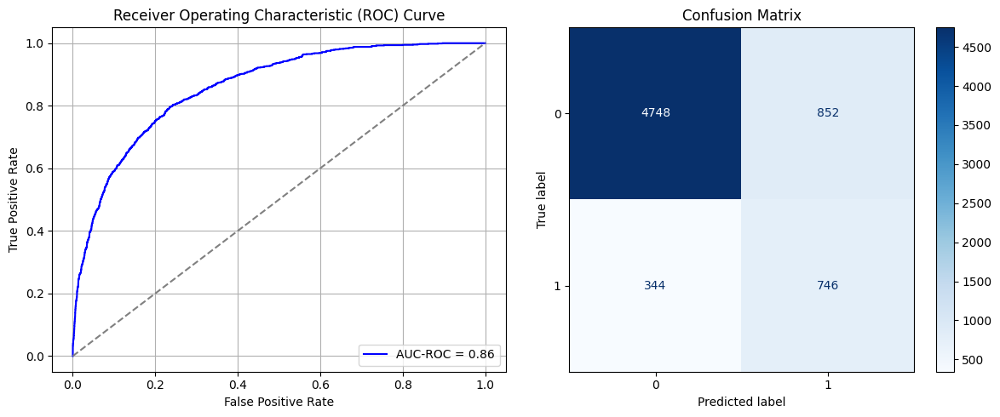

Best threshold based on F1-score: 0.6852054595947266
False Negative Rate: 0.3155963302752294
Time elapsed (performance): 1.0891755040029238
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7494 - loss: 0.5916 - val_AUC: 0.8971 - val_loss: 0.4284
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8984 - loss: 0.4070 - val_AUC: 0.9300 - val_loss: 0.3450
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9280 - loss: 0.3442 - val_AUC: 0.9479 - val_loss: 0.3112
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.9484 - loss: 0.2931 - val_AUC: 0.9614 - val_loss: 0.2552
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9580 - loss: 0.2642 - val_AUC: 0.9643 - val_loss: 0.2489
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.9638 - loss: 0.2450 - val_AUC: 0.9686 - val_loss: 0.2269
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9669 - loss: 0.2330 - val_AUC: 0.9717 - val_loss: 0.2172
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9699 - loss: 0.2220 - val_AUC: 0.9730 - val_loss: 0.2163
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9704 -

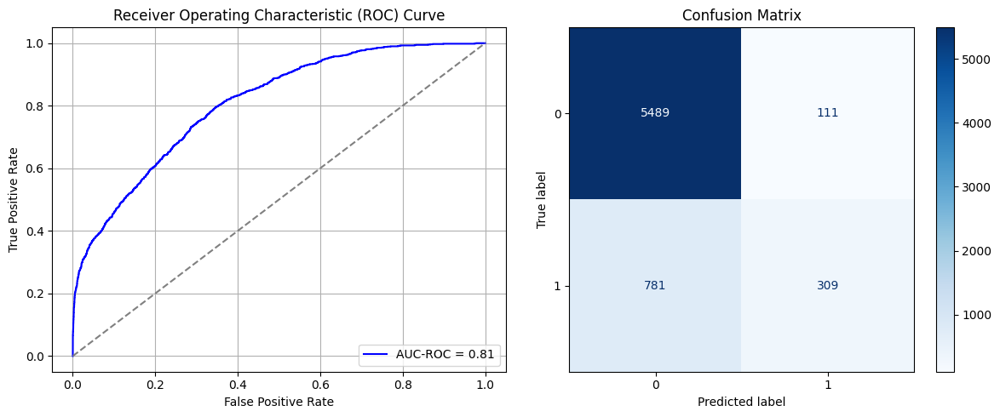

Best threshold based on F1-score: 0.13492411375045776
False Negative Rate: 0.7165137614678899
Time elapsed (performance): 0.8150210259991582
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7136 - loss: 0.6129 - val_AUC: 0.8817 - val_loss: 0.4408
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8934 - loss: 0.4173 - val_AUC: 0.9295 - val_loss: 0.3458
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9285 - loss: 0.3436 - val_AUC: 0.9518 - val_loss: 0.3049
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9470 - loss: 0.2966 - val_AUC: 0.9604 - val_loss: 0.2671
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - AUC: 0.9589 - loss: 0.2619 - val_AUC: 0.9674 - val_loss: 0.2486
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9615 - loss: 0.2526 - val_AUC: 0.9707 - val_loss: 0.2241
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9676 - loss: 0.2317 - val_AUC: 0.9720 - val_loss: 0.2259
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9712 - loss: 0.2178 - val_AUC: 0.9725 - val_loss: 0.2249
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9715 -

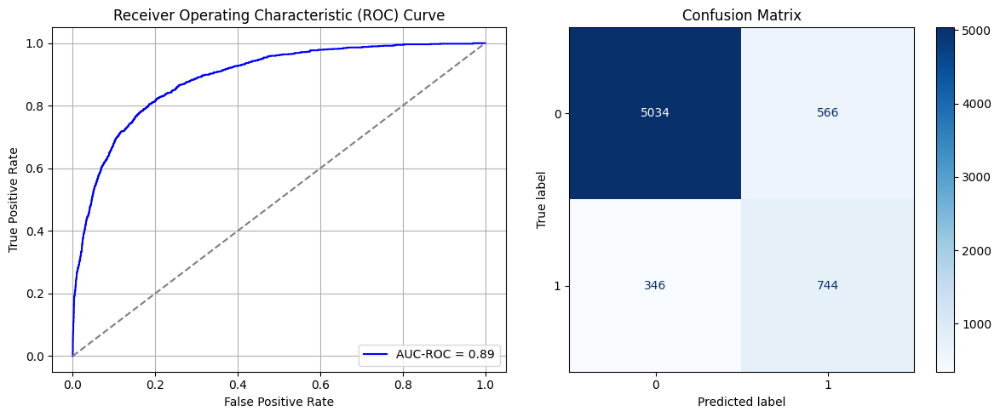

Best threshold based on F1-score: 0.4809838831424713
False Negative Rate: 0.3174311926605505
Time elapsed (performance): 0.7974350600015896
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7249 - loss: 0.6062 - val_AUC: 0.8870 - val_loss: 0.4291
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8948 - loss: 0.4124 - val_AUC: 0.9322 - val_loss: 0.3656
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9356 - loss: 0.3288 - val_AUC: 0.9510 - val_loss: 0.2910
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9517 - loss: 0.2844 - val_AUC: 0.9614 - val_loss: 0.3282
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9600 - loss: 0.2589 - val_AUC: 0.9653 - val_loss: 0.2597
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9651 - loss: 0.2412 - val_AUC: 0.9711 - val_loss: 0.2264
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9658 - loss: 0.2373 - val_AUC: 0.9741 - val_loss: 0.2071
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9692 - loss: 0.2251 - val_AUC: 0.9759 - val_loss: 0.2027
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9723 -

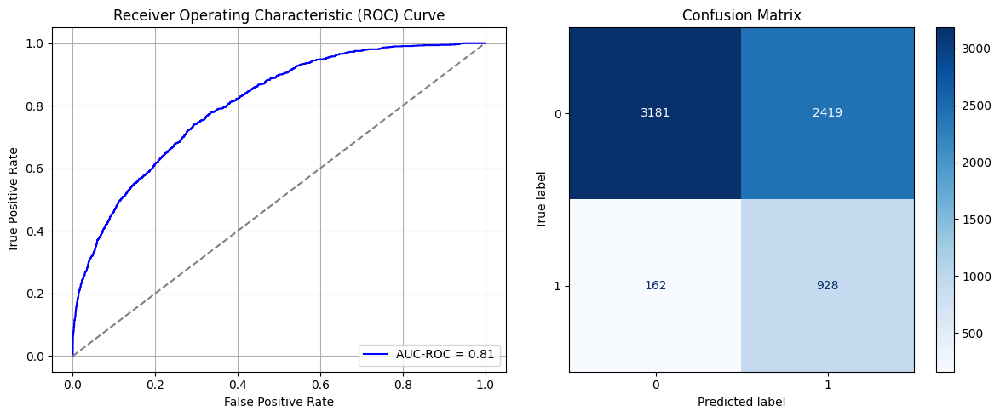

Best threshold based on F1-score: 0.9681795239448547
False Negative Rate: 0.14862385321100918
Time elapsed (performance): 1.0476436400022067
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7446 - loss: 0.5968 - val_AUC: 0.9016 - val_loss: 0.4169
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9023 - loss: 0.4009 - val_AUC: 0.9384 - val_loss: 0.3309
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9348 - loss: 0.3298 - val_AUC: 0.9544 - val_loss: 0.3039
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9462 - loss: 0.2989 - val_AUC: 0.9611 - val_loss: 0.2565
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9560 - loss: 0.2704 - val_AUC: 0.9643 - val_loss: 0.2432
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9624 - loss: 0.2492 - val_AUC: 0.9679 - val_loss: 0.2363
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9662 - loss: 0.2359 - val_AUC: 0.9698 - val_loss: 0.2271
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9692 - loss: 0.2252 - val_AUC: 0.9699 - val_loss: 0.2240
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9720 -

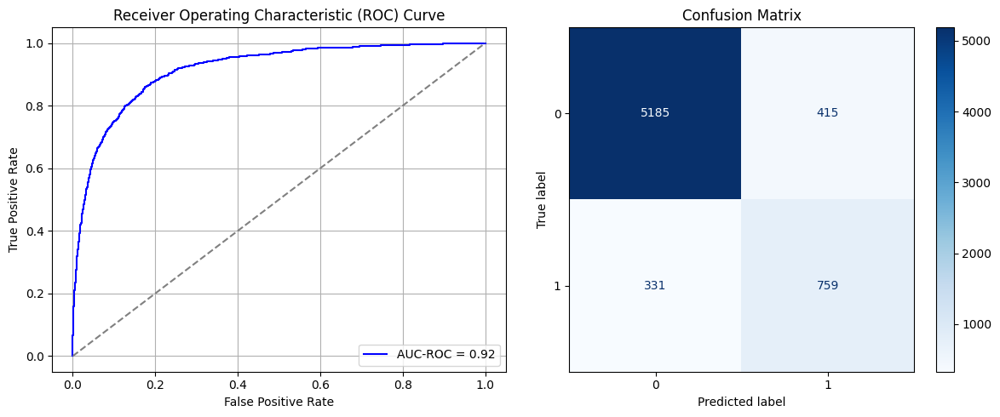

Best threshold based on F1-score: 0.565554678440094
False Negative Rate: 0.3036697247706422
Time elapsed (performance): 1.0374148709997826
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7342 - loss: 0.6017 - val_AUC: 0.8834 - val_loss: 0.4382
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8879 - loss: 0.4238 - val_AUC: 0.9264 - val_loss: 0.3618
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9276 - loss: 0.3478 - val_AUC: 0.9462 - val_loss: 0.3037
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9447 - loss: 0.3039 - val_AUC: 0.9570 - val_loss: 0.2714
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9561 - loss: 0.2710 - val_AUC: 0.9644 - val_loss: 0.2447
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9614 - loss: 0.2535 - val_AUC: 0.9673 - val_loss: 0.2449
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9669 - loss: 0.2348 - val_AUC: 0.9696 - val_loss: 0.2451
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9699 - loss: 0.2244 - val_AUC: 0.9724 - val_loss: 0.2242
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9718 -

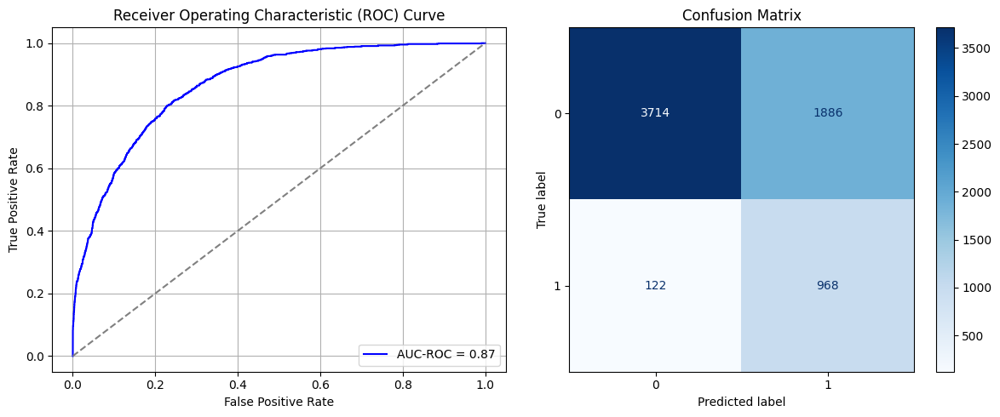

Best threshold based on F1-score: 0.9068543910980225
False Negative Rate: 0.11192660550458716
Time elapsed (performance): 1.0446588119993976
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7227 - loss: 0.6099 - val_AUC: 0.8844 - val_loss: 0.4516
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8929 - loss: 0.4171 - val_AUC: 0.9242 - val_loss: 0.3564
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9219 - loss: 0.3569 - val_AUC: 0.9423 - val_loss: 0.3660
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9395 - loss: 0.3163 - val_AUC: 0.9545 - val_loss: 0.2943
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9530 - loss: 0.2795 - val_AUC: 0.9638 - val_loss: 0.2541
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9622 - loss: 0.2509 - val_AUC: 0.9678 - val_loss: 0.2346
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9657 - loss: 0.2387 - val_AUC: 0.9709 - val_loss: 0.2231
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9665 - loss: 0.2370 - val_AUC: 0.9740 - val_loss: 0.2562
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9697 -

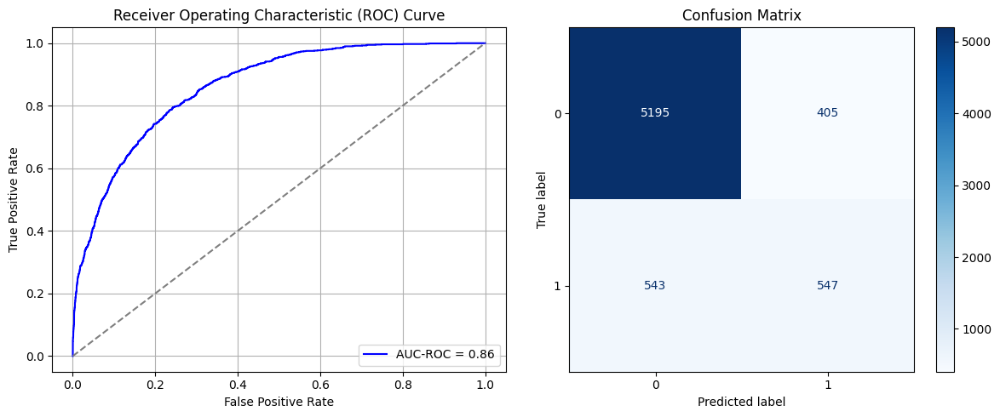

Best threshold based on F1-score: 0.3455677628517151
False Negative Rate: 0.4981651376146789
Time elapsed (performance): 0.8112019689979206
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7470 - loss: 0.5926 - val_AUC: 0.8911 - val_loss: 0.4254
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8957 - loss: 0.4123 - val_AUC: 0.9312 - val_loss: 0.3404
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.9335 - loss: 0.3323 - val_AUC: 0.9480 - val_loss: 0.2985
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9486 - loss: 0.2922 - val_AUC: 0.9568 - val_loss: 0.2683
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9574 - loss: 0.2659 - val_AUC: 0.9637 - val_loss: 0.2465
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9601 - loss: 0.2564 - val_AUC: 0.9661 - val_loss: 0.2462
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9695 - loss: 0.2240 - val_AUC: 0.9692 - val_loss: 0.2245
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9679 - loss: 0.2299 - val_AUC: 0.9728 - val_loss: 0.2263
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9708 -

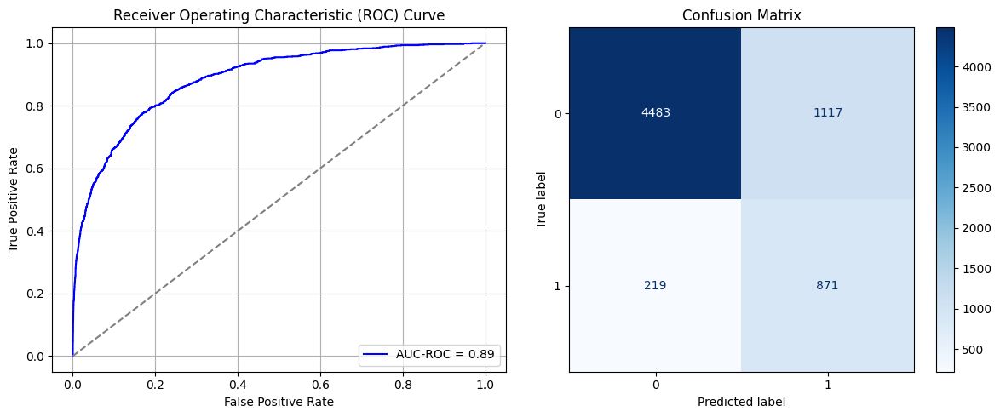

Best threshold based on F1-score: 0.7599620819091797
False Negative Rate: 0.20091743119266056
Time elapsed (performance): 0.8408554519992322
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7308 - loss: 0.6032 - val_AUC: 0.8821 - val_loss: 0.4415
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8859 - loss: 0.4294 - val_AUC: 0.9243 - val_loss: 0.3561
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9257 - loss: 0.3510 - val_AUC: 0.9459 - val_loss: 0.3072
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9432 - loss: 0.3080 - val_AUC: 0.9559 - val_loss: 0.2869
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9540 - loss: 0.2764 - val_AUC: 0.9640 - val_loss: 0.2479
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9639 - loss: 0.2459 - val_AUC: 0.9672 - val_loss: 0.2569
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9648 - loss: 0.2414 - val_AUC: 0.9706 - val_loss: 0.2230
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9682 - loss: 0.2283 - val_AUC: 0.9738 - val_loss: 0.2082
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9736 -

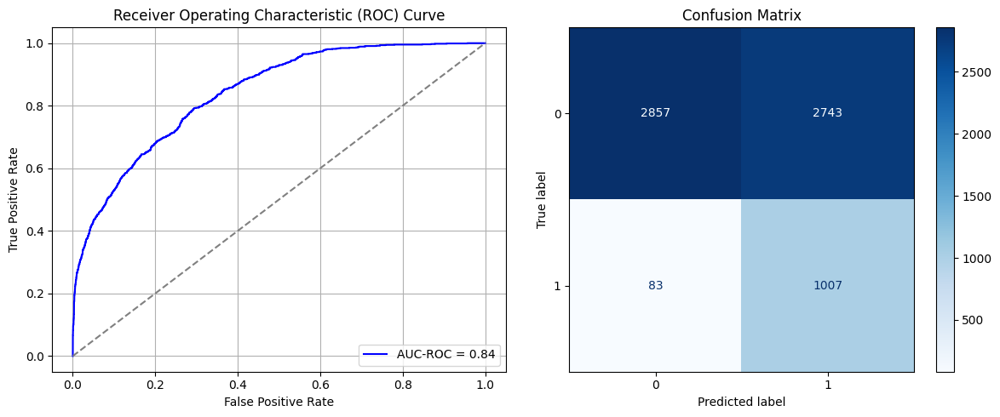

Best threshold based on F1-score: 0.9626246690750122
False Negative Rate: 0.07614678899082569
Time elapsed (performance): 1.0478921359972446
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7431 - loss: 0.5892 - val_AUC: 0.8997 - val_loss: 0.4085
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9002 - loss: 0.4028 - val_AUC: 0.9322 - val_loss: 0.3567
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9369 - loss: 0.3261 - val_AUC: 0.9525 - val_loss: 0.3521
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9503 - loss: 0.2898 - val_AUC: 0.9614 - val_loss: 0.2543
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9582 - loss: 0.2638 - val_AUC: 0.9651 - val_loss: 0.2429
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9634 - loss: 0.2463 - val_AUC: 0.9706 - val_loss: 0.2203
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9689 - loss: 0.2278 - val_AUC: 0.9730 - val_loss: 0.2126
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9723 - loss: 0.2145 - val_AUC: 0.9733 - val_loss: 0.2125
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9739 -

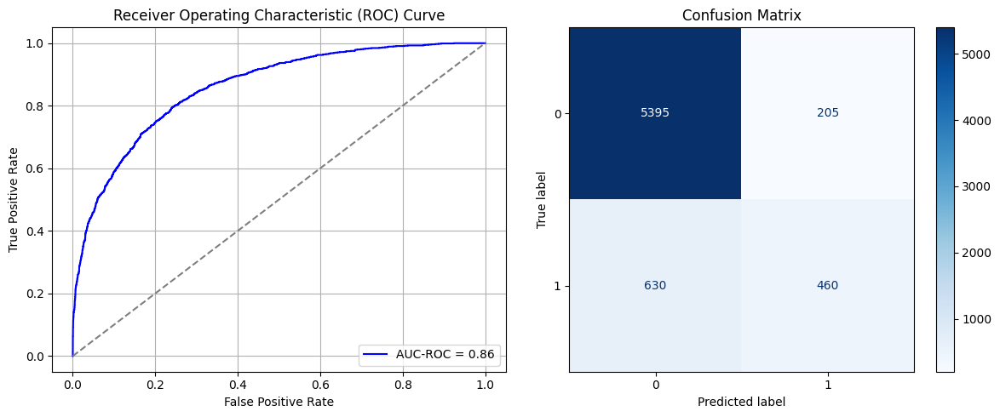

Best threshold based on F1-score: 0.24315951764583588
False Negative Rate: 0.5779816513761468
Time elapsed (performance): 0.8301753920022747
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7283 - loss: 0.6078 - val_AUC: 0.8727 - val_loss: 0.4602
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8868 - loss: 0.4268 - val_AUC: 0.9125 - val_loss: 0.3765
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9221 - loss: 0.3568 - val_AUC: 0.9386 - val_loss: 0.3558
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9394 - loss: 0.3179 - val_AUC: 0.9517 - val_loss: 0.2879
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9538 - loss: 0.2789 - val_AUC: 0.9612 - val_loss: 0.2577
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9623 - loss: 0.2523 - val_AUC: 0.9642 - val_loss: 0.2445
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9656 - loss: 0.2403 - val_AUC: 0.9699 - val_loss: 0.2293
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9687 - loss: 0.2287 - val_AUC: 0.9706 - val_loss: 0.2278
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9734 -

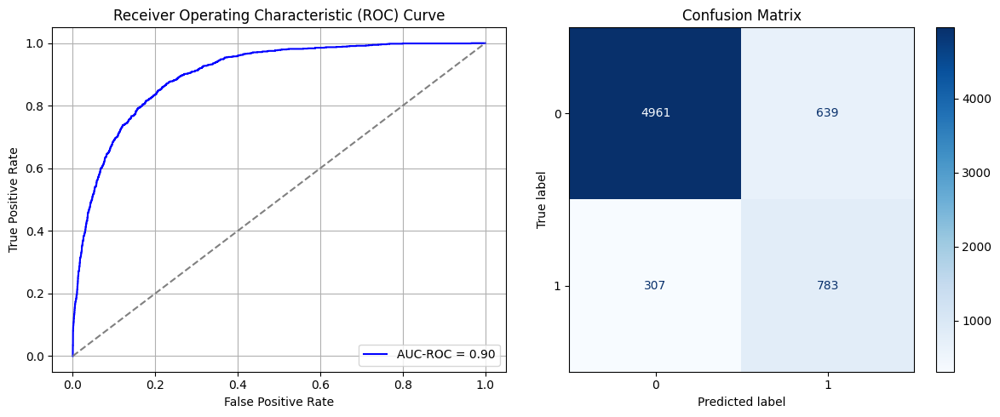

Best threshold based on F1-score: 0.582344651222229
False Negative Rate: 0.281651376146789
Time elapsed (performance): 0.7698335530003533
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7357 - loss: 0.6036 - val_AUC: 0.8926 - val_loss: 0.4338
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8902 - loss: 0.4235 - val_AUC: 0.9268 - val_loss: 0.3545
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9262 - loss: 0.3507 - val_AUC: 0.9500 - val_loss: 0.2933
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9453 - loss: 0.3019 - val_AUC: 0.9608 - val_loss: 0.2645
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9551 - loss: 0.2729 - val_AUC: 0.9668 - val_loss: 0.2364
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9644 - loss: 0.2432 - val_AUC: 0.9710 - val_loss: 0.2297
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9666 - loss: 0.2353 - val_AUC: 0.9736 - val_loss: 0.2111
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9698 - loss: 0.2231 - val_AUC: 0.9741 - val_loss: 0.2057
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9732 -

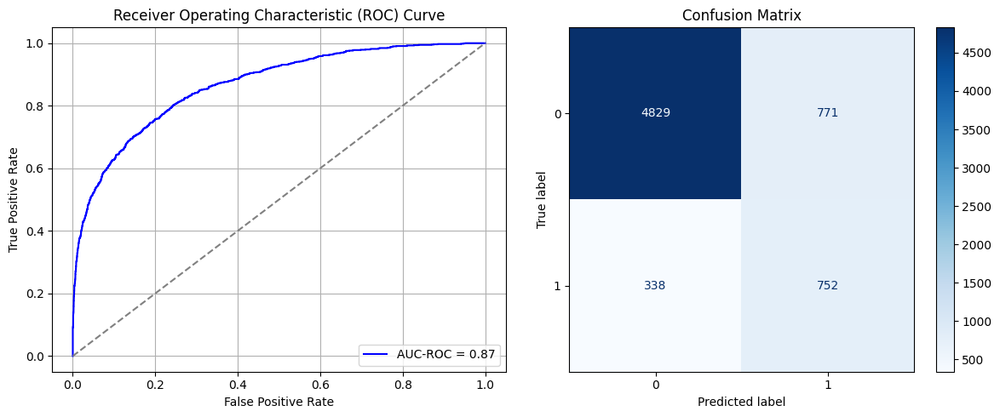

Best threshold based on F1-score: 0.6963047385215759
False Negative Rate: 0.3100917431192661
Time elapsed (performance): 1.2104319850004686
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7349 - loss: 0.6006 - val_AUC: 0.9036 - val_loss: 0.4110
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9048 - loss: 0.3971 - val_AUC: 0.9406 - val_loss: 0.3208
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9338 - loss: 0.3322 - val_AUC: 0.9503 - val_loss: 0.3009
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9498 - loss: 0.2891 - val_AUC: 0.9589 - val_loss: 0.2689
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9590 - loss: 0.2618 - val_AUC: 0.9641 - val_loss: 0.2915
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9641 - loss: 0.2453 - val_AUC: 0.9685 - val_loss: 0.2368
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9698 - loss: 0.2239 - val_AUC: 0.9725 - val_loss: 0.2149
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9713 - loss: 0.2171 - val_AUC: 0.9749 - val_loss: 0.2034
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9746 -

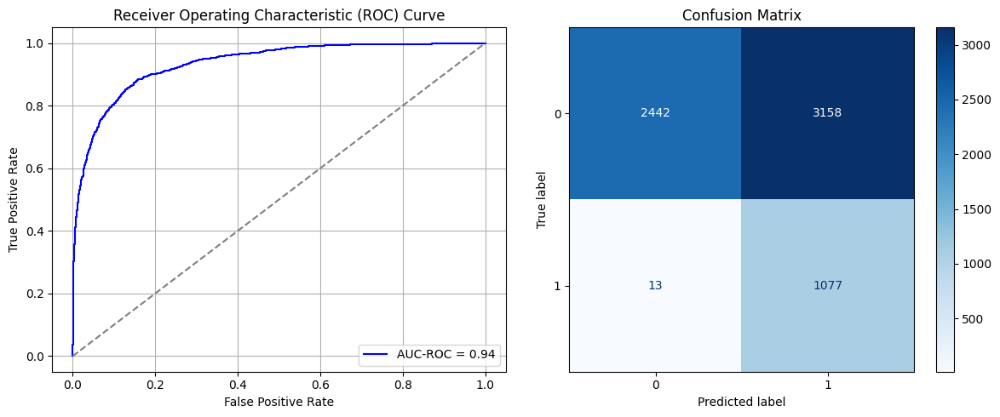

Best threshold based on F1-score: 0.9699392318725586
False Negative Rate: 0.011926605504587157
Time elapsed (performance): 0.8257790070019837
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7261 - loss: 0.6073 - val_AUC: 0.8907 - val_loss: 0.4345
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8973 - loss: 0.4111 - val_AUC: 0.9324 - val_loss: 0.3426
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9297 - loss: 0.3425 - val_AUC: 0.9515 - val_loss: 0.2901
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9496 - loss: 0.2911 - val_AUC: 0.9614 - val_loss: 0.2568
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9573 - loss: 0.2666 - val_AUC: 0.9636 - val_loss: 0.2589
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9626 - loss: 0.2493 - val_AUC: 0.9687 - val_loss: 0.2291
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9664 - loss: 0.2361 - val_AUC: 0.9707 - val_loss: 0.2361
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9704 - loss: 0.2217 - val_AUC: 0.9725 - val_loss: 0.2170
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9710 -

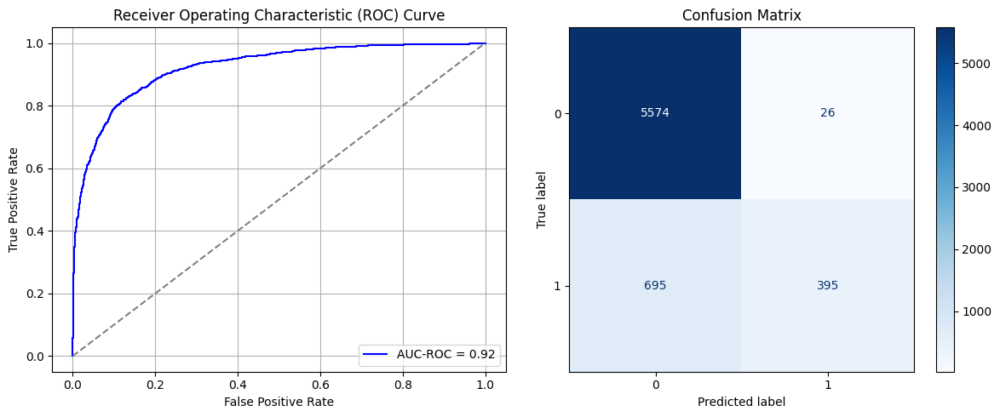

Best threshold based on F1-score: 0.07422076910734177
False Negative Rate: 0.6376146788990825
Time elapsed (performance): 0.8361505940010829
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7521 - loss: 0.5939 - val_AUC: 0.8745 - val_loss: 0.4825
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8816 - loss: 0.4341 - val_AUC: 0.9205 - val_loss: 0.3650
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9273 - loss: 0.3473 - val_AUC: 0.9469 - val_loss: 0.3057
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9442 - loss: 0.3049 - val_AUC: 0.9599 - val_loss: 0.2673
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9579 - loss: 0.2656 - val_AUC: 0.9639 - val_loss: 0.2463
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9650 - loss: 0.2420 - val_AUC: 0.9697 - val_loss: 0.2319
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9683 - loss: 0.2296 - val_AUC: 0.9732 - val_loss: 0.2111
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9722 - loss: 0.2143 - val_AUC: 0.9759 - val_loss: 0.2002
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9749 -

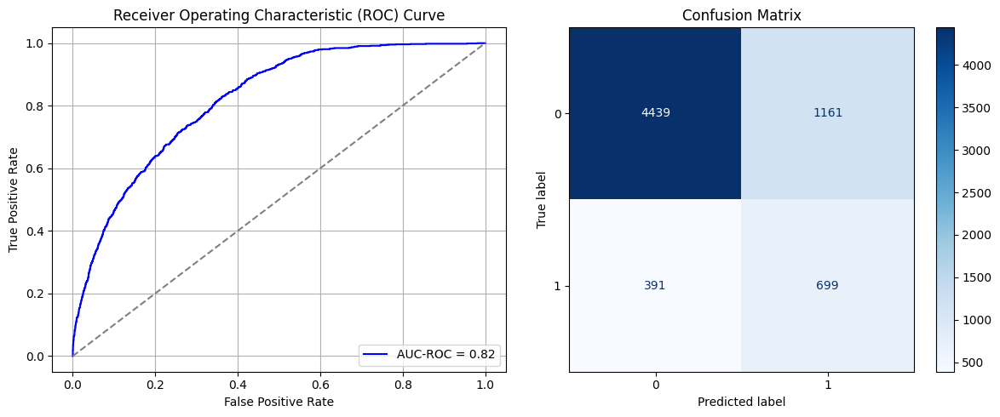

Best threshold based on F1-score: 0.6695607304573059
False Negative Rate: 0.3587155963302752
Time elapsed (performance): 0.8317519789998187
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7556 - loss: 0.5897 - val_AUC: 0.8704 - val_loss: 0.4744
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8692 - loss: 0.4522 - val_AUC: 0.9076 - val_loss: 0.3934
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9066 - loss: 0.3896 - val_AUC: 0.9350 - val_loss: 0.3367
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9319 - loss: 0.3354 - val_AUC: 0.9526 - val_loss: 0.2884
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9521 - loss: 0.2844 - val_AUC: 0.9604 - val_loss: 0.2600
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9589 - loss: 0.2620 - val_AUC: 0.9685 - val_loss: 0.2417
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9630 - loss: 0.2482 - val_AUC: 0.9689 - val_loss: 0.2320
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9684 - loss: 0.2292 - val_AUC: 0.9729 - val_loss: 0.2277
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9716 -

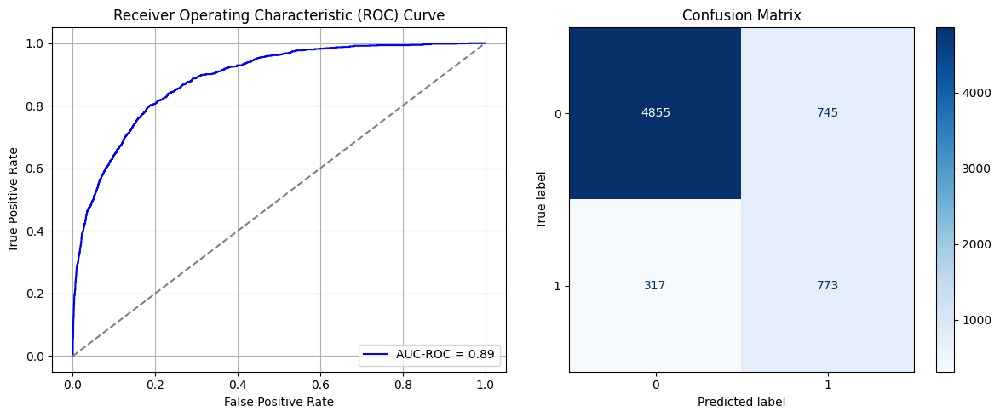

Best threshold based on F1-score: 0.685259997844696
False Negative Rate: 0.2908256880733945
Time elapsed (performance): 1.0334862580020854
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7329 - loss: 0.6046 - val_AUC: 0.8922 - val_loss: 0.4327
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9013 - loss: 0.4046 - val_AUC: 0.9385 - val_loss: 0.3335
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9374 - loss: 0.3247 - val_AUC: 0.9553 - val_loss: 0.2852
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9534 - loss: 0.2805 - val_AUC: 0.9637 - val_loss: 0.2544
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9629 - loss: 0.2505 - val_AUC: 0.9628 - val_loss: 0.2651
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9664 - loss: 0.2375 - val_AUC: 0.9718 - val_loss: 0.2253
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9698 - loss: 0.2243 - val_AUC: 0.9699 - val_loss: 0.2304
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9729 - loss: 0.2116 - val_AUC: 0.9743 - val_loss: 0.2121
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9742 -

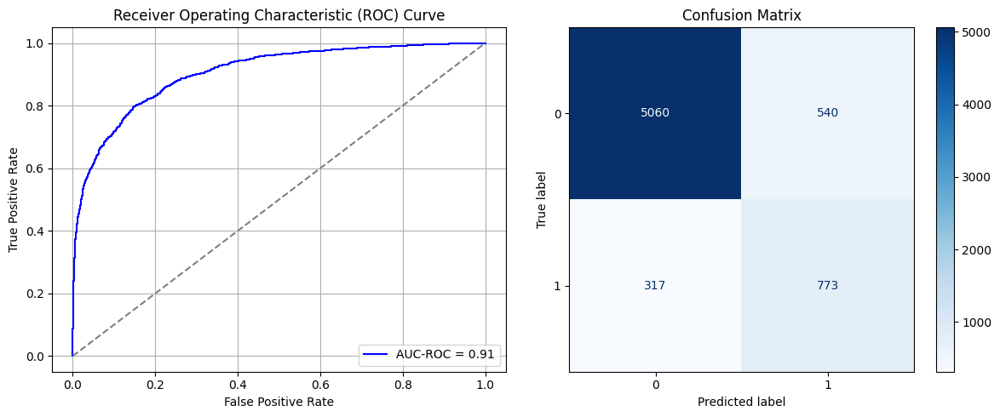

Best threshold based on F1-score: 0.5909833908081055
False Negative Rate: 0.2908256880733945
Time elapsed (performance): 0.8135264670017932
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7313 - loss: 0.6061 - val_AUC: 0.8840 - val_loss: 0.4517
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8831 - loss: 0.4331 - val_AUC: 0.9270 - val_loss: 0.3787
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9271 - loss: 0.3479 - val_AUC: 0.9492 - val_loss: 0.2990
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9497 - loss: 0.2921 - val_AUC: 0.9601 - val_loss: 0.2724
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9575 - loss: 0.2677 - val_AUC: 0.9676 - val_loss: 0.2411
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9633 - loss: 0.2481 - val_AUC: 0.9711 - val_loss: 0.2249
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9653 - loss: 0.2402 - val_AUC: 0.9740 - val_loss: 0.2158
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9710 - loss: 0.2196 - val_AUC: 0.9736 - val_loss: 0.2170
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9717 -

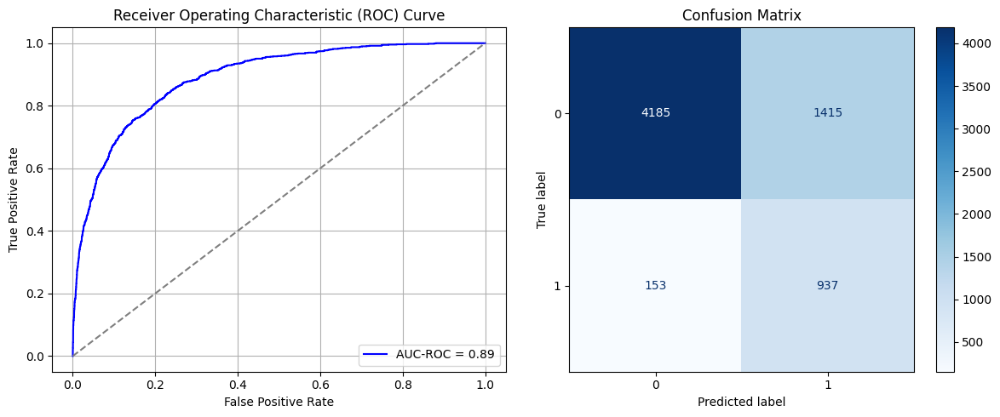

Best threshold based on F1-score: 0.8661530017852783
False Negative Rate: 0.14036697247706423
Time elapsed (performance): 1.0302522130004945
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7246 - loss: 0.6045 - val_AUC: 0.8829 - val_loss: 0.4597
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8851 - loss: 0.4304 - val_AUC: 0.9253 - val_loss: 0.3713
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9247 - loss: 0.3542 - val_AUC: 0.9452 - val_loss: 0.3069
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9453 - loss: 0.3038 - val_AUC: 0.9575 - val_loss: 0.2705
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9563 - loss: 0.2713 - val_AUC: 0.9660 - val_loss: 0.2533
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9625 - loss: 0.2506 - val_AUC: 0.9692 - val_loss: 0.2286
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9689 - loss: 0.2279 - val_AUC: 0.9677 - val_loss: 0.2568
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9701 - loss: 0.2236 - val_AUC: 0.9743 - val_loss: 0.2164
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9735 -

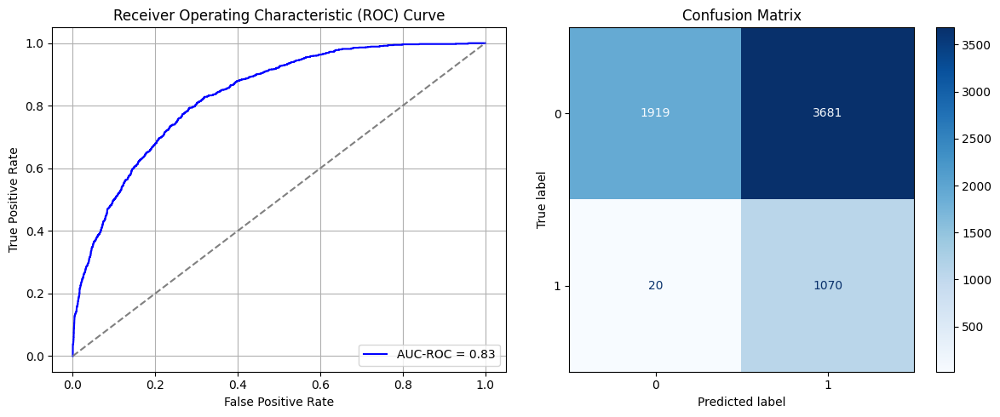

Best threshold based on F1-score: 0.9806779026985168
False Negative Rate: 0.01834862385321101
Time elapsed (performance): 0.8662057209985505
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7368 - loss: 0.5969 - val_AUC: 0.9019 - val_loss: 0.4178
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9068 - loss: 0.3925 - val_AUC: 0.9364 - val_loss: 0.3345
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9355 - loss: 0.3280 - val_AUC: 0.9511 - val_loss: 0.3054
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9510 - loss: 0.2862 - val_AUC: 0.9606 - val_loss: 0.2668
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9625 - loss: 0.2505 - val_AUC: 0.9679 - val_loss: 0.2324
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9651 - loss: 0.2403 - val_AUC: 0.9706 - val_loss: 0.2204
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9701 - loss: 0.2221 - val_AUC: 0.9727 - val_loss: 0.2369
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9713 - loss: 0.2179 - val_AUC: 0.9727 - val_loss: 0.2097
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9742 -

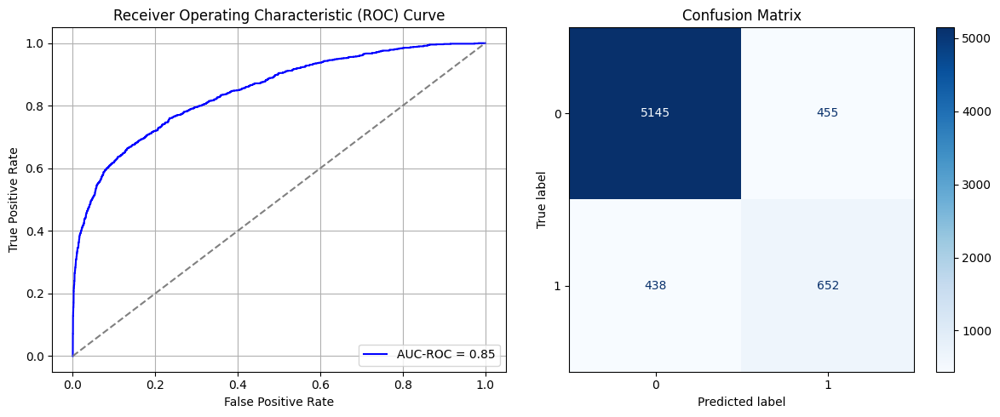

Best threshold based on F1-score: 0.5409088730812073
False Negative Rate: 0.4018348623853211
Time elapsed (performance): 0.8594521820014052
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7237 - loss: 0.6080 - val_AUC: 0.8730 - val_loss: 0.4501
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.4512 - val_AUC: 0.9149 - val_loss: 0.3948
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9158 - loss: 0.3728 - val_AUC: 0.9417 - val_loss: 0.3242
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9419 - loss: 0.3132 - val_AUC: 0.9578 - val_loss: 0.2753
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9533 - loss: 0.2798 - val_AUC: 0.9643 - val_loss: 0.2490
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9614 - loss: 0.2544 - val_AUC: 0.9695 - val_loss: 0.2276
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9670 - loss: 0.2351 - val_AUC: 0.9718 - val_loss: 0.2278
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9687 - loss: 0.2283 - val_AUC: 0.9745 - val_loss: 0.2079
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9694 -

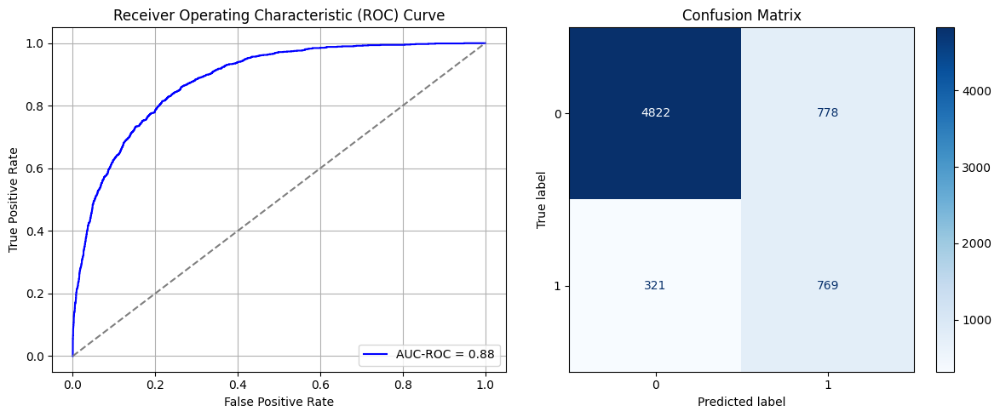

Best threshold based on F1-score: 0.5682417750358582
False Negative Rate: 0.2944954128440367
Time elapsed (performance): 0.8156907939992379
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7183 - loss: 0.6143 - val_AUC: 0.8807 - val_loss: 0.4545
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8846 - loss: 0.4325 - val_AUC: 0.9150 - val_loss: 0.4130
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9184 - loss: 0.3660 - val_AUC: 0.9392 - val_loss: 0.3421
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9402 - loss: 0.3153 - val_AUC: 0.9558 - val_loss: 0.2746
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9533 - loss: 0.2791 - val_AUC: 0.9612 - val_loss: 0.2562
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9610 - loss: 0.2558 - val_AUC: 0.9665 - val_loss: 0.2374
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9633 - loss: 0.2469 - val_AUC: 0.9690 - val_loss: 0.2488
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9654 - loss: 0.2393 - val_AUC: 0.9700 - val_loss: 0.2411
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9695 -

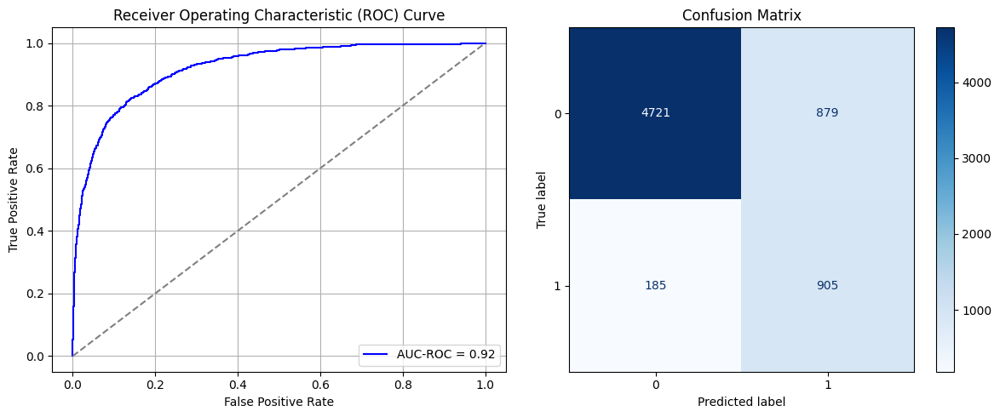

Best threshold based on F1-score: 0.7746785879135132
False Negative Rate: 0.16972477064220184
Time elapsed (performance): 1.1956880260004255
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7560 - loss: 0.5864 - val_AUC: 0.8956 - val_loss: 0.4150
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8999 - loss: 0.4038 - val_AUC: 0.9348 - val_loss: 0.3361
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9340 - loss: 0.3316 - val_AUC: 0.9517 - val_loss: 0.2986
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9482 - loss: 0.2932 - val_AUC: 0.9600 - val_loss: 0.2593
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9596 - loss: 0.2589 - val_AUC: 0.9675 - val_loss: 0.2365
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9659 - loss: 0.2384 - val_AUC: 0.9702 - val_loss: 0.2288
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9671 - loss: 0.2329 - val_AUC: 0.9728 - val_loss: 0.2114
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9716 - loss: 0.2162 - val_AUC: 0.9760 - val_loss: 0.2067
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9735 -

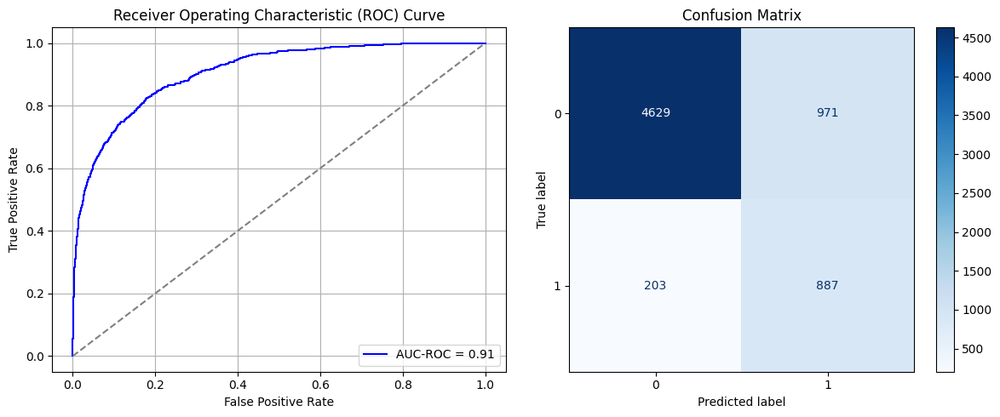

Best threshold based on F1-score: 0.7805111408233643
False Negative Rate: 0.18623853211009175
Time elapsed (performance): 0.8720484250006848
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7468 - loss: 0.5957 - val_AUC: 0.8958 - val_loss: 0.4371
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9017 - loss: 0.4037 - val_AUC: 0.9321 - val_loss: 0.3418
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9391 - loss: 0.3215 - val_AUC: 0.9478 - val_loss: 0.3222
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9532 - loss: 0.2801 - val_AUC: 0.9642 - val_loss: 0.2548
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9626 - loss: 0.2500 - val_AUC: 0.9683 - val_loss: 0.2315
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9658 - loss: 0.2382 - val_AUC: 0.9712 - val_loss: 0.2284
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9685 - loss: 0.2286 - val_AUC: 0.9733 - val_loss: 0.2395
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9691 - loss: 0.2251 - val_AUC: 0.9747 - val_loss: 0.2448
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9732 -

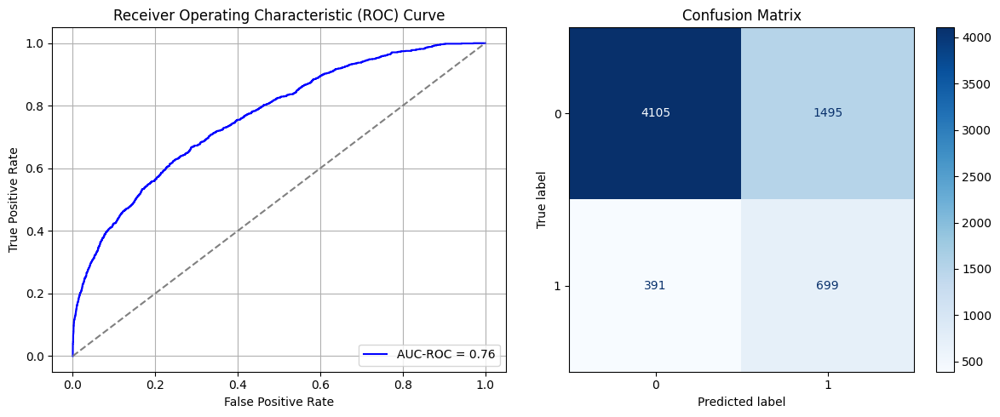

Best threshold based on F1-score: 0.7061058282852173
False Negative Rate: 0.3587155963302752
Time elapsed (performance): 0.8989452980022179
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7306 - loss: 0.6026 - val_AUC: 0.8913 - val_loss: 0.4222
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9014 - loss: 0.4035 - val_AUC: 0.9397 - val_loss: 0.3272
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9402 - loss: 0.3173 - val_AUC: 0.9501 - val_loss: 0.3795
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9529 - loss: 0.2818 - val_AUC: 0.9647 - val_loss: 0.2443
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9612 - loss: 0.2538 - val_AUC: 0.9682 - val_loss: 0.2329
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9681 - loss: 0.2303 - val_AUC: 0.9711 - val_loss: 0.2323
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9664 - loss: 0.2360 - val_AUC: 0.9747 - val_loss: 0.2077
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9720 - loss: 0.2151 - val_AUC: 0.9750 - val_loss: 0.2023
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9716 -

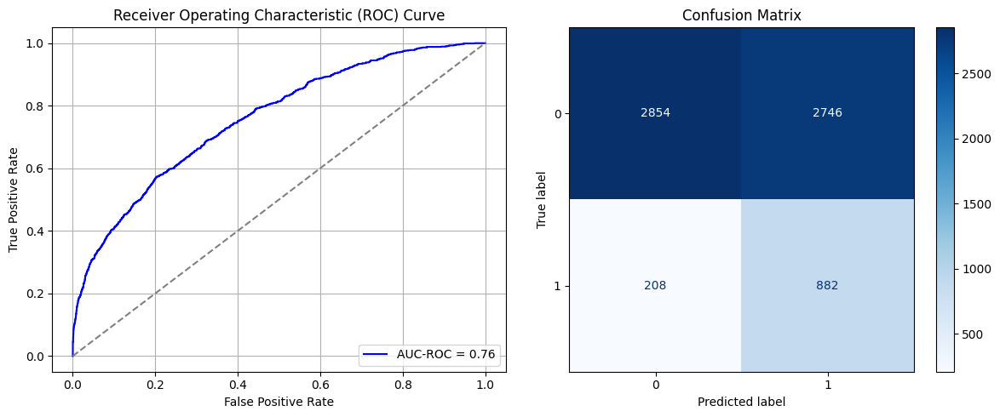

Best threshold based on F1-score: 0.8923444747924805
False Negative Rate: 0.1908256880733945
Time elapsed (performance): 0.8748940639998182
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7305 - loss: 0.6062 - val_AUC: 0.8854 - val_loss: 0.4609
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8886 - loss: 0.4234 - val_AUC: 0.9293 - val_loss: 0.3476
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9308 - loss: 0.3391 - val_AUC: 0.9525 - val_loss: 0.2931
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9521 - loss: 0.2847 - val_AUC: 0.9617 - val_loss: 0.2659
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9590 - loss: 0.2626 - val_AUC: 0.9654 - val_loss: 0.2540
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9672 - loss: 0.2342 - val_AUC: 0.9735 - val_loss: 0.2183
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9704 - loss: 0.2213 - val_AUC: 0.9735 - val_loss: 0.2121
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9745 - loss: 0.2055 - val_AUC: 0.9725 - val_loss: 0.2126
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9775 -

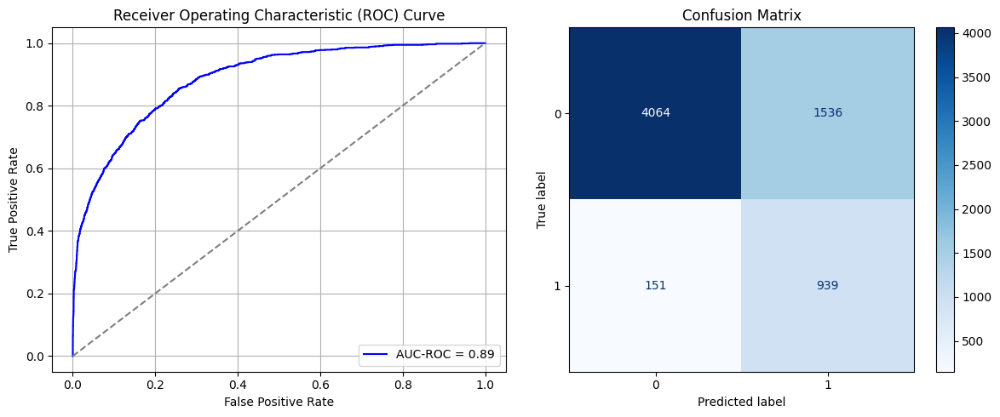

Best threshold based on F1-score: 0.936857283115387
False Negative Rate: 0.13853211009174313
Time elapsed (performance): 0.824543899998389
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7247 - loss: 0.6063 - val_AUC: 0.8863 - val_loss: 0.4373
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8890 - loss: 0.4226 - val_AUC: 0.9236 - val_loss: 0.3995
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9252 - loss: 0.3535 - val_AUC: 0.9441 - val_loss: 0.3141
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9446 - loss: 0.3055 - val_AUC: 0.9556 - val_loss: 0.3161
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9559 - loss: 0.2717 - val_AUC: 0.9629 - val_loss: 0.2654
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9612 - loss: 0.2546 - val_AUC: 0.9676 - val_loss: 0.2408
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9647 - loss: 0.2413 - val_AUC: 0.9702 - val_loss: 0.2374
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9670 - loss: 0.2335 - val_AUC: 0.9729 - val_loss: 0.2197
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9730 -

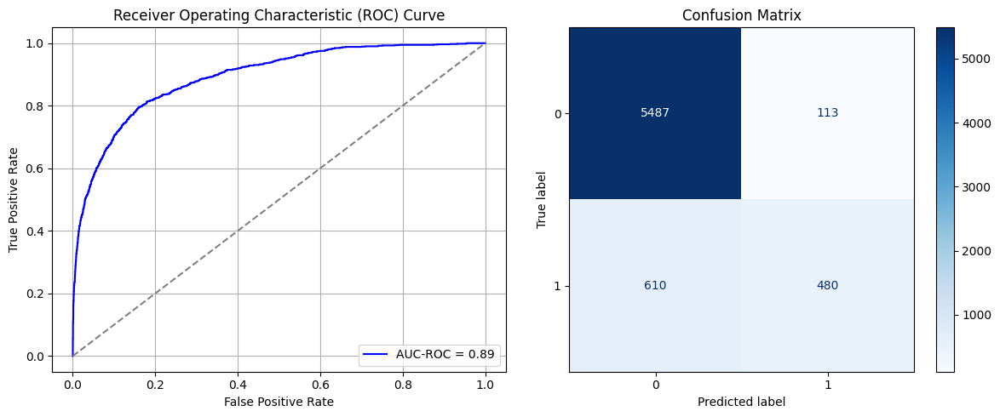

Best threshold based on F1-score: 0.17560015618801117
False Negative Rate: 0.5596330275229358
Time elapsed (performance): 1.217494746997545
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7359 - loss: 0.6009 - val_AUC: 0.8795 - val_loss: 0.4404
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8896 - loss: 0.4212 - val_AUC: 0.9195 - val_loss: 0.3766
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9311 - loss: 0.3377 - val_AUC: 0.9471 - val_loss: 0.2972
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9508 - loss: 0.2876 - val_AUC: 0.9545 - val_loss: 0.2770
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9551 - loss: 0.2736 - val_AUC: 0.9633 - val_loss: 0.2560
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9646 - loss: 0.2434 - val_AUC: 0.9666 - val_loss: 0.2534
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9690 - loss: 0.2275 - val_AUC: 0.9697 - val_loss: 0.2296
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9709 - loss: 0.2202 - val_AUC: 0.9742 - val_loss: 0.2105
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.9715 -

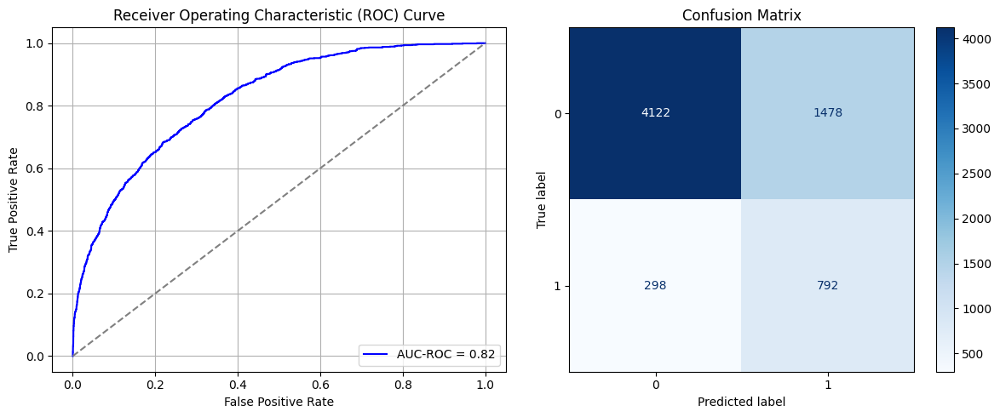

Best threshold based on F1-score: 0.7858443260192871
False Negative Rate: 0.27339449541284405
Time elapsed (performance): 1.0875380390025384
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7367 - loss: 0.6002 - val_AUC: 0.8924 - val_loss: 0.4274
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8895 - loss: 0.4214 - val_AUC: 0.9319 - val_loss: 0.3388
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9314 - loss: 0.3383 - val_AUC: 0.9532 - val_loss: 0.3416
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9489 - loss: 0.2945 - val_AUC: 0.9636 - val_loss: 0.2601
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9605 - loss: 0.2579 - val_AUC: 0.9704 - val_loss: 0.2242
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9657 - loss: 0.2395 - val_AUC: 0.9732 - val_loss: 0.2209
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9704 - loss: 0.2220 - val_AUC: 0.9753 - val_loss: 0.2063
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9712 - loss: 0.2183 - val_AUC: 0.9777 - val_loss: 0.2124
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9733 -

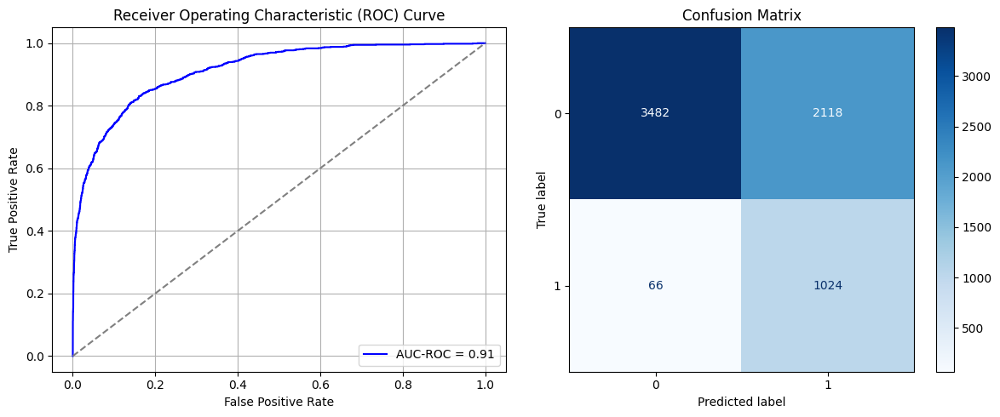

Best threshold based on F1-score: 0.9617606401443481
False Negative Rate: 0.060550458715596334
Time elapsed (performance): 6.43865463900147
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7445 - loss: 0.5923 - val_AUC: 0.8839 - val_loss: 0.4377
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8949 - loss: 0.4135 - val_AUC: 0.9229 - val_loss: 0.3603
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9322 - loss: 0.3356 - val_AUC: 0.9454 - val_loss: 0.3023
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9442 - loss: 0.3038 - val_AUC: 0.9561 - val_loss: 0.2864
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9564 - loss: 0.2690 - val_AUC: 0.9626 - val_loss: 0.2496
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9587 - loss: 0.2610 - val_AUC: 0.9660 - val_loss: 0.3038
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9649 - loss: 0.2414 - val_AUC: 0.9691 - val_loss: 0.2251
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9666 - loss: 0.2337 - val_AUC: 0.9735 - val_loss: 0.2099
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9697 -

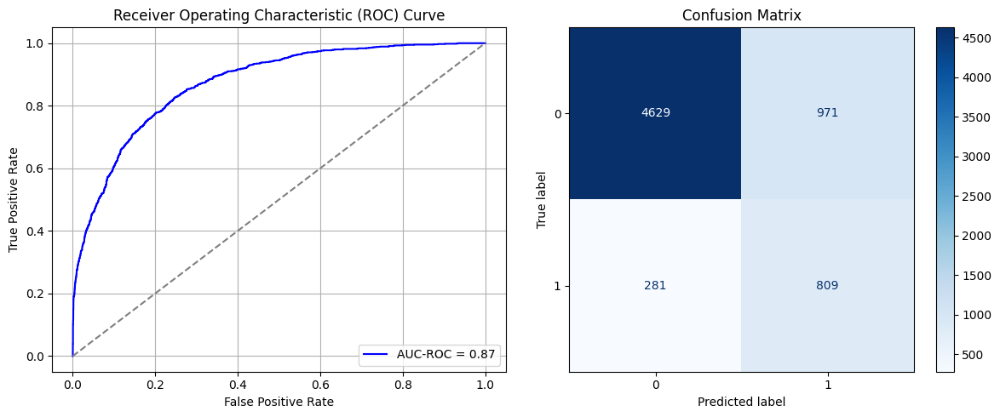

Best threshold based on F1-score: 0.6709521412849426
False Negative Rate: 0.25779816513761467
Time elapsed (performance): 1.0730502219994378
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7477 - loss: 0.5938 - val_AUC: 0.8814 - val_loss: 0.4577
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8935 - loss: 0.4158 - val_AUC: 0.9217 - val_loss: 0.3621
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9263 - loss: 0.3498 - val_AUC: 0.9421 - val_loss: 0.3107
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9437 - loss: 0.3067 - val_AUC: 0.9540 - val_loss: 0.2833
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9550 - loss: 0.2739 - val_AUC: 0.9603 - val_loss: 0.2579
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9627 - loss: 0.2497 - val_AUC: 0.9674 - val_loss: 0.2351
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9674 - loss: 0.2332 - val_AUC: 0.9689 - val_loss: 0.2272
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9704 - loss: 0.2226 - val_AUC: 0.9709 - val_loss: 0.2199
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9719 -

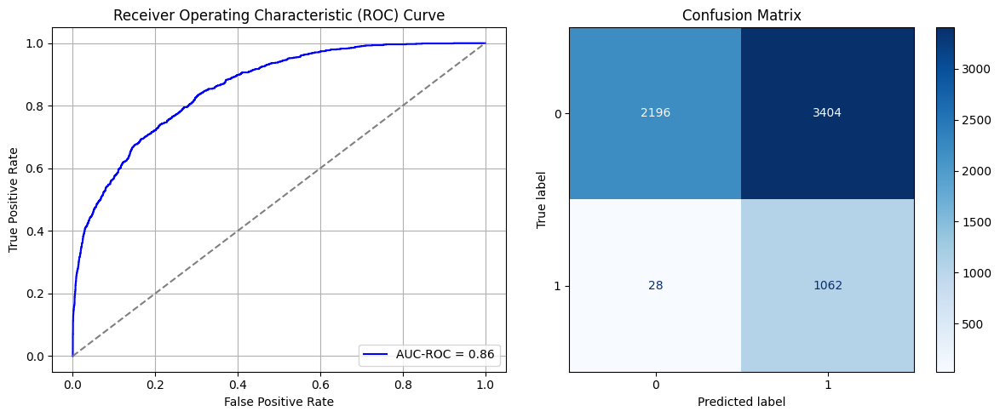

Best threshold based on F1-score: 0.9798058867454529
False Negative Rate: 0.025688073394495414
Time elapsed (performance): 1.0502982109974255
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7533 - loss: 0.5956 - val_AUC: 0.8984 - val_loss: 0.4248
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8931 - loss: 0.4172 - val_AUC: 0.9310 - val_loss: 0.3505
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9329 - loss: 0.3343 - val_AUC: 0.9508 - val_loss: 0.3431
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9472 - loss: 0.2981 - val_AUC: 0.9599 - val_loss: 0.2610
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9557 - loss: 0.2715 - val_AUC: 0.9652 - val_loss: 0.2422
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9652 - loss: 0.2409 - val_AUC: 0.9699 - val_loss: 0.2242
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9679 - loss: 0.2310 - val_AUC: 0.9710 - val_loss: 0.2249
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9695 - loss: 0.2245 - val_AUC: 0.9734 - val_loss: 0.2132
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9739 -

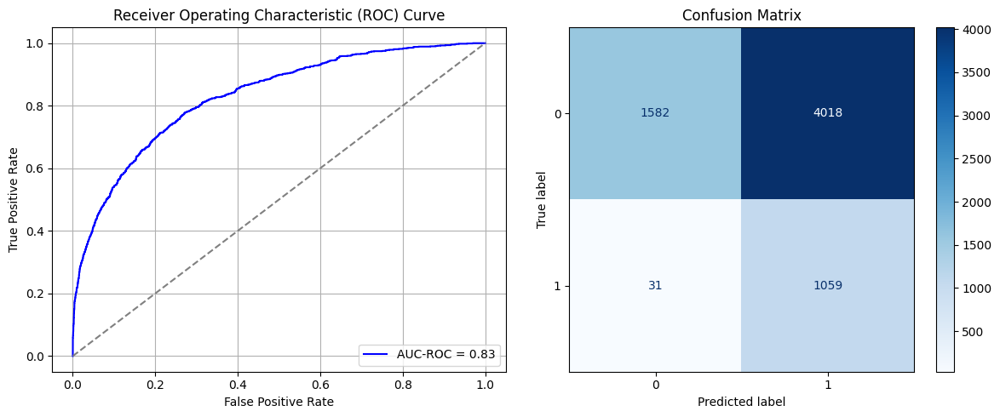

Best threshold based on F1-score: 0.9968351125717163
False Negative Rate: 0.028440366972477066
Time elapsed (performance): 1.0706706929995562
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7352 - loss: 0.6010 - val_AUC: 0.9007 - val_loss: 0.4168
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9013 - loss: 0.4027 - val_AUC: 0.9333 - val_loss: 0.3418
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9277 - loss: 0.3475 - val_AUC: 0.9493 - val_loss: 0.2966
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9465 - loss: 0.2990 - val_AUC: 0.9577 - val_loss: 0.2898
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9535 - loss: 0.2783 - val_AUC: 0.9634 - val_loss: 0.2569
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9590 - loss: 0.2600 - val_AUC: 0.9667 - val_loss: 0.2356
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9645 - loss: 0.2420 - val_AUC: 0.9706 - val_loss: 0.2204
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9669 - loss: 0.2337 - val_AUC: 0.9736 - val_loss: 0.2394
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9708 -

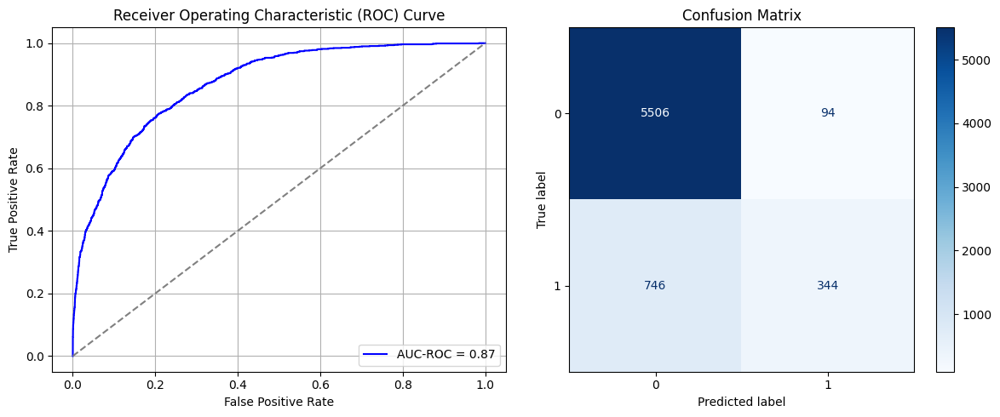

Best threshold based on F1-score: 0.06574805080890656
False Negative Rate: 0.6844036697247706
Time elapsed (performance): 0.9673261720017763
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7280 - loss: 0.6041 - val_AUC: 0.8825 - val_loss: 0.4412
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8863 - loss: 0.4268 - val_AUC: 0.9268 - val_loss: 0.3526
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9291 - loss: 0.3442 - val_AUC: 0.9474 - val_loss: 0.3006
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9474 - loss: 0.2974 - val_AUC: 0.9547 - val_loss: 0.3087
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9569 - loss: 0.2691 - val_AUC: 0.9651 - val_loss: 0.2556
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9650 - loss: 0.2425 - val_AUC: 0.9675 - val_loss: 0.2316
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9690 - loss: 0.2279 - val_AUC: 0.9709 - val_loss: 0.2444
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9712 - loss: 0.2186 - val_AUC: 0.9715 - val_loss: 0.2233
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9725 -

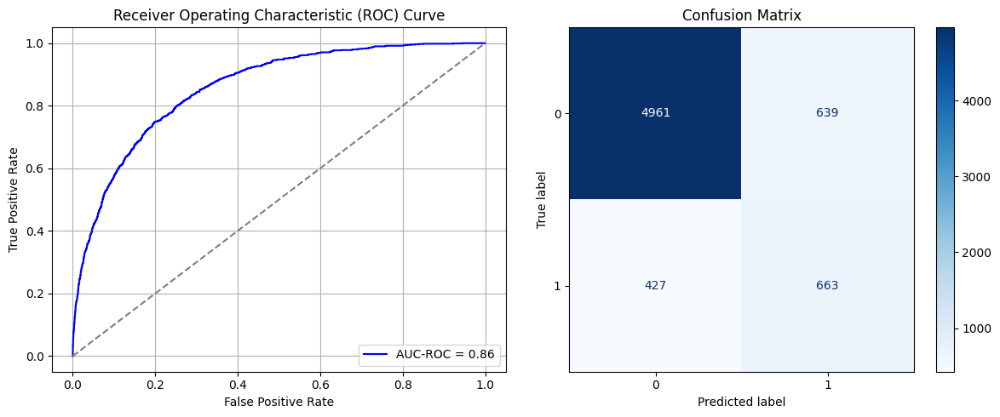

Best threshold based on F1-score: 0.45079076290130615
False Negative Rate: 0.39174311926605504
Time elapsed (performance): 1.0563395059980394
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7350 - loss: 0.6045 - val_AUC: 0.8881 - val_loss: 0.4356
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8974 - loss: 0.4090 - val_AUC: 0.9333 - val_loss: 0.3418
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9306 - loss: 0.3388 - val_AUC: 0.9551 - val_loss: 0.3013
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9447 - loss: 0.3031 - val_AUC: 0.9628 - val_loss: 0.2509
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9562 - loss: 0.2693 - val_AUC: 0.9651 - val_loss: 0.2481
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9639 - loss: 0.2453 - val_AUC: 0.9721 - val_loss: 0.2198
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9673 - loss: 0.2333 - val_AUC: 0.9720 - val_loss: 0.2165
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9693 - loss: 0.2255 - val_AUC: 0.9760 - val_loss: 0.2145
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9727 -

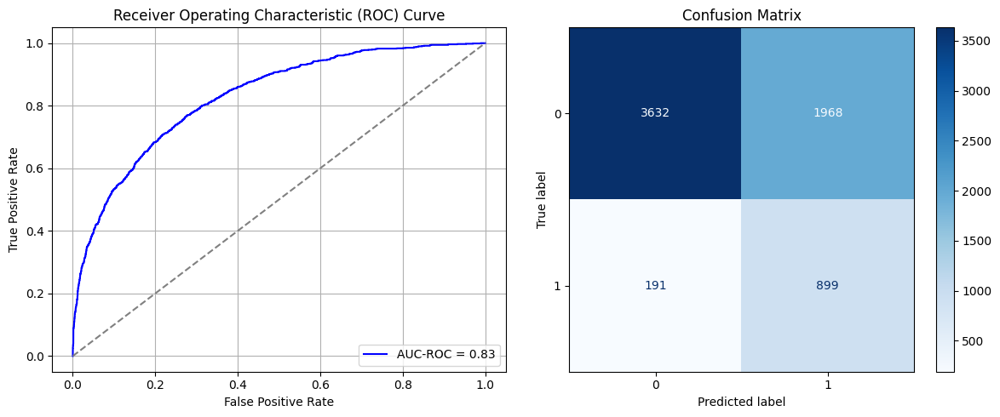

Best threshold based on F1-score: 0.9141125679016113
False Negative Rate: 0.17522935779816515
Time elapsed (performance): 0.9468159839998407
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7386 - loss: 0.6026 - val_AUC: 0.8836 - val_loss: 0.4398
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8955 - loss: 0.4124 - val_AUC: 0.9357 - val_loss: 0.3480
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9385 - loss: 0.3227 - val_AUC: 0.9513 - val_loss: 0.2895
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9503 - loss: 0.2869 - val_AUC: 0.9647 - val_loss: 0.2438
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9627 - loss: 0.2490 - val_AUC: 0.9691 - val_loss: 0.2359
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9696 - loss: 0.2248 - val_AUC: 0.9740 - val_loss: 0.2092
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9715 - loss: 0.2168 - val_AUC: 0.9760 - val_loss: 0.2111
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9733 - loss: 0.2094 - val_AUC: 0.9769 - val_loss: 0.2249
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.9738 -

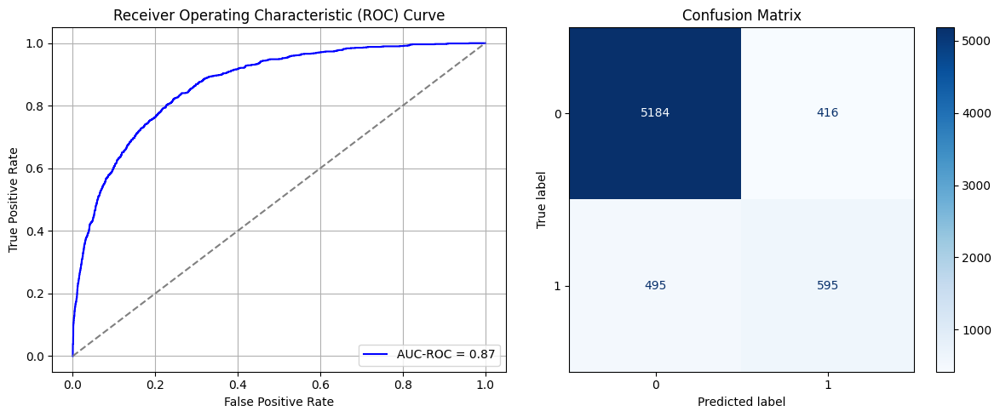

Best threshold based on F1-score: 0.3269962966442108
False Negative Rate: 0.4541284403669725
Time elapsed (performance): 1.1434691079994082
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7559 - loss: 0.5881 - val_AUC: 0.8954 - val_loss: 0.4299
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8980 - loss: 0.4061 - val_AUC: 0.9353 - val_loss: 0.3971
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9373 - loss: 0.3234 - val_AUC: 0.9539 - val_loss: 0.2859
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9554 - loss: 0.2735 - val_AUC: 0.9629 - val_loss: 0.2564
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9615 - loss: 0.2529 - val_AUC: 0.9689 - val_loss: 0.2279
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9657 - loss: 0.2381 - val_AUC: 0.9700 - val_loss: 0.2234
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9716 - loss: 0.2166 - val_AUC: 0.9736 - val_loss: 0.2108
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9722 - loss: 0.2132 - val_AUC: 0.9728 - val_loss: 0.2336
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9731 -

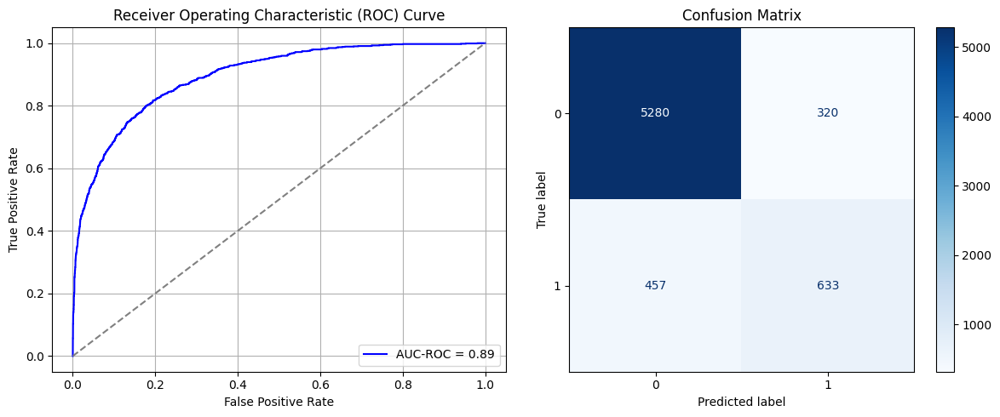

Best threshold based on F1-score: 0.4075034260749817
False Negative Rate: 0.41926605504587156
Time elapsed (performance): 0.9190982299987809
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7548 - loss: 0.5897 - val_AUC: 0.8866 - val_loss: 0.4522
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8872 - loss: 0.4260 - val_AUC: 0.9226 - val_loss: 0.3601
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - AUC: 0.9208 - loss: 0.3601 - val_AUC: 0.9395 - val_loss: 0.3220
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9379 - loss: 0.3202 - val_AUC: 0.9537 - val_loss: 0.2845
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9506 - loss: 0.2875 - val_AUC: 0.9609 - val_loss: 0.2629
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9566 - loss: 0.2687 - val_AUC: 0.9653 - val_loss: 0.2402
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9630 - loss: 0.2477 - val_AUC: 0.9699 - val_loss: 0.2242
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9665 - loss: 0.2356 - val_AUC: 0.9720 - val_loss: 0.2208
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9683

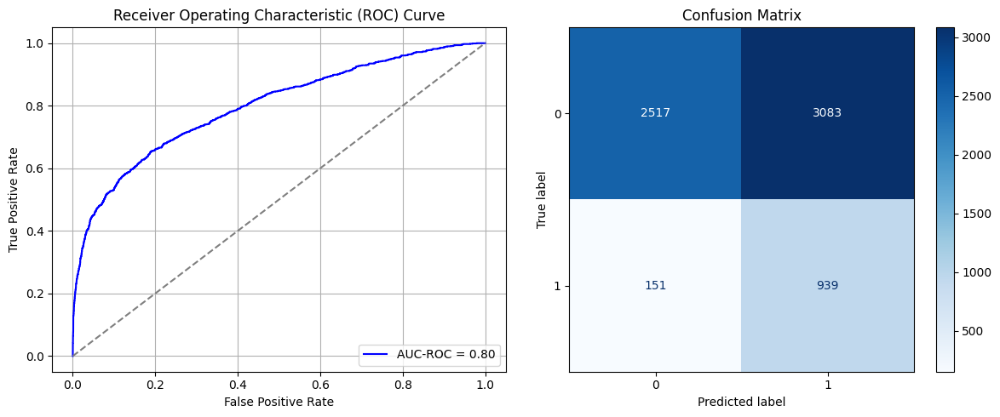

Best threshold based on F1-score: 0.967546284198761
False Negative Rate: 0.13853211009174313
Time elapsed (performance): 1.065167393997399
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7558 - loss: 0.5857 - val_AUC: 0.8992 - val_loss: 0.4253
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9081 - loss: 0.3909 - val_AUC: 0.9343 - val_loss: 0.4021
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9380 - loss: 0.3222 - val_AUC: 0.9512 - val_loss: 0.2889
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9499 - loss: 0.2891 - val_AUC: 0.9604 - val_loss: 0.2764
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9590 - loss: 0.2606 - val_AUC: 0.9661 - val_loss: 0.2398
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9637 - loss: 0.2441 - val_AUC: 0.9670 - val_loss: 0.2481
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9665 - loss: 0.2346 - val_AUC: 0.9711 - val_loss: 0.2226
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - AUC: 0.9714 - loss: 0.2170 - val_AUC: 0.9720 - val_loss: 0.2142
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9731 -

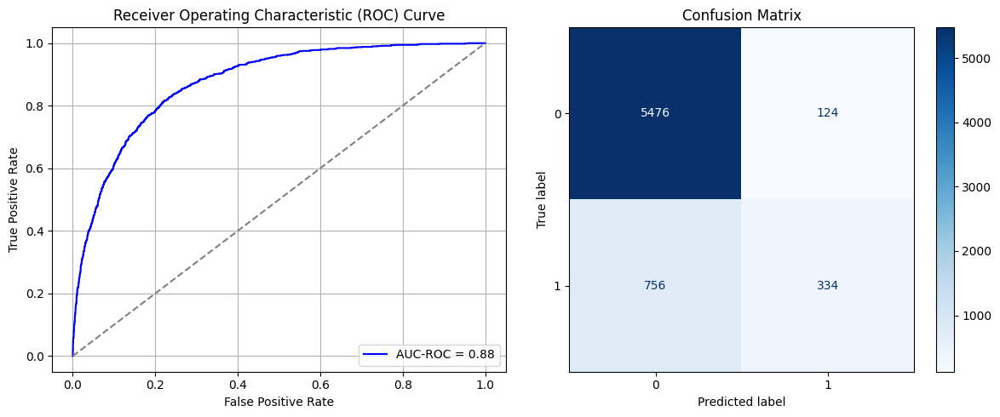

Best threshold based on F1-score: 0.06832610070705414
False Negative Rate: 0.6935779816513762
Time elapsed (performance): 1.2810128719975182
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7417 - loss: 0.5978 - val_AUC: 0.8916 - val_loss: 0.4266
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8964 - loss: 0.4109 - val_AUC: 0.9359 - val_loss: 0.3331
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9359 - loss: 0.3277 - val_AUC: 0.9577 - val_loss: 0.2733
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9481 - loss: 0.2934 - val_AUC: 0.9646 - val_loss: 0.2611
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9621 - loss: 0.2515 - val_AUC: 0.9694 - val_loss: 0.2471
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9662 - loss: 0.2371 - val_AUC: 0.9715 - val_loss: 0.2164
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9685 - loss: 0.2275 - val_AUC: 0.9726 - val_loss: 0.2326
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9709 - loss: 0.2192 - val_AUC: 0.9751 - val_loss: 0.2675
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9743 -

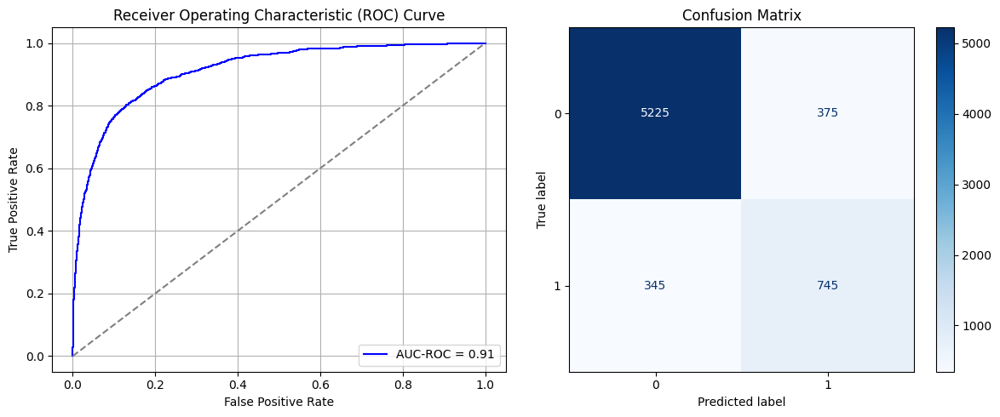

Best threshold based on F1-score: 0.42830541729927063
False Negative Rate: 0.3165137614678899
Time elapsed (performance): 1.0716830479977943
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7116 - loss: 0.6131 - val_AUC: 0.8899 - val_loss: 0.4275
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8990 - loss: 0.4064 - val_AUC: 0.9320 - val_loss: 0.3466
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9404 - loss: 0.3174 - val_AUC: 0.9532 - val_loss: 0.2828
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9484 - loss: 0.2926 - val_AUC: 0.9579 - val_loss: 0.2639
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9608 - loss: 0.2552 - val_AUC: 0.9648 - val_loss: 0.2472
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9657 - loss: 0.2386 - val_AUC: 0.9688 - val_loss: 0.2274
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9675 - loss: 0.2318 - val_AUC: 0.9709 - val_loss: 0.2284
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9714 - loss: 0.2168 - val_AUC: 0.9722 - val_loss: 0.2168
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9732 -

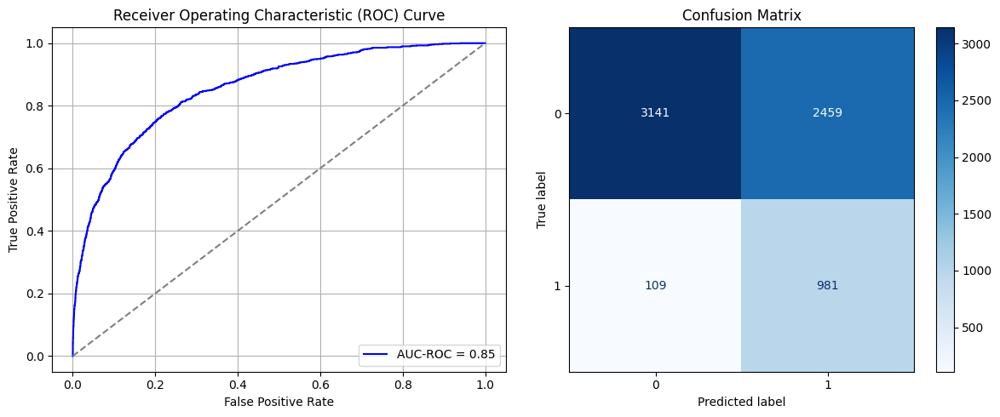

Best threshold based on F1-score: 0.9627958536148071
False Negative Rate: 0.1
Time elapsed (performance): 0.9905221570006688
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7501 - loss: 0.5905 - val_AUC: 0.8957 - val_loss: 0.4380
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8987 - loss: 0.4055 - val_AUC: 0.9296 - val_loss: 0.3513
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9325 - loss: 0.3349 - val_AUC: 0.9531 - val_loss: 0.3025
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9477 - loss: 0.2956 - val_AUC: 0.9622 - val_loss: 0.2637
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9612 - loss: 0.2560 - val_AUC: 0.9644 - val_loss: 0.2710
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9638 - loss: 0.2460 - val_AUC: 0.9705 - val_loss: 0.2246
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9676 - loss: 0.2324 - val_AUC: 0.9717 - val_loss: 0.2175
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9694 - loss: 0.2255 - val_AUC: 0.9713 - val_loss: 0.2411
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9701 -

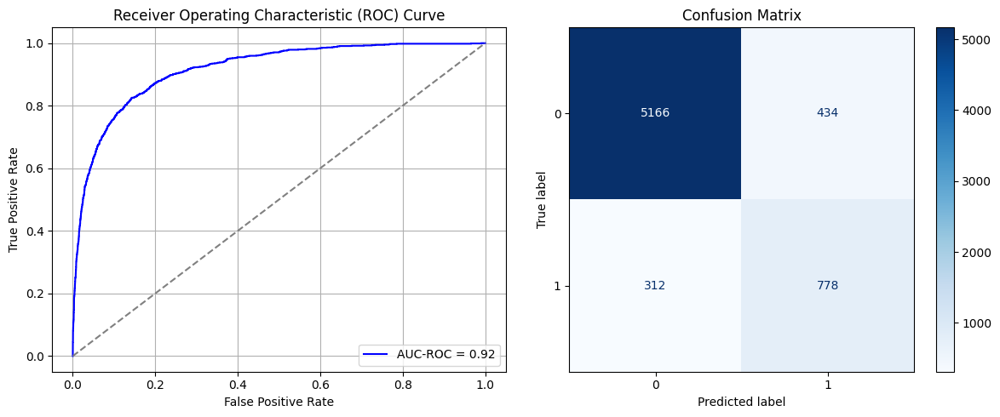

Best threshold based on F1-score: 0.5709136724472046
False Negative Rate: 0.28623853211009176
Time elapsed (performance): 1.4342233720017248
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7454 - loss: 0.5983 - val_AUC: 0.8996 - val_loss: 0.4358
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9081 - loss: 0.3897 - val_AUC: 0.9368 - val_loss: 0.3379
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9409 - loss: 0.3161 - val_AUC: 0.9563 - val_loss: 0.2741
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9538 - loss: 0.2781 - val_AUC: 0.9637 - val_loss: 0.2545
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9630 - loss: 0.2486 - val_AUC: 0.9670 - val_loss: 0.2436
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9678 - loss: 0.2310 - val_AUC: 0.9732 - val_loss: 0.2519
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9711 - loss: 0.2191 - val_AUC: 0.9741 - val_loss: 0.2079
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9732 - loss: 0.2099 - val_AUC: 0.9754 - val_loss: 0.2063
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9739 -

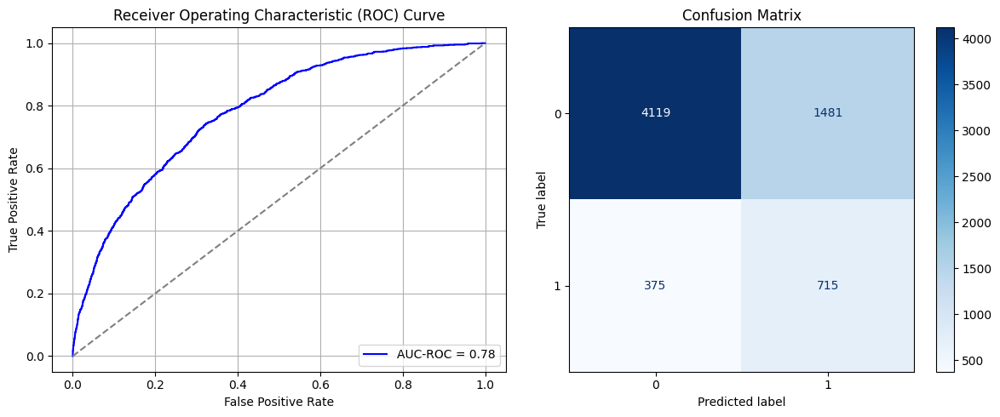

Best threshold based on F1-score: 0.8153224587440491
False Negative Rate: 0.3440366972477064
Time elapsed (performance): 0.9717789790011011
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7272 - loss: 0.6041 - val_AUC: 0.8998 - val_loss: 0.4341
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9016 - loss: 0.4011 - val_AUC: 0.9351 - val_loss: 0.3369
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9357 - loss: 0.3273 - val_AUC: 0.9532 - val_loss: 0.2816
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9488 - loss: 0.2913 - val_AUC: 0.9603 - val_loss: 0.2580
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9590 - loss: 0.2610 - val_AUC: 0.9679 - val_loss: 0.2341
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9629 - loss: 0.2486 - val_AUC: 0.9706 - val_loss: 0.2329
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9685 - loss: 0.2285 - val_AUC: 0.9735 - val_loss: 0.2239
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9700 - loss: 0.2222 - val_AUC: 0.9761 - val_loss: 0.1985
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9722 -

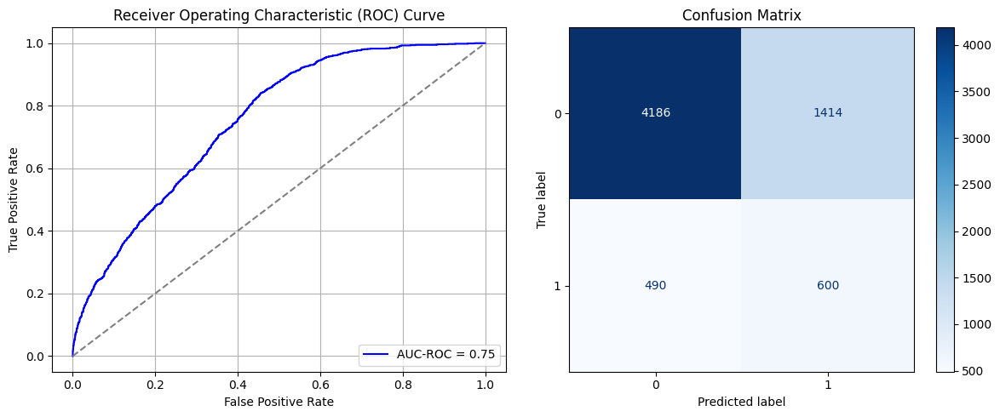

Best threshold based on F1-score: 0.10711720585823059
False Negative Rate: 0.44954128440366975
Time elapsed (performance): 1.7769635559998278
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7262 - loss: 0.6085 - val_AUC: 0.8911 - val_loss: 0.4262
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8935 - loss: 0.4153 - val_AUC: 0.9391 - val_loss: 0.3280
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9382 - loss: 0.3222 - val_AUC: 0.9555 - val_loss: 0.2798
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9528 - loss: 0.2811 - val_AUC: 0.9653 - val_loss: 0.2461
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9632 - loss: 0.2490 - val_AUC: 0.9682 - val_loss: 0.2367
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9670 - loss: 0.2345 - val_AUC: 0.9720 - val_loss: 0.2188
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9683 - loss: 0.2297 - val_AUC: 0.9740 - val_loss: 0.2088
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9733 - loss: 0.2106 - val_AUC: 0.9759 - val_loss: 0.2027
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9739 -

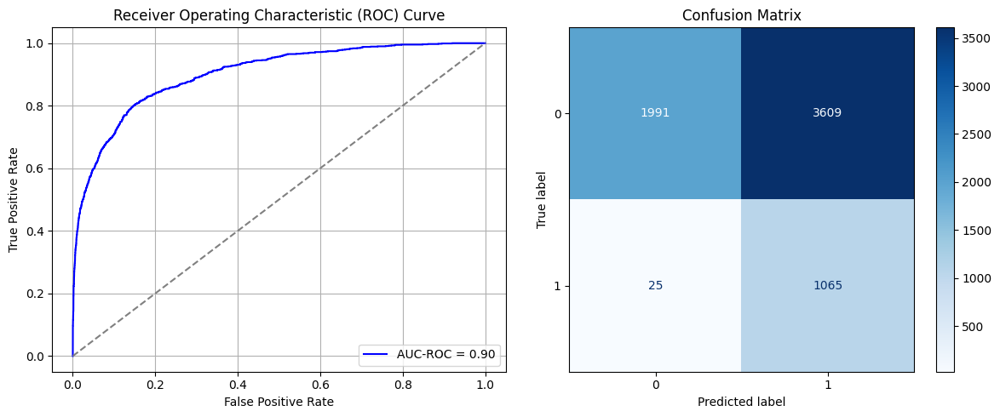

Best threshold based on F1-score: 0.9796410202980042
False Negative Rate: 0.022935779816513763
Time elapsed (performance): 1.0875230560013733
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7185 - loss: 0.6116 - val_AUC: 0.8832 - val_loss: 0.4505
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8841 - loss: 0.4320 - val_AUC: 0.9194 - val_loss: 0.3812
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9192 - loss: 0.3656 - val_AUC: 0.9468 - val_loss: 0.3211
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9406 - loss: 0.3153 - val_AUC: 0.9565 - val_loss: 0.2722
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9567 - loss: 0.2704 - val_AUC: 0.9642 - val_loss: 0.2469
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9607 - loss: 0.2560 - val_AUC: 0.9678 - val_loss: 0.2339
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9630 - loss: 0.2484 - val_AUC: 0.9713 - val_loss: 0.2199
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9670 - loss: 0.2336 - val_AUC: 0.9733 - val_loss: 0.2138
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9706 -

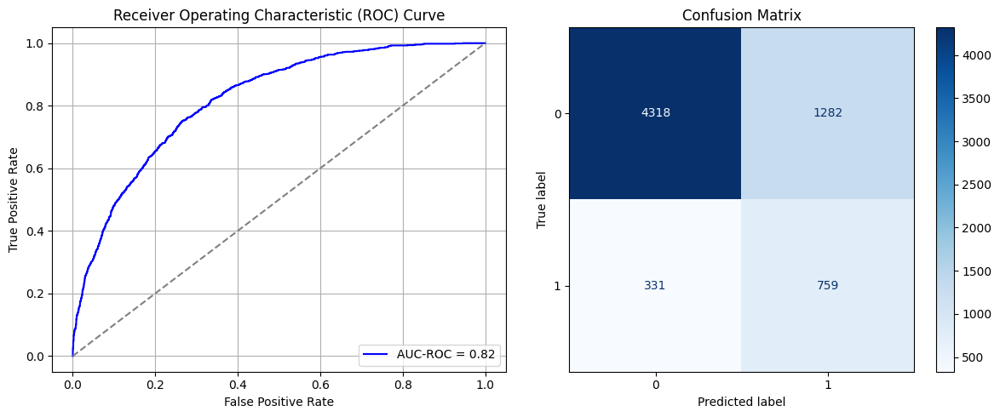

Best threshold based on F1-score: 0.6485456228256226
False Negative Rate: 0.3036697247706422
Time elapsed (performance): 1.106219463999878
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7303 - loss: 0.6037 - val_AUC: 0.8899 - val_loss: 0.4317
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8953 - loss: 0.4135 - val_AUC: 0.9347 - val_loss: 0.3573
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9381 - loss: 0.3232 - val_AUC: 0.9564 - val_loss: 0.2786
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9537 - loss: 0.2805 - val_AUC: 0.9646 - val_loss: 0.2482
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9616 - loss: 0.2533 - val_AUC: 0.9695 - val_loss: 0.2436
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9665 - loss: 0.2367 - val_AUC: 0.9715 - val_loss: 0.2214
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9691 - loss: 0.2265 - val_AUC: 0.9729 - val_loss: 0.2214
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9728 - loss: 0.2120 - val_AUC: 0.9752 - val_loss: 0.2090
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9740 -

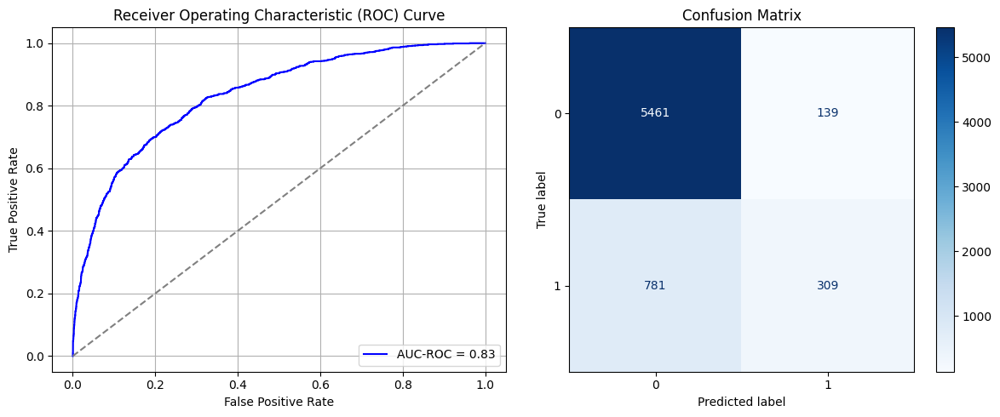

Best threshold based on F1-score: 0.08463737368583679
False Negative Rate: 0.7165137614678899
Time elapsed (performance): 1.00489319999906
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7358 - loss: 0.6018 - val_AUC: 0.8914 - val_loss: 0.4737
Epoch 2/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8996 - loss: 0.4067 - val_AUC: 0.9364 - val_loss: 0.3778
Epoch 3/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9382 - loss: 0.3223 - val_AUC: 0.9569 - val_loss: 0.3037
Epoch 4/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9552 - loss: 0.2746 - val_AUC: 0.9654 - val_loss: 0.2420
Epoch 5/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9616 - loss: 0.2529 - val_AUC: 0.9704 - val_loss: 0.2257
Epoch 6/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9679 - loss: 0.2305 - val_AUC: 0.9719 - val_loss: 0.2328
Epoch 7/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9712 - loss: 0.2174 - val_AUC: 0.9742 - val_loss: 0.2062
Epoch 8/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9737 - loss: 0.2081 - val_AUC: 0.9751 - val_loss: 0.2049
Epoch 9/10
772/772 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.9771 -

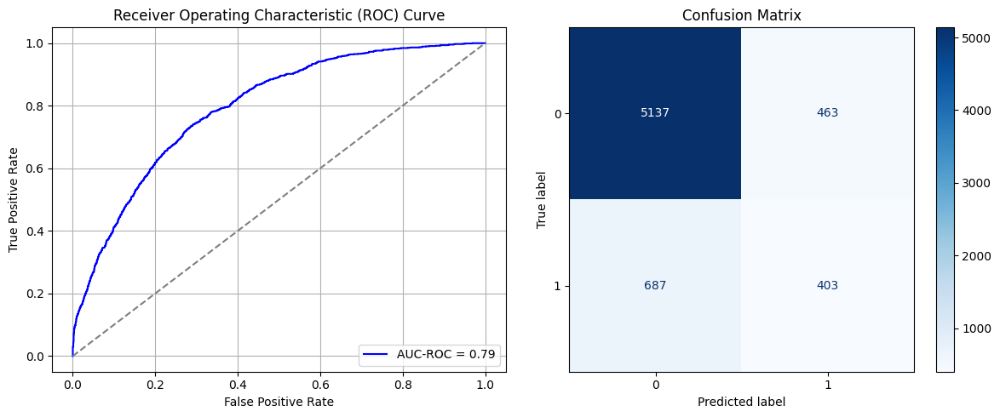

Best threshold based on F1-score: 0.1280003786087036
False Negative Rate: 0.6302752293577981
Time elapsed (performance): 1.0529810869993526


In [64]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = 10
Nsamples = k*(oversample_size-undersample_size)/undersample_size



for i in range(times):
    start = np.random.choice(int(k), int(Nsamples), replace=True)
    Row = []
    for j in range(len(start)):
      for i in range(int(undersample_size/k)):
        row = start[j]+int(k*i)-1
        Row.append(row)
    data_S_min_ros = pd.DataFrame()
    data_S_min_ros = data_S_minority.iloc[Row]
    data_S_Sy_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_Sy_ROS = data_S_Sy_ROS.iloc[:, :-1]
    y_S_Sy_ROS = data_S_Sy_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy_ROS, y_S_Sy_ROS, test_size=0.20, random_state=0)
    model_Sy_ROS = create_dnn_model(X_S_train.shape[1])
    result_Sy_ROS = train_and_evaluate(model_Sy_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy_ROS = Transductive_TL(model_Sy_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_Sy_ROS)
    FPR.append(result_TL_Sy_ROS[0])
    TNR.append(result_TL_Sy_ROS[1])
    FNR.append(result_TL_Sy_ROS[2])
    TPR.append(result_TL_Sy_ROS[3])
    TL_time.append(result_TL_Sy_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [65]:
print('Mean:', ParamFit['FNR'].mean())
print('Variance:', ParamFit['FNR'].var())

Mean: 0.30693577981651377
Variance: 0.038935091356633554


In [66]:
print(ParamFit)
ParamFit.to_csv('Sy_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     29.533130  0.153214  0.846786  0.232110  0.767890     0.779643
1     31.220293  0.118929  0.881071  0.434862  0.565138     0.802932
2     31.722456  0.152143  0.847857  0.315596  0.684404     1.089176
3     28.514387  0.019821  0.980179  0.716514  0.283486     0.815021
4     33.032095  0.101071  0.898929  0.317431  0.682569     0.797435
5     27.661767  0.431964  0.568036  0.148624  0.851376     1.047644
6     27.908456  0.074107  0.925893  0.303670  0.696330     1.037415
7     32.505591  0.336786  0.663214  0.111927  0.888073     1.044659
8     29.250766  0.072321  0.927679  0.498165  0.501835     0.811202
9     32.841035  0.199464  0.800536  0.200917  0.799083     0.840855
10    30.693782  0.489821  0.510179  0.076147  0.923853     1.047892
11    32.712978  0.036607  0.963393  0.577982  0.422018     0.830175
12    29.379301  0.114107  0.885893  0.281651  0.718349     0.769834
13    29.069858  0.137679  0.86232